In [1]:
import numpy as np
from numpy import linalg as la
import matplotlib.pyplot as plt
from sklearn.preprocessing import scale

from data_cube import DataCube
from ssm import SSM
from similarity_network_fusion import SNF

In [2]:
from tslearn.metrics import dtw, dtw_path

In [3]:
dc = DataCube(
    subjects="all",
    gestures=["3", "4", "5", "6"],
    channels=["2", "4", "6", "8"],
    data_grp="parsed"
)
dc.load_data()
dc.rms_smooth(300, 20)
dc.normalize_modalities(smooth=True)

---

In [4]:
def pass_synergist_channels(gnum, array):
    """
    pass synergist only channels for each gesture
    gnum - gesture number (i.e. 1, 2, 3, or 4)
    array - entire array of all channels and time index
    """
    synrgsts = {"3":[0, 1, 4], # channels 2 & 8; 0 is tidx
                "4":[0, 2, 3], # channels 4 & 6; 0 is tidx
                "5":[0, 1, 2], # channels 4 & 2; 0 is tidx
                "6":[0, 3, 4]} # channels 6 & 8; 0 is tidx
    synergist_array = np.c_[array[:, synrgsts[gnum][0]],
                            array[:, synrgsts[gnum][1]],
                            array[:, synrgsts[gnum][2]]]
    return synergist_array

---

subject 30; gesture 3_0_1


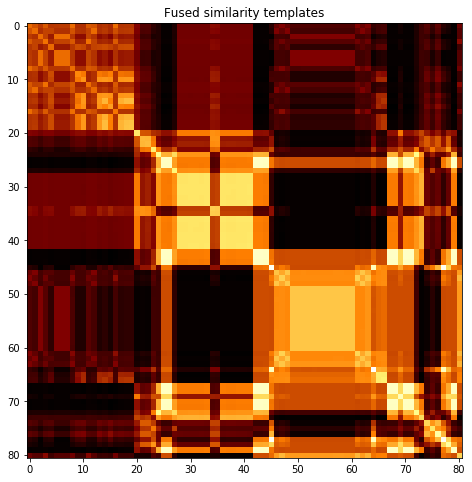

subject 30; gesture 4_1_1


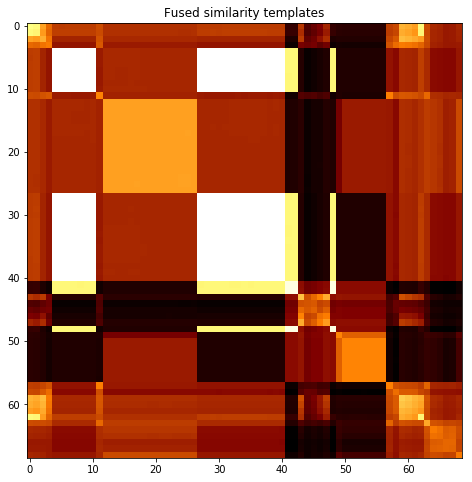

subject 30; gesture 2_0_1


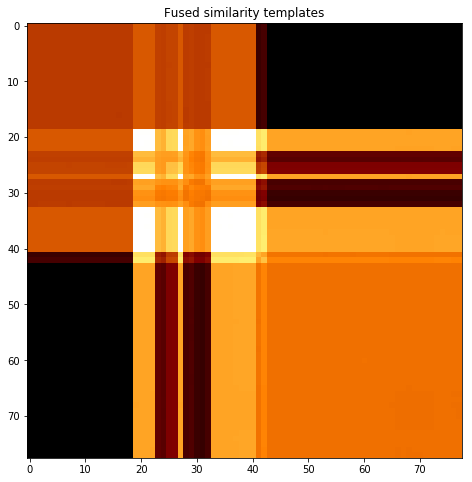

subject 30; gesture 4_1_2


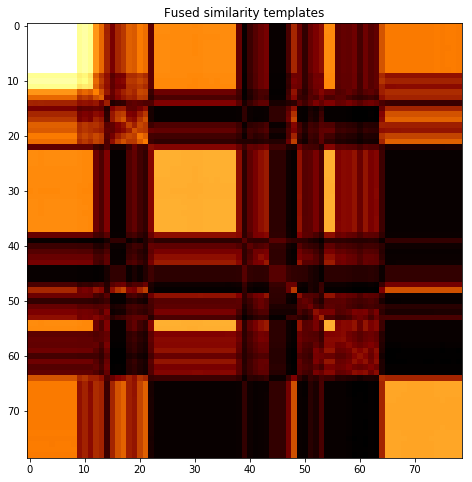

subject 30; gesture 2_0_2


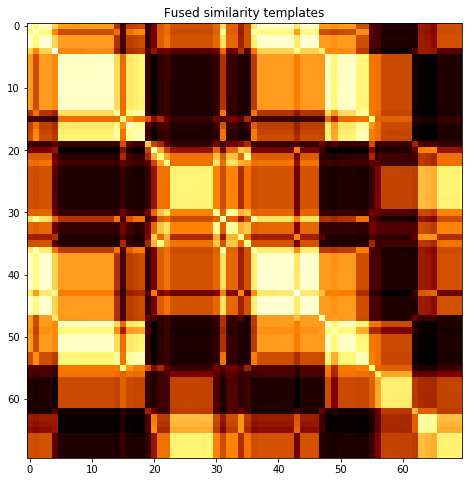

subject 30; gesture 1_1_2


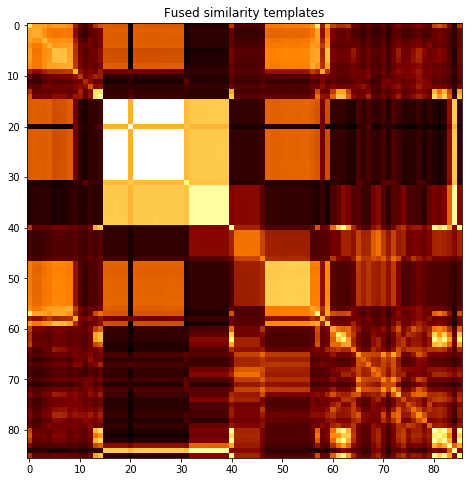

subject 30; gesture 2_1_2


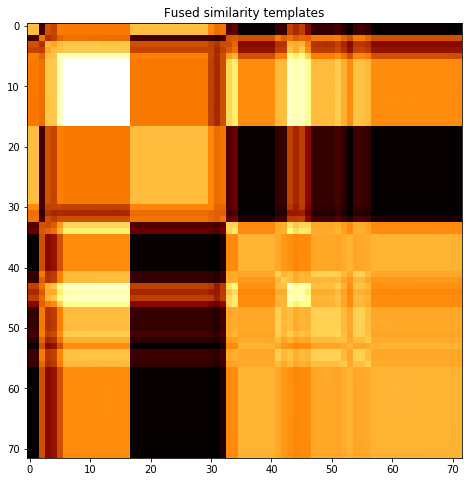

subject 30; gesture 4_0_1


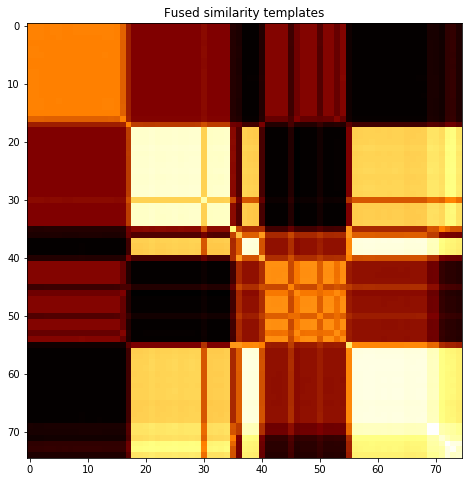

subject 30; gesture 3_0_2


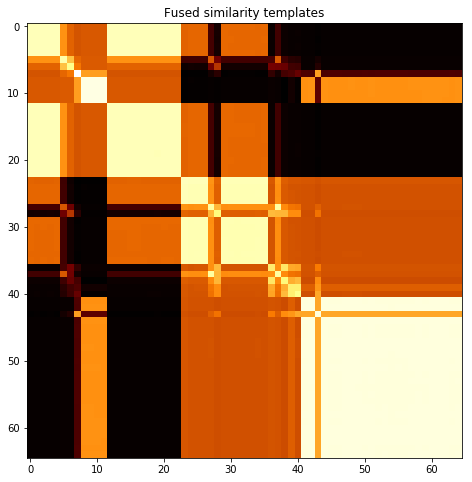

subject 30; gesture 1_1_1


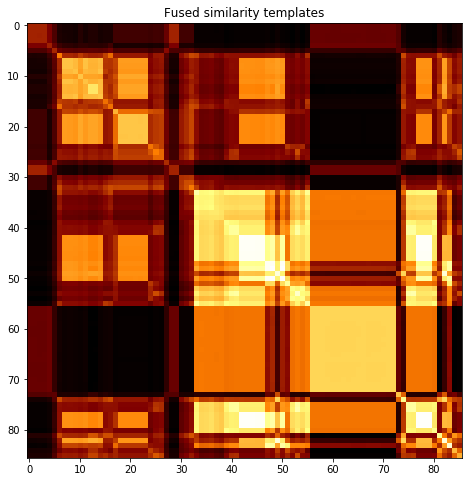

subject 30; gesture 3_1_2


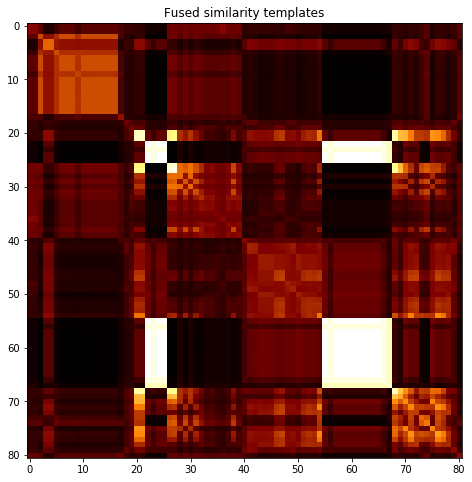

subject 30; gesture 2_1_1


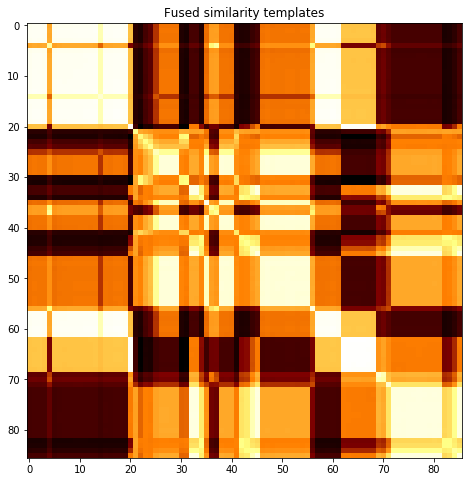

subject 30; gesture 1_0_1


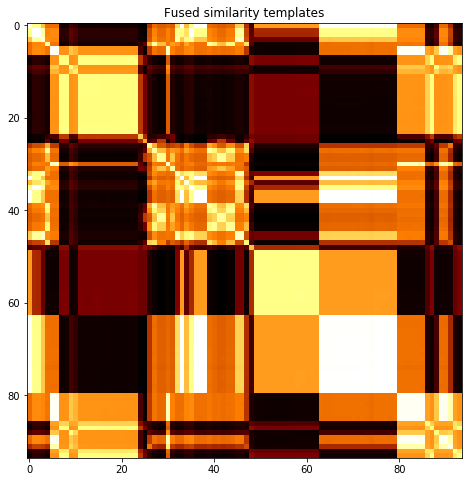

subject 30; gesture 3_1_1


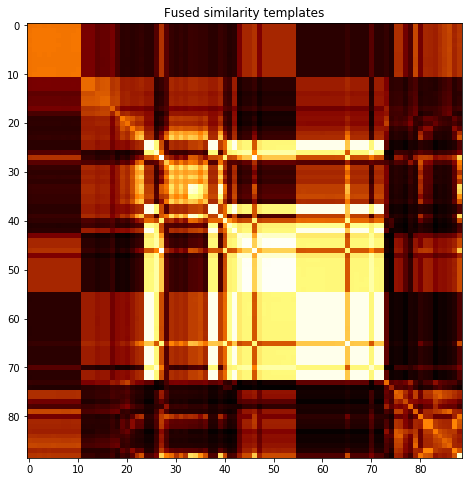

subject 30; gesture 1_0_2


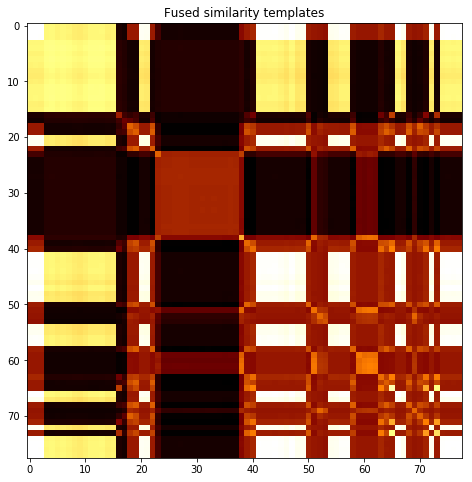

subject 30; gesture 4_0_2


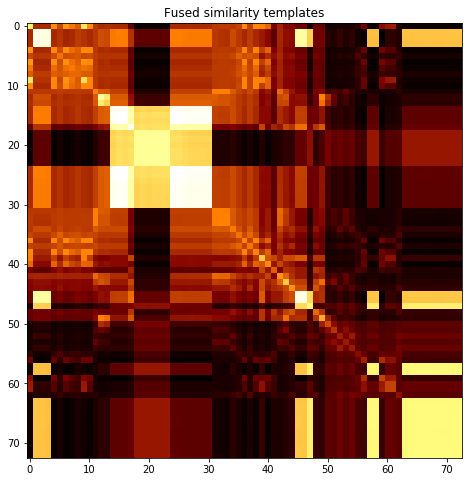

subject 06; gesture 3_0_1


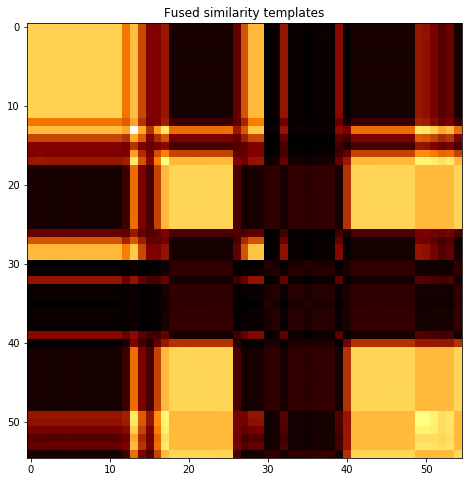

subject 06; gesture 4_1_1


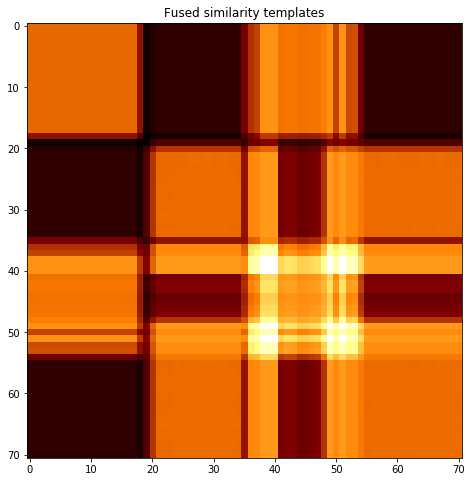

subject 06; gesture 2_0_1


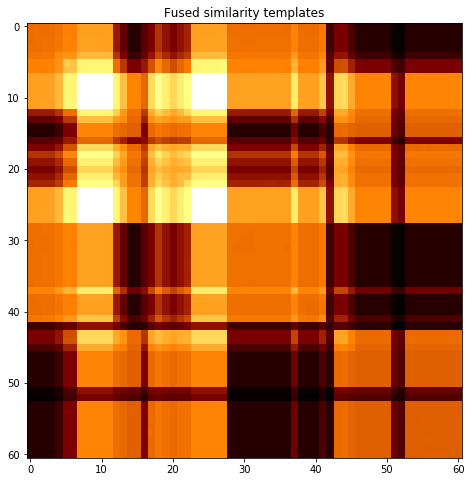

subject 06; gesture 4_1_2


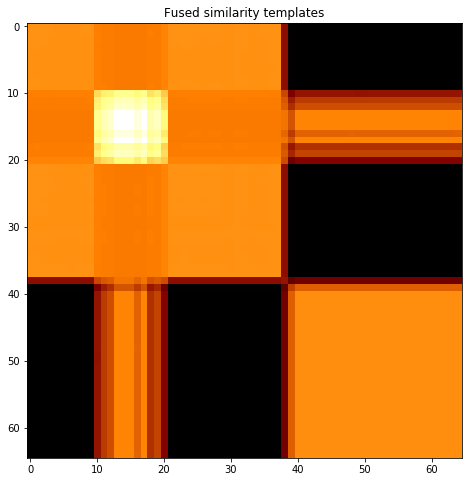

subject 06; gesture 2_0_2


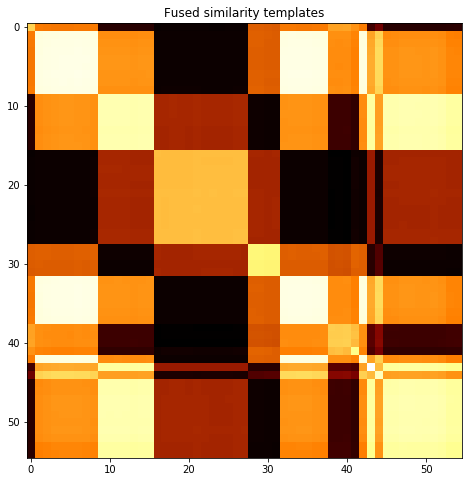

subject 06; gesture 1_1_2


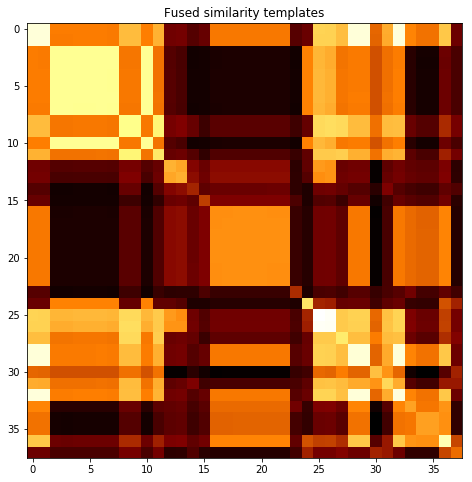

subject 06; gesture 2_1_2


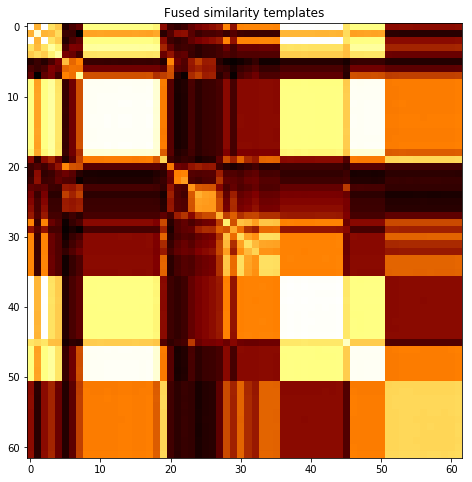

subject 06; gesture 4_0_1


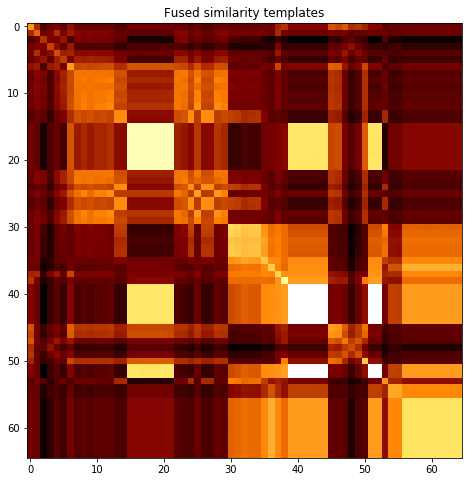

subject 06; gesture 3_0_2


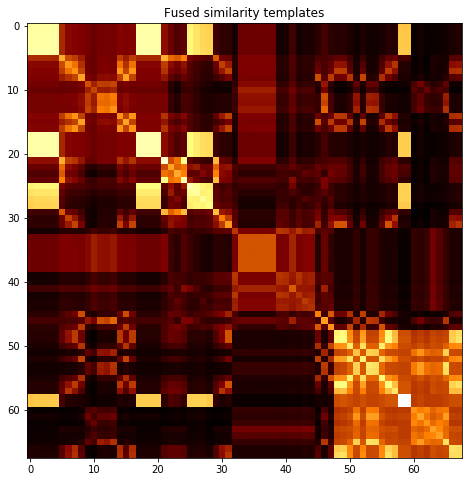

subject 06; gesture 1_1_1


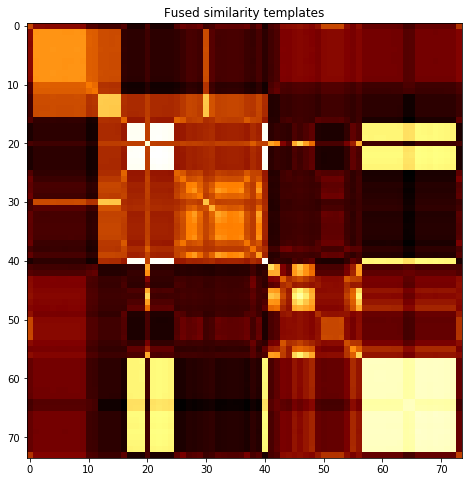

subject 06; gesture 3_1_2


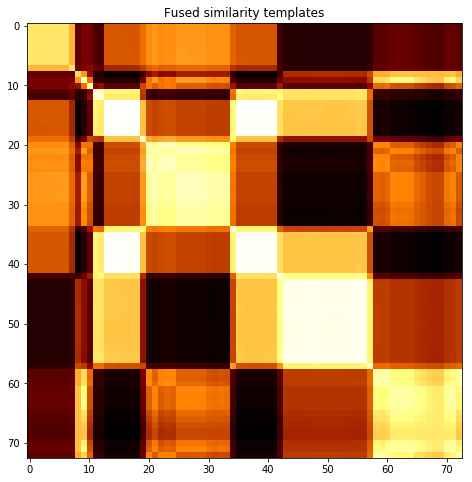

subject 06; gesture 2_1_1


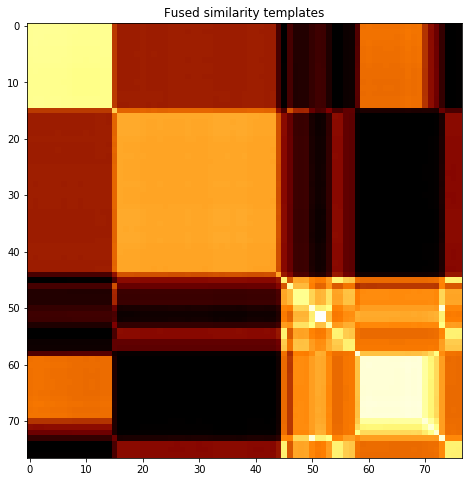

subject 06; gesture 1_0_1


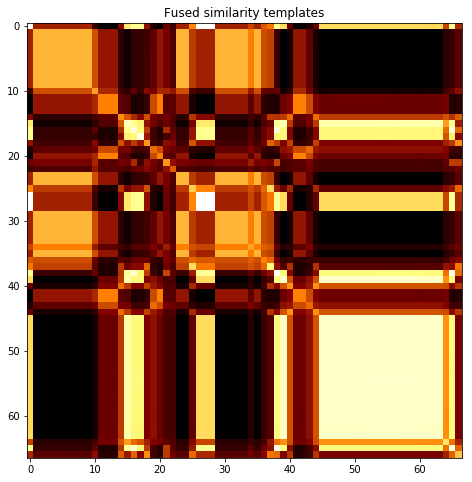

subject 06; gesture 3_1_1


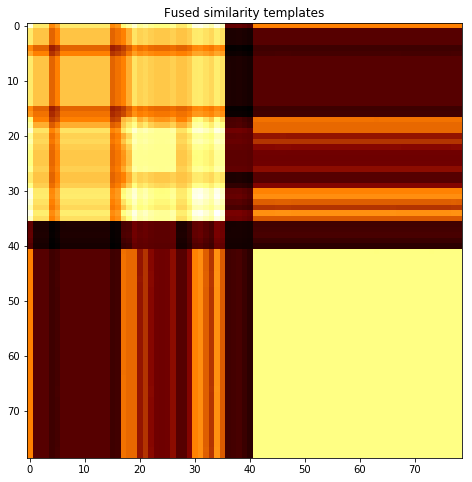

subject 06; gesture 1_0_2


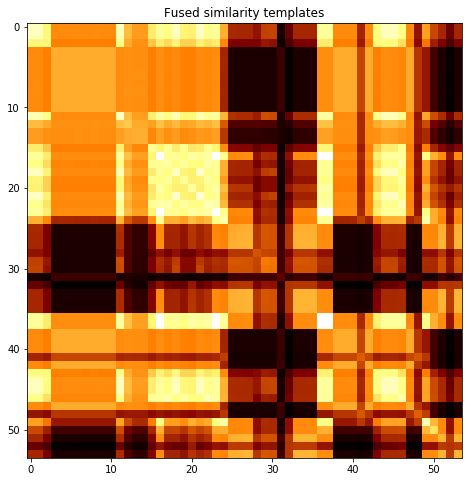

subject 06; gesture 4_0_2


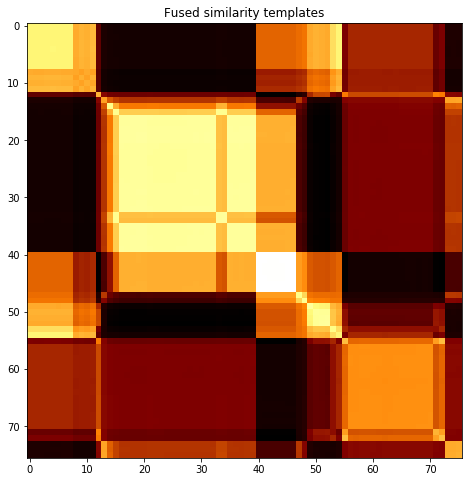

subject 09; gesture 3_0_1


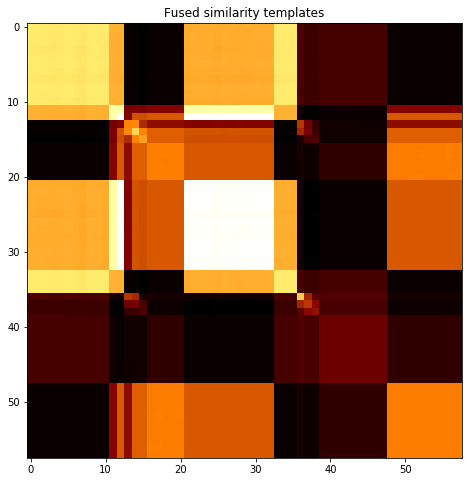

subject 09; gesture 4_1_1


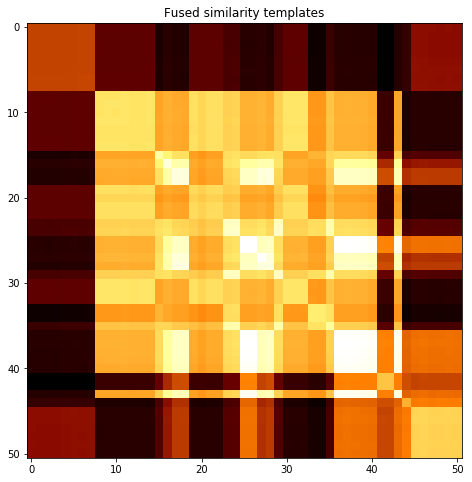

subject 09; gesture 2_0_1


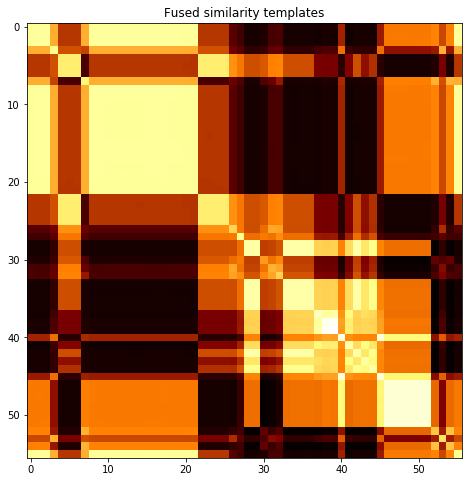

subject 09; gesture 4_1_2


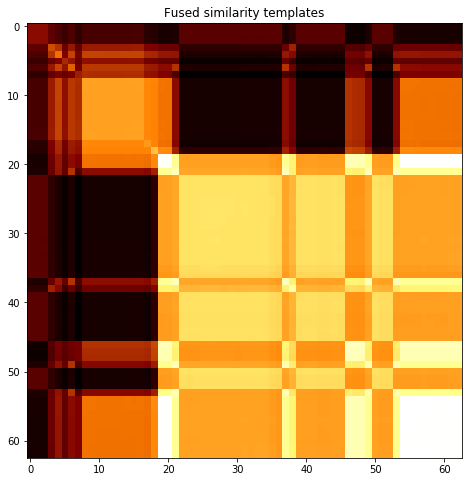

subject 09; gesture 2_0_2


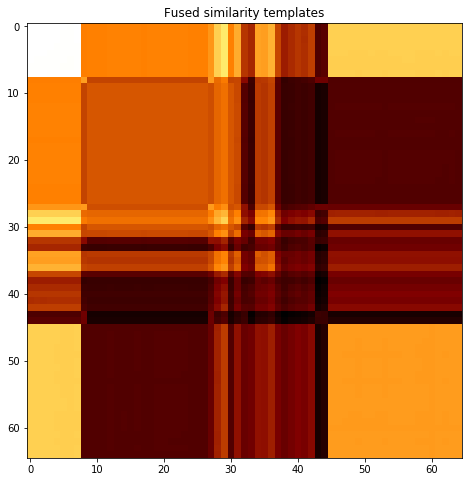

subject 09; gesture 1_1_2


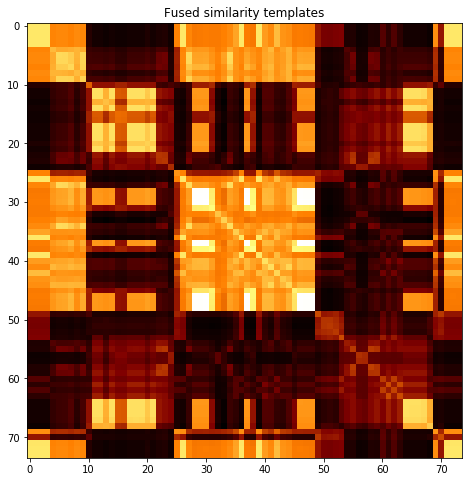

subject 09; gesture 2_1_2


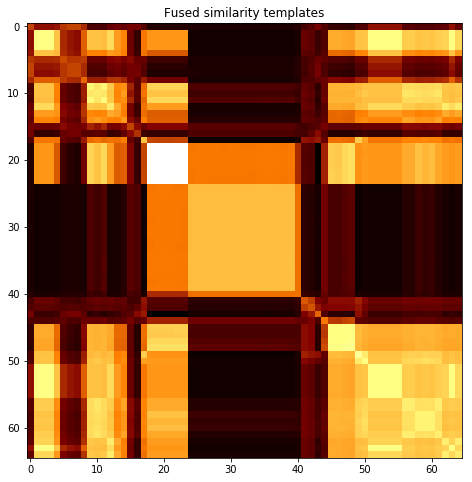

subject 09; gesture 4_0_1


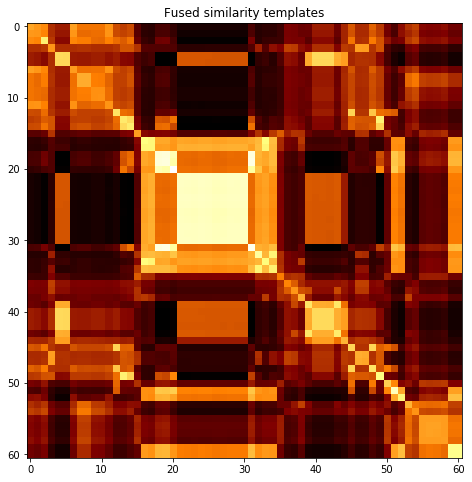

subject 09; gesture 3_0_2


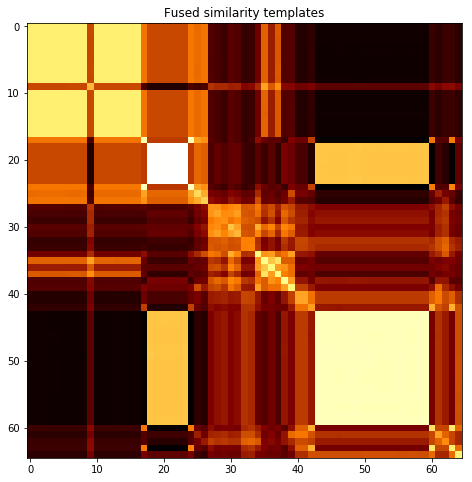

subject 09; gesture 1_1_1


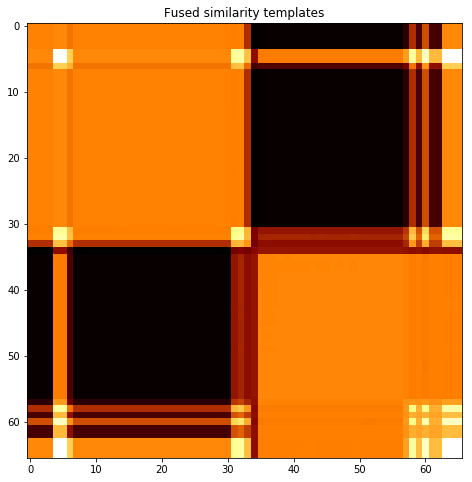

subject 09; gesture 3_1_2


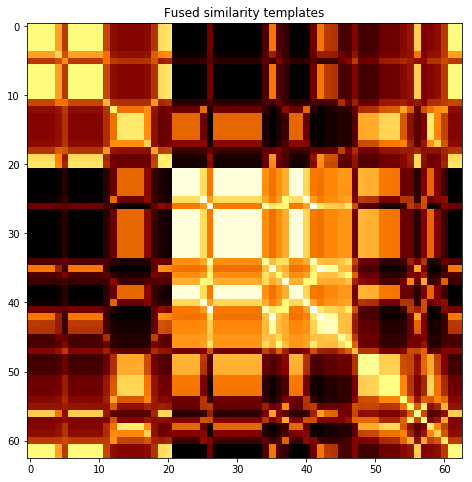

subject 09; gesture 2_1_1


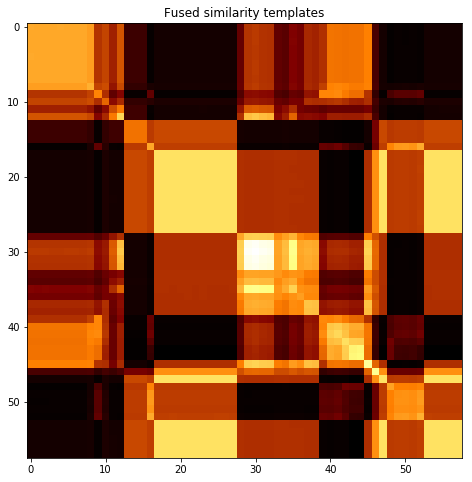

subject 09; gesture 1_0_1


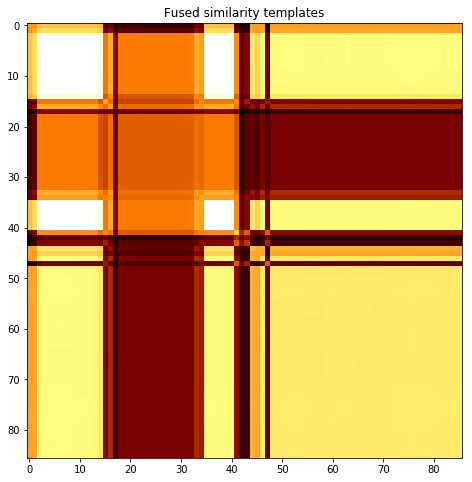

subject 09; gesture 3_1_1


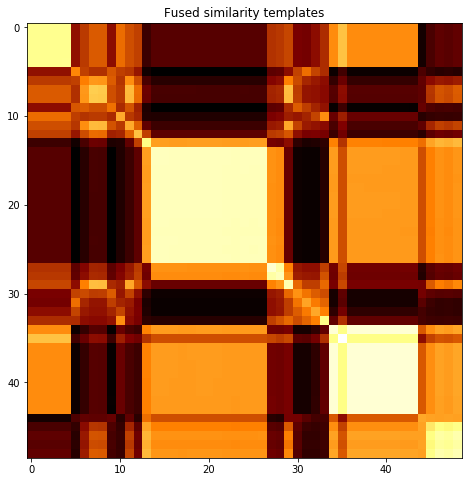

subject 09; gesture 1_0_2


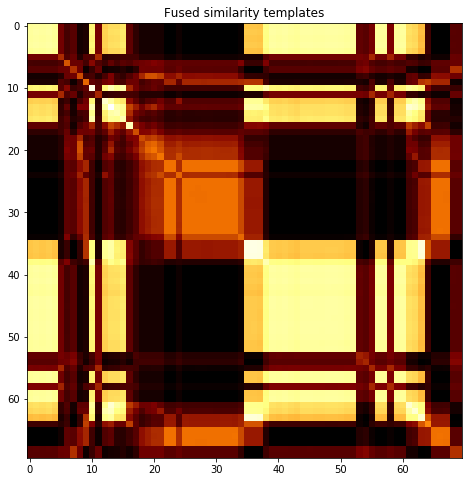

subject 09; gesture 4_0_2


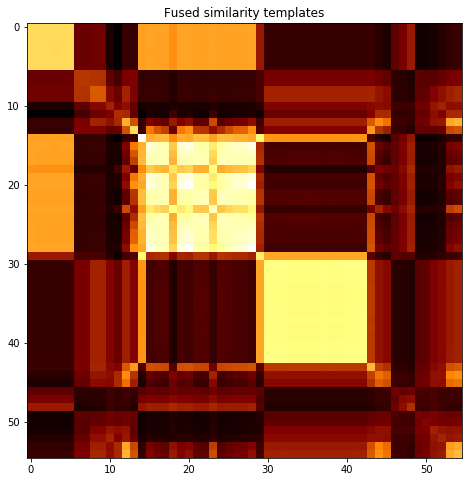

subject 03; gesture 3_0_1


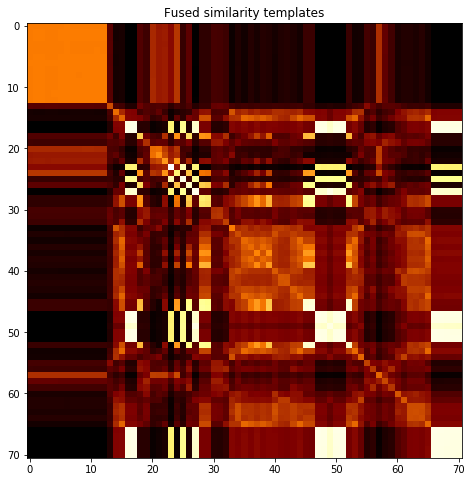

subject 03; gesture 4_1_1


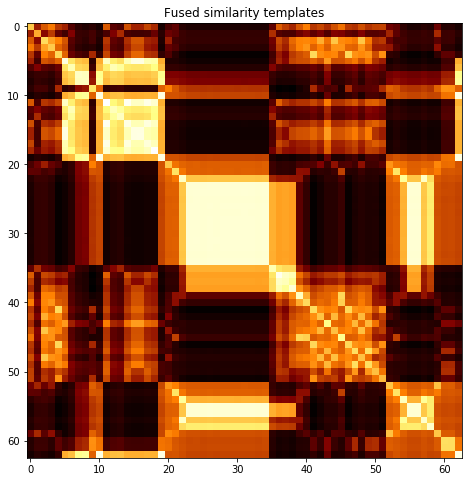

subject 03; gesture 2_0_1


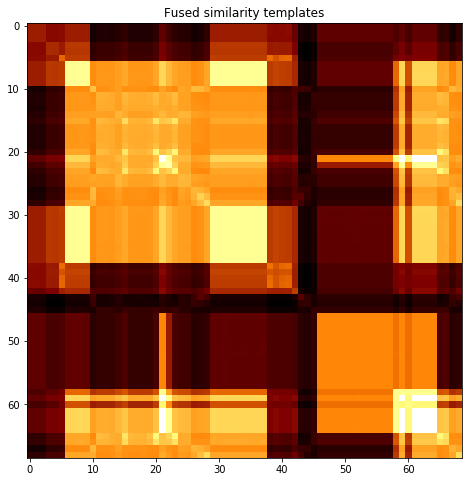

subject 03; gesture 4_1_2


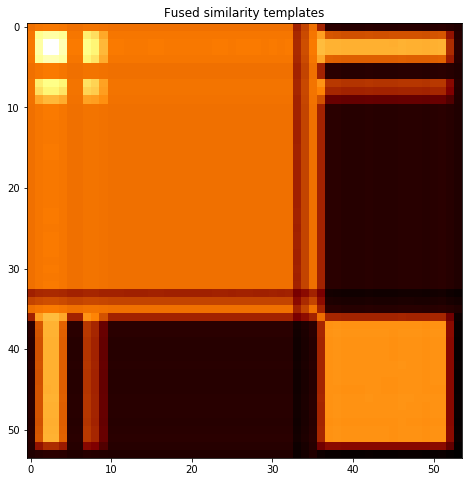

subject 03; gesture 2_0_2


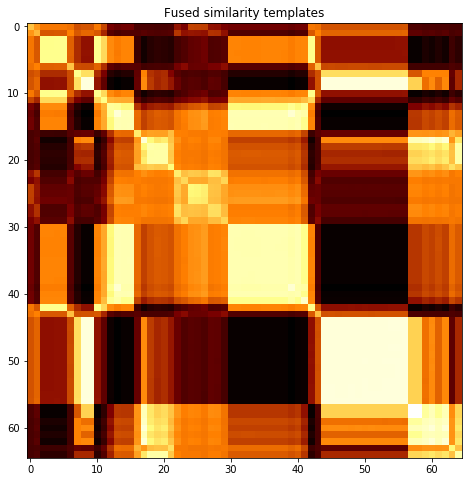

subject 03; gesture 1_1_2


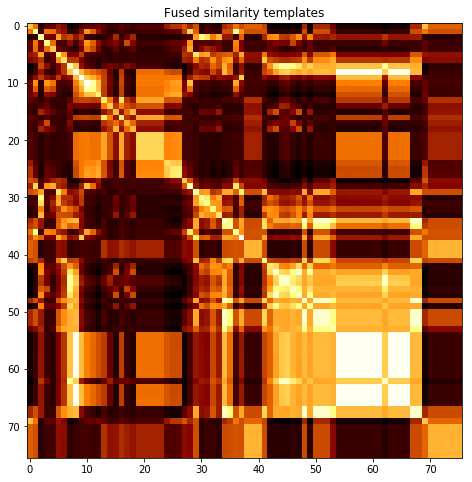

subject 03; gesture 2_1_2


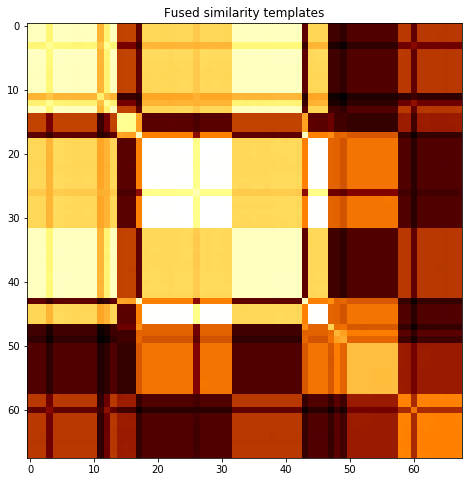

subject 03; gesture 4_0_1


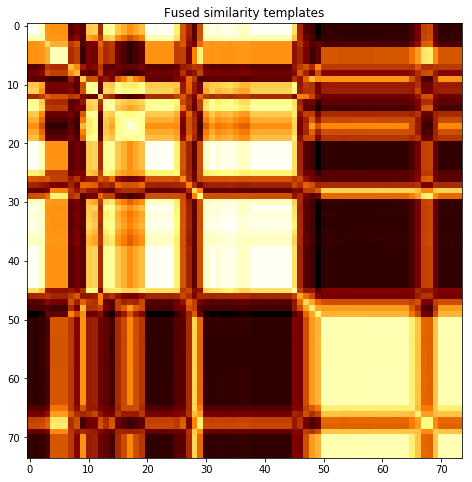

subject 03; gesture 3_0_2


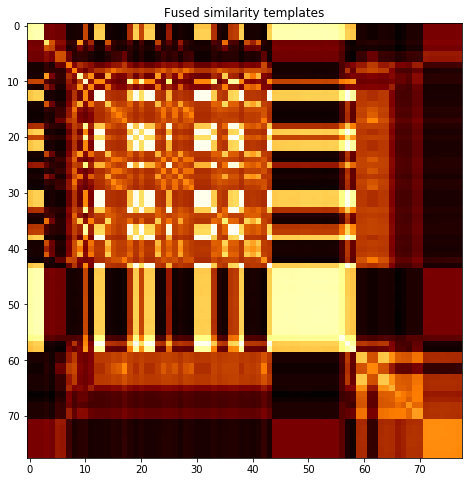

subject 03; gesture 1_1_1


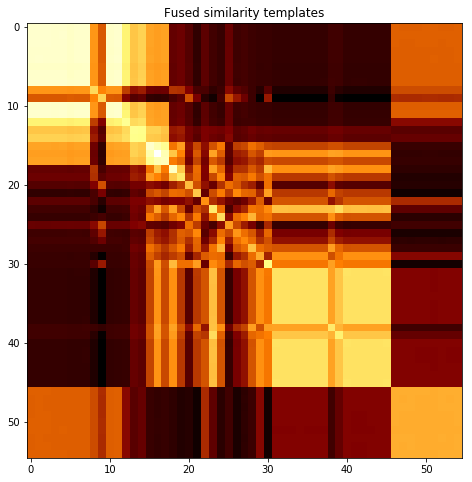

subject 03; gesture 3_1_2


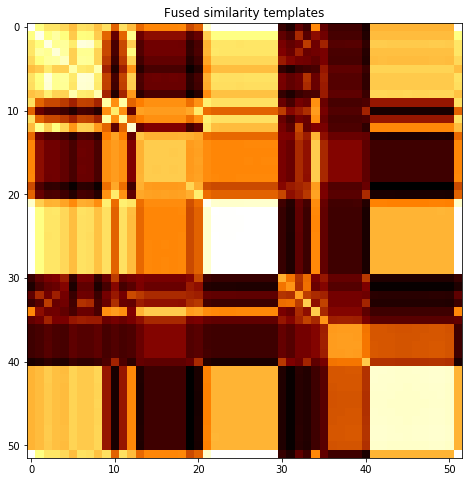

subject 03; gesture 2_1_1


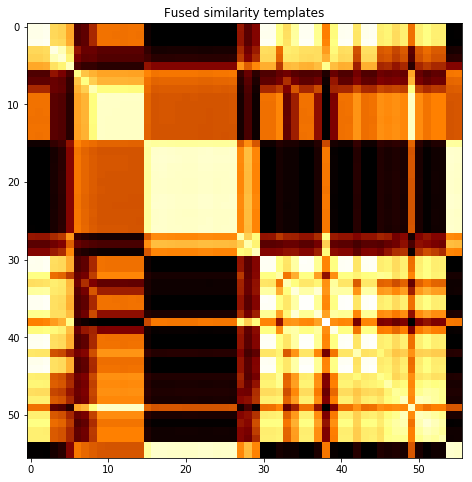

subject 03; gesture 1_0_1


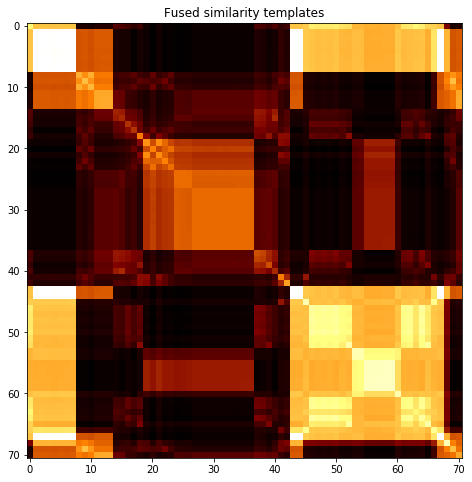

subject 03; gesture 3_1_1


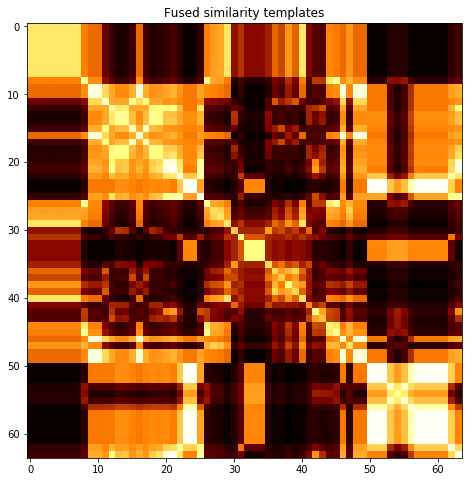

subject 03; gesture 1_0_2


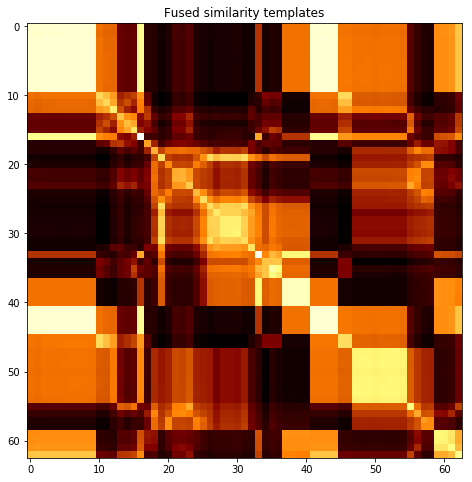

subject 03; gesture 4_0_2


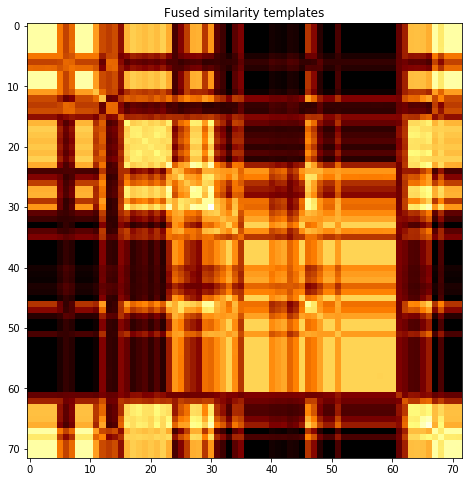

subject 05; gesture 3_0_1


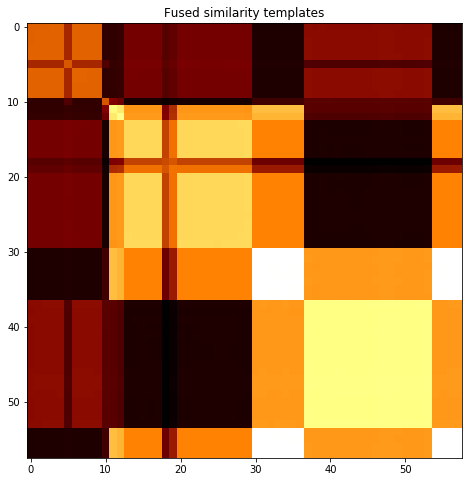

subject 05; gesture 4_1_1


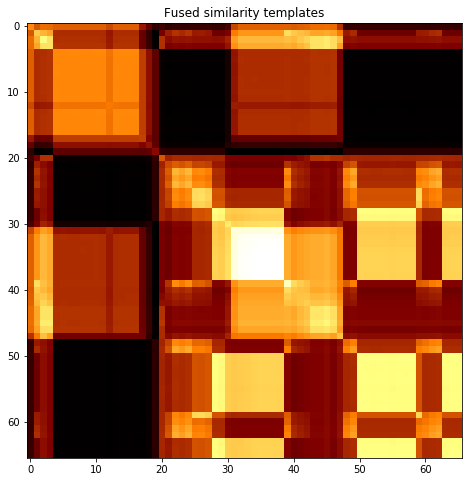

subject 05; gesture 2_0_1


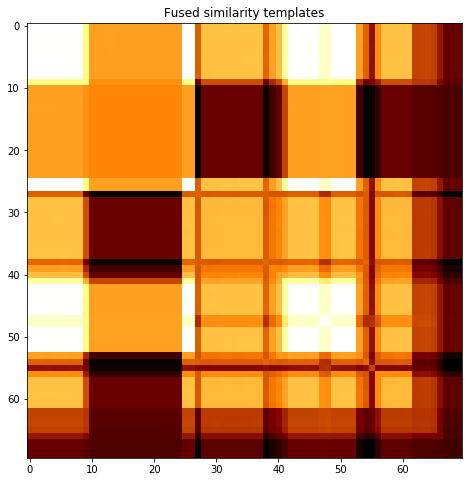

subject 05; gesture 4_1_2


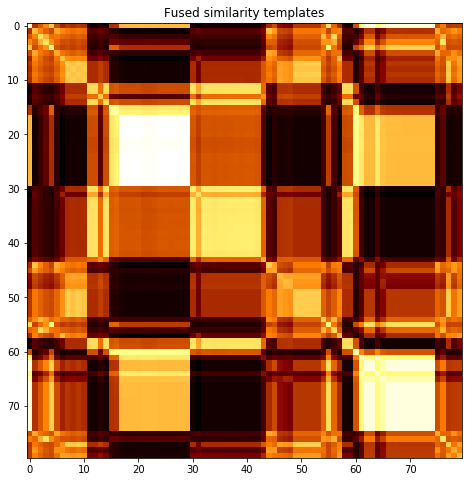

subject 05; gesture 2_0_2


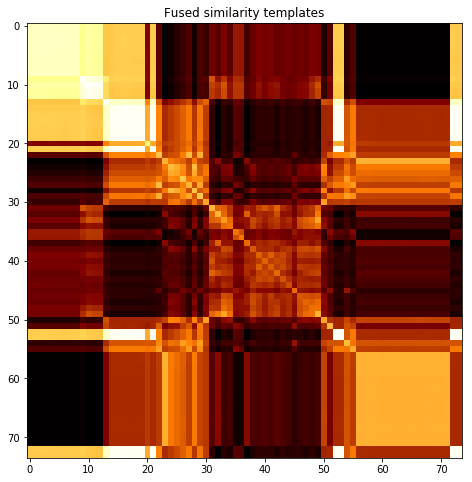

subject 05; gesture 1_1_2


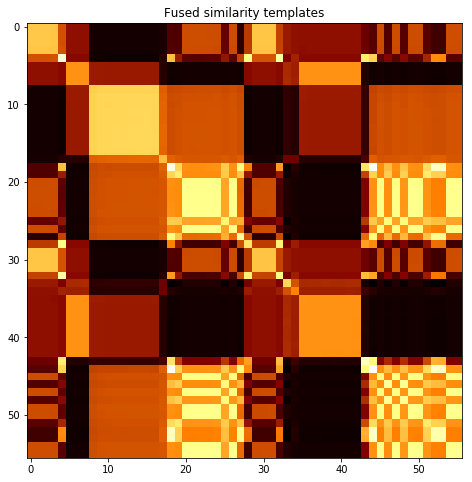

subject 05; gesture 2_1_2


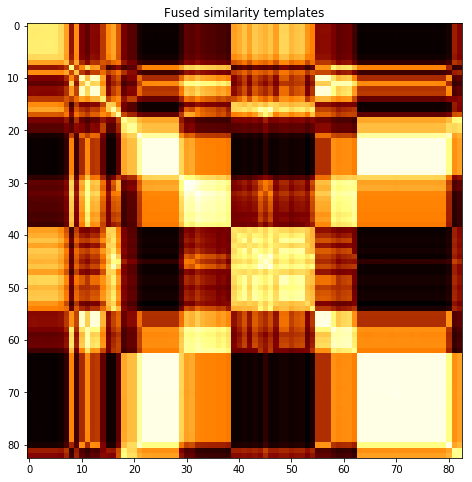

subject 05; gesture 4_0_1


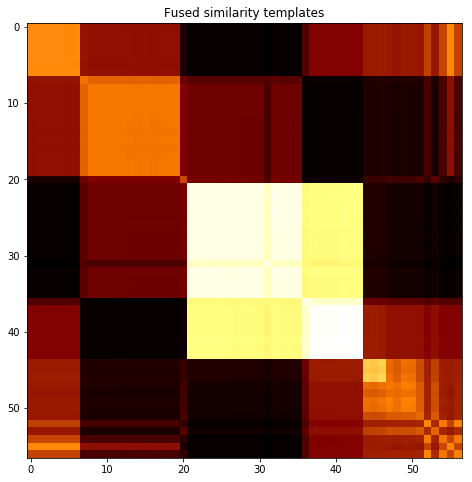

subject 05; gesture 3_0_2


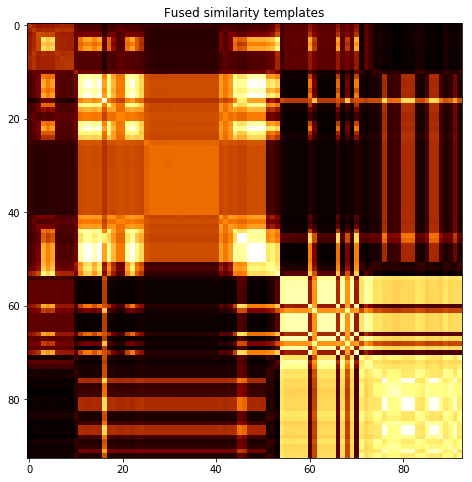

subject 05; gesture 1_1_1


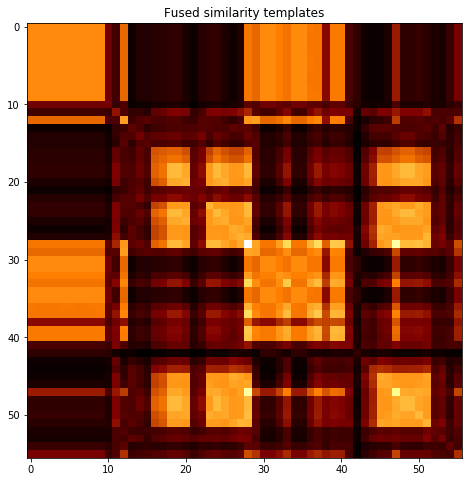

subject 05; gesture 3_1_2


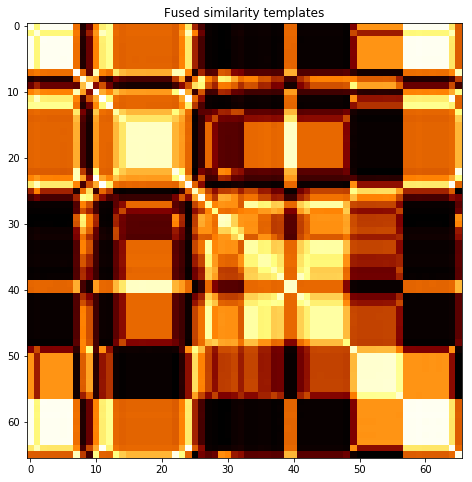

subject 05; gesture 2_1_1


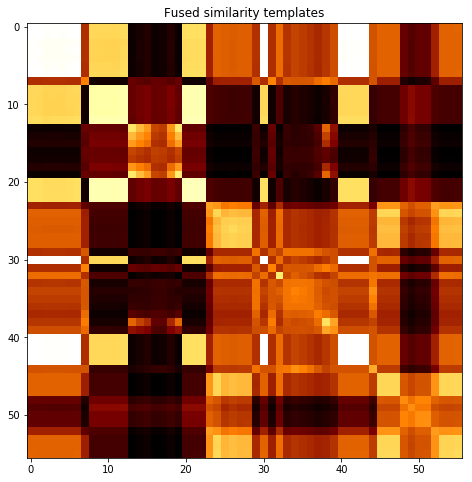

subject 05; gesture 1_0_1


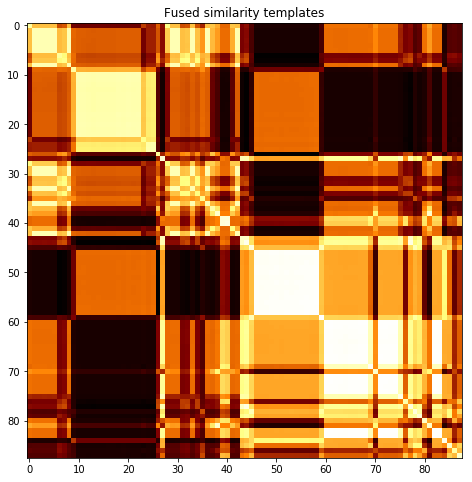

subject 05; gesture 3_1_1


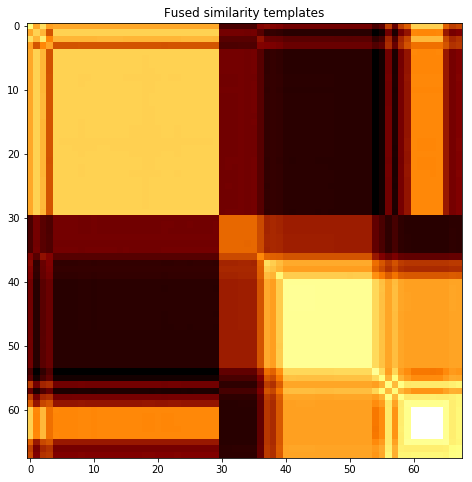

subject 05; gesture 1_0_2


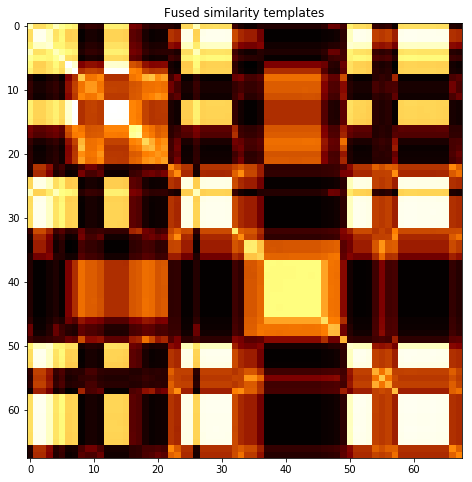

subject 05; gesture 4_0_2


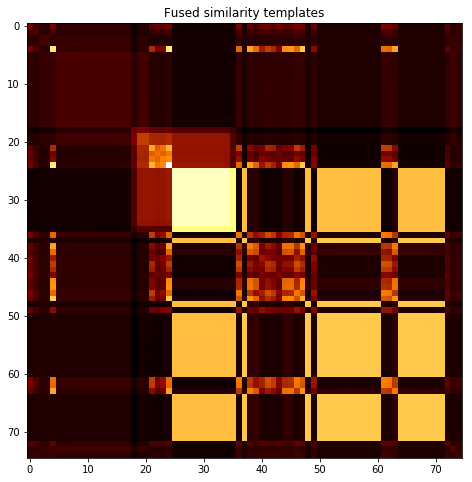

subject 21; gesture 3_0_1


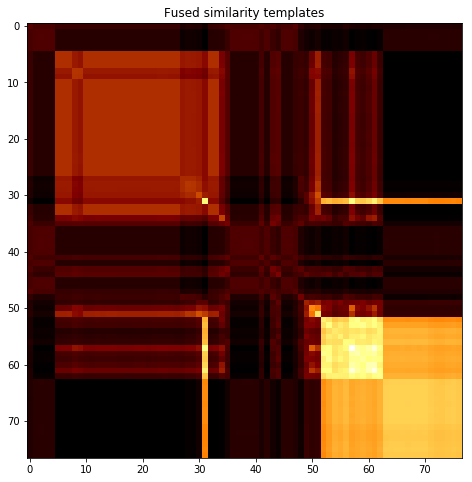

subject 21; gesture 4_1_1


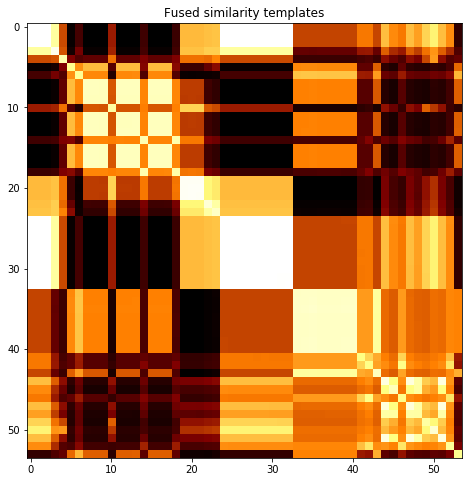

subject 21; gesture 2_0_1


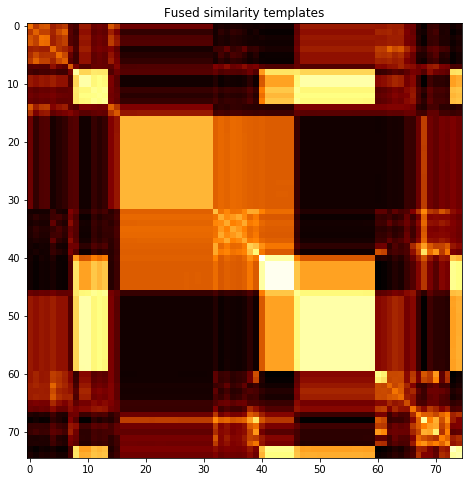

subject 21; gesture 4_1_2


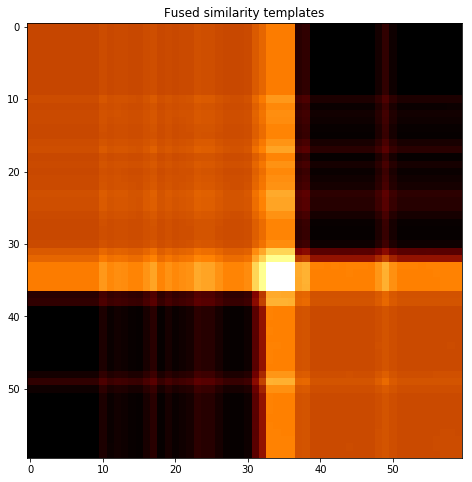

subject 21; gesture 2_0_2


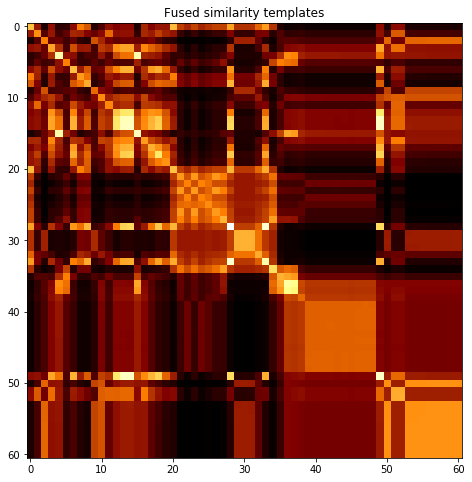

subject 21; gesture 1_1_2


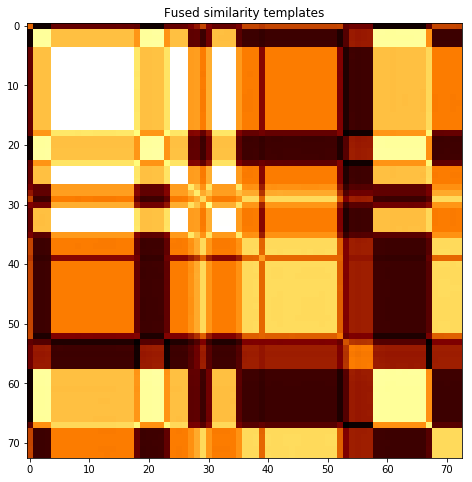

subject 21; gesture 2_1_2


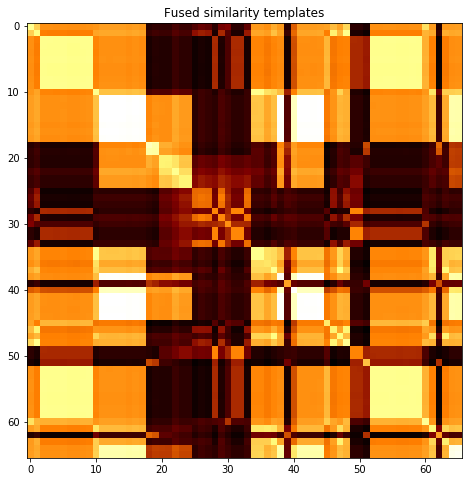

subject 21; gesture 4_0_1


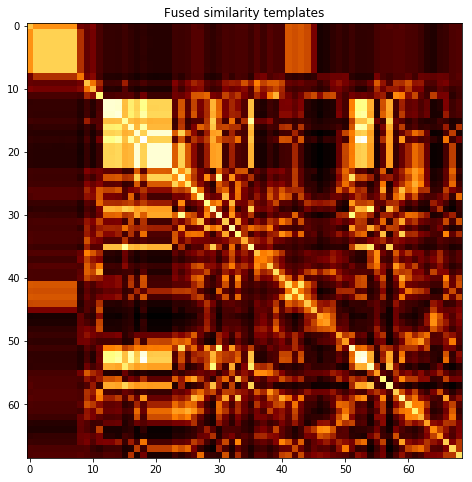

subject 21; gesture 3_0_2


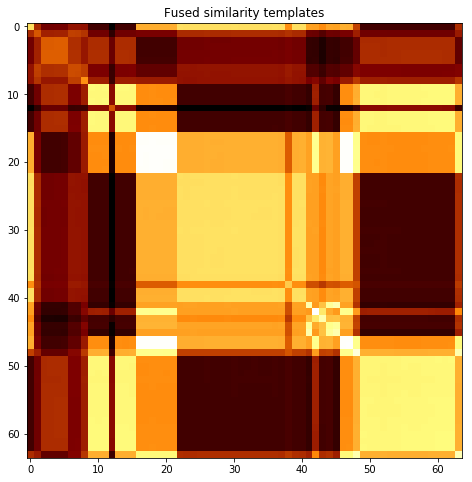

subject 21; gesture 1_1_1


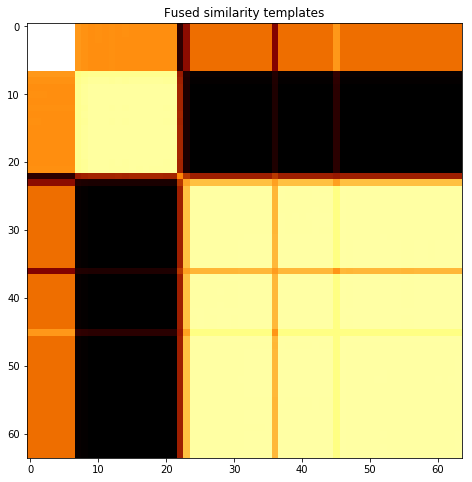

subject 21; gesture 3_1_2


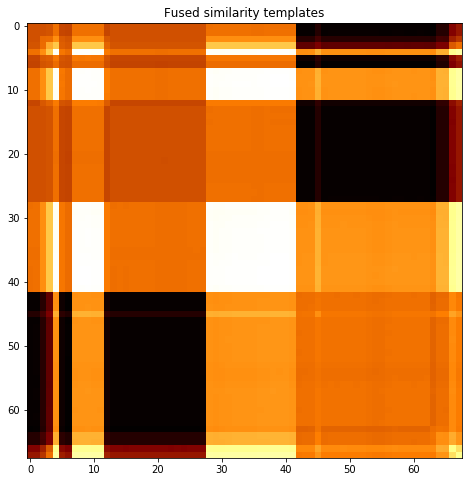

subject 21; gesture 2_1_1


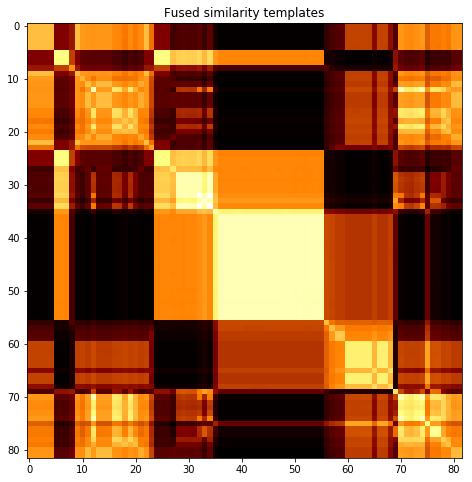

subject 21; gesture 1_0_1


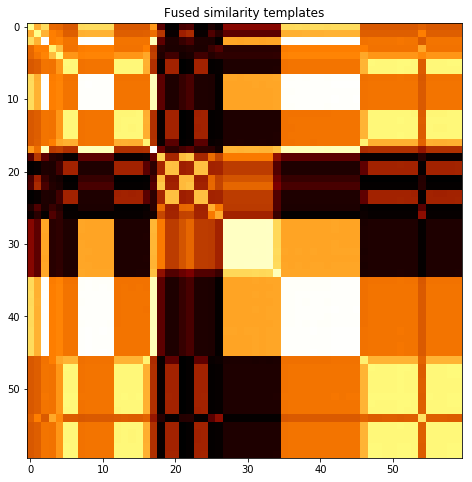

subject 21; gesture 3_1_1


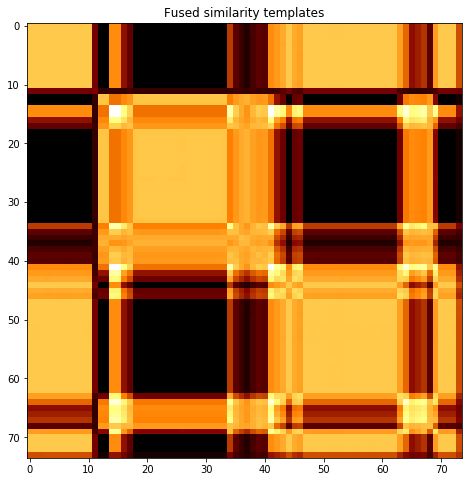

subject 21; gesture 1_0_2


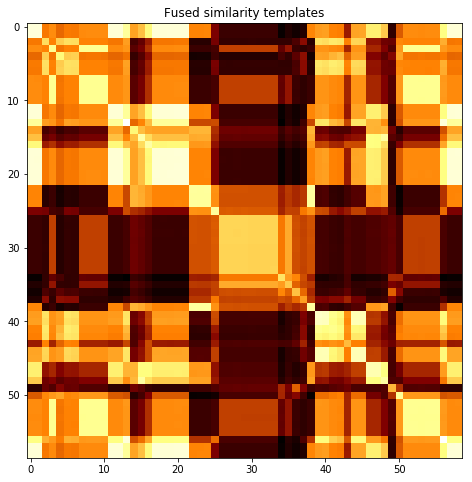

subject 21; gesture 4_0_2


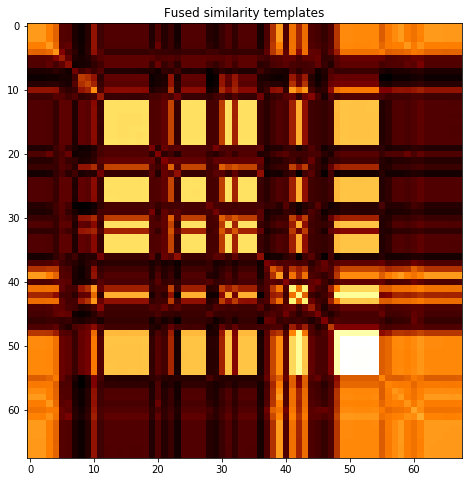

subject 17; gesture 3_0_1


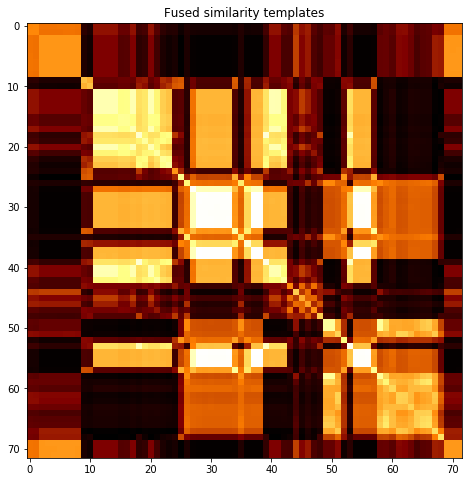

subject 17; gesture 4_1_1


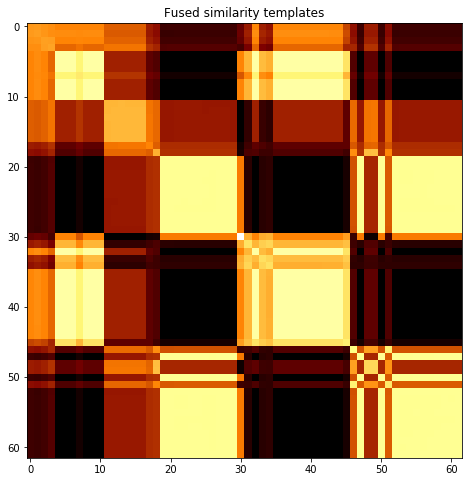

subject 17; gesture 2_0_1


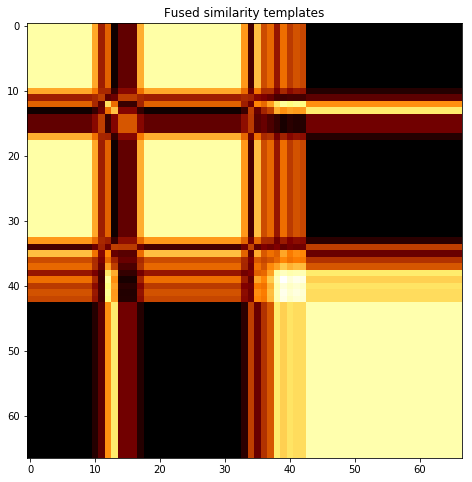

subject 17; gesture 4_1_2


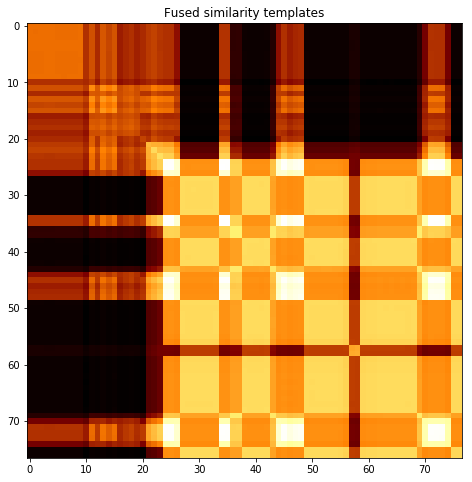

subject 17; gesture 2_0_2


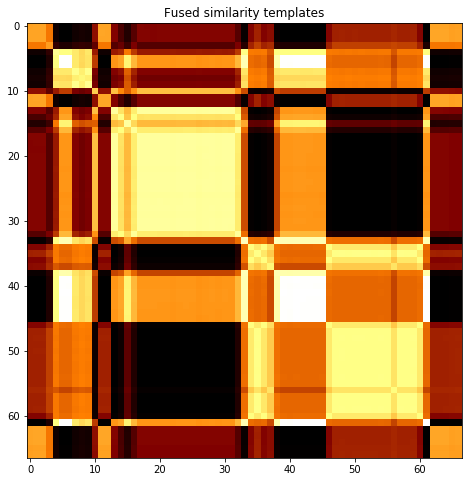

subject 17; gesture 1_1_2


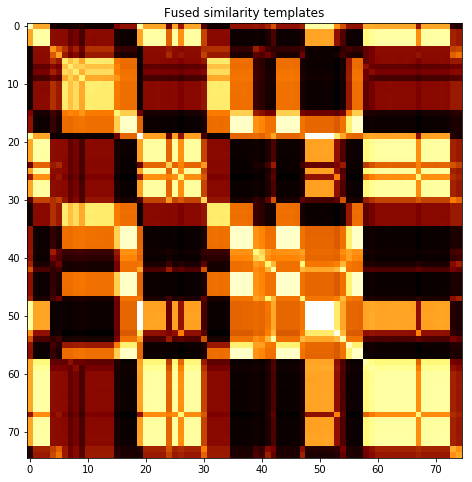

subject 17; gesture 2_1_2


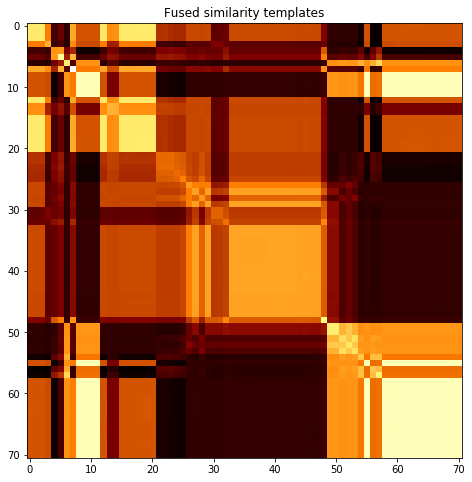

subject 17; gesture 4_0_1


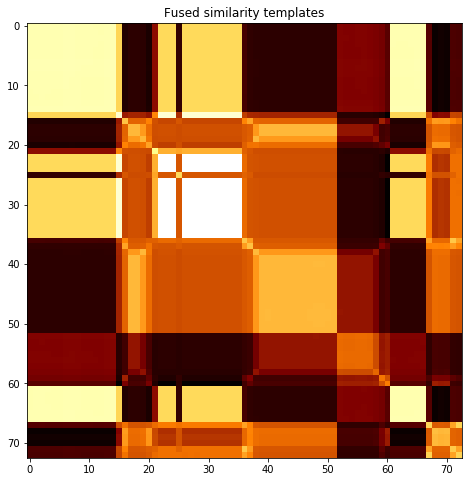

subject 17; gesture 3_0_2


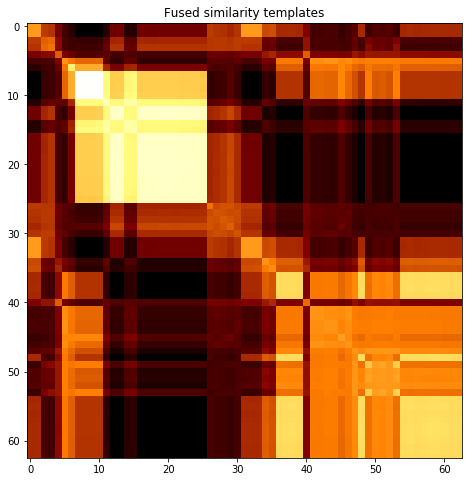

subject 17; gesture 1_1_1


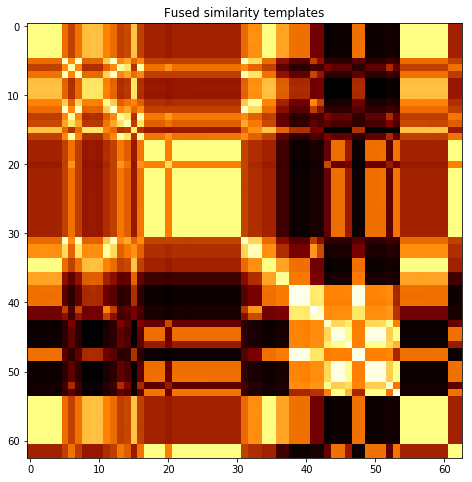

subject 17; gesture 3_1_2


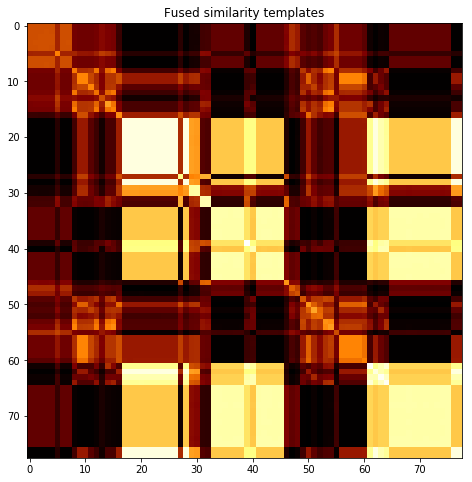

subject 17; gesture 2_1_1


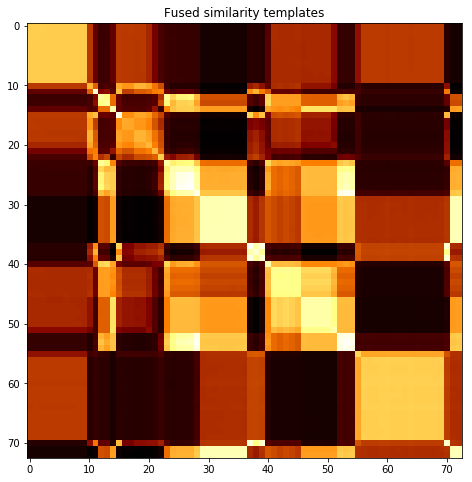

subject 17; gesture 1_0_1


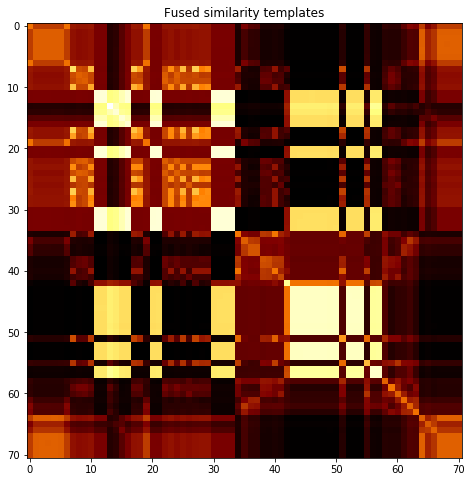

subject 17; gesture 3_1_1


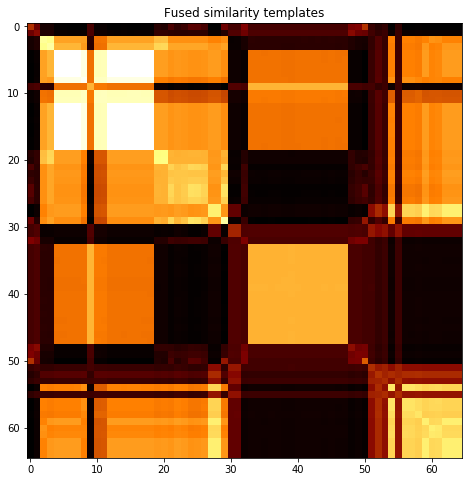

subject 17; gesture 1_0_2


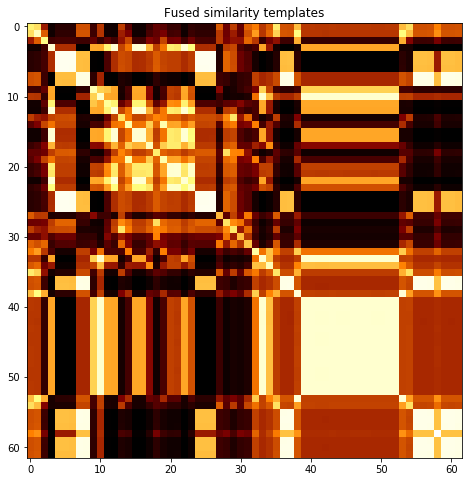

subject 17; gesture 4_0_2


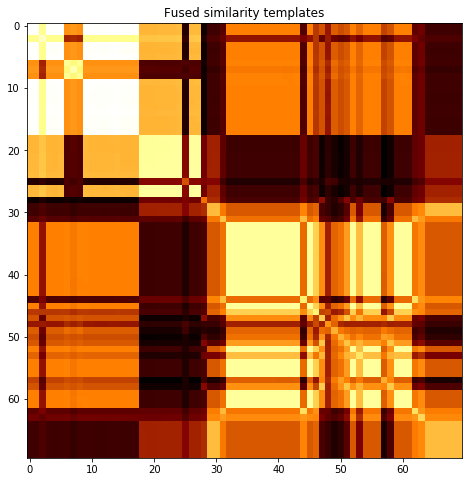

subject 01; gesture 3_0_1


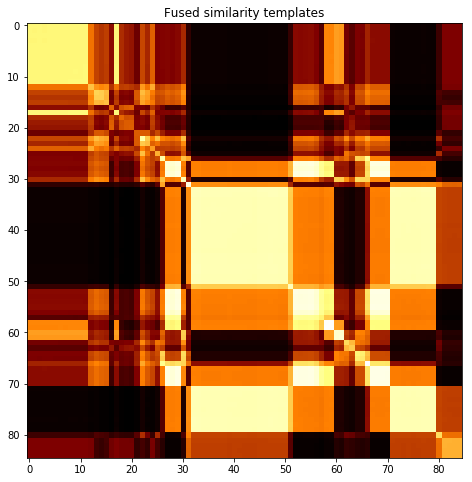

subject 01; gesture 4_1_1


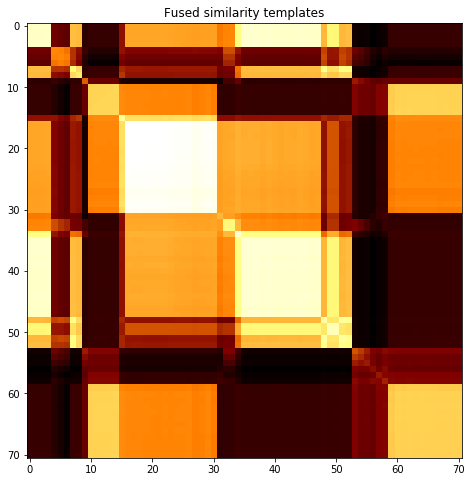

subject 01; gesture 2_0_1


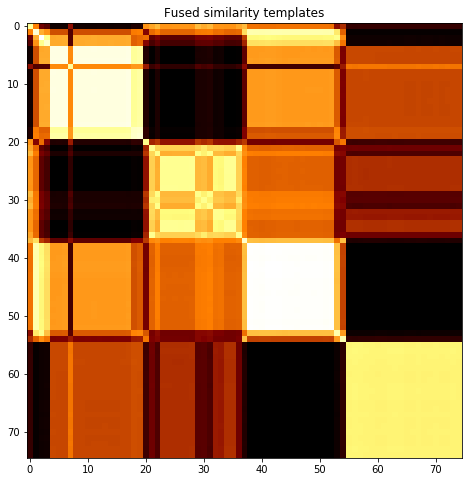

subject 01; gesture 4_1_2


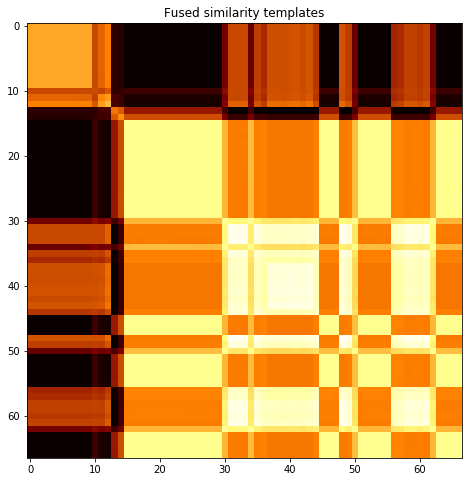

subject 01; gesture 2_0_2


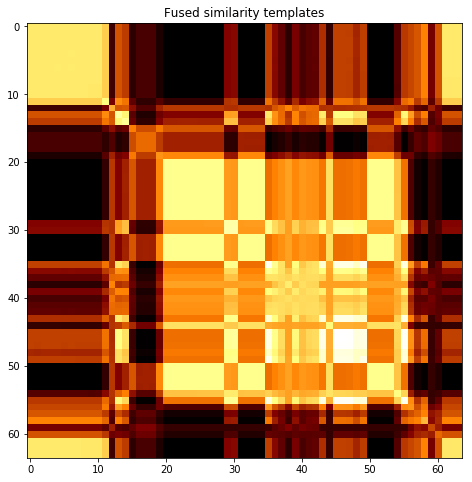

subject 01; gesture 1_1_2


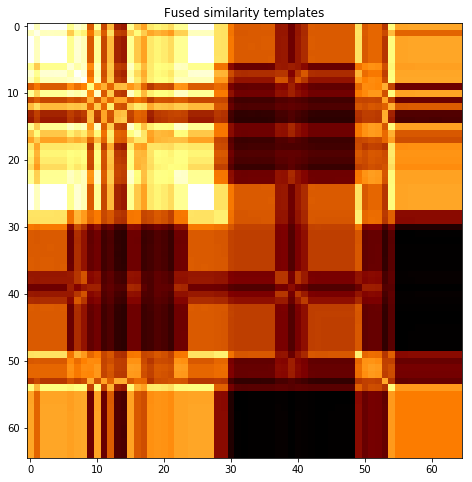

subject 01; gesture 2_1_2


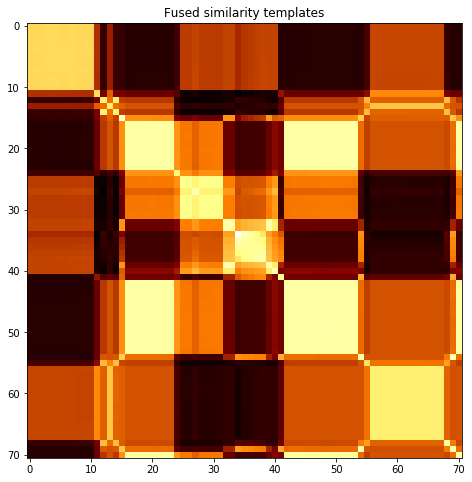

subject 01; gesture 4_0_1


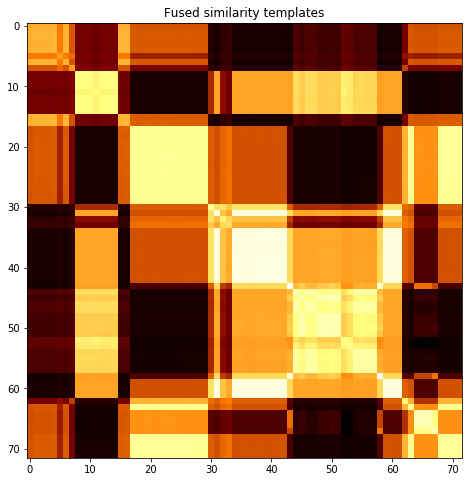

subject 01; gesture 3_0_2


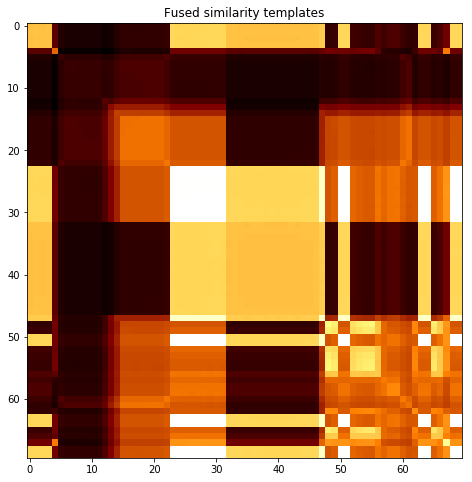

subject 01; gesture 1_1_1


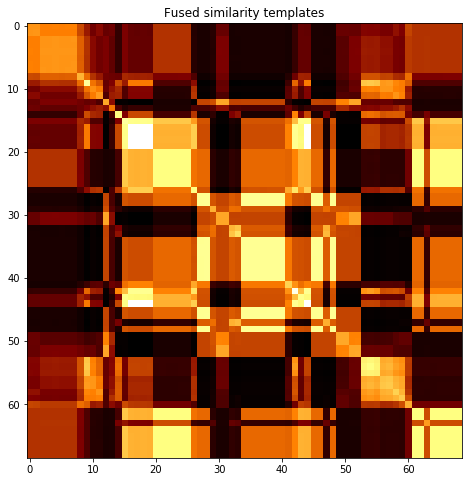

subject 01; gesture 3_1_2


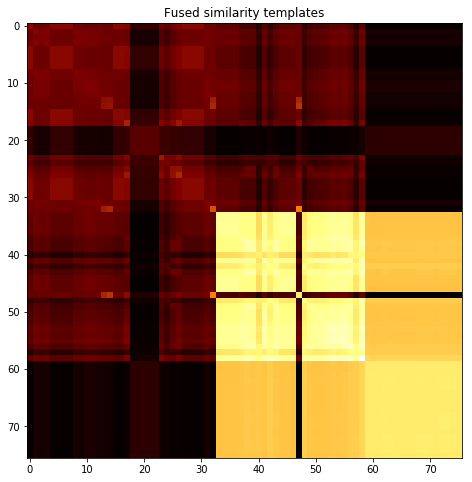

subject 01; gesture 2_1_1


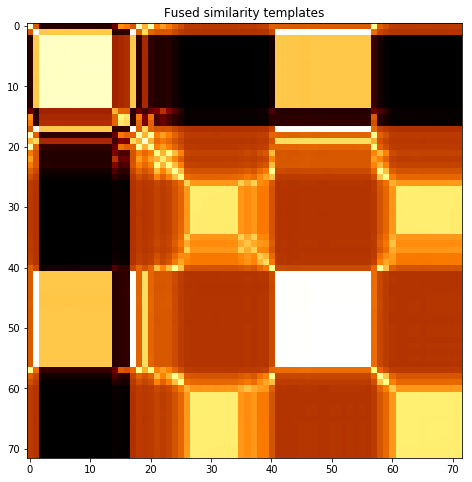

subject 01; gesture 1_0_1


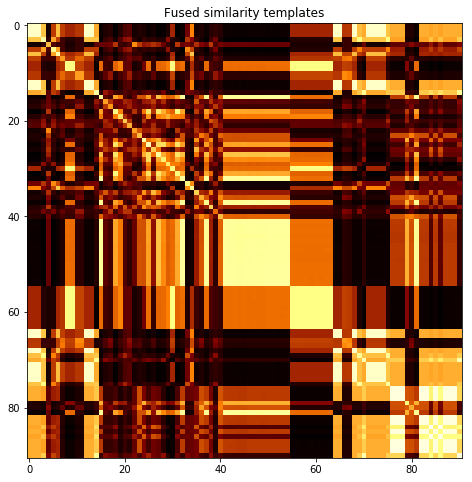

subject 01; gesture 3_1_1


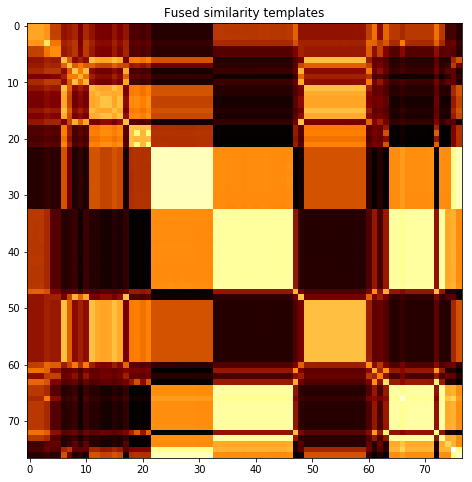

subject 01; gesture 1_0_2


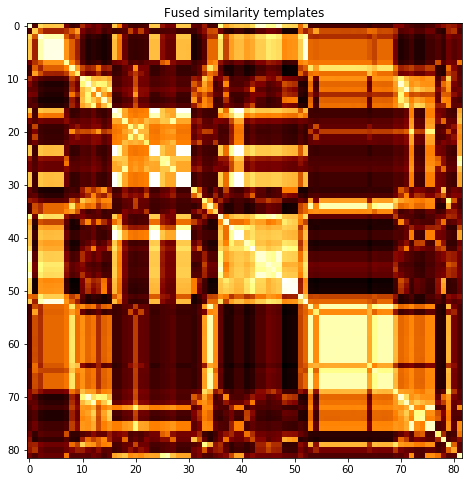

subject 01; gesture 4_0_2


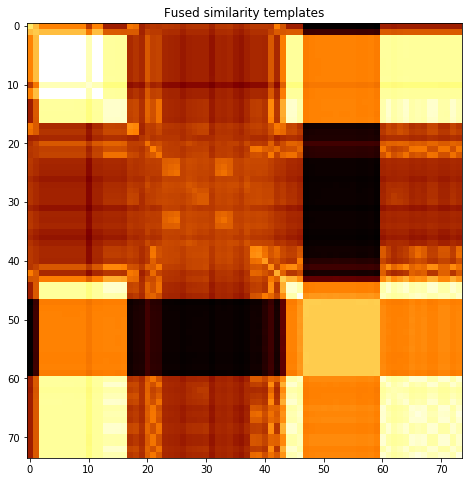

subject 16; gesture 3_0_1


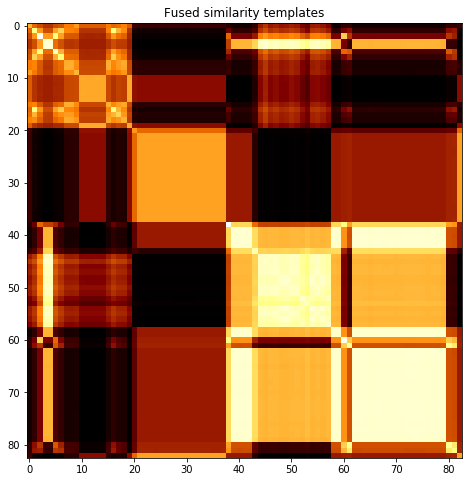

subject 16; gesture 4_1_1


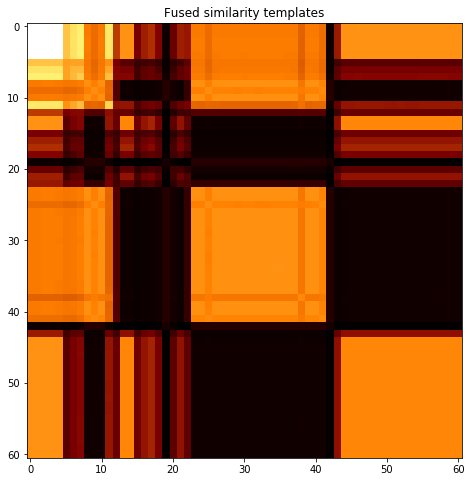

subject 16; gesture 2_0_1


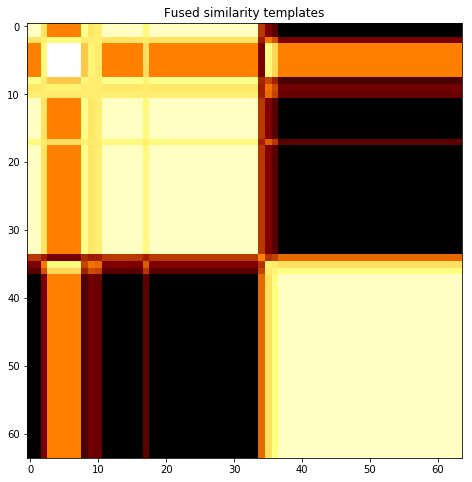

subject 16; gesture 4_1_2


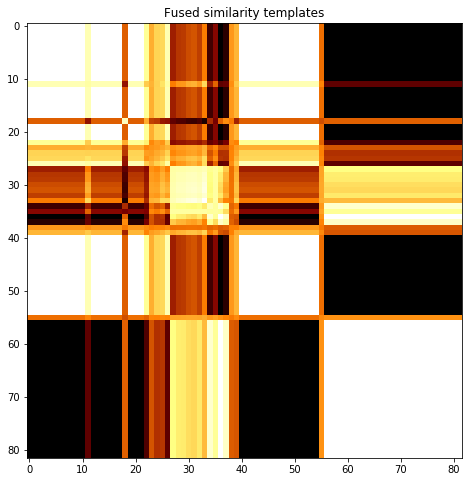

subject 16; gesture 2_0_2


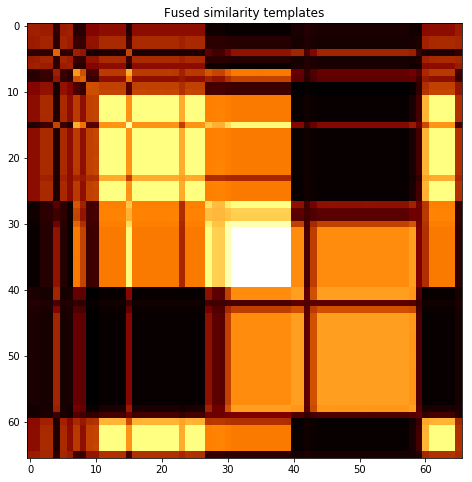

subject 16; gesture 1_1_2


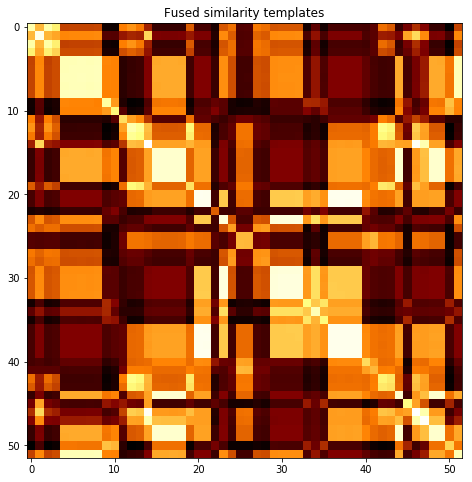

subject 16; gesture 2_1_2


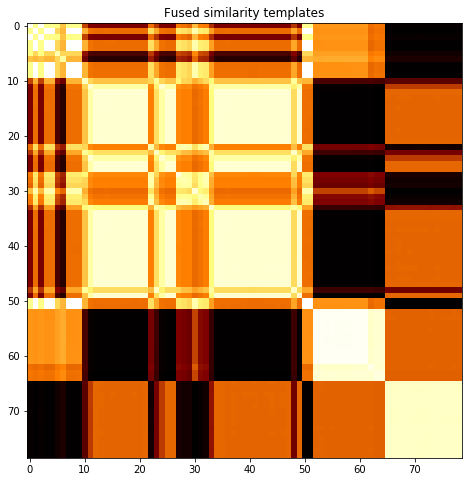

subject 16; gesture 4_0_1


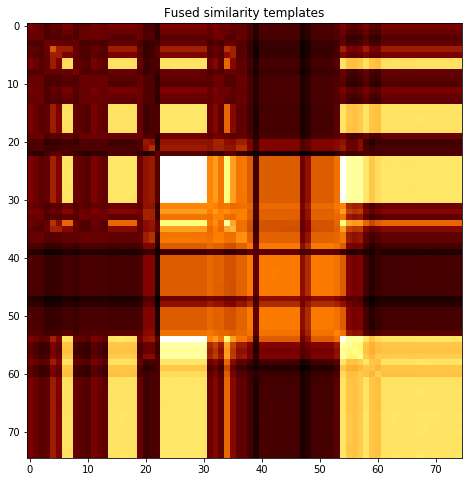

subject 16; gesture 3_0_2


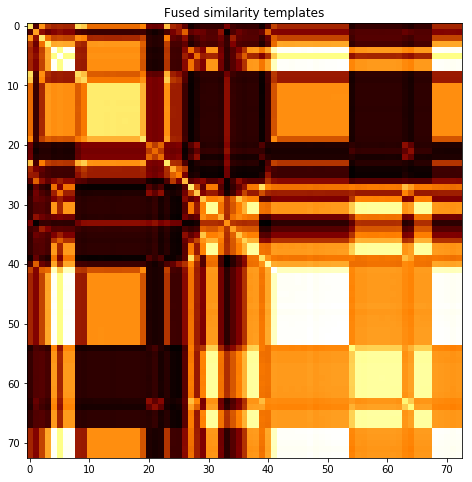

subject 16; gesture 1_1_1


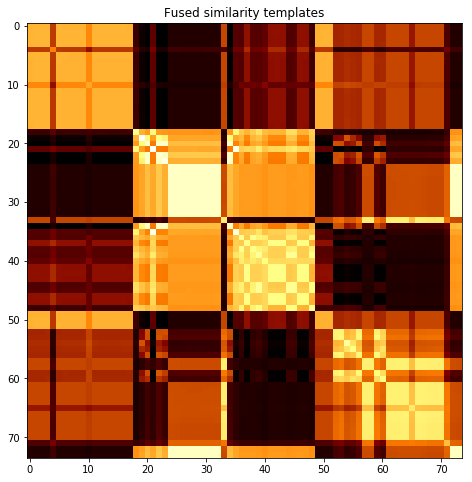

subject 16; gesture 3_1_2


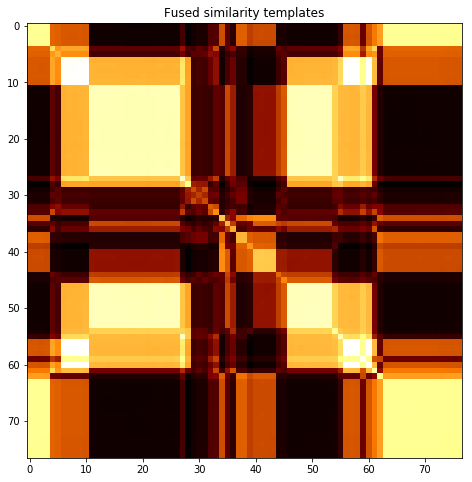

subject 16; gesture 2_1_1


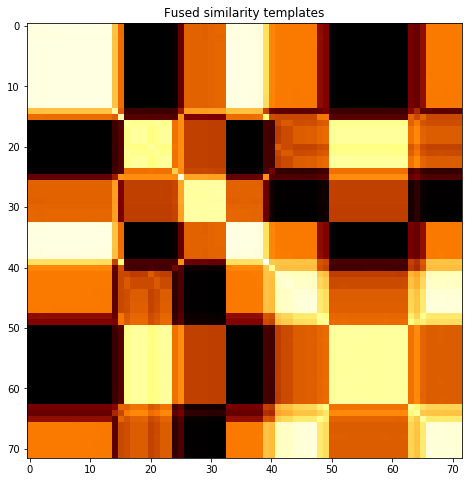

subject 16; gesture 1_0_1


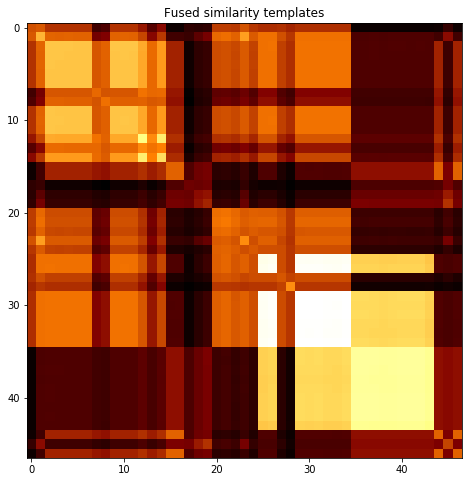

subject 16; gesture 3_1_1


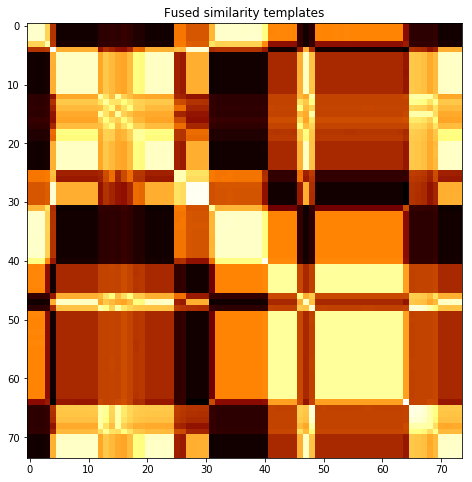

subject 16; gesture 1_0_2


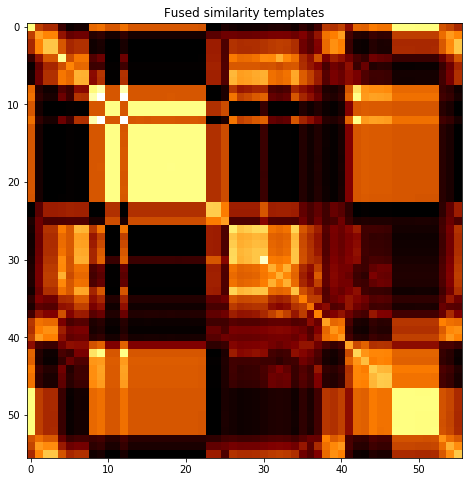

subject 16; gesture 4_0_2


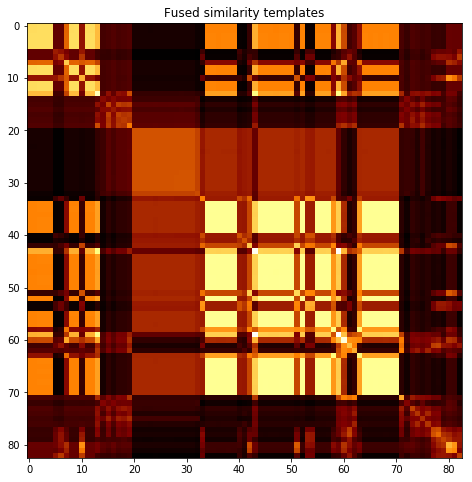

subject 26; gesture 3_0_1


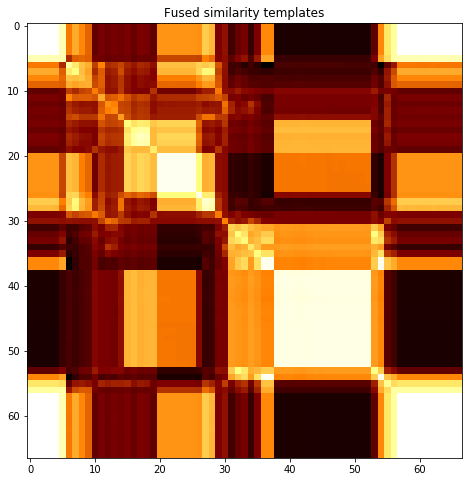

subject 26; gesture 4_1_1


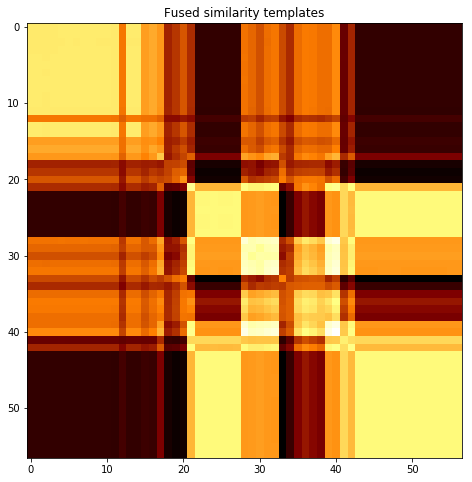

subject 26; gesture 2_0_1


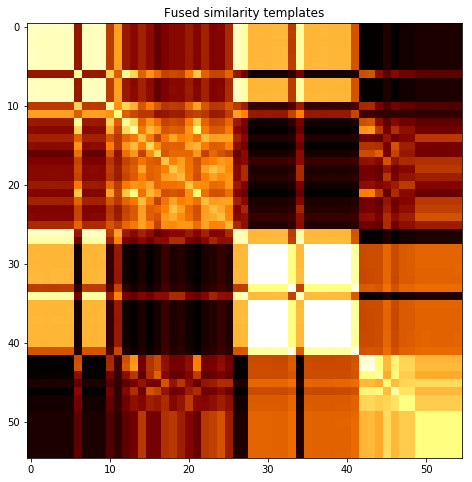

subject 26; gesture 4_1_2


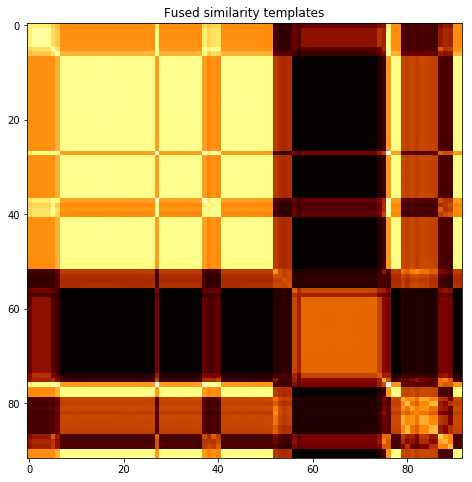

subject 26; gesture 2_0_2


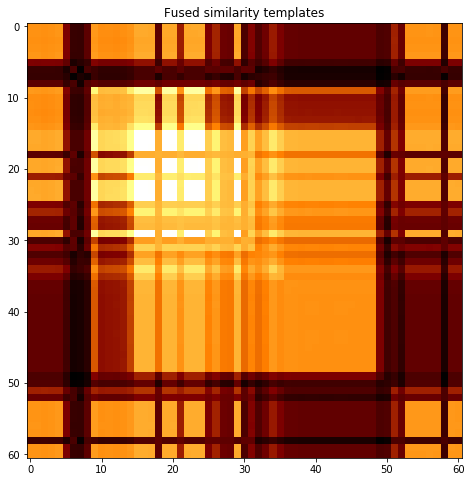

subject 26; gesture 1_1_2


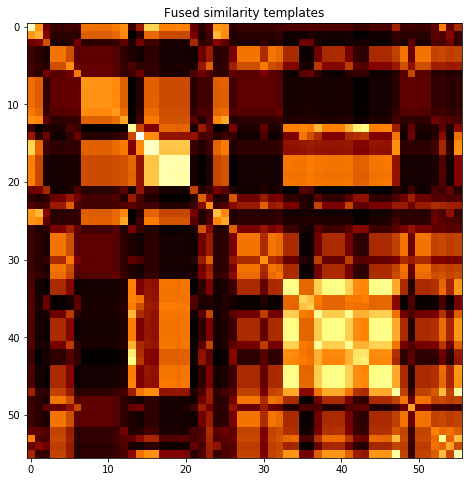

subject 26; gesture 2_1_2


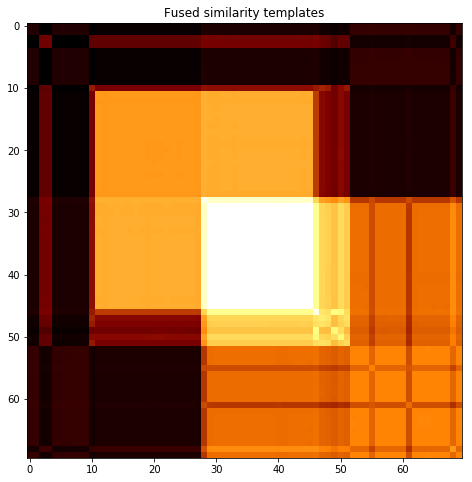

subject 26; gesture 4_0_1


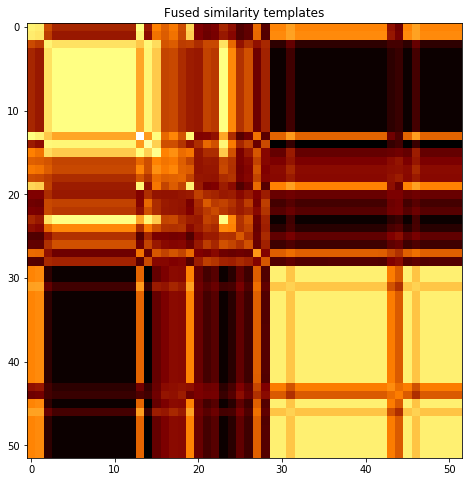

subject 26; gesture 3_0_2


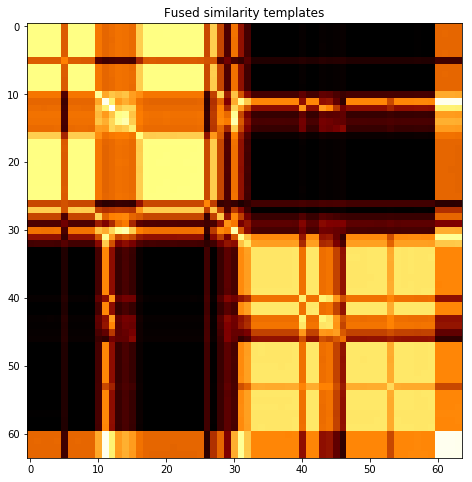

subject 26; gesture 1_1_1


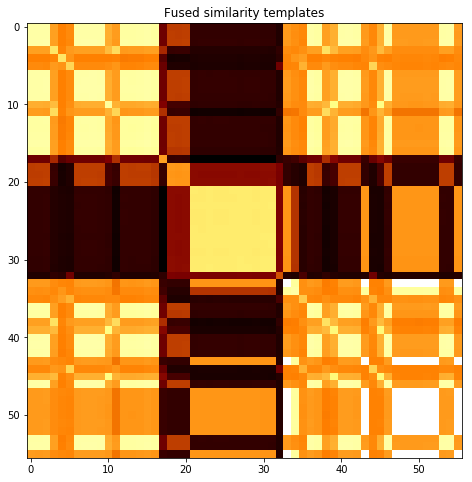

subject 26; gesture 3_1_2


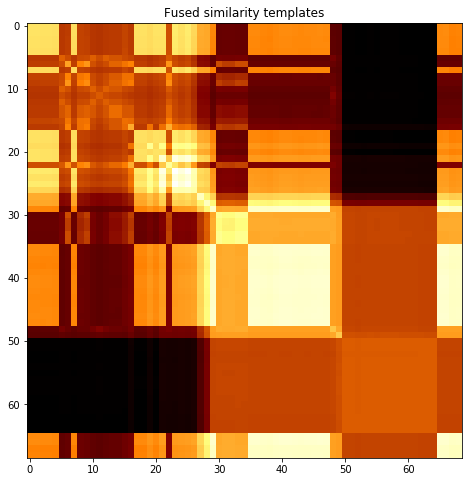

subject 26; gesture 2_1_1


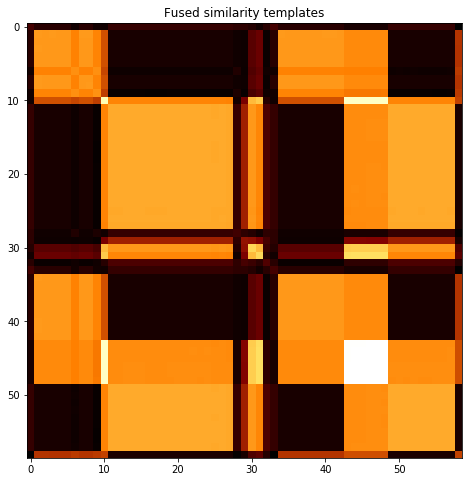

subject 26; gesture 1_0_1


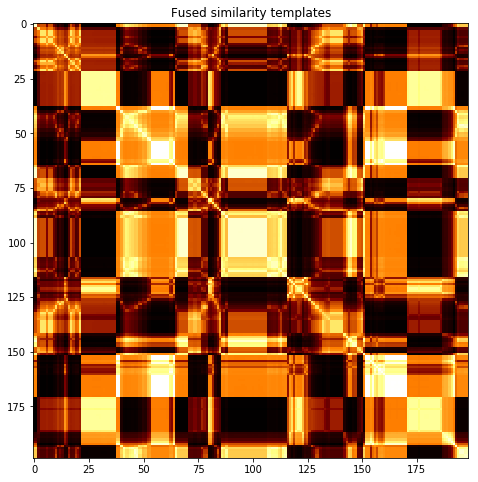

subject 26; gesture 3_1_1


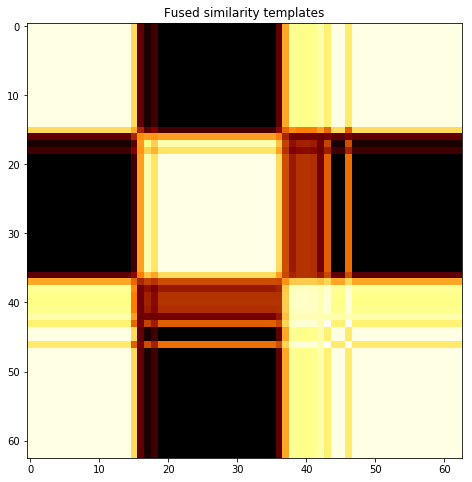

subject 26; gesture 1_0_2


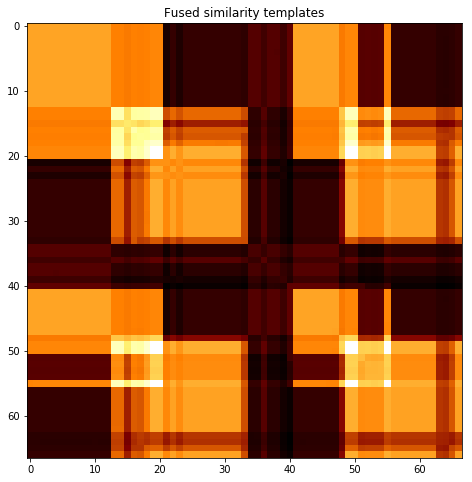

subject 26; gesture 4_0_2


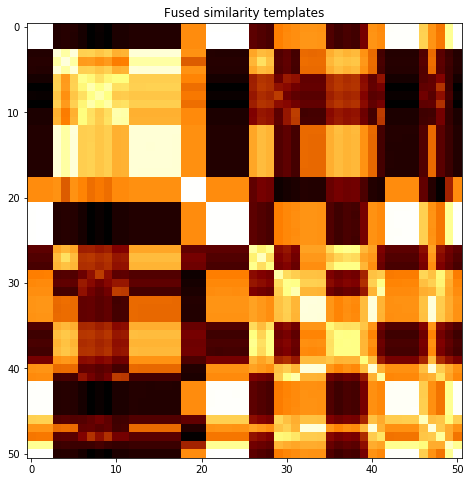

subject 32; gesture 3_0_1


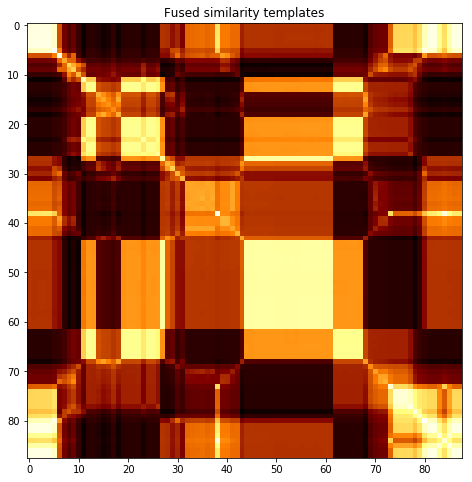

subject 32; gesture 4_1_1


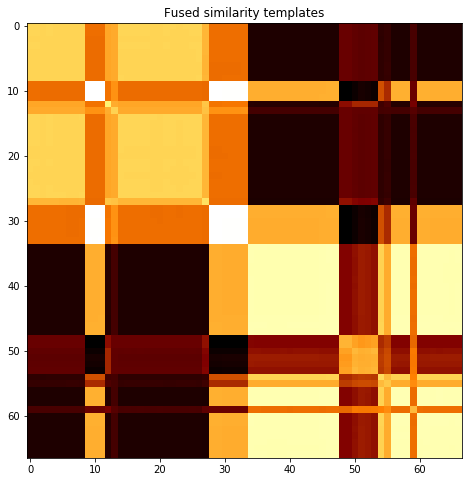

subject 32; gesture 2_0_1


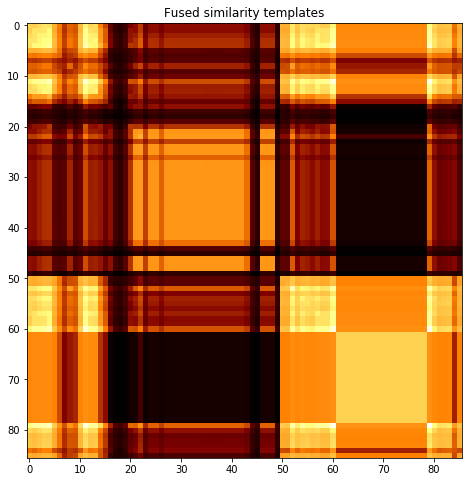

subject 32; gesture 4_1_2


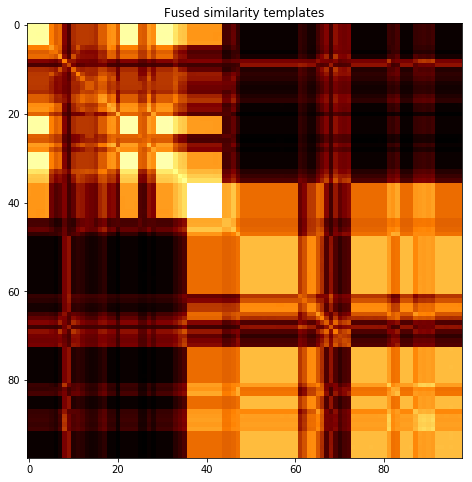

subject 32; gesture 2_0_2


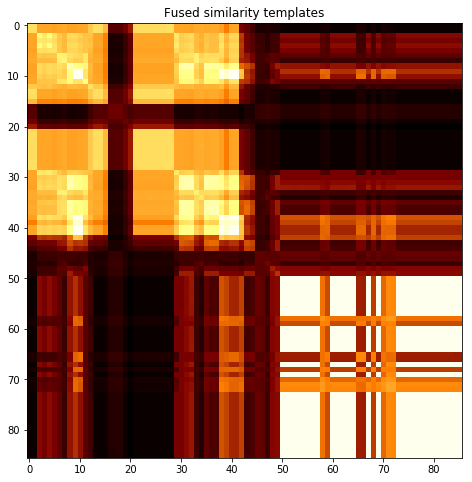

subject 32; gesture 1_1_2


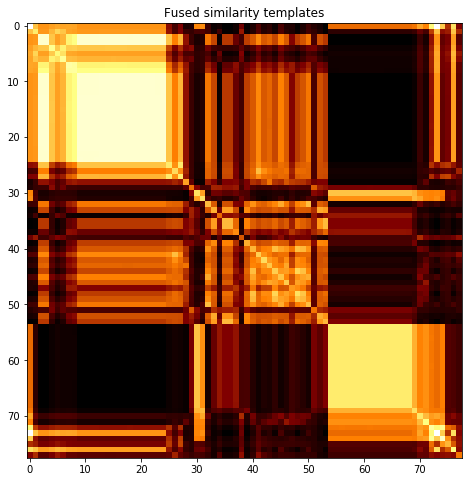

subject 32; gesture 2_1_2


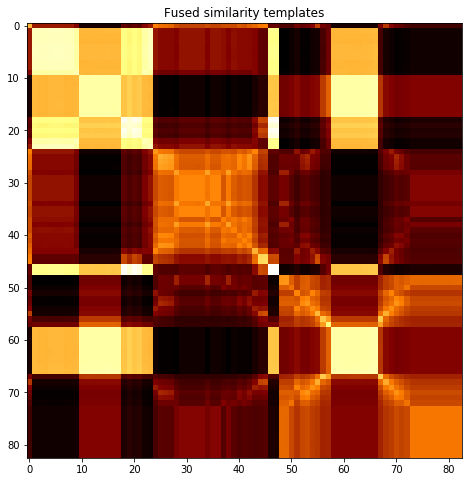

subject 32; gesture 4_0_1


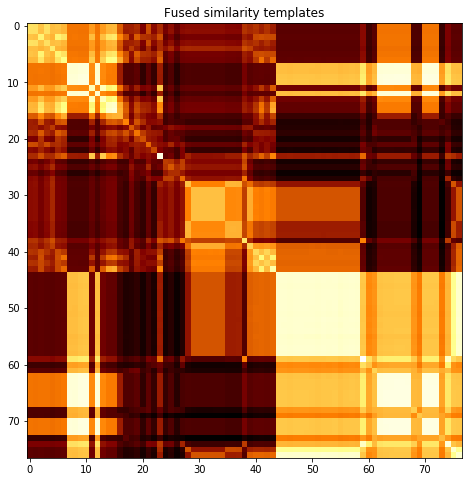

subject 32; gesture 3_0_2


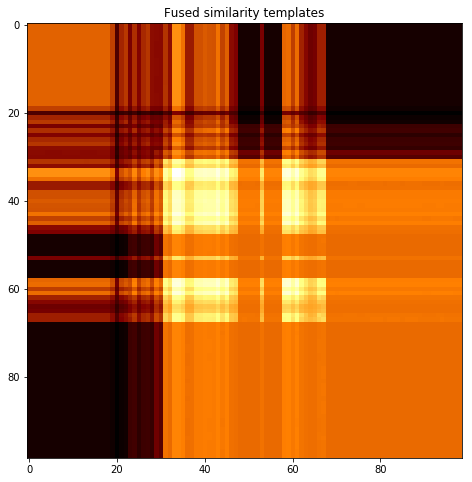

subject 32; gesture 1_1_1


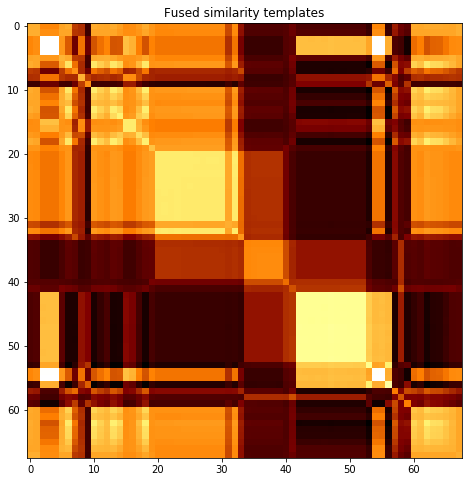

subject 32; gesture 3_1_2


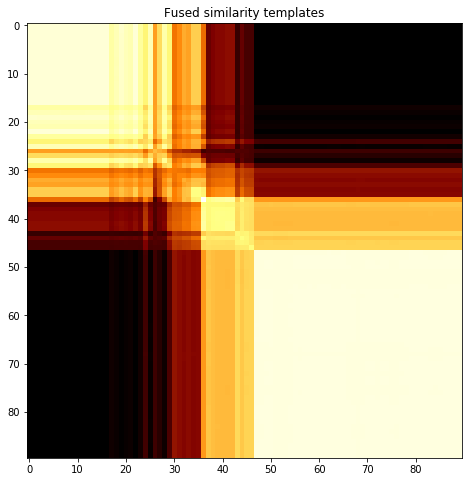

subject 32; gesture 2_1_1


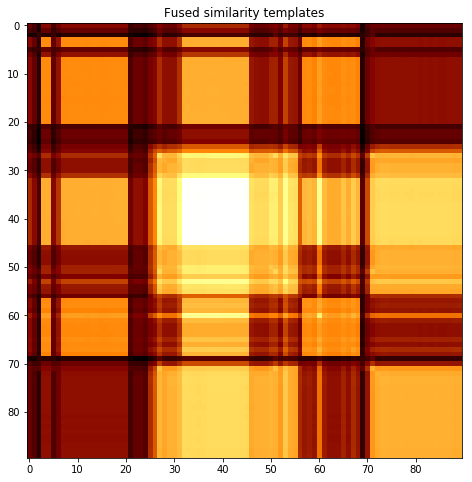

subject 32; gesture 1_0_1


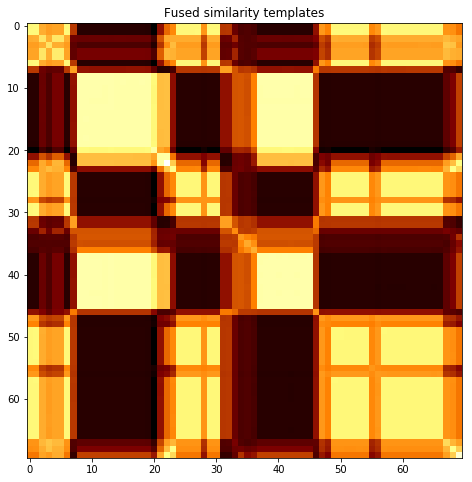

subject 32; gesture 3_1_1


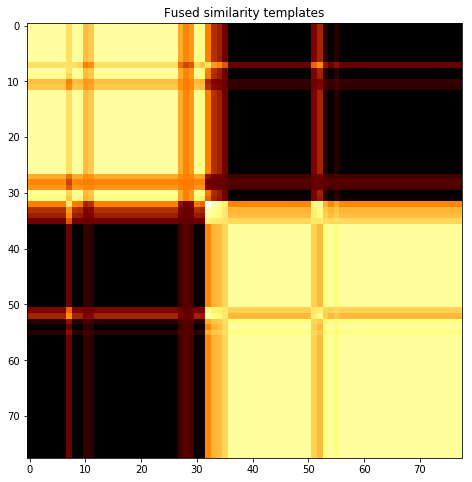

subject 32; gesture 1_0_2


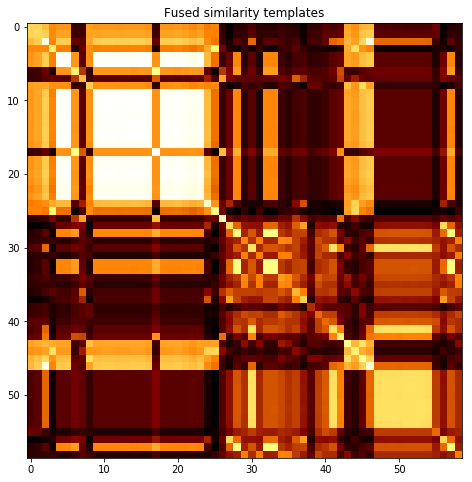

subject 32; gesture 4_0_2


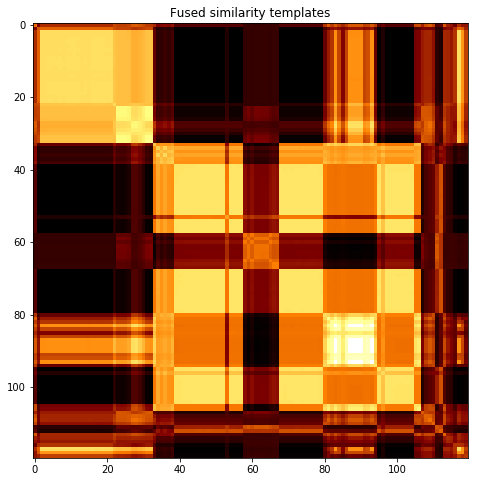

subject 04; gesture 3_0_1


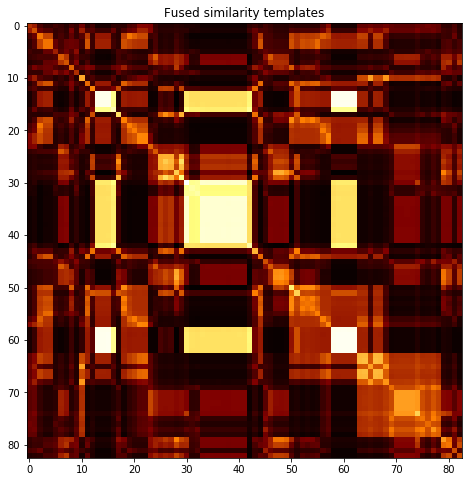

subject 04; gesture 4_1_1


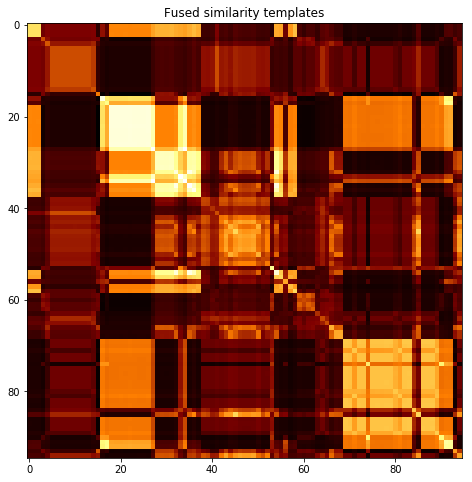

subject 04; gesture 2_0_1


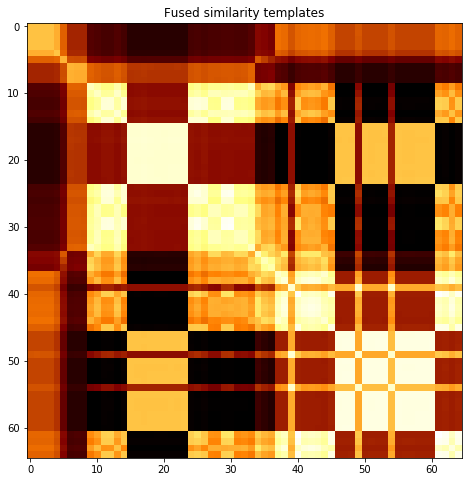

subject 04; gesture 4_1_2


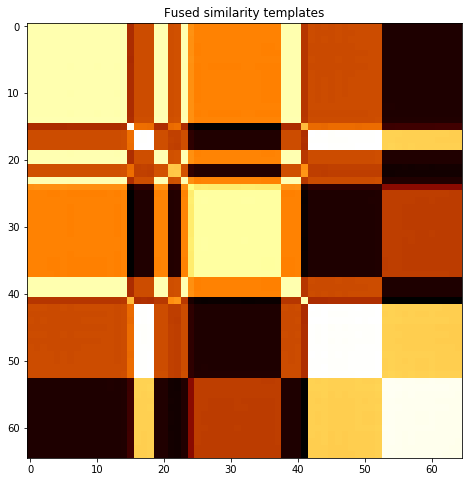

subject 04; gesture 2_0_2


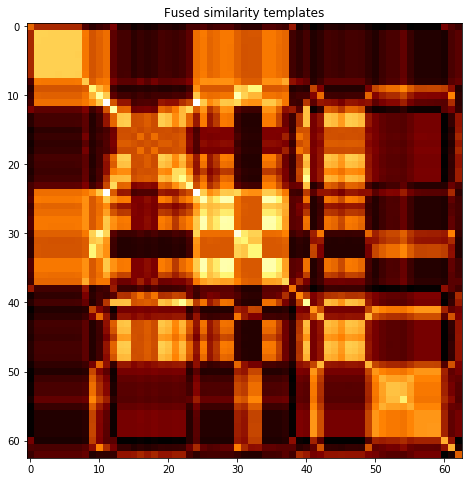

subject 04; gesture 1_1_2


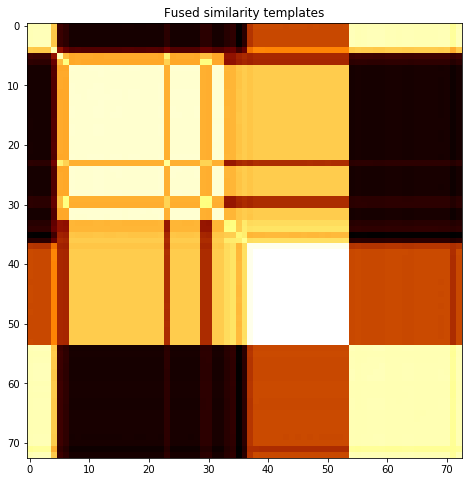

subject 04; gesture 2_1_2


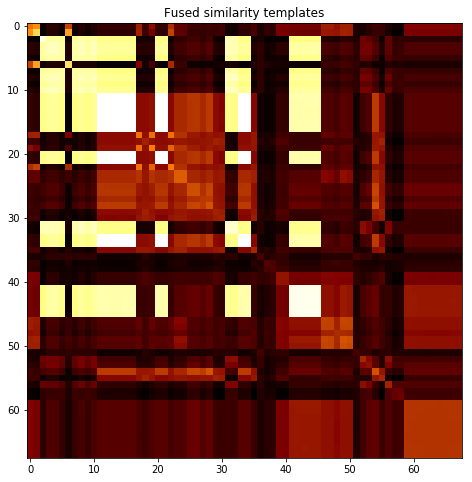

subject 04; gesture 4_0_1


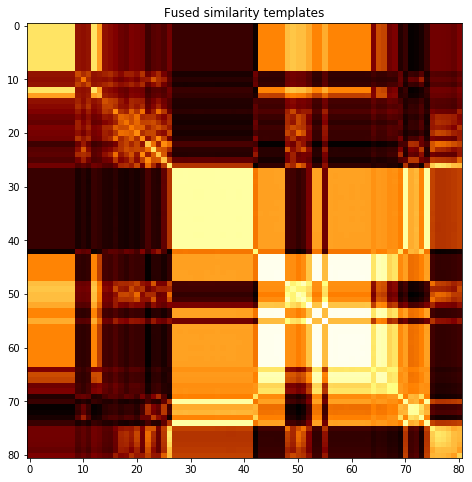

subject 04; gesture 3_0_2


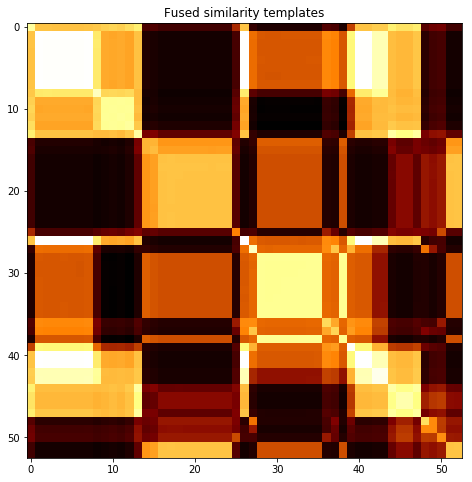

subject 04; gesture 1_1_1


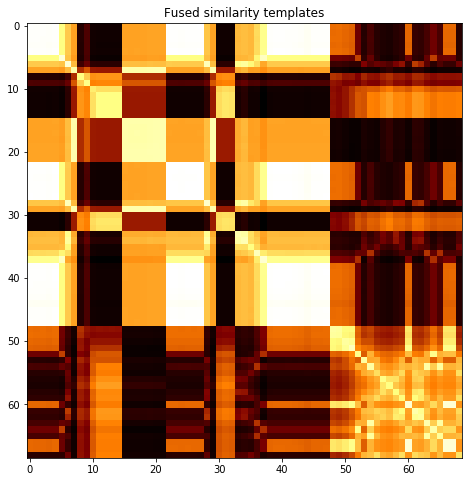

subject 04; gesture 3_1_2


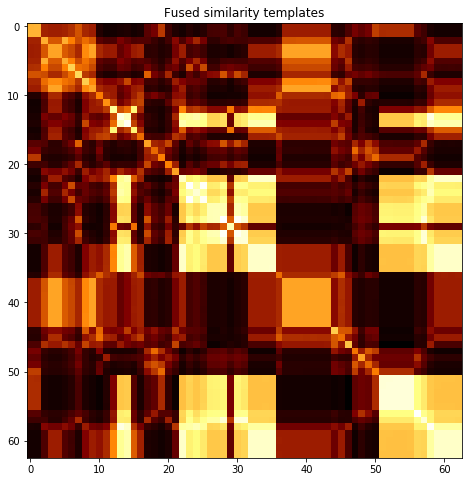

subject 04; gesture 2_1_1


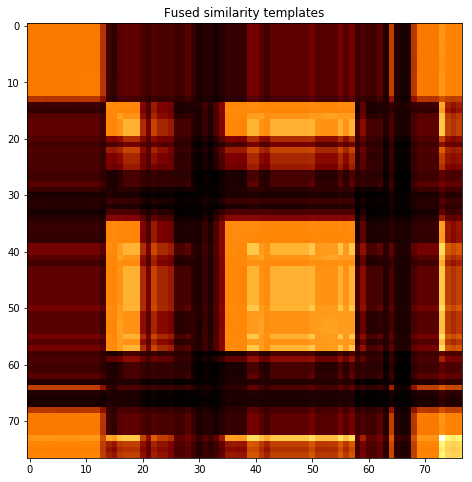

subject 04; gesture 1_0_1


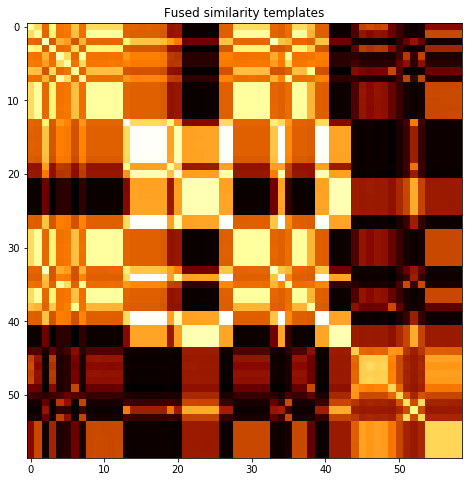

subject 04; gesture 3_1_1


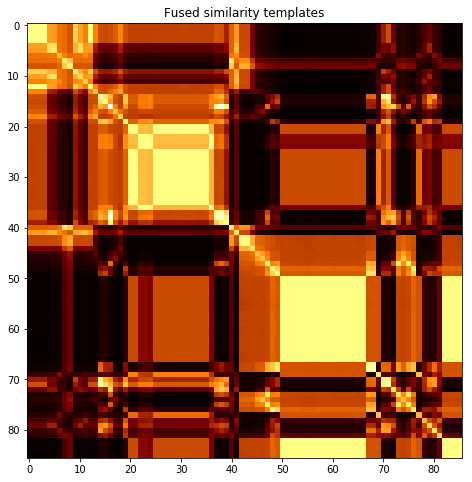

subject 04; gesture 1_0_2


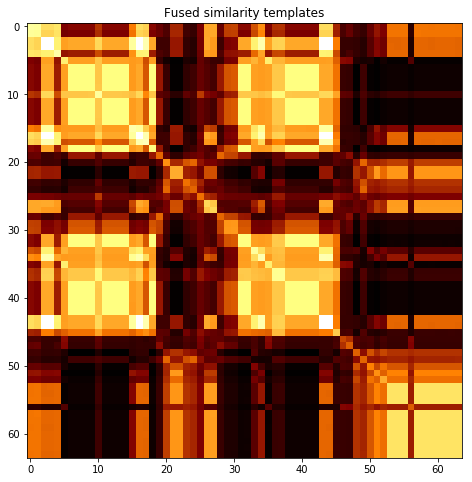

subject 04; gesture 4_0_2


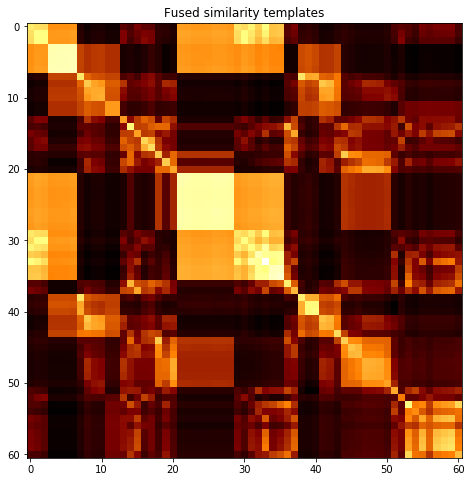

subject 08; gesture 3_0_1


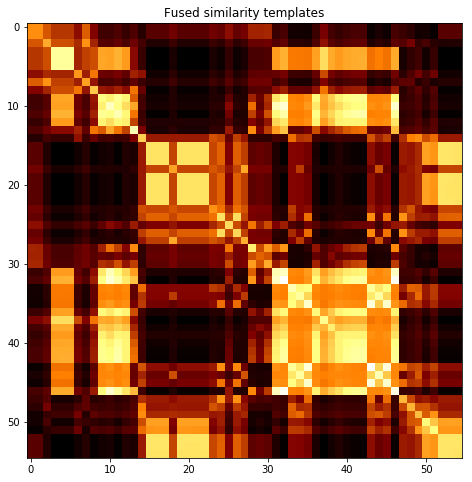

subject 08; gesture 4_1_1


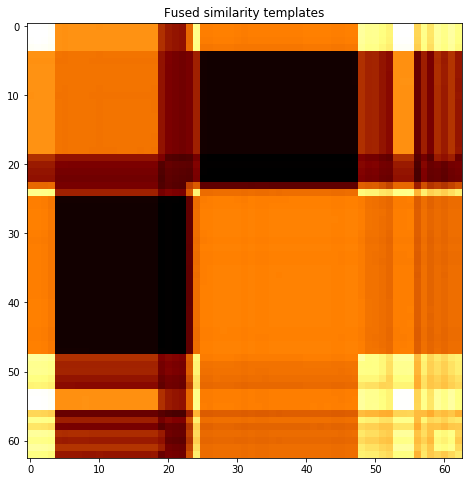

subject 08; gesture 2_0_1


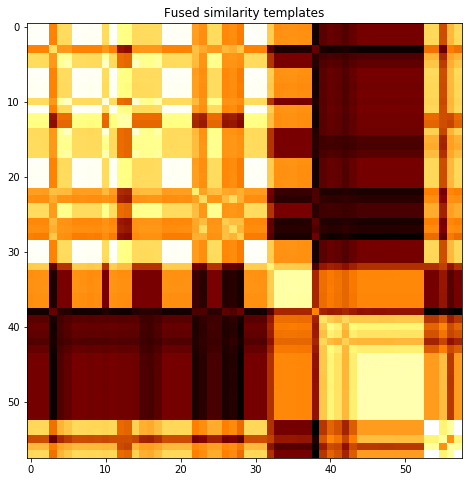

subject 08; gesture 4_1_2


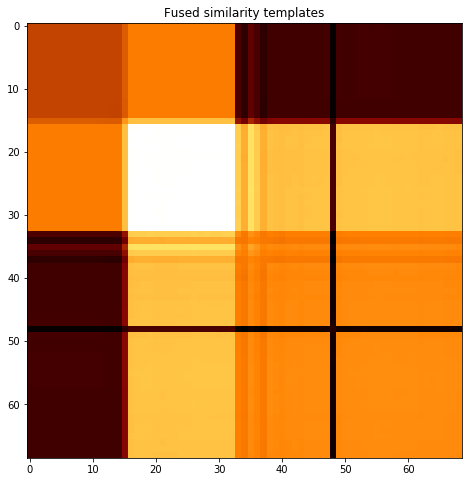

subject 08; gesture 2_0_2


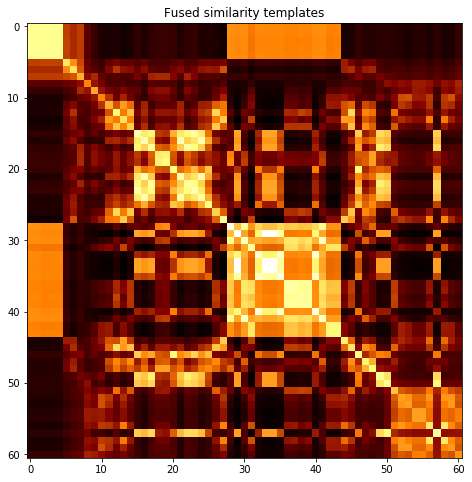

subject 08; gesture 1_1_2


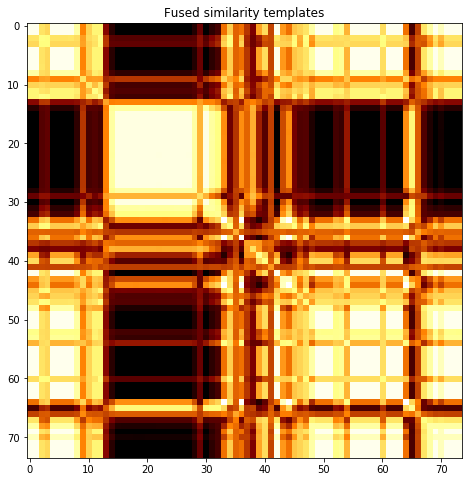

subject 08; gesture 2_1_2


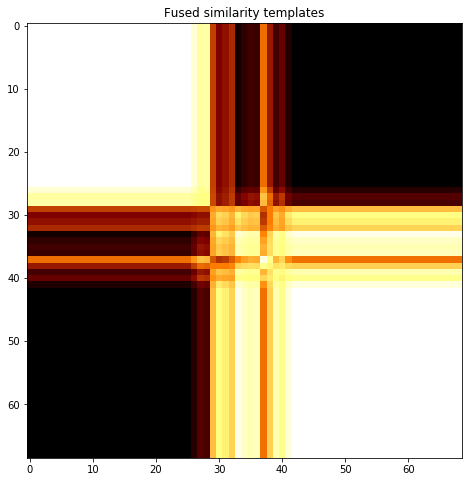

subject 08; gesture 4_0_1


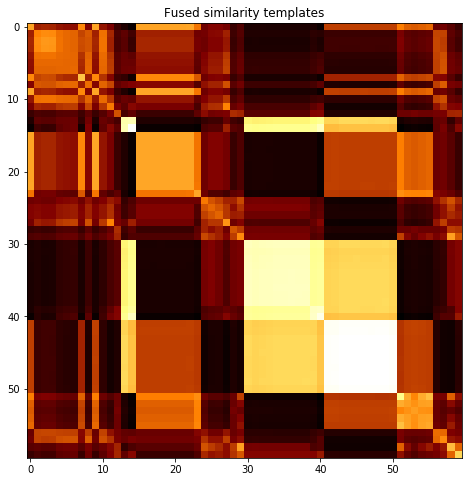

subject 08; gesture 3_0_2


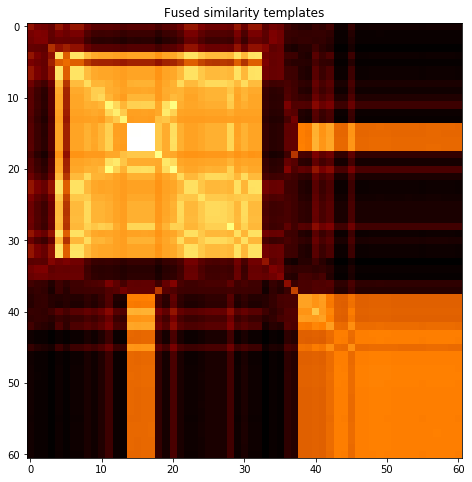

subject 08; gesture 1_1_1


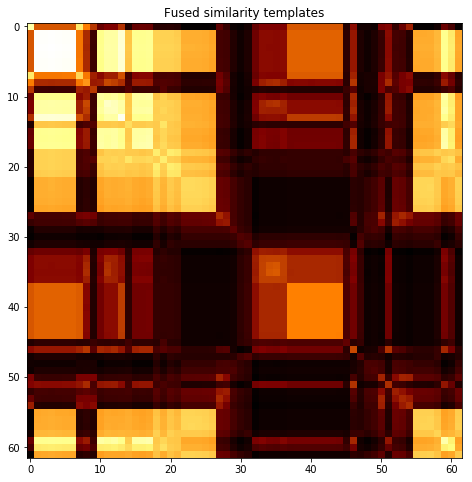

subject 08; gesture 3_1_2


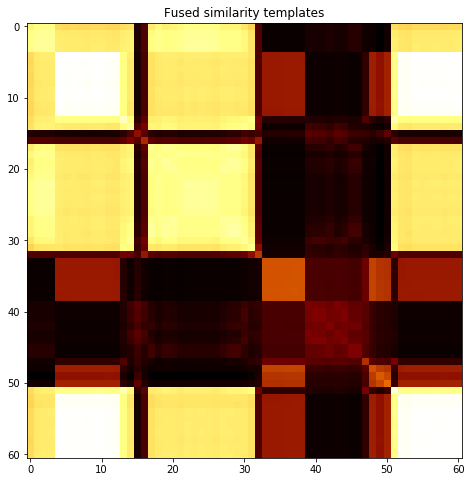

subject 08; gesture 2_1_1


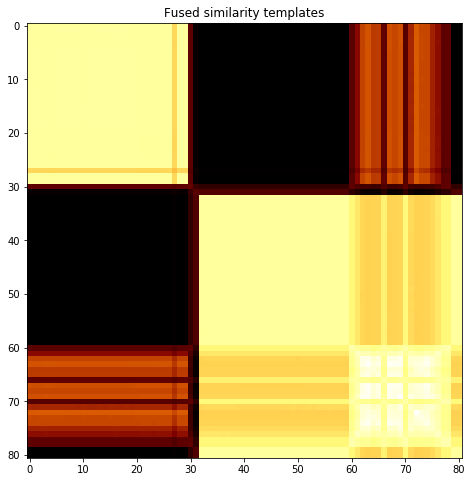

subject 08; gesture 1_0_1


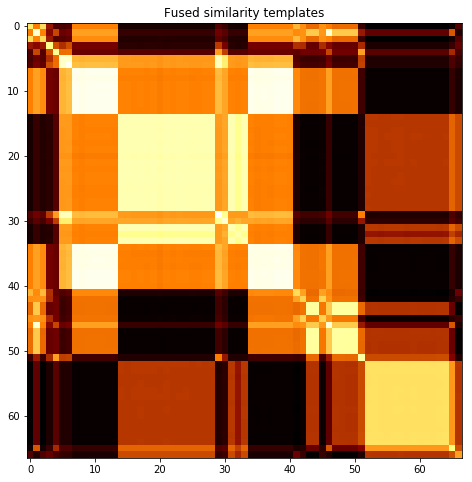

subject 08; gesture 3_1_1


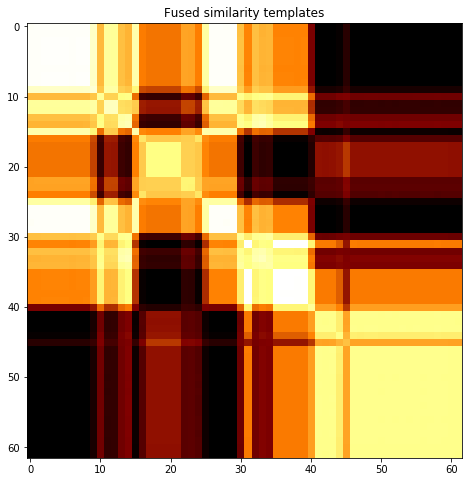

subject 08; gesture 1_0_2


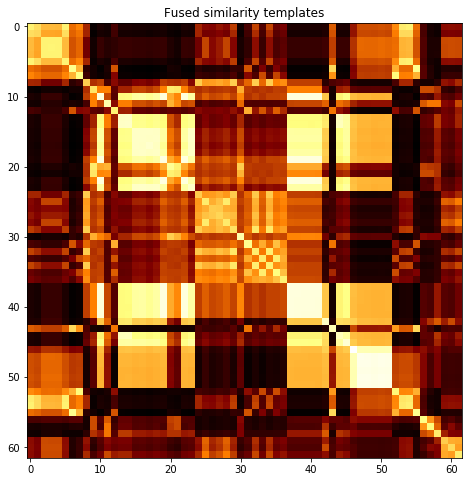

subject 08; gesture 4_0_2


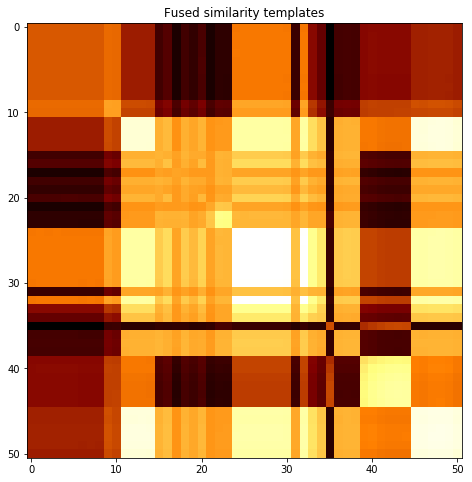

subject 27; gesture 3_0_1


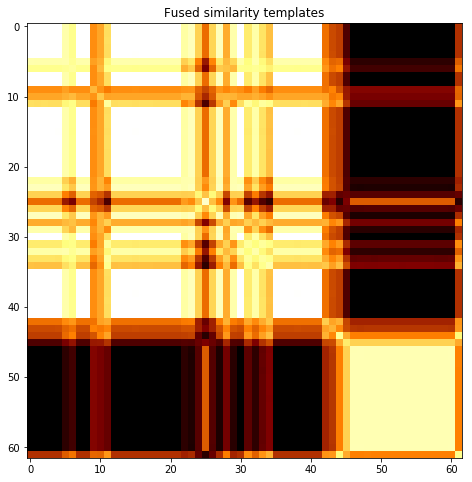

subject 27; gesture 4_1_1


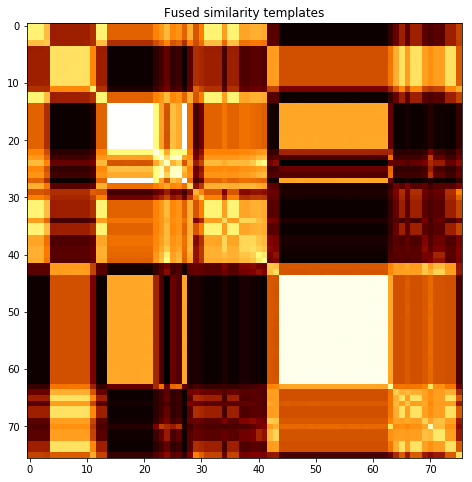

subject 27; gesture 2_0_1


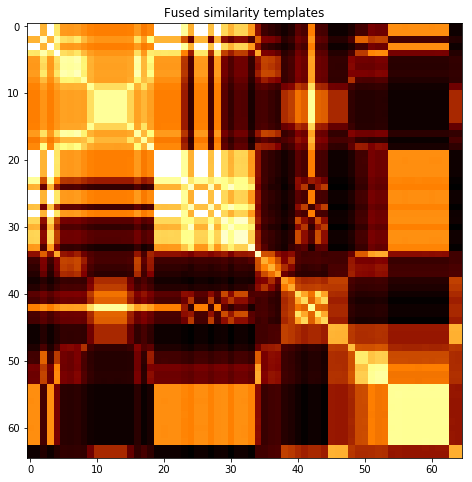

subject 27; gesture 4_1_2


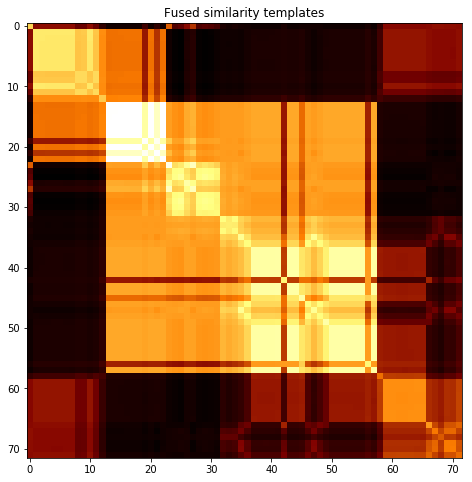

subject 27; gesture 2_0_2


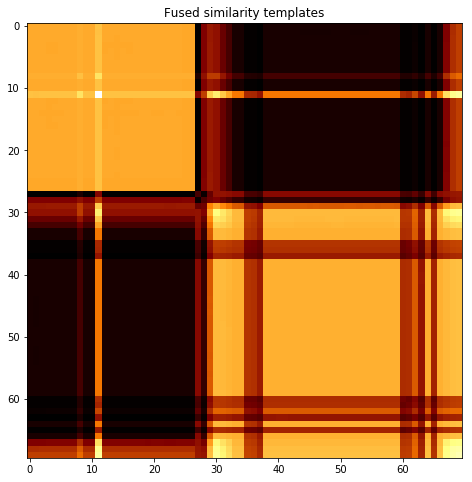

subject 27; gesture 1_1_2


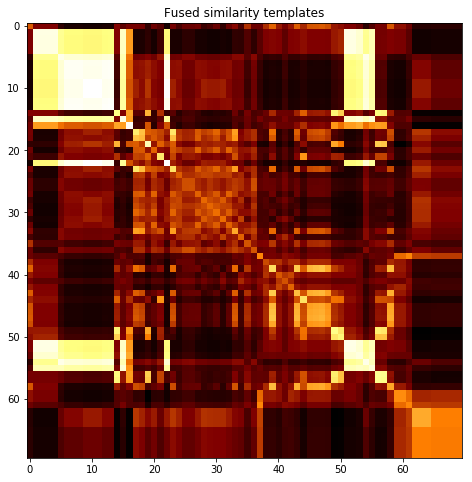

subject 27; gesture 2_1_2


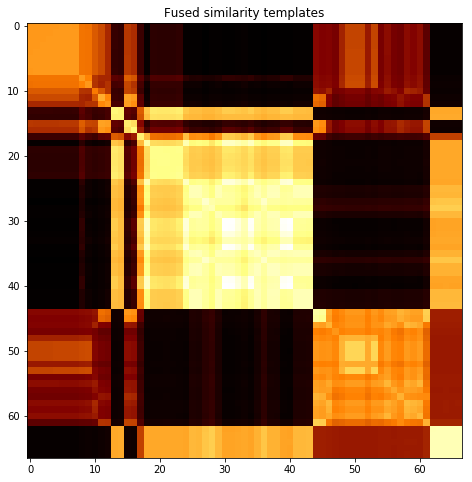

subject 27; gesture 4_0_1


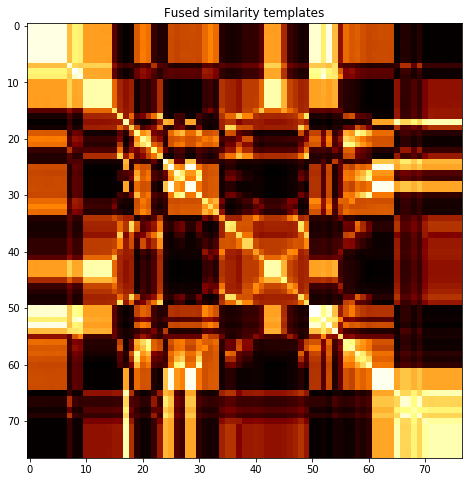

subject 27; gesture 3_0_2


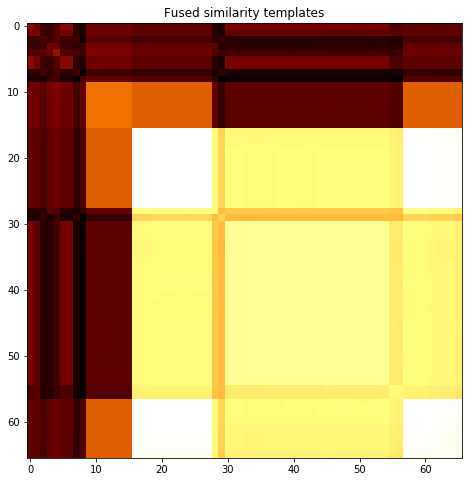

subject 27; gesture 1_1_1


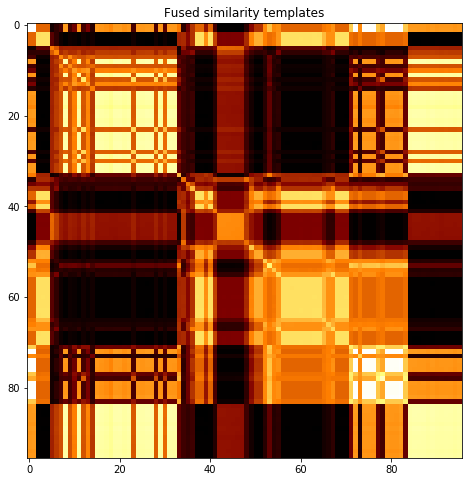

subject 27; gesture 3_1_2


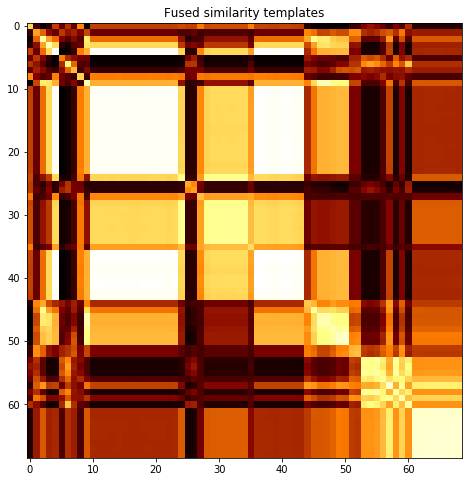

subject 27; gesture 2_1_1


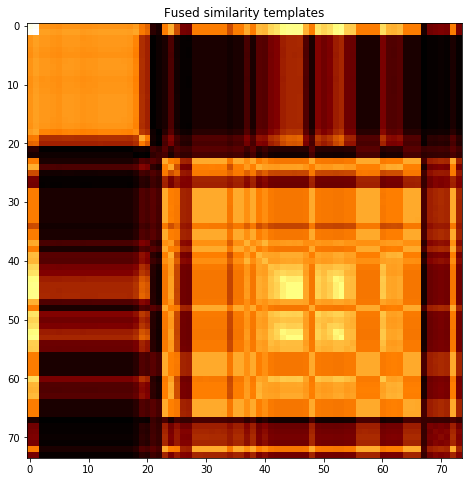

subject 27; gesture 1_0_1


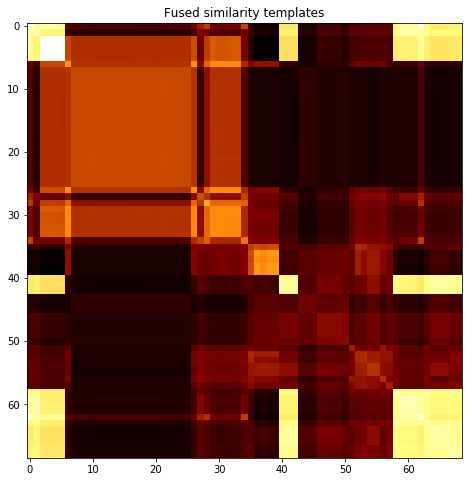

subject 27; gesture 3_1_1


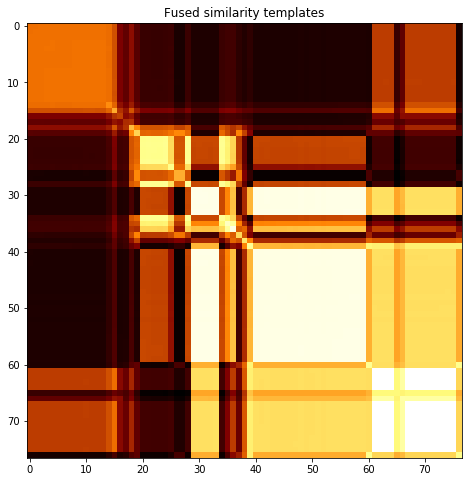

subject 27; gesture 1_0_2


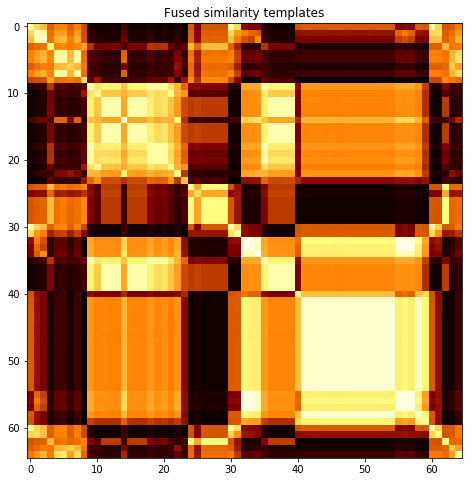

subject 27; gesture 4_0_2


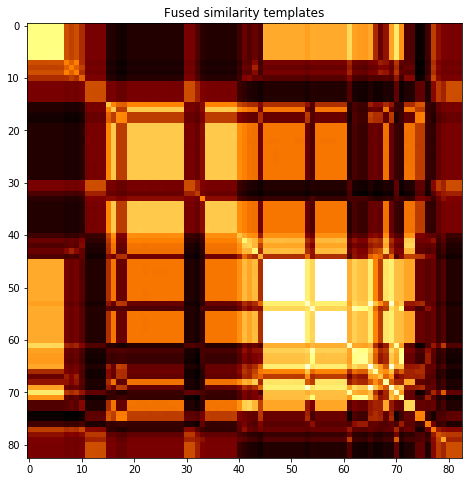

subject 14; gesture 3_0_1


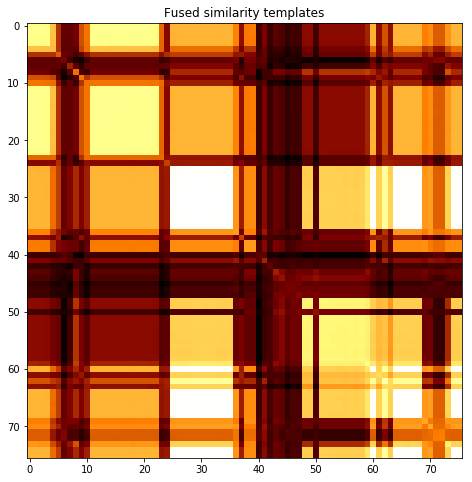

subject 14; gesture 4_1_1


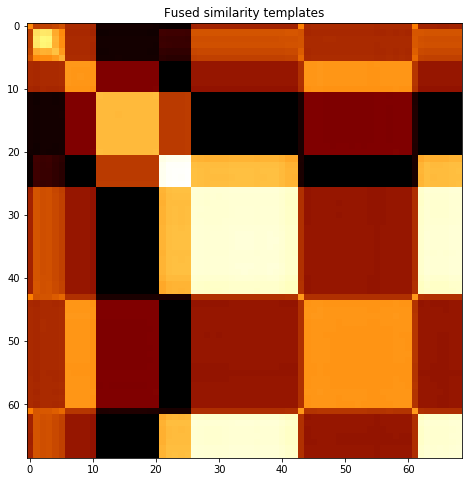

subject 14; gesture 2_0_1


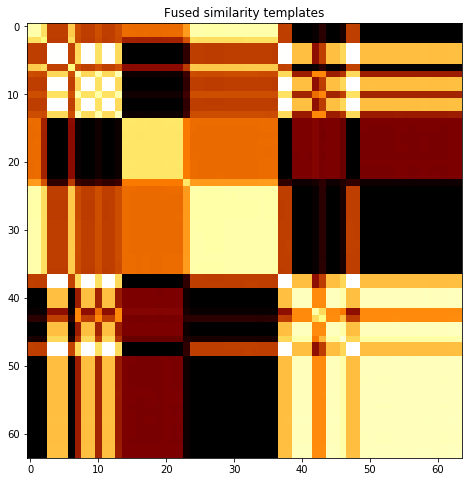

subject 14; gesture 4_1_2


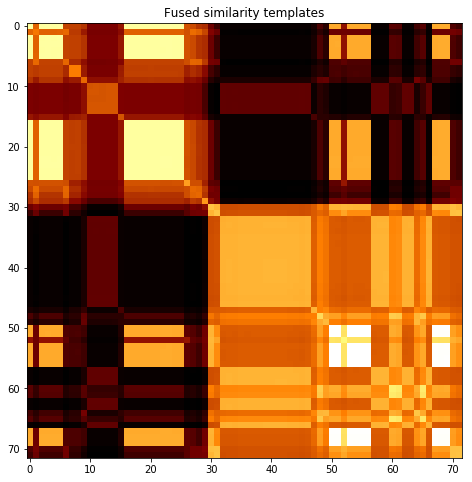

subject 14; gesture 2_0_2


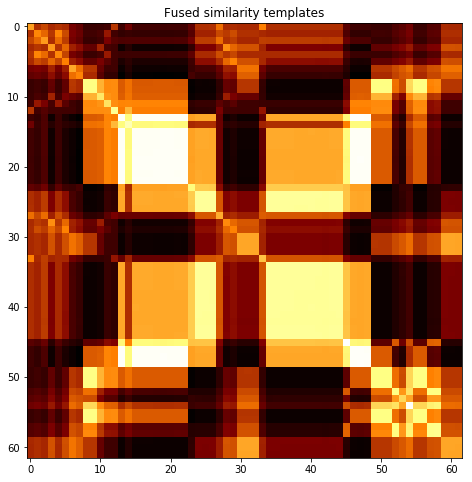

subject 14; gesture 1_1_2


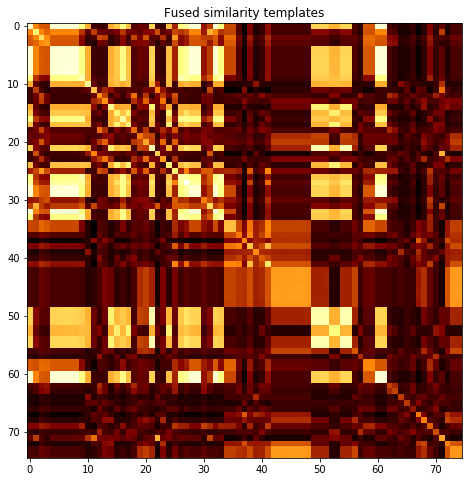

subject 14; gesture 2_1_2


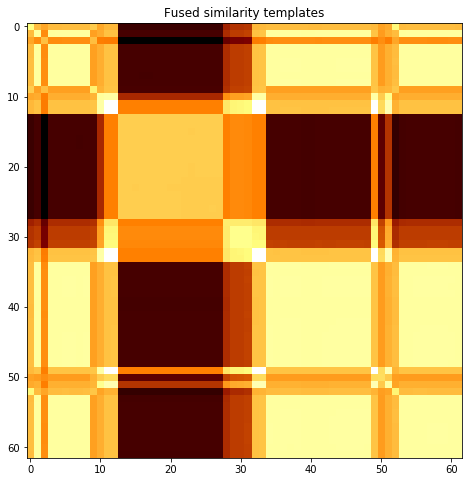

subject 14; gesture 4_0_1


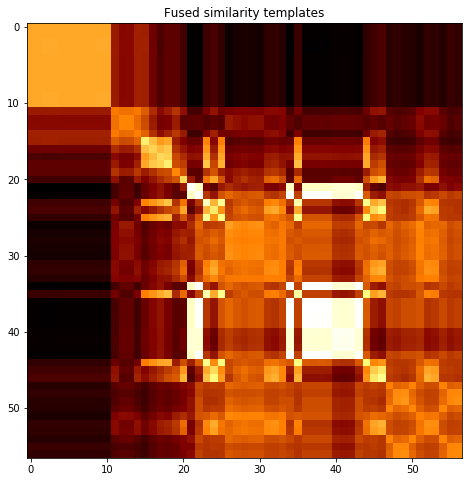

subject 14; gesture 3_0_2


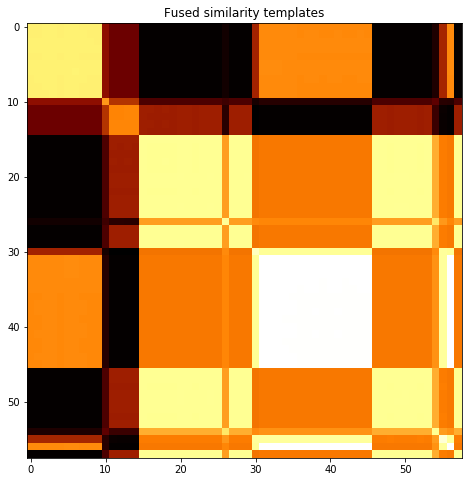

subject 14; gesture 1_1_1


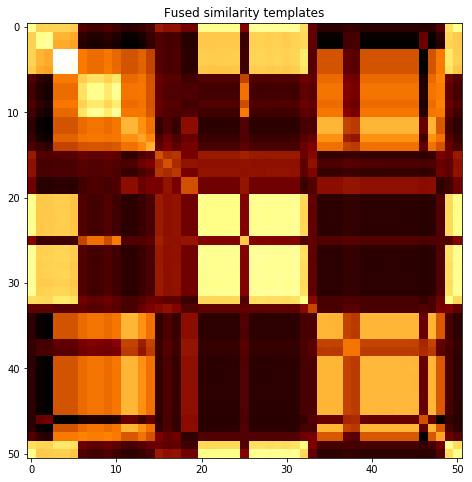

subject 14; gesture 3_1_2


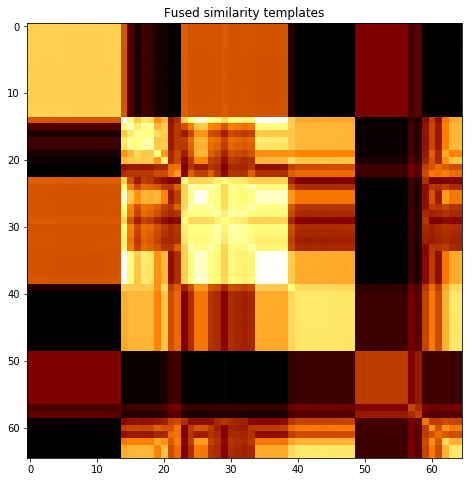

subject 14; gesture 2_1_1


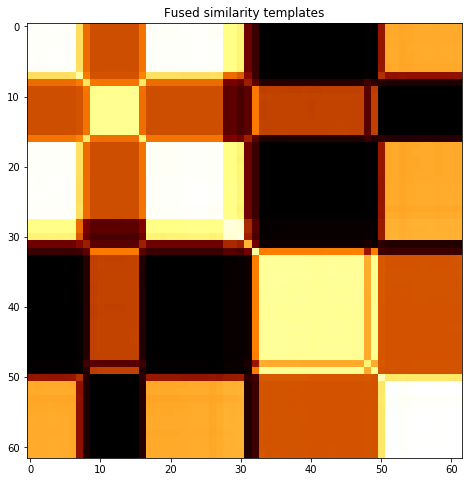

subject 14; gesture 1_0_1


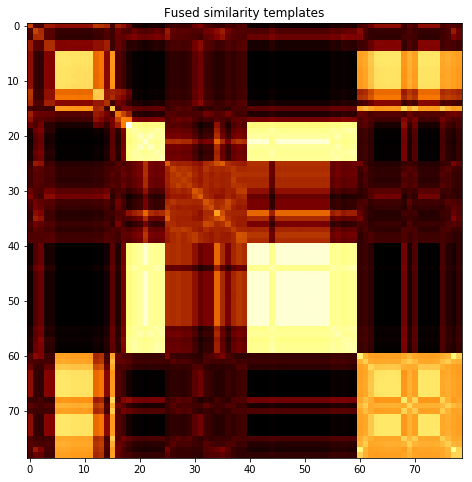

subject 14; gesture 3_1_1


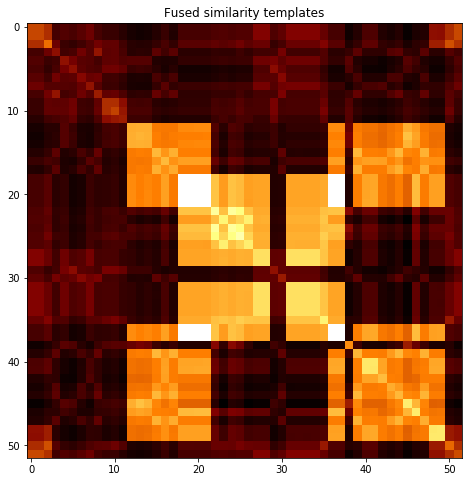

subject 14; gesture 1_0_2


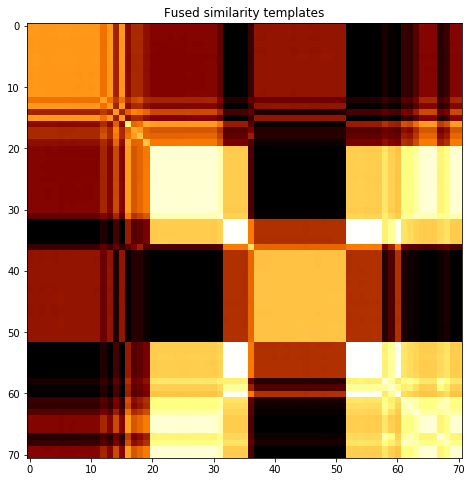

subject 14; gesture 4_0_2


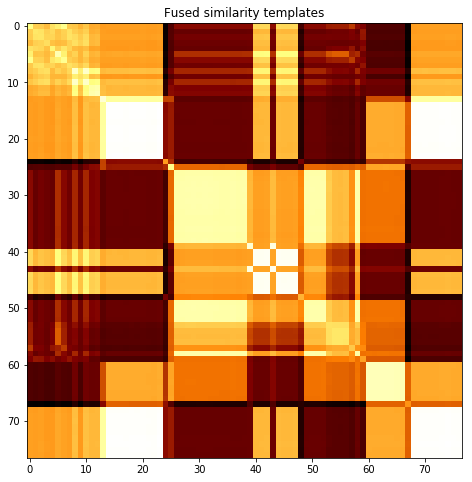

subject 23; gesture 3_0_1


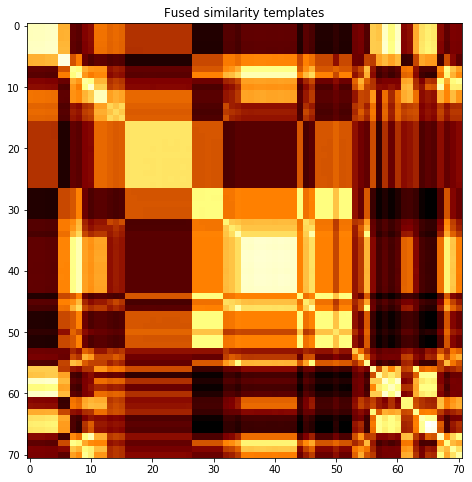

subject 23; gesture 4_1_1


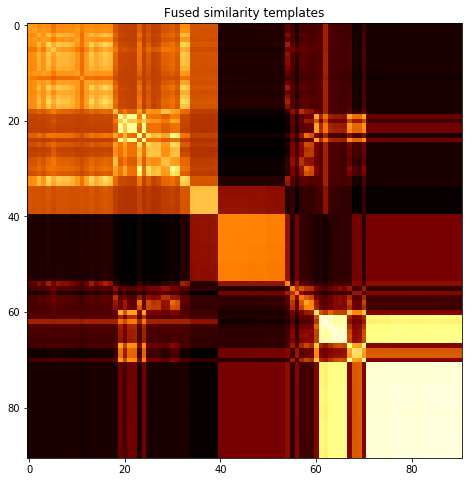

subject 23; gesture 2_0_1


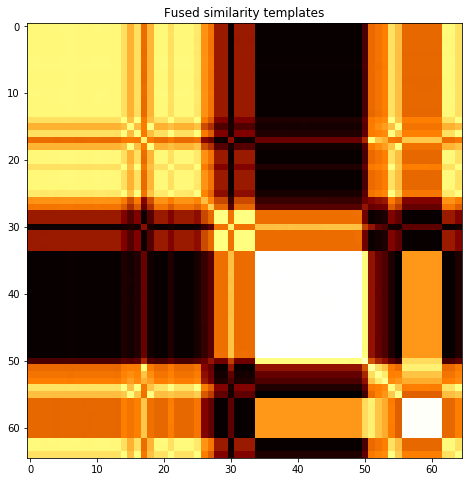

subject 23; gesture 4_1_2


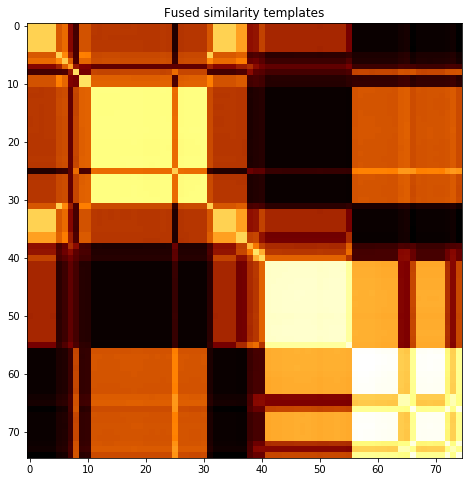

subject 23; gesture 2_0_2


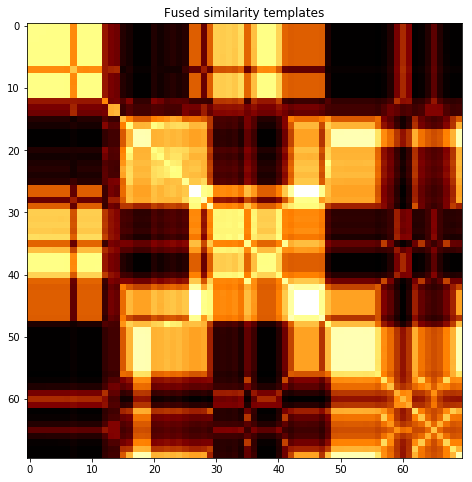

subject 23; gesture 1_1_2


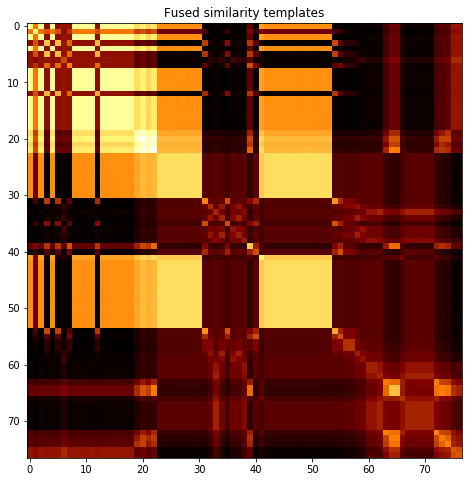

subject 23; gesture 2_1_2


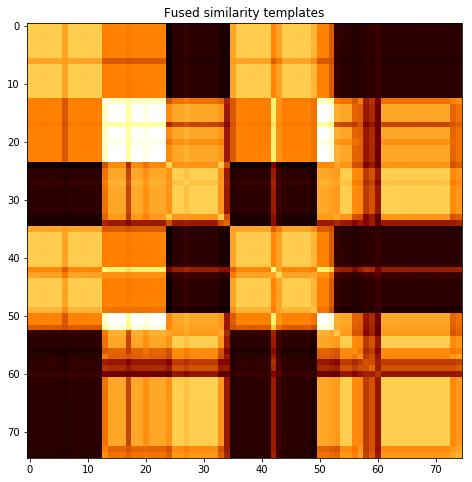

subject 23; gesture 4_0_1


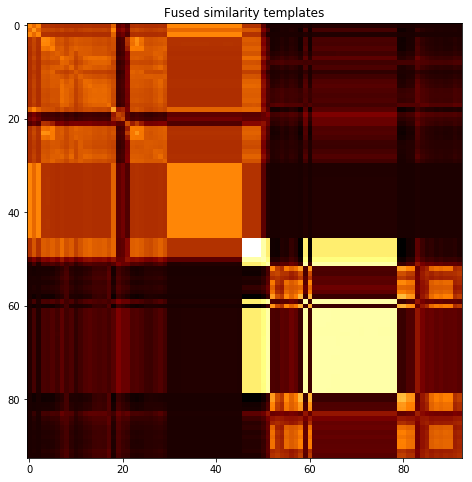

subject 23; gesture 3_0_2


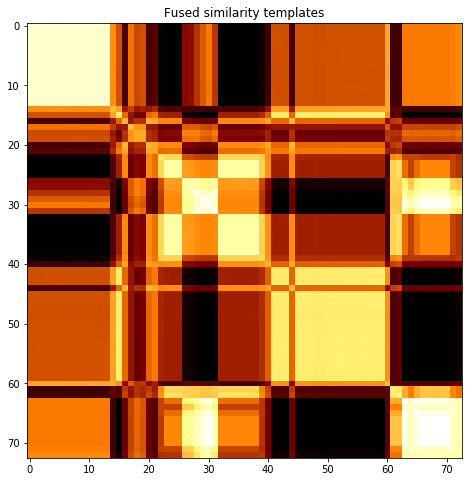

subject 23; gesture 1_1_1


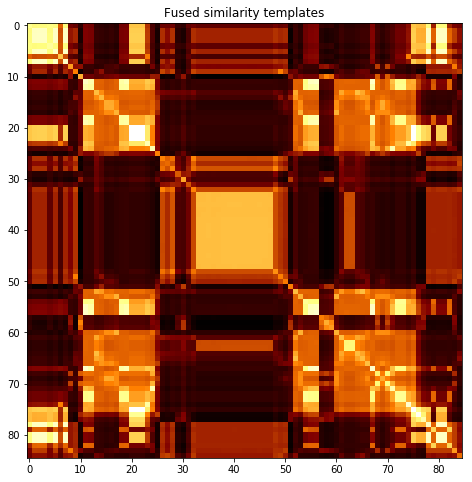

subject 23; gesture 3_1_2


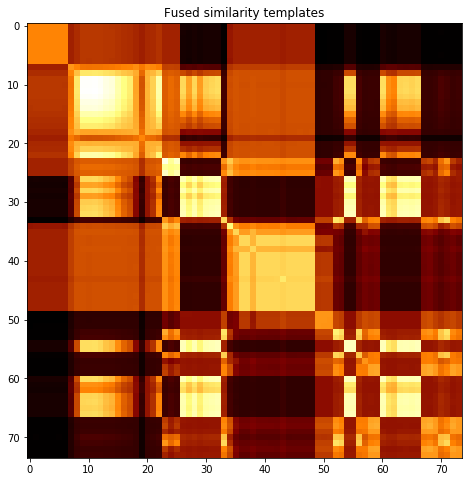

subject 23; gesture 2_1_1


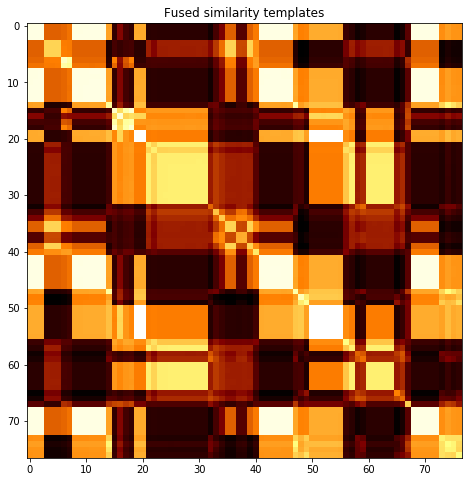

subject 23; gesture 1_0_1


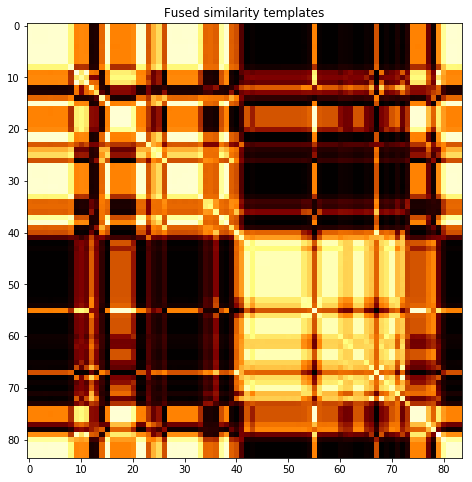

subject 23; gesture 3_1_1


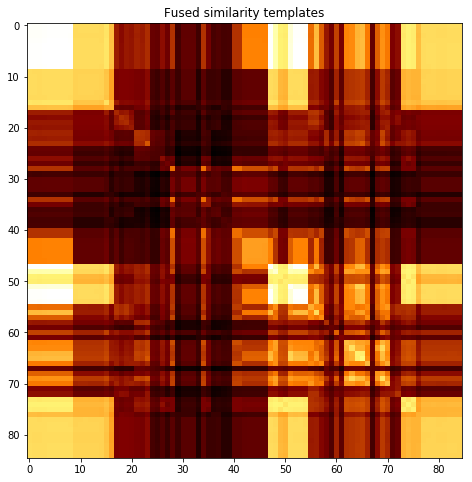

subject 23; gesture 1_0_2


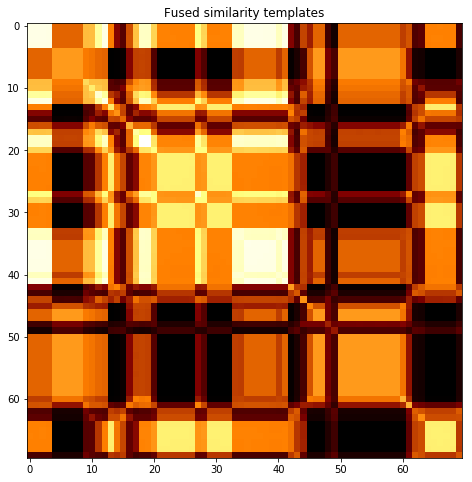

subject 23; gesture 4_0_2


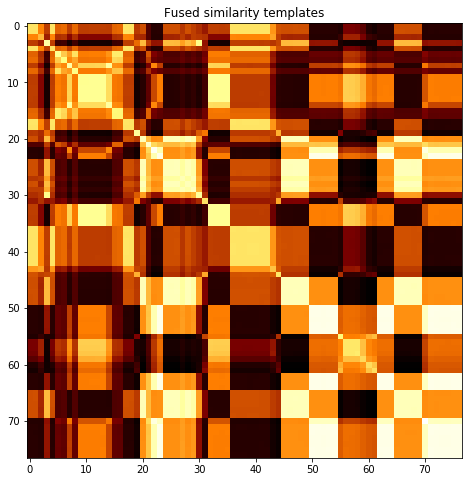

subject 25; gesture 3_0_1


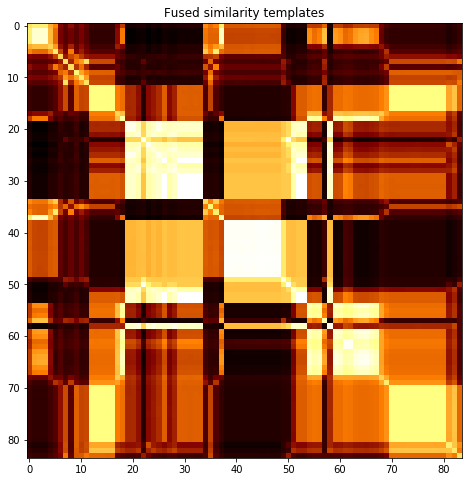

subject 25; gesture 4_1_1


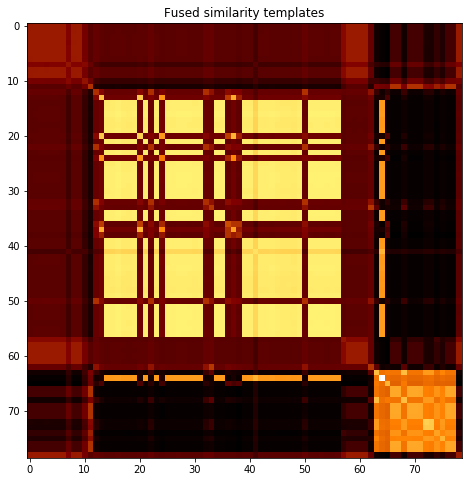

subject 25; gesture 2_0_1


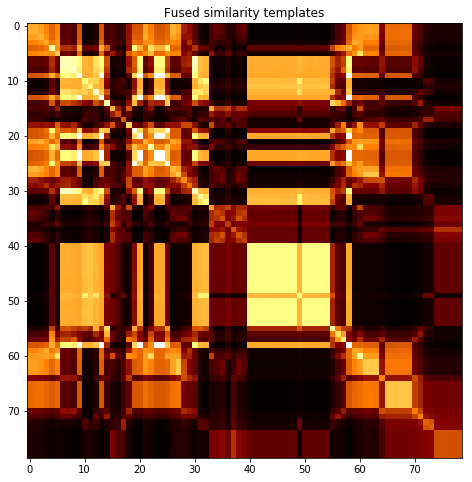

subject 25; gesture 4_1_2


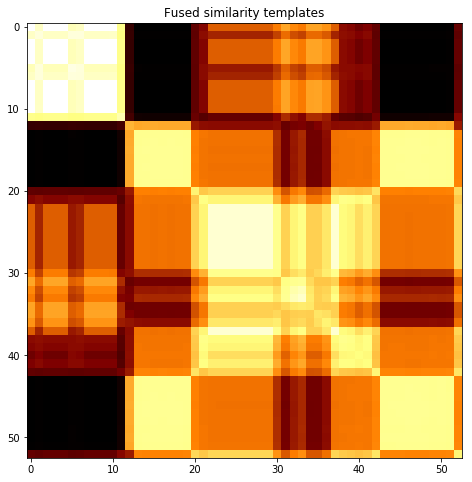

subject 25; gesture 2_0_2


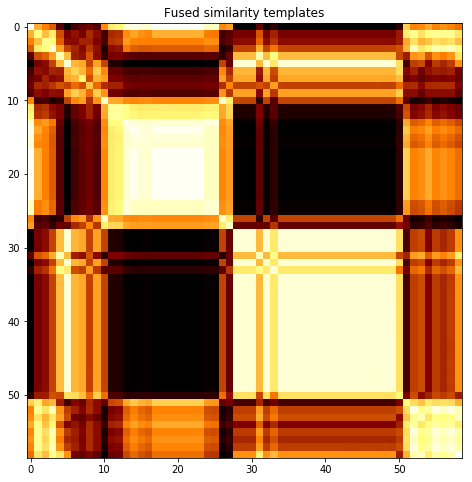

subject 25; gesture 1_1_2


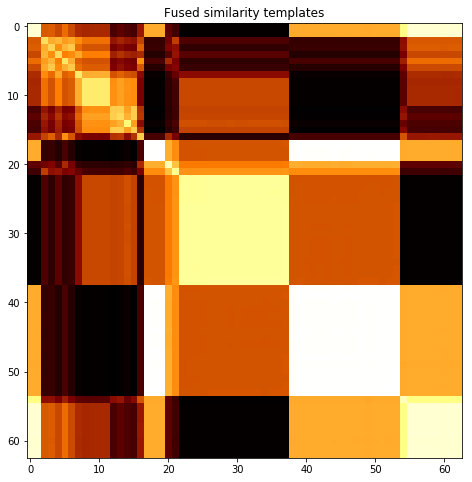

subject 25; gesture 2_1_2


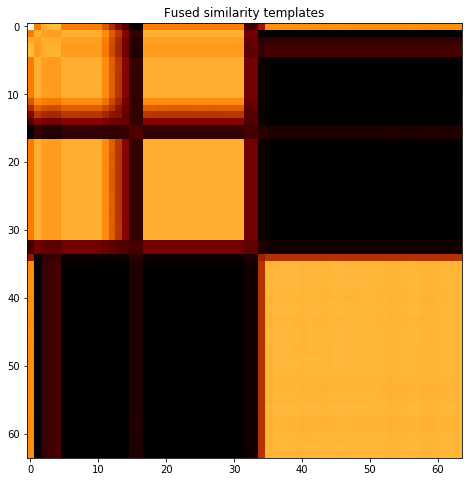

subject 25; gesture 4_0_1


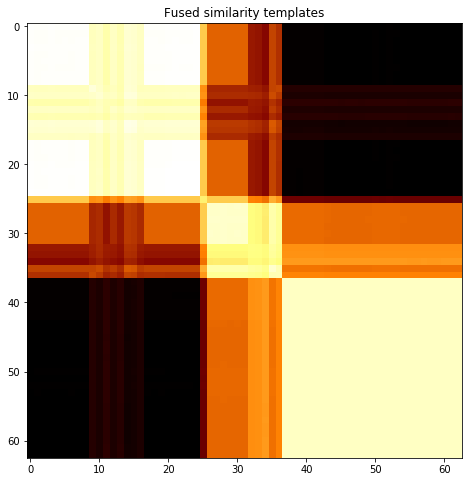

subject 25; gesture 3_0_2


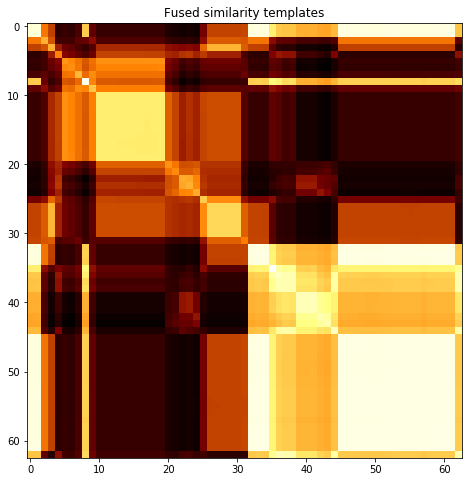

subject 25; gesture 1_1_1


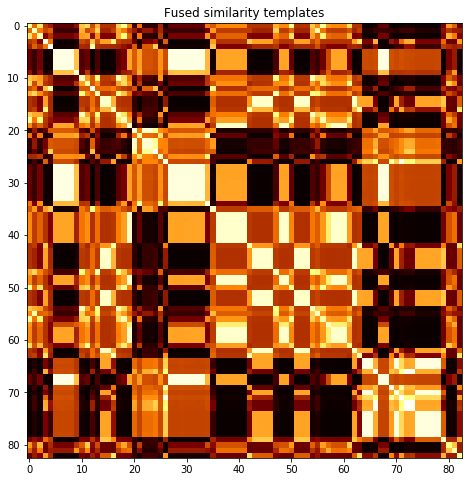

subject 25; gesture 3_1_2


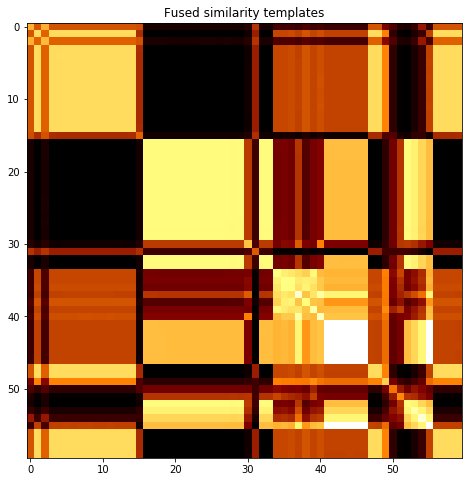

subject 25; gesture 2_1_1


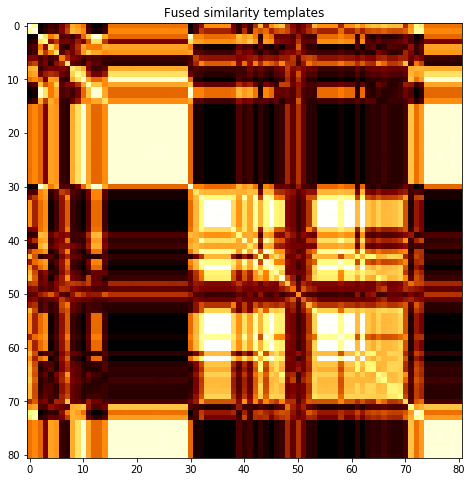

subject 25; gesture 1_0_1


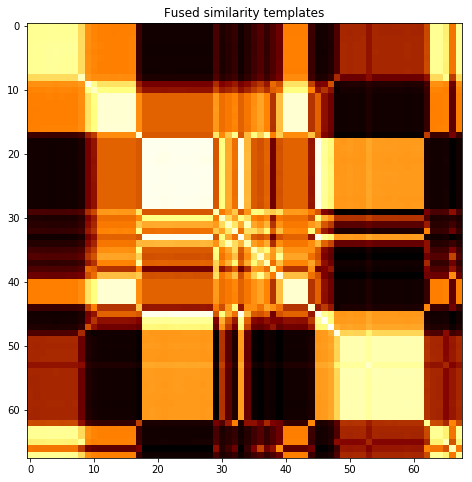

subject 25; gesture 3_1_1


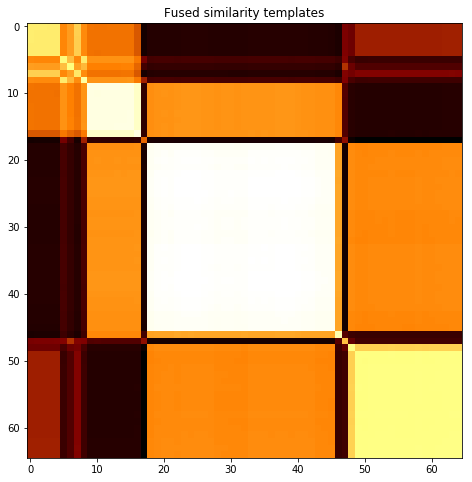

subject 25; gesture 1_0_2


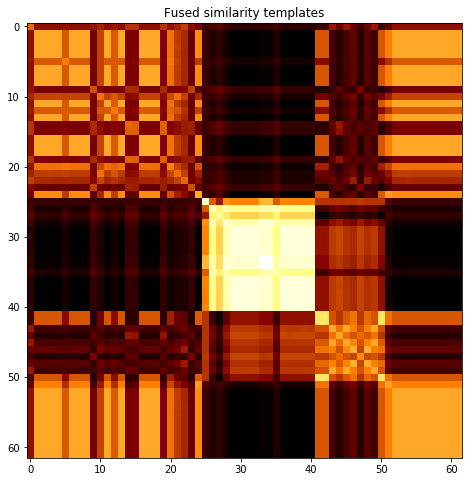

subject 25; gesture 4_0_2


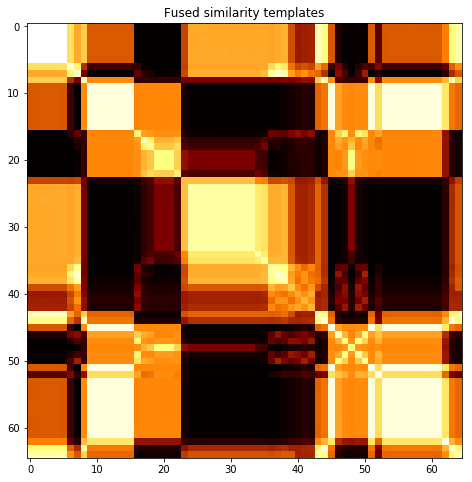

subject 18; gesture 3_0_1


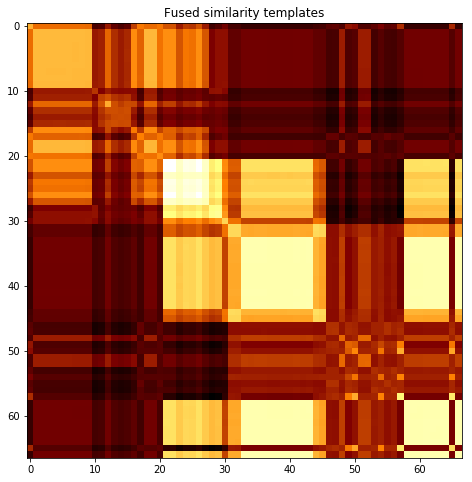

subject 18; gesture 4_1_1


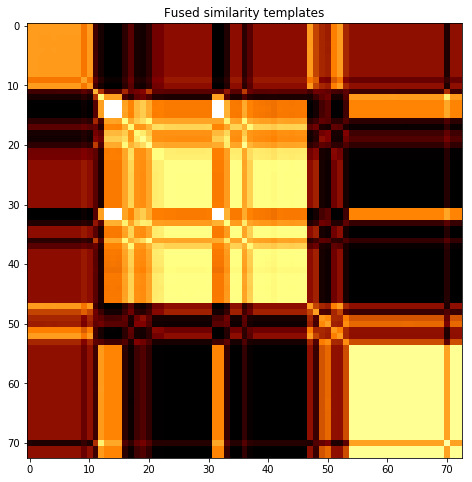

subject 18; gesture 2_0_1


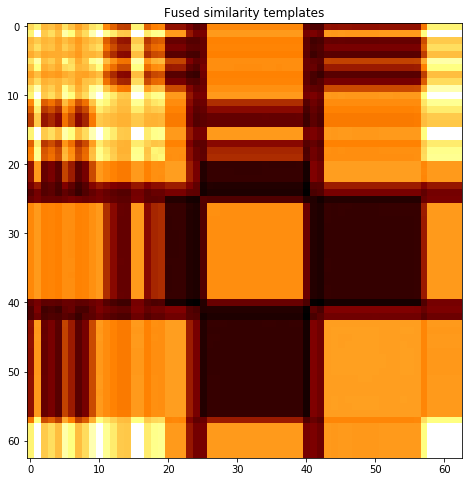

subject 18; gesture 4_1_2


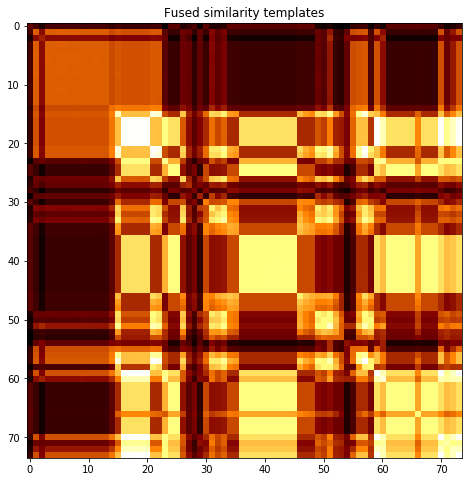

subject 18; gesture 2_0_2


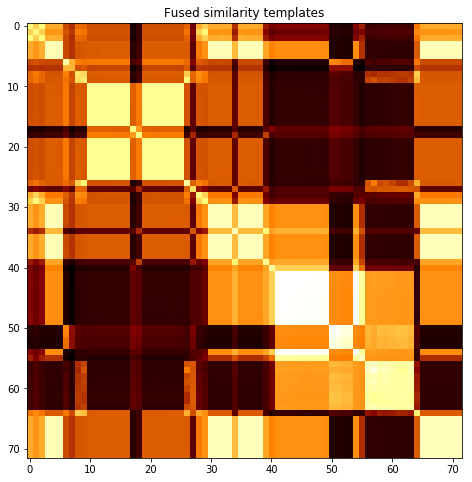

subject 18; gesture 1_1_2


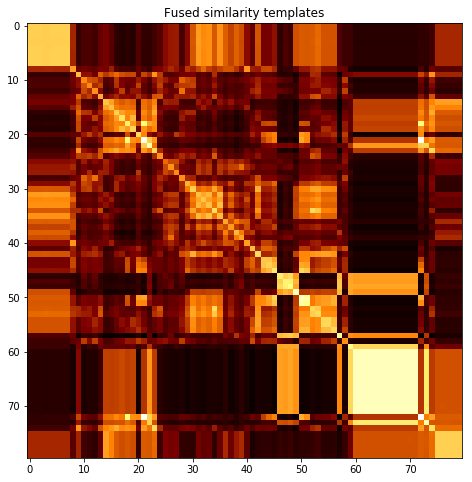

subject 18; gesture 2_1_2


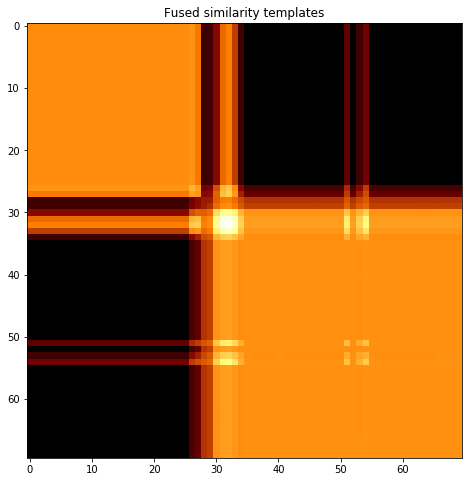

subject 18; gesture 4_0_1


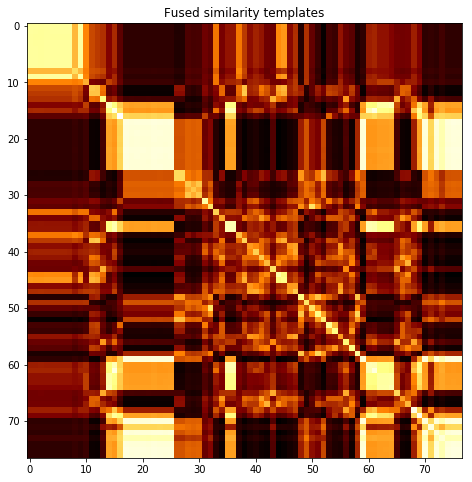

subject 18; gesture 3_0_2


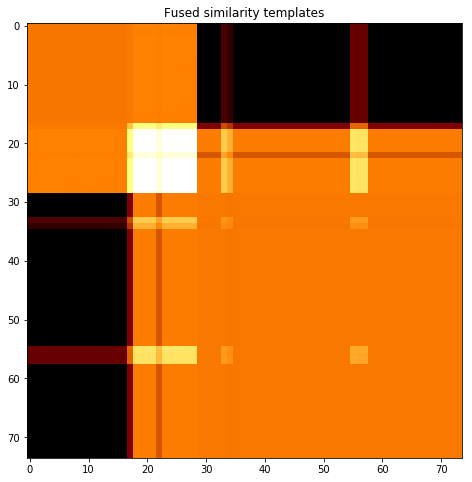

subject 18; gesture 1_1_1


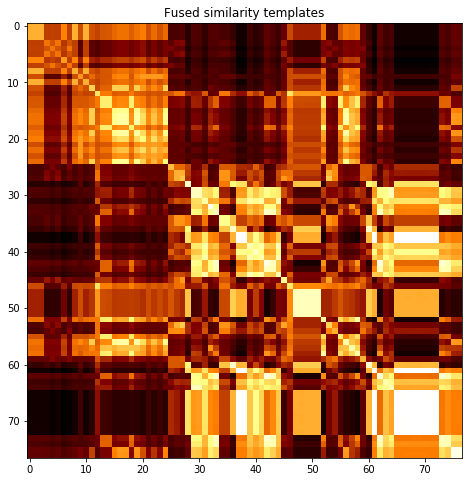

subject 18; gesture 3_1_2


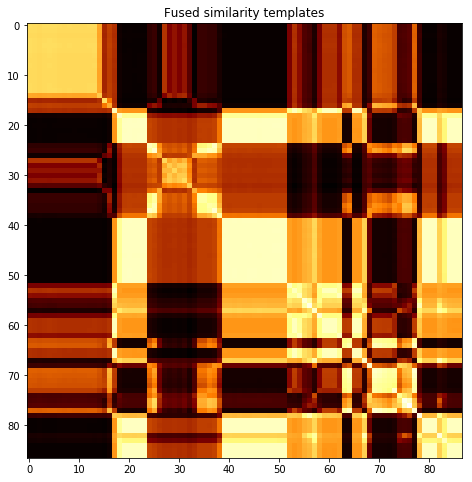

subject 18; gesture 2_1_1


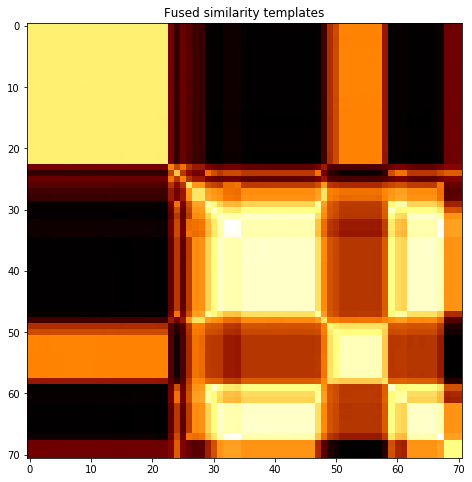

subject 18; gesture 1_0_1


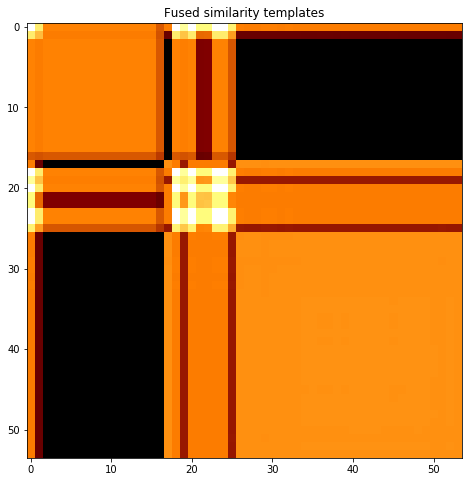

subject 18; gesture 3_1_1


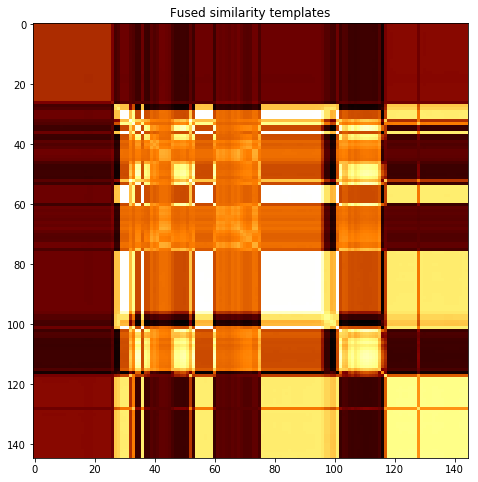

subject 18; gesture 1_0_2


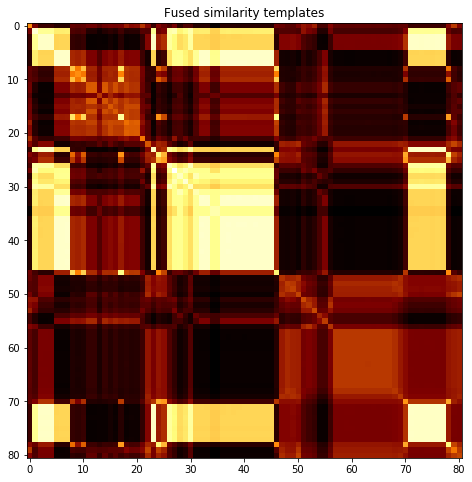

subject 18; gesture 4_0_2


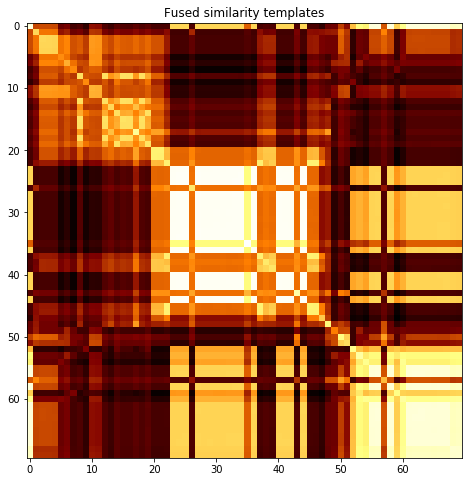

subject 29; gesture 3_0_1


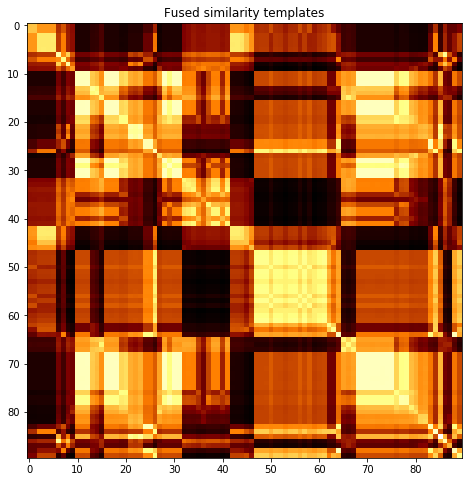

subject 29; gesture 4_1_1


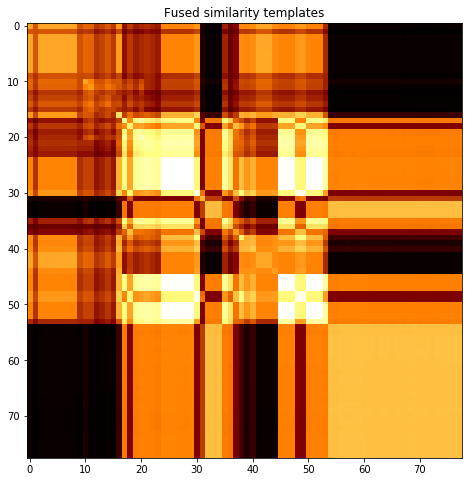

subject 29; gesture 2_0_1


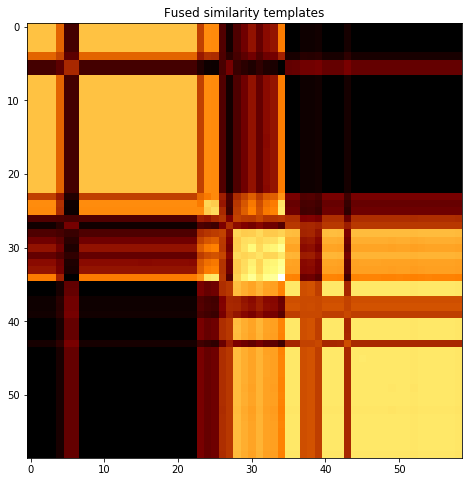

subject 29; gesture 4_1_2


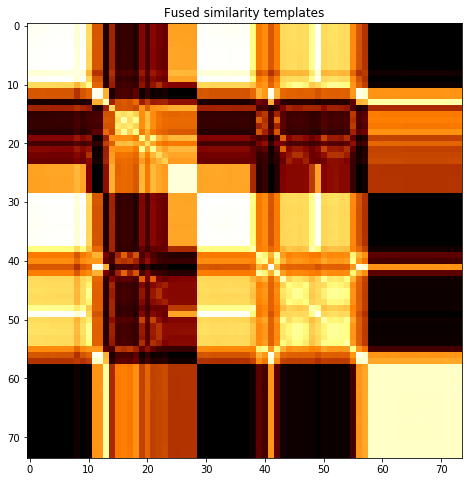

subject 29; gesture 2_0_2


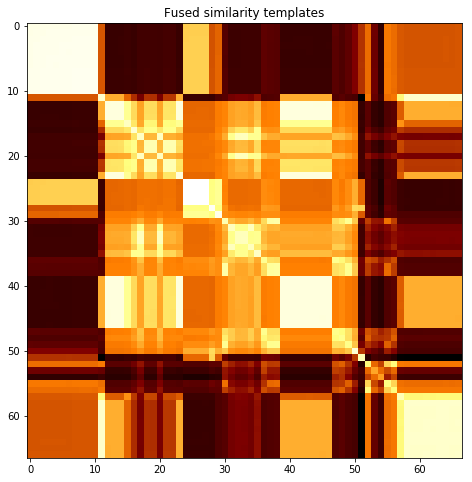

subject 29; gesture 1_1_2


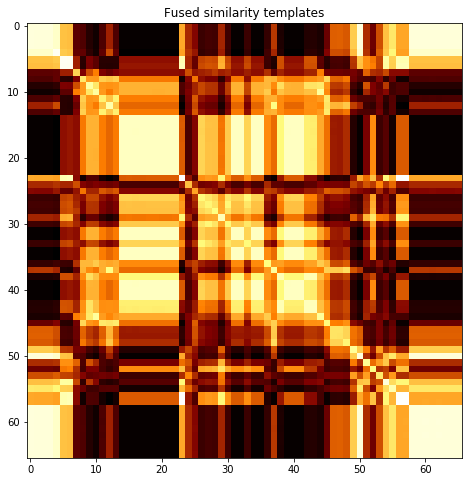

subject 29; gesture 2_1_2


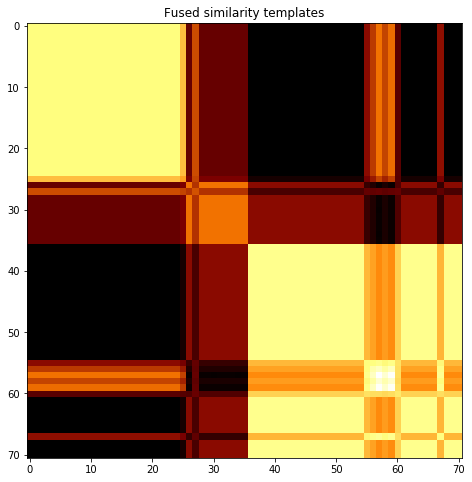

subject 29; gesture 4_0_1


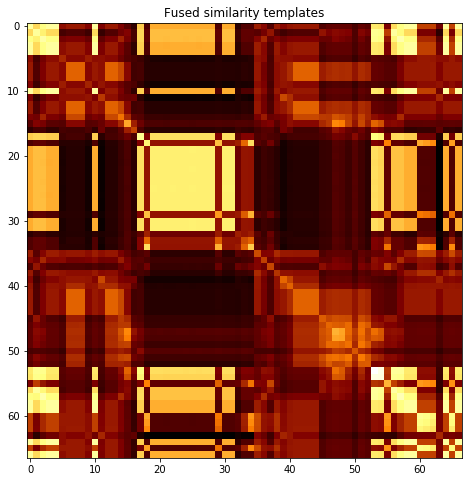

subject 29; gesture 3_0_2


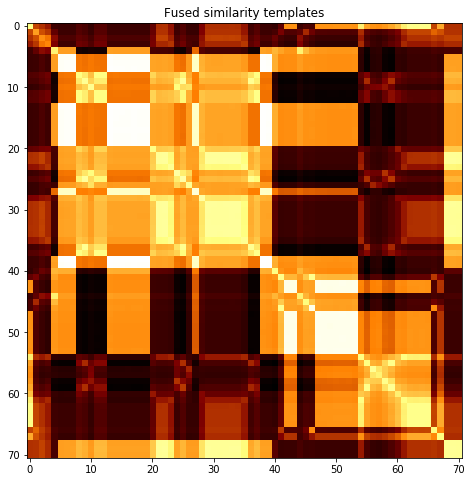

subject 29; gesture 1_1_1


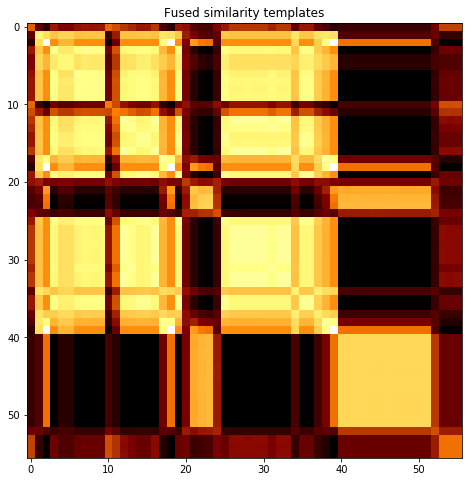

subject 29; gesture 3_1_2


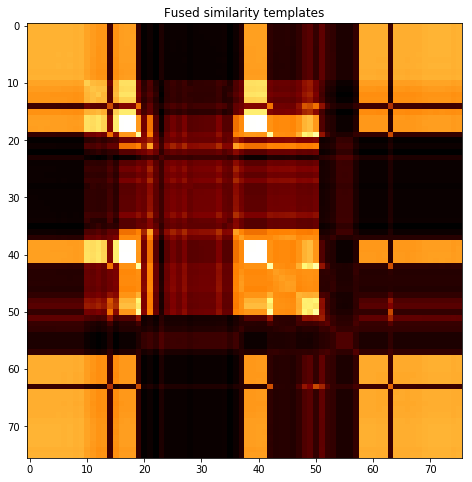

subject 29; gesture 2_1_1


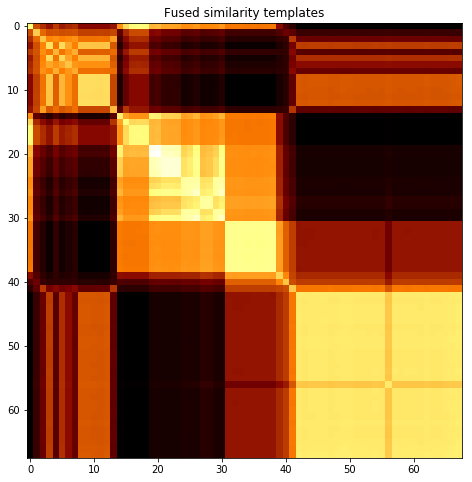

subject 29; gesture 1_0_1


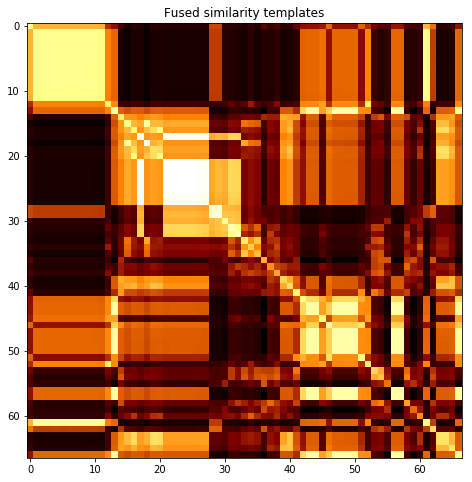

subject 29; gesture 3_1_1


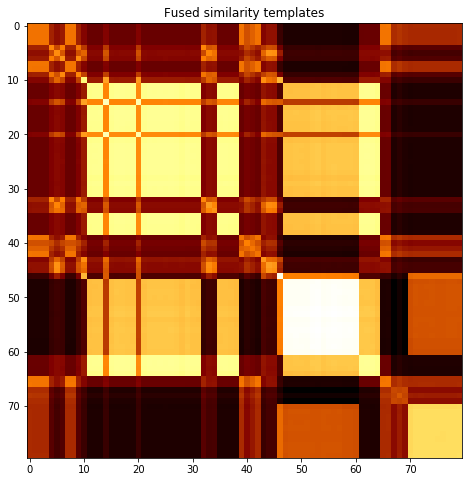

subject 29; gesture 1_0_2


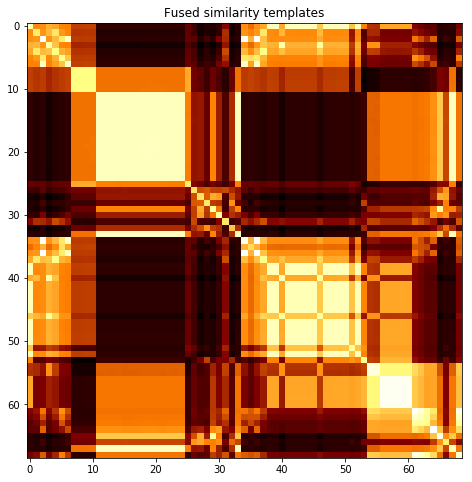

subject 29; gesture 4_0_2


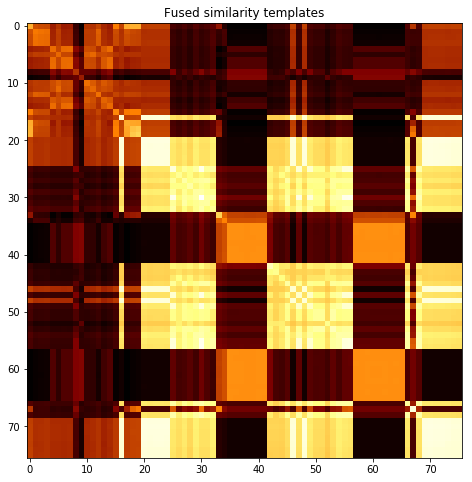

subject 15; gesture 3_0_1


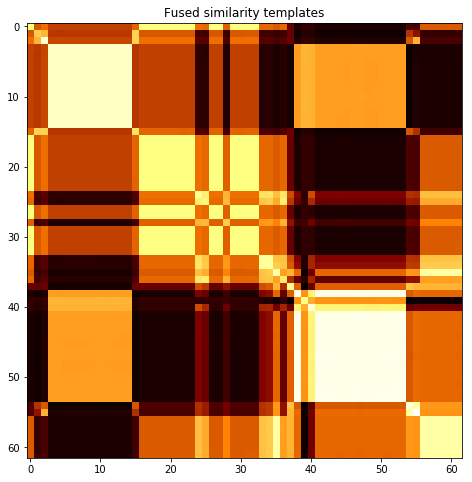

subject 15; gesture 4_1_1


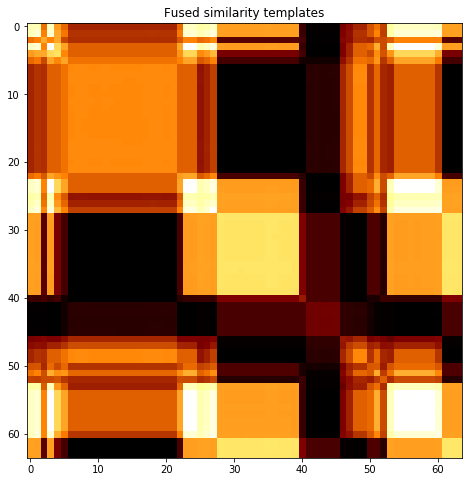

subject 15; gesture 2_0_1


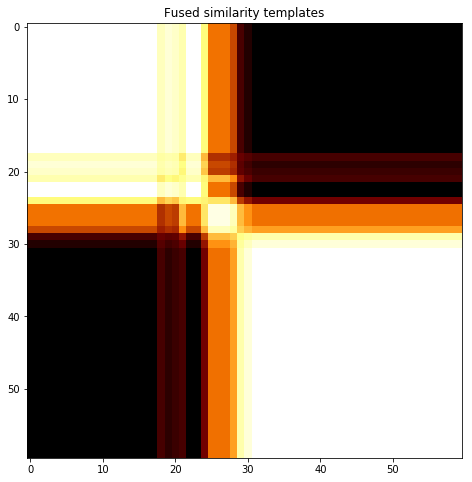

subject 15; gesture 4_1_2


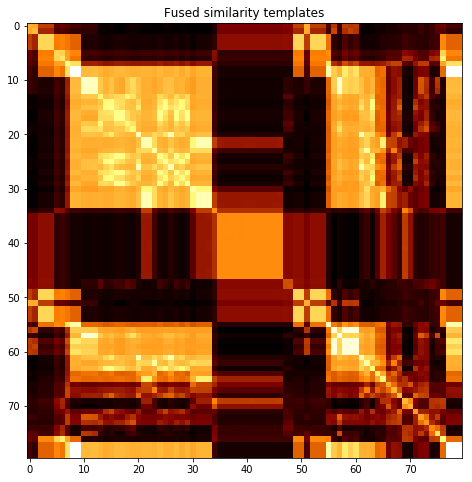

subject 15; gesture 2_0_2


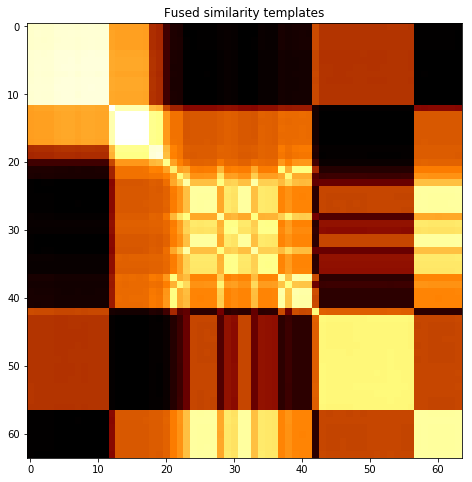

subject 15; gesture 1_1_2


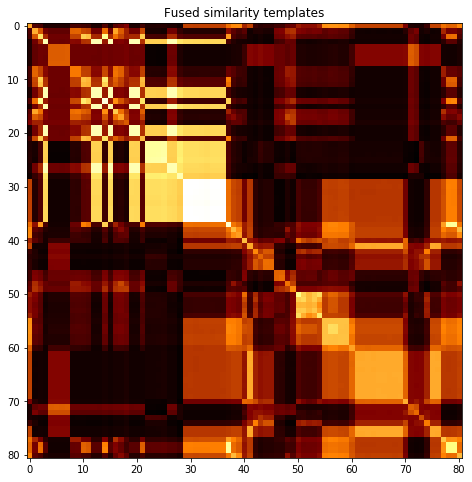

subject 15; gesture 2_1_2


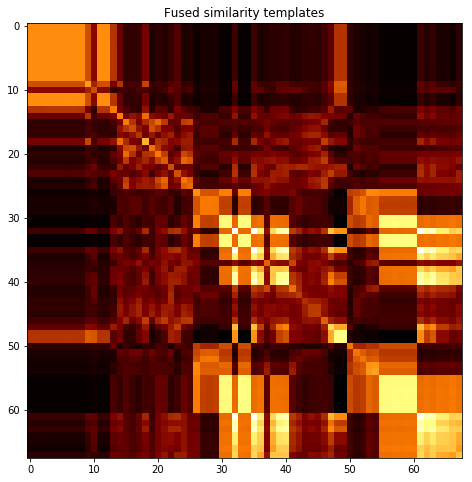

subject 15; gesture 4_0_1


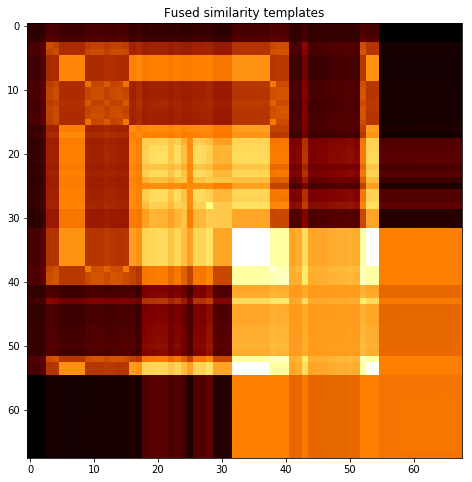

subject 15; gesture 3_0_2


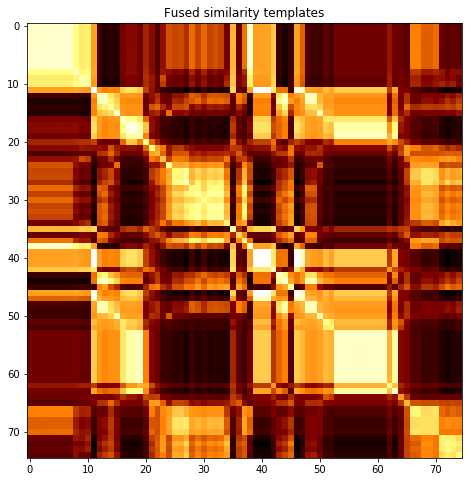

subject 15; gesture 1_1_1


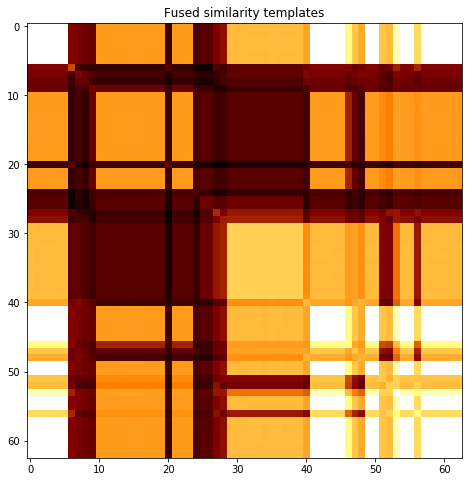

subject 15; gesture 3_1_2


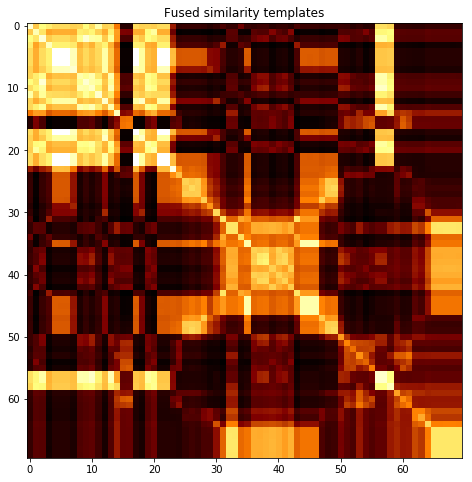

subject 15; gesture 2_1_1


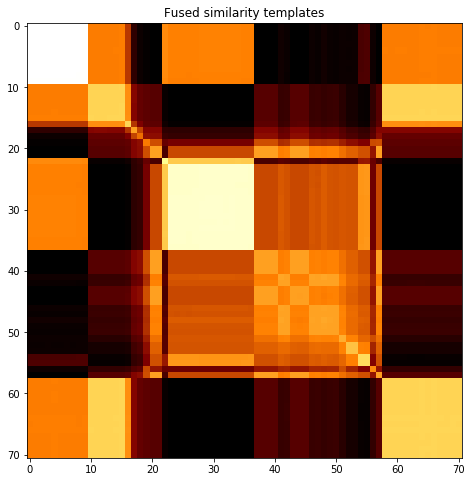

subject 15; gesture 1_0_1


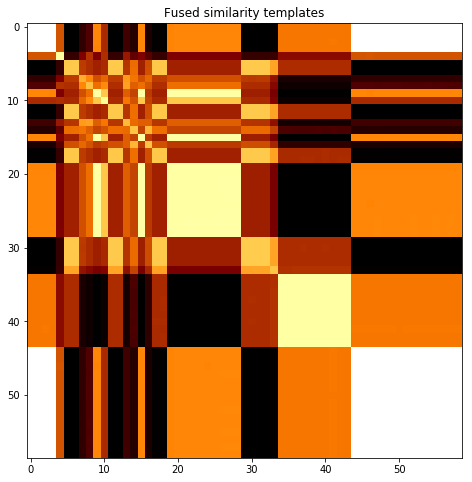

subject 15; gesture 3_1_1


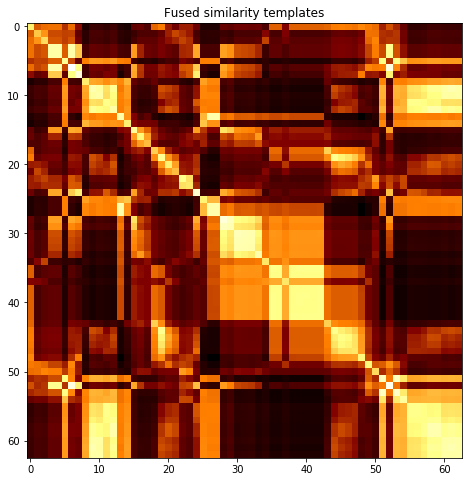

subject 15; gesture 1_0_2


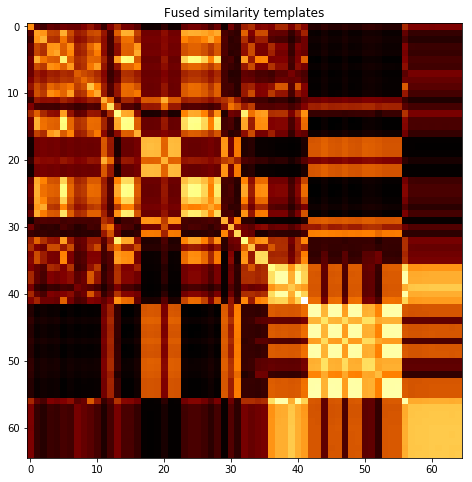

subject 15; gesture 4_0_2


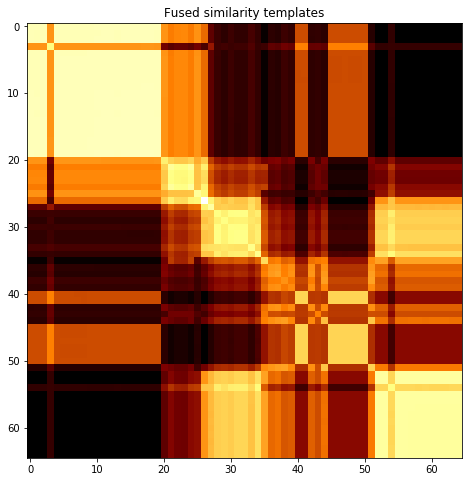

subject 28; gesture 3_0_1


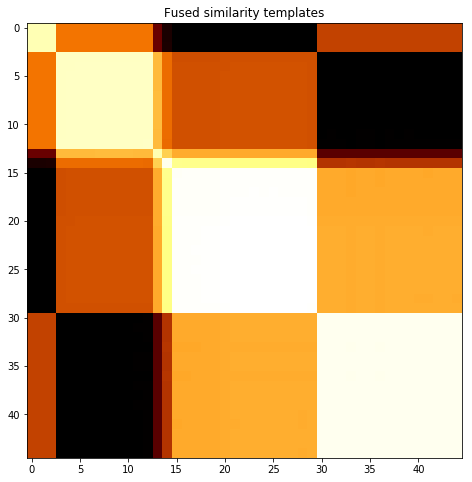

subject 28; gesture 4_1_1


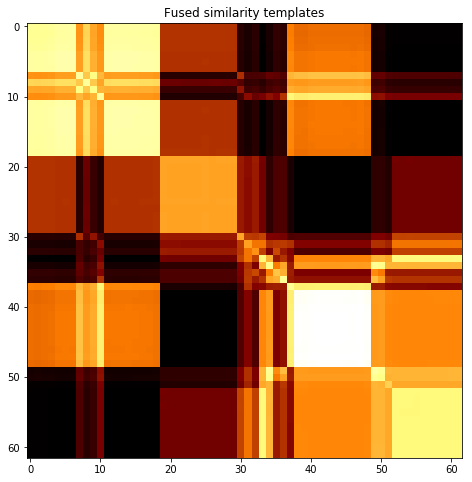

subject 28; gesture 2_0_1


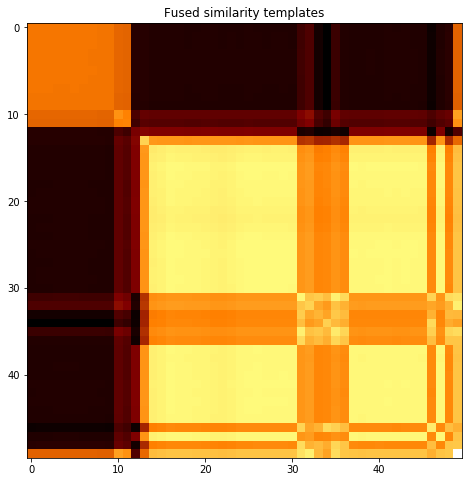

subject 28; gesture 4_1_2


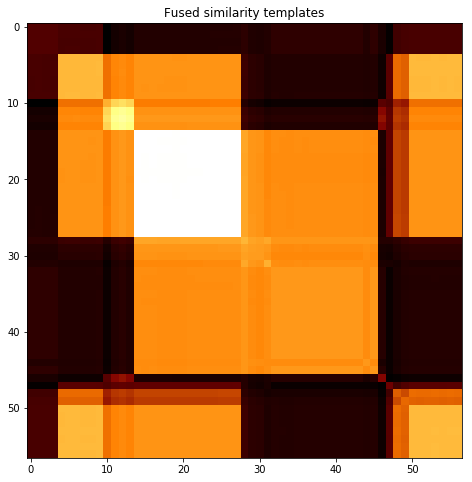

subject 28; gesture 2_0_2


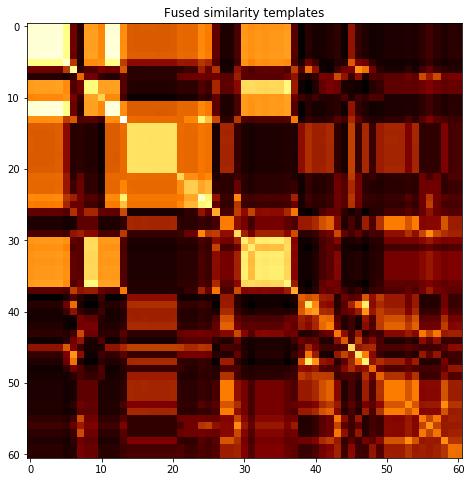

subject 28; gesture 1_1_2


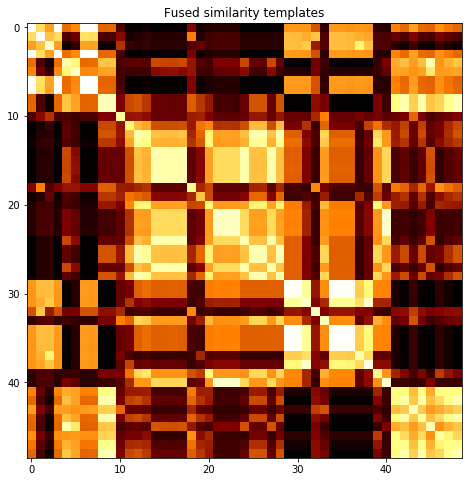

subject 28; gesture 2_1_2


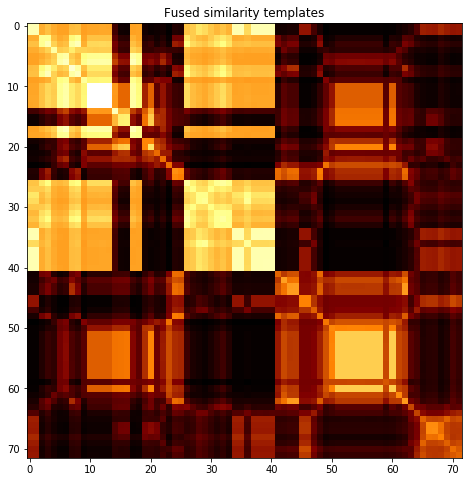

subject 28; gesture 4_0_1


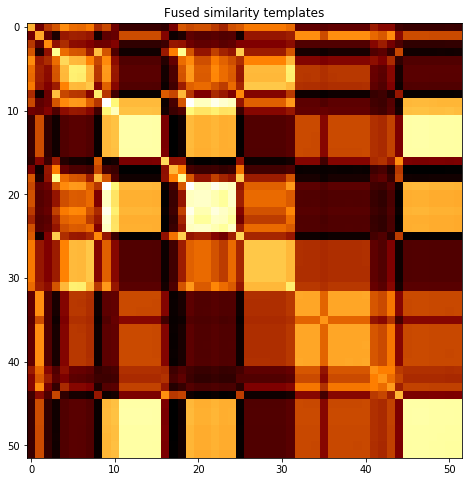

subject 28; gesture 3_0_2


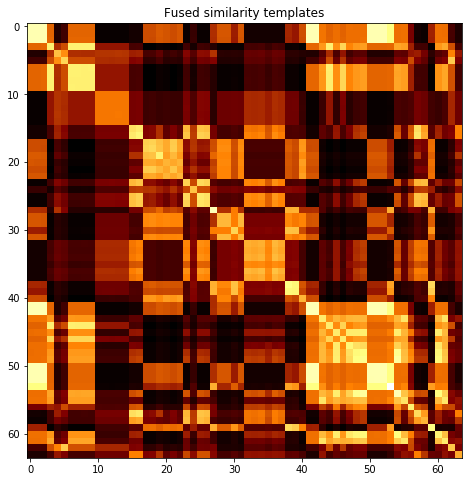

subject 28; gesture 1_1_1


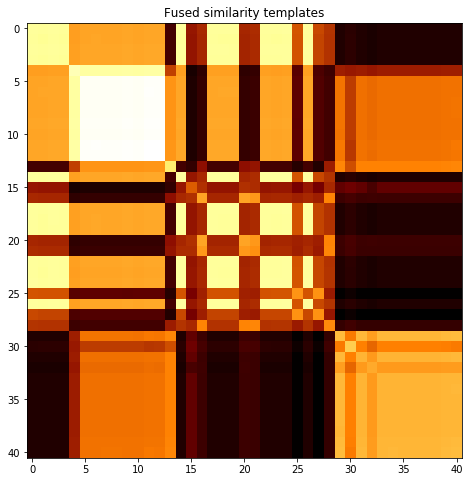

subject 28; gesture 3_1_2


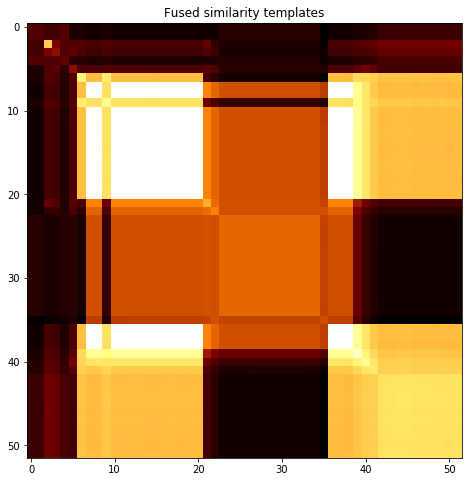

subject 28; gesture 2_1_1


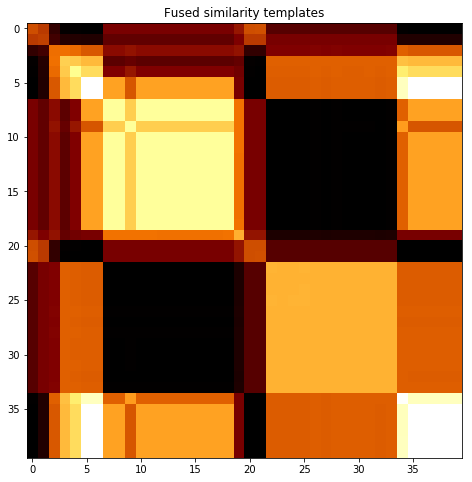

subject 28; gesture 1_0_1


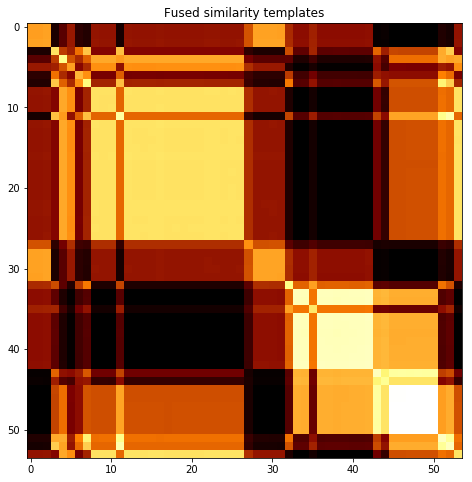

subject 28; gesture 3_1_1


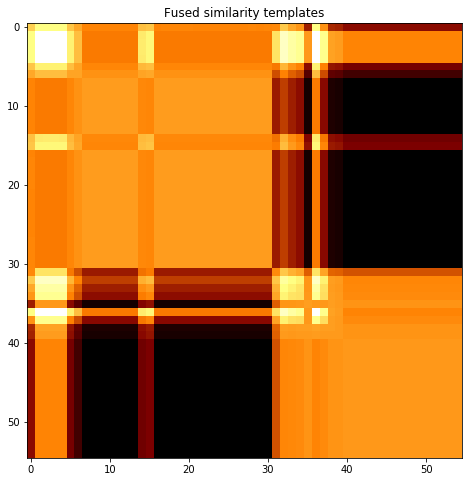

subject 28; gesture 1_0_2


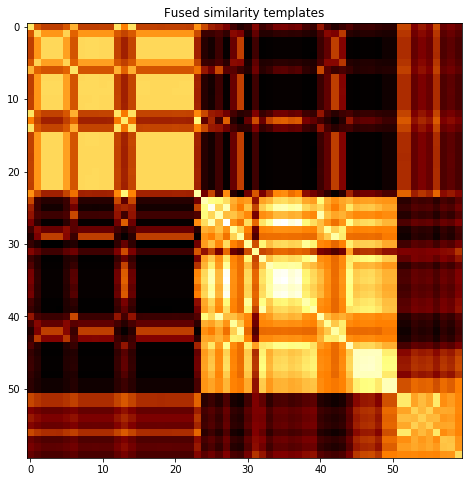

subject 28; gesture 4_0_2


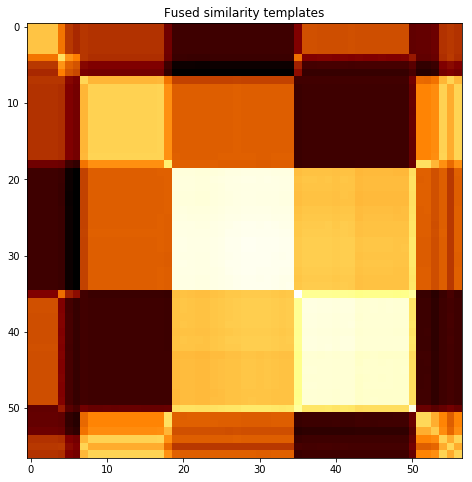

subject 12; gesture 3_0_1


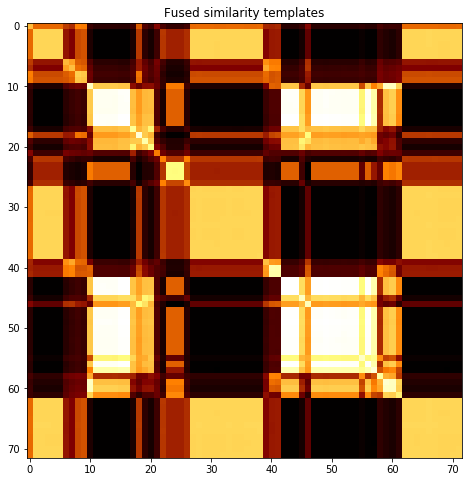

subject 12; gesture 4_1_1


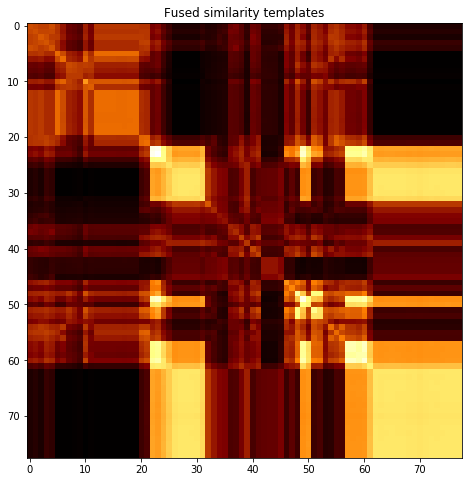

subject 12; gesture 2_0_1


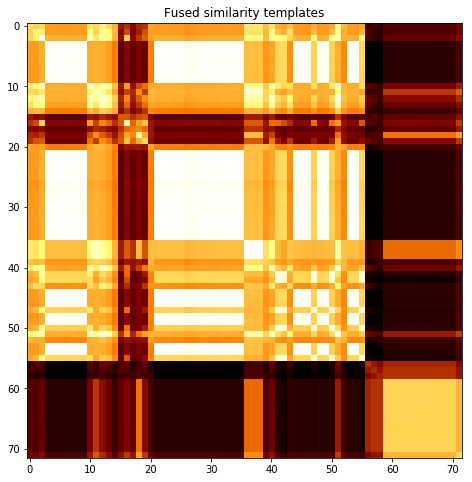

subject 12; gesture 4_1_2


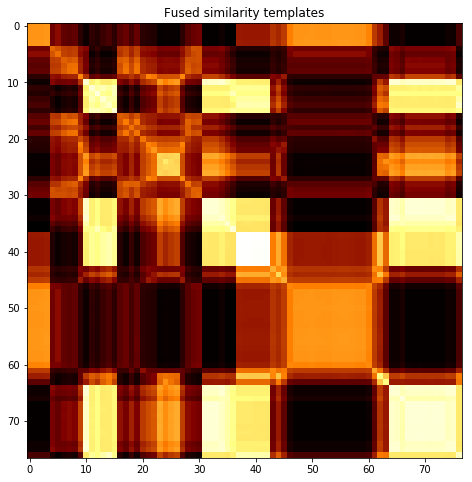

subject 12; gesture 2_0_2


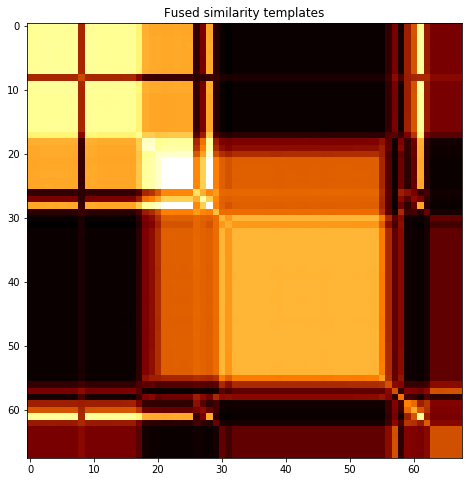

subject 12; gesture 1_1_2


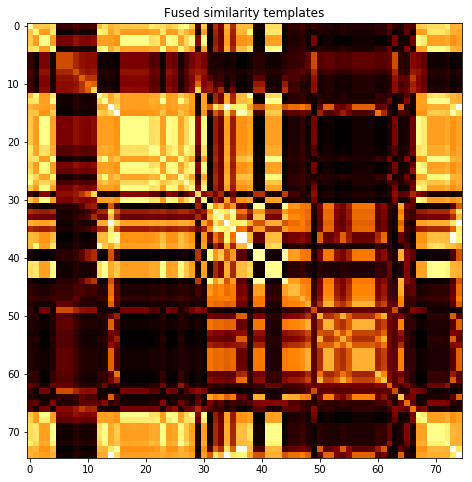

subject 12; gesture 2_1_2


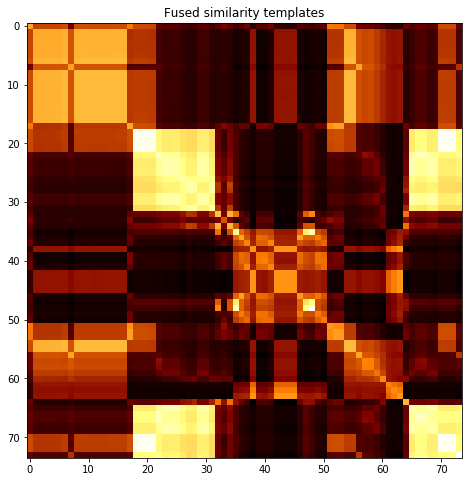

subject 12; gesture 4_0_1


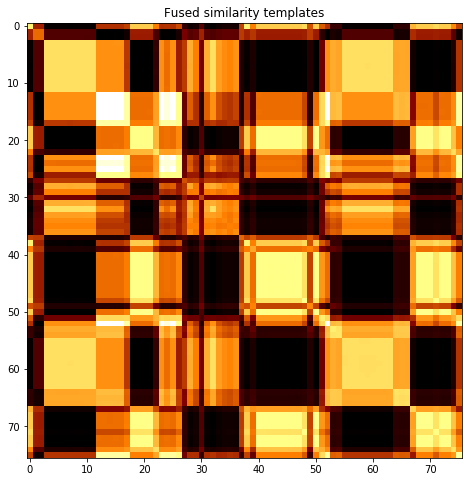

subject 12; gesture 3_0_2


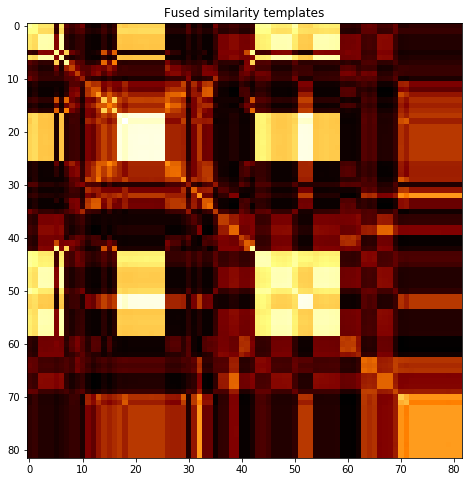

subject 12; gesture 1_1_1


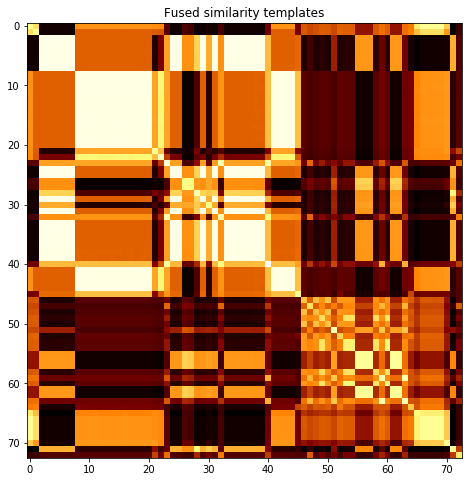

subject 12; gesture 3_1_2


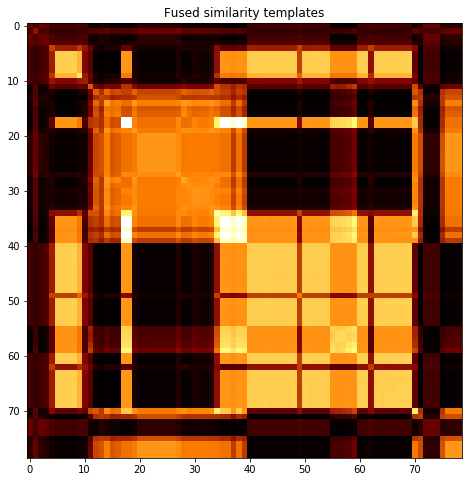

subject 12; gesture 2_1_1


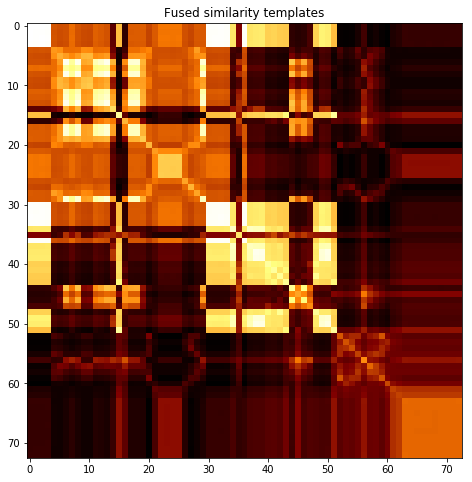

subject 12; gesture 1_0_1


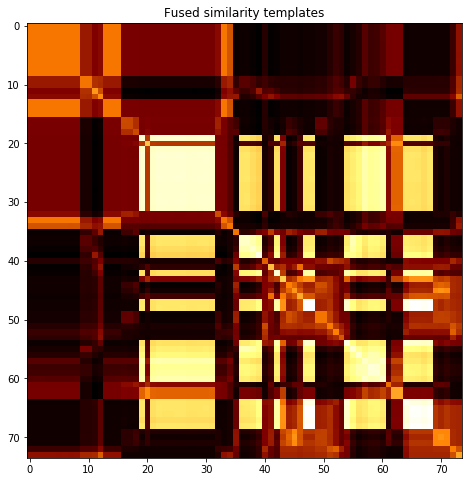

subject 12; gesture 3_1_1


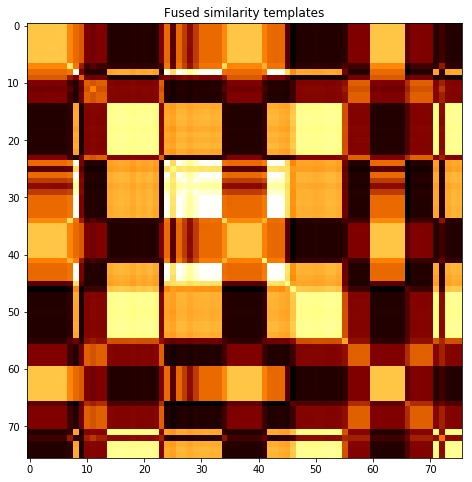

subject 12; gesture 1_0_2


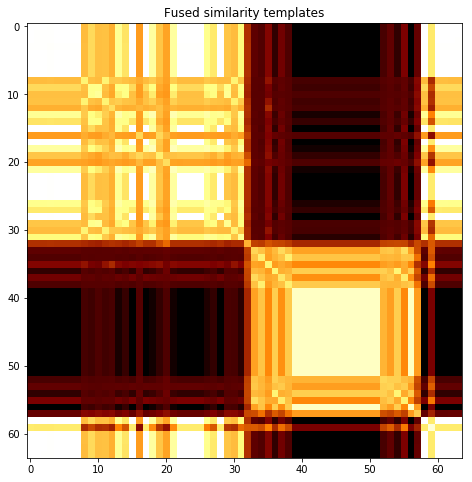

subject 12; gesture 4_0_2


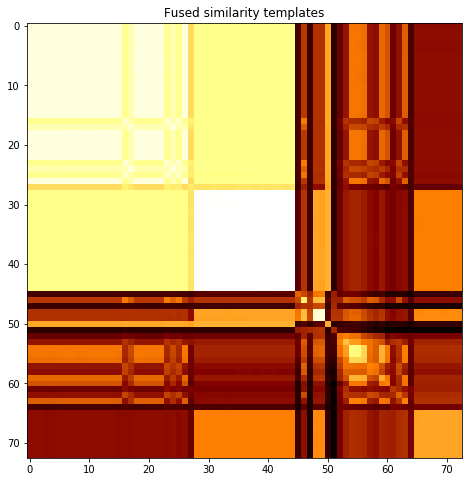

subject 19; gesture 3_0_1


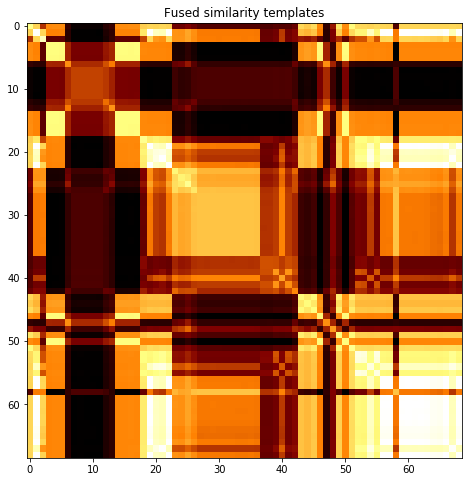

subject 19; gesture 4_1_1


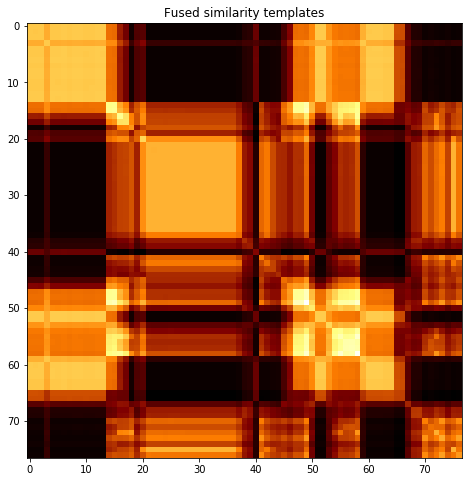

subject 19; gesture 2_0_1


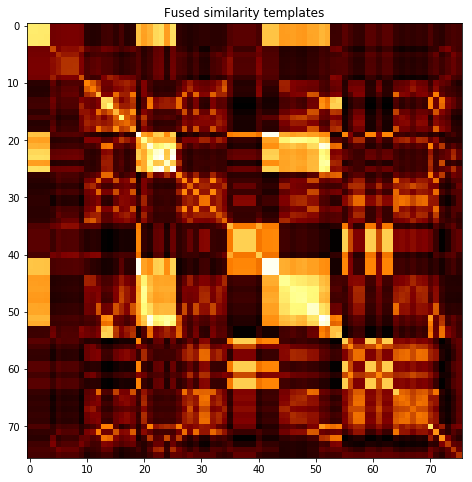

subject 19; gesture 4_1_2


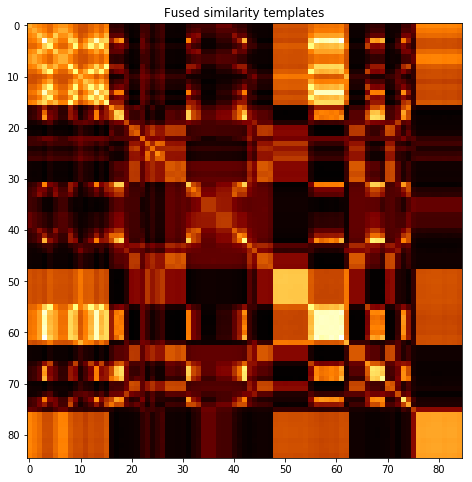

subject 19; gesture 2_0_2


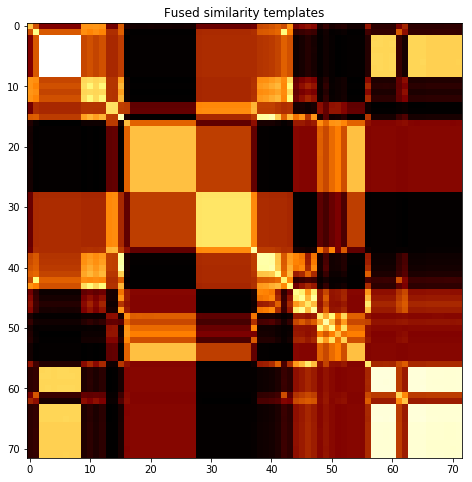

subject 19; gesture 1_1_2


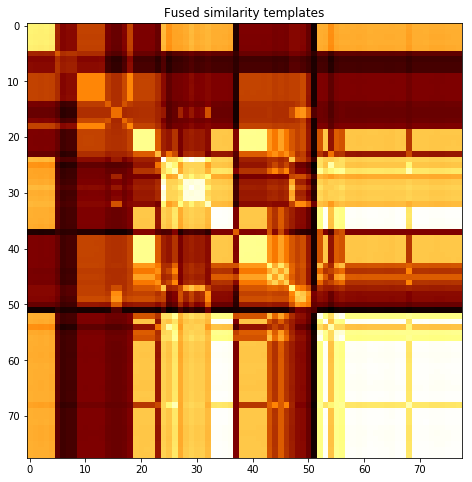

subject 19; gesture 2_1_2


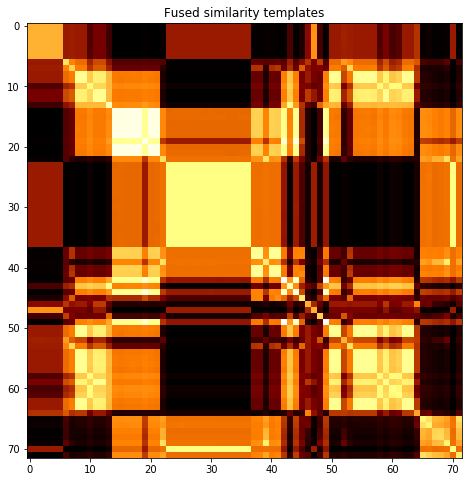

subject 19; gesture 4_0_1


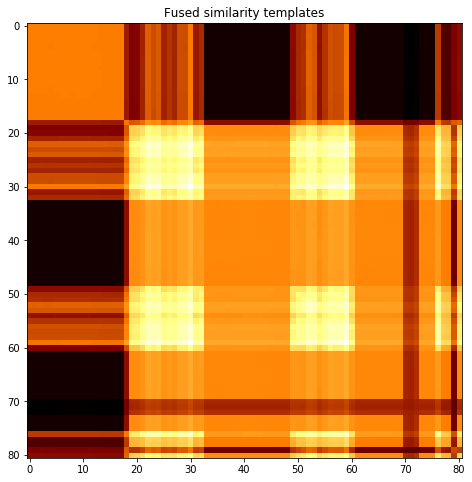

subject 19; gesture 3_0_2


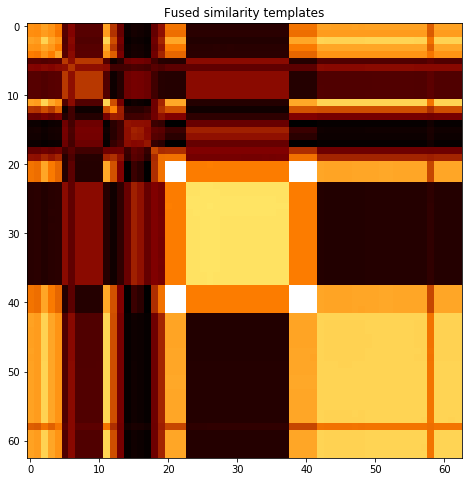

subject 19; gesture 1_1_1


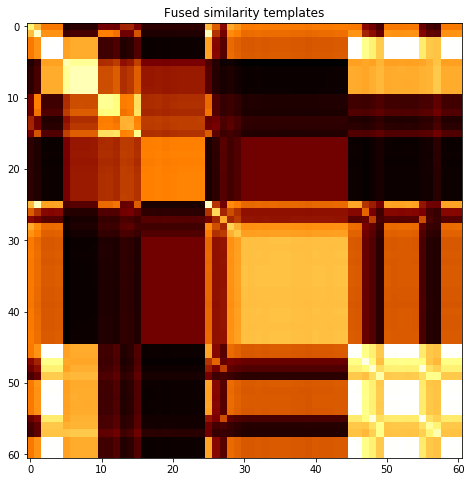

subject 19; gesture 3_1_2


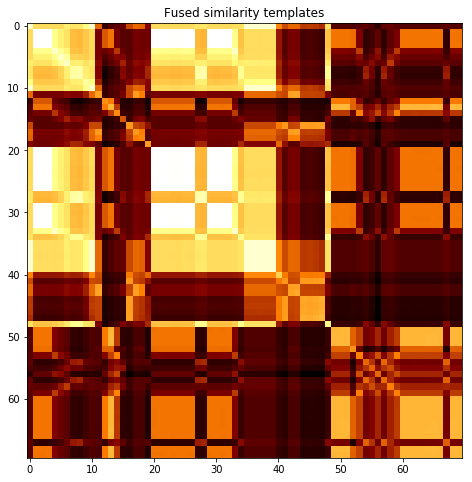

subject 19; gesture 2_1_1


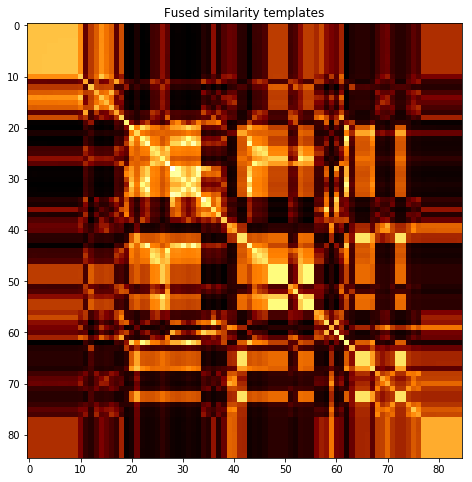

subject 19; gesture 1_0_1


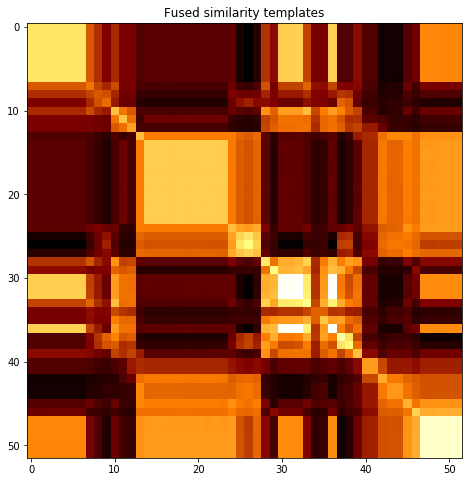

subject 19; gesture 3_1_1


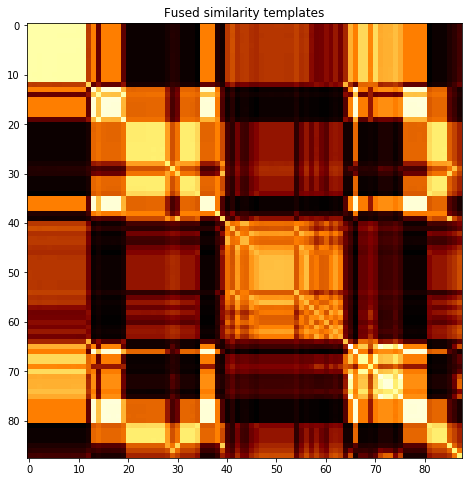

subject 19; gesture 1_0_2


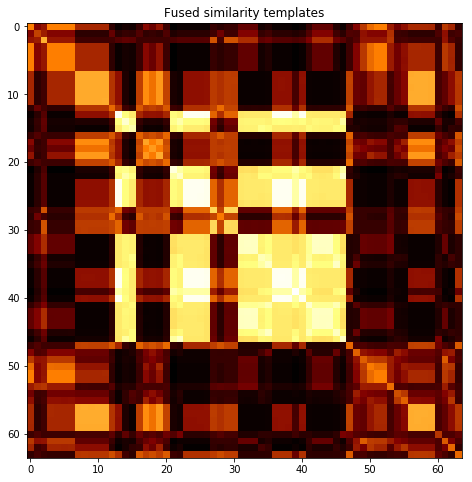

subject 19; gesture 4_0_2


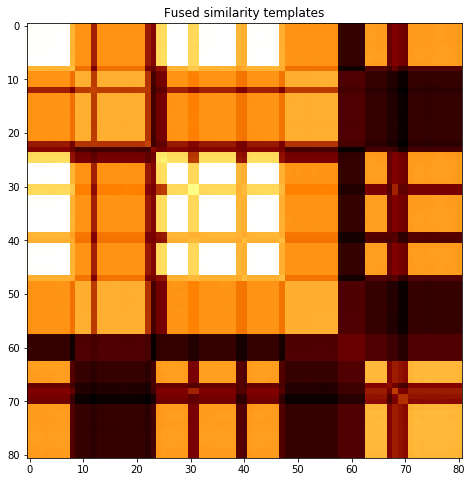

subject 07; gesture 3_0_1


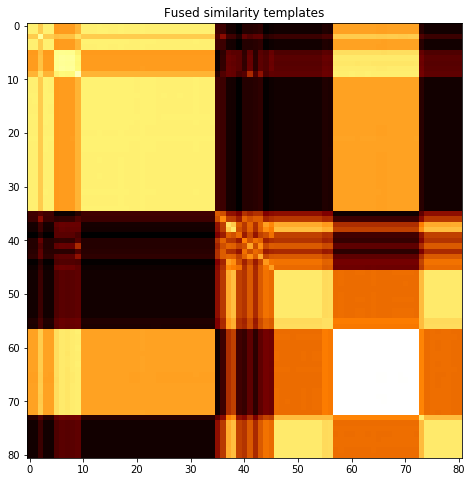

subject 07; gesture 4_1_1


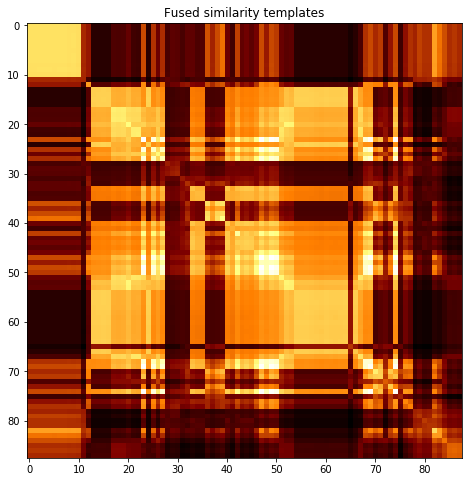

subject 07; gesture 2_0_1


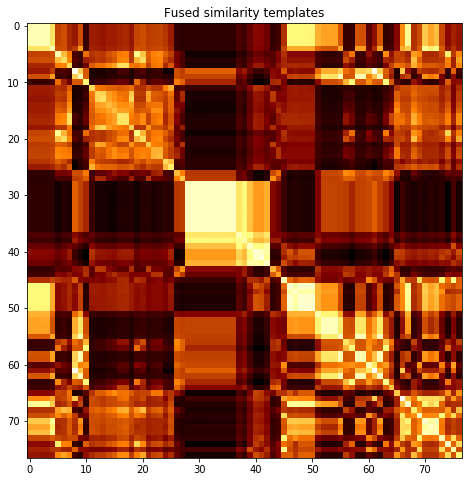

subject 07; gesture 4_1_2


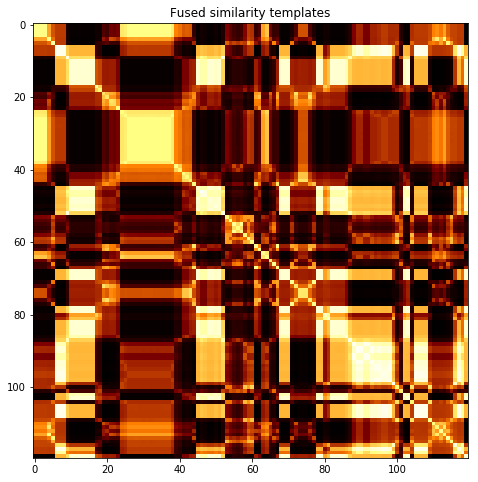

subject 07; gesture 2_0_2


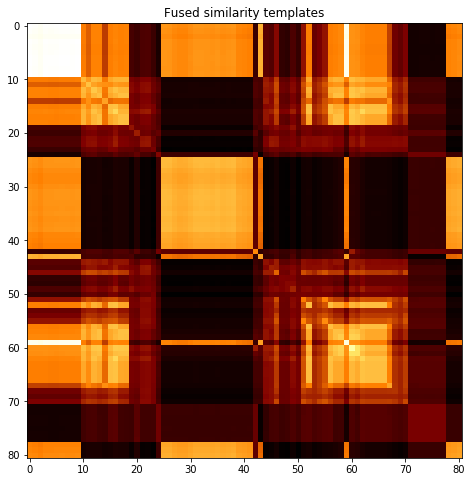

subject 07; gesture 1_1_2


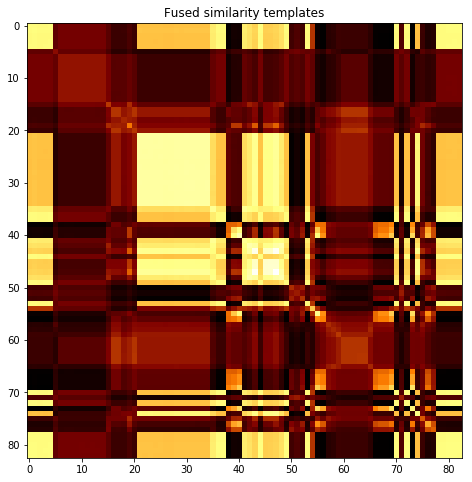

subject 07; gesture 2_1_2


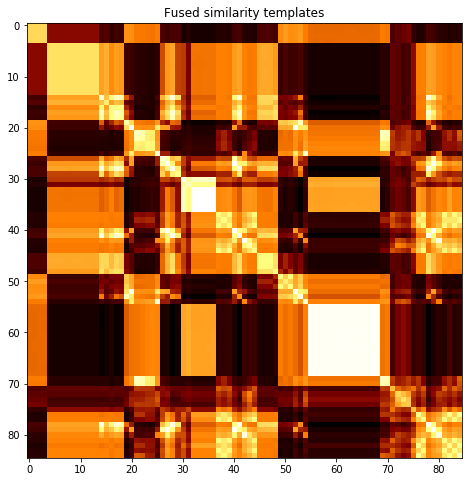

subject 07; gesture 4_0_1


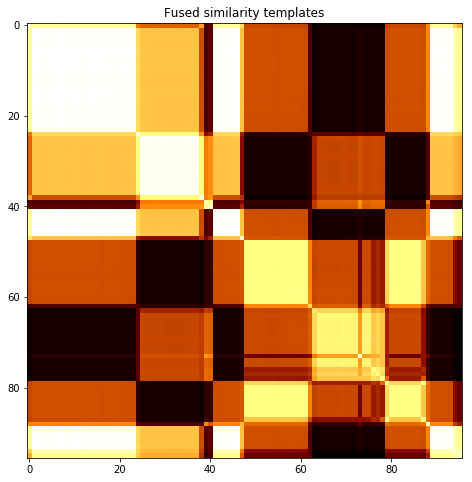

subject 07; gesture 3_0_2


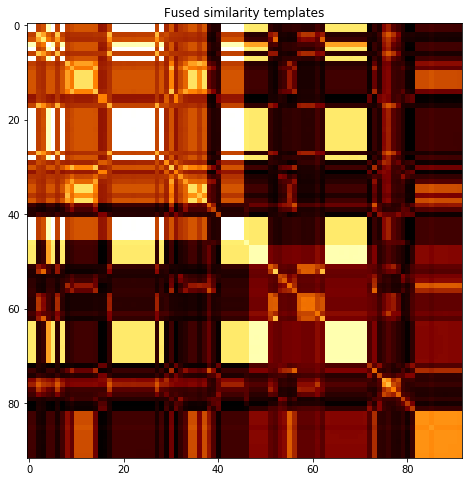

subject 07; gesture 1_1_1


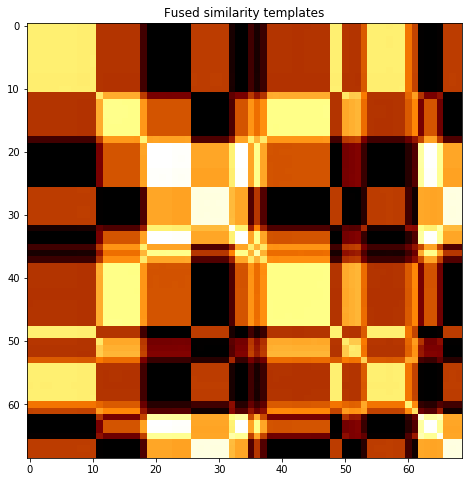

subject 07; gesture 3_1_2


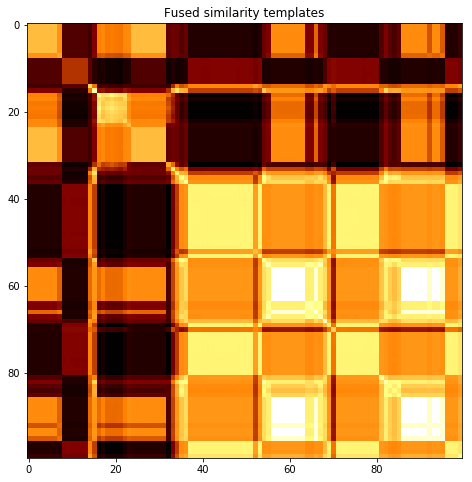

subject 07; gesture 2_1_1


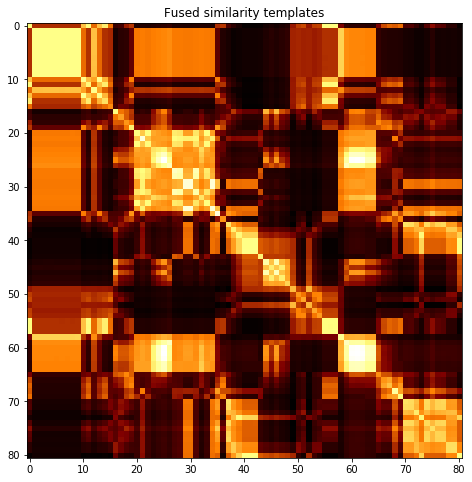

subject 07; gesture 1_0_1


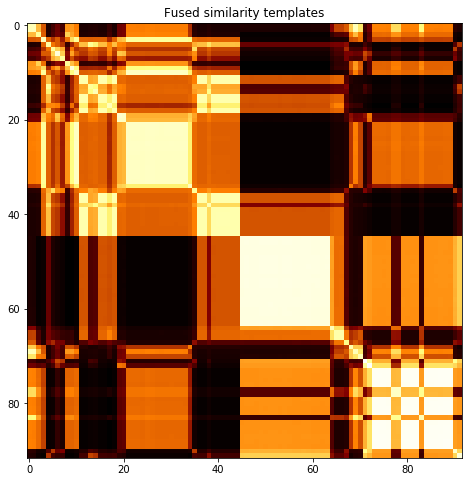

subject 07; gesture 3_1_1


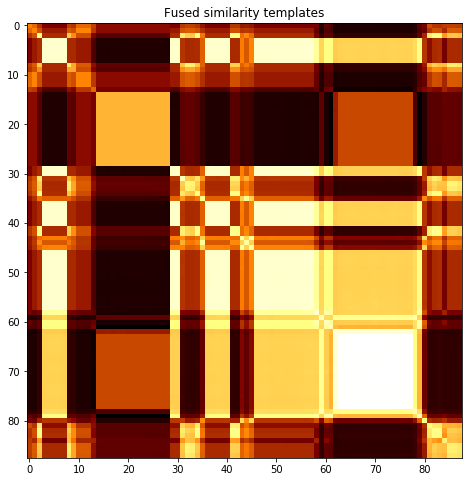

subject 07; gesture 1_0_2


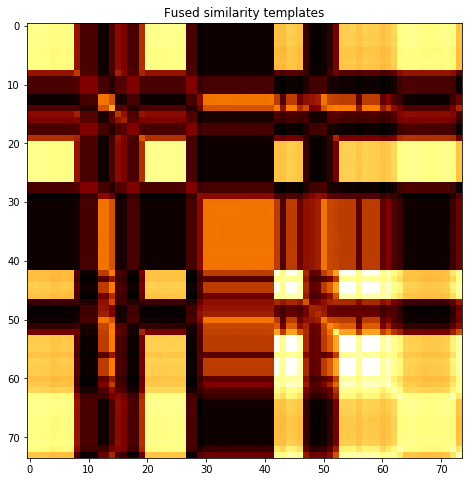

subject 07; gesture 4_0_2


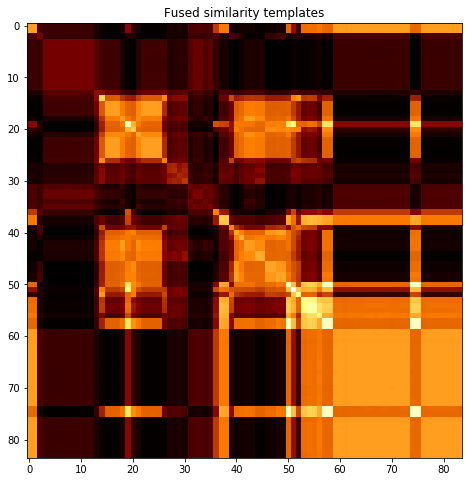

subject 20; gesture 3_0_1


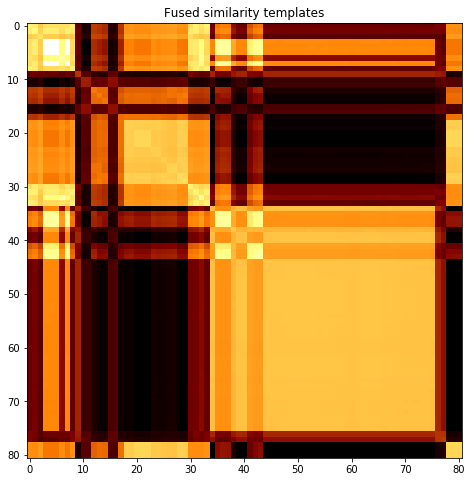

subject 20; gesture 4_1_1


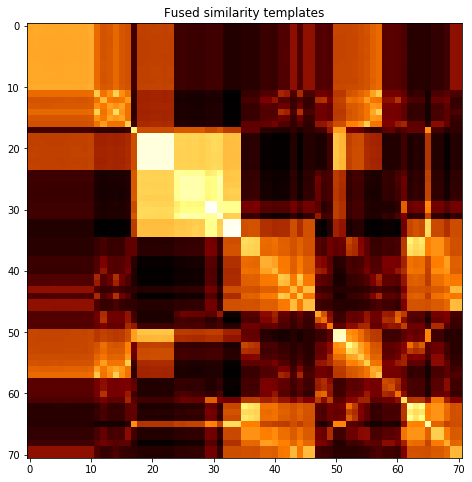

subject 20; gesture 2_0_1


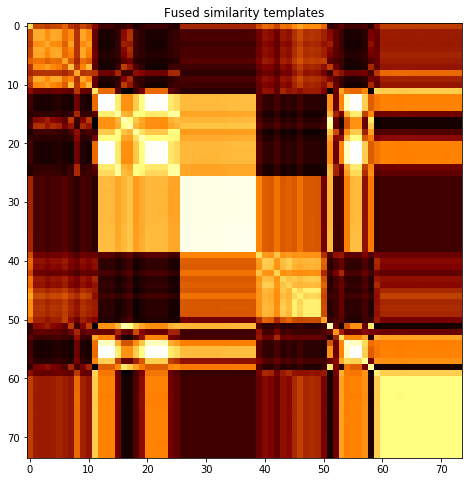

subject 20; gesture 4_1_2


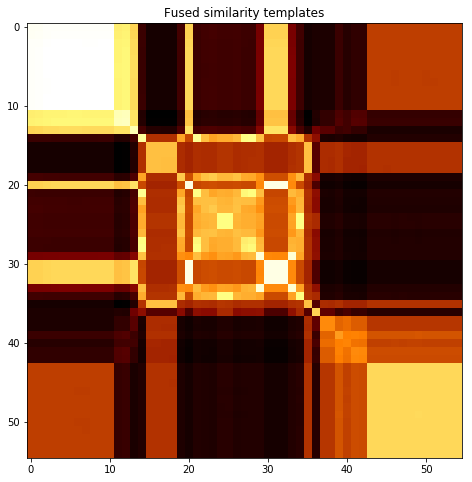

subject 20; gesture 2_0_2


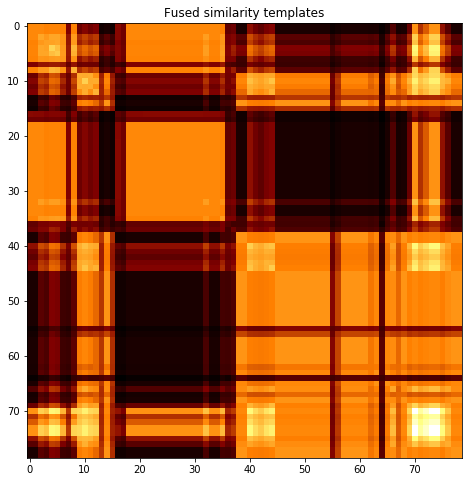

subject 20; gesture 1_1_2


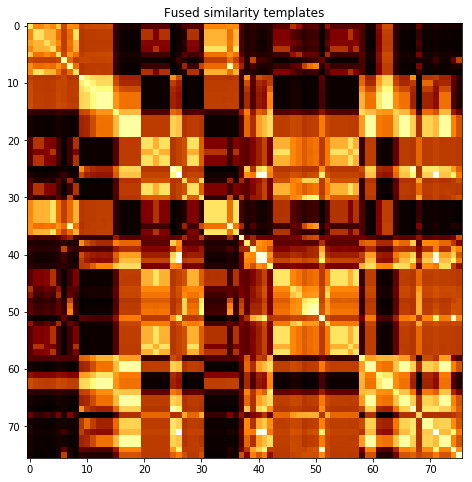

subject 20; gesture 2_1_2


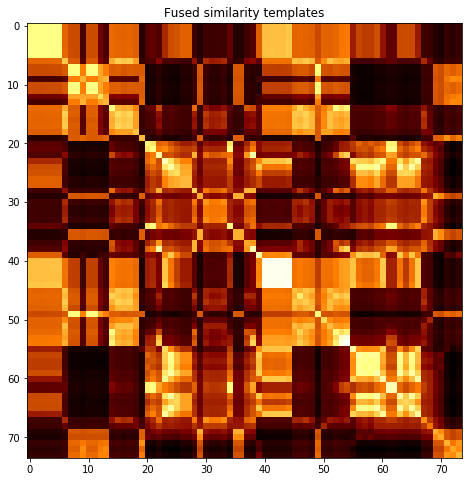

subject 20; gesture 4_0_1


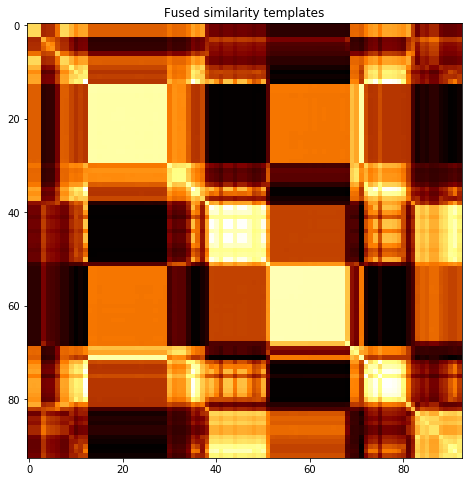

subject 20; gesture 3_0_2


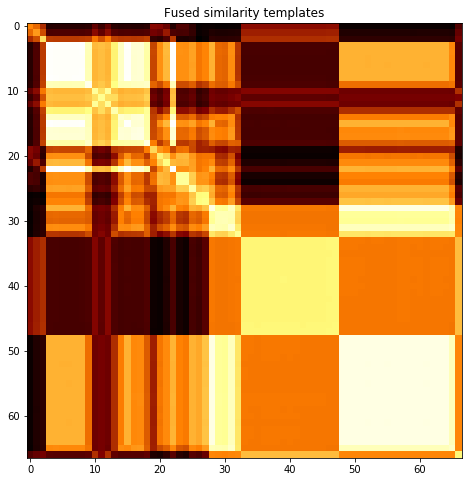

subject 20; gesture 1_1_1


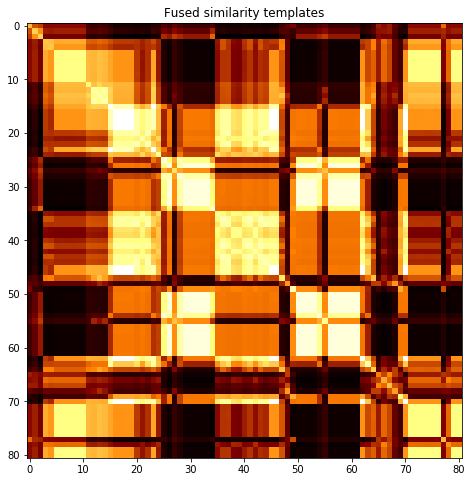

subject 20; gesture 3_1_2


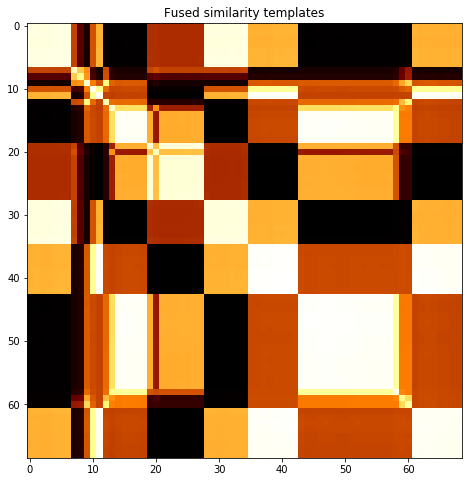

subject 20; gesture 2_1_1


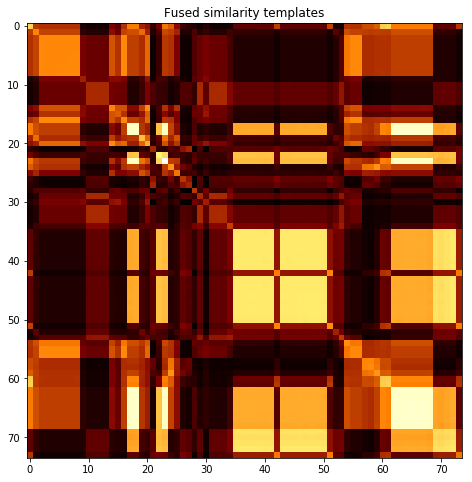

subject 20; gesture 1_0_1


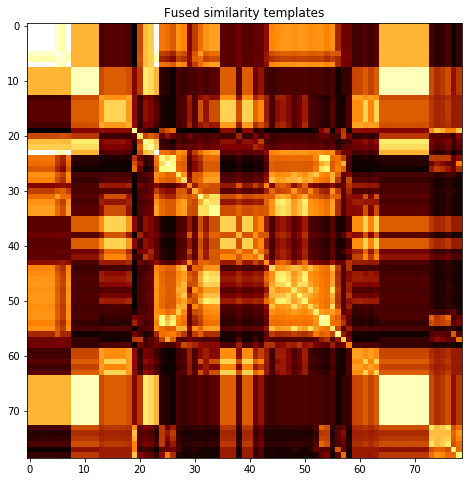

subject 20; gesture 3_1_1


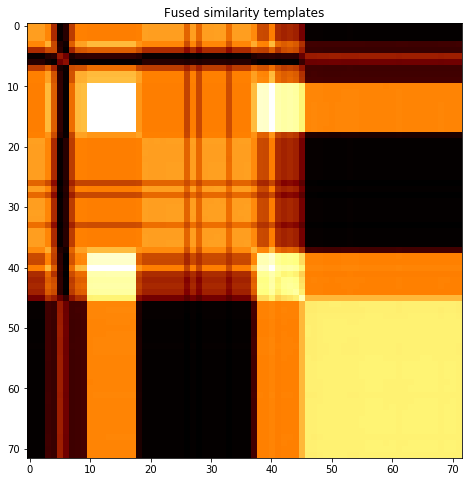

subject 20; gesture 1_0_2


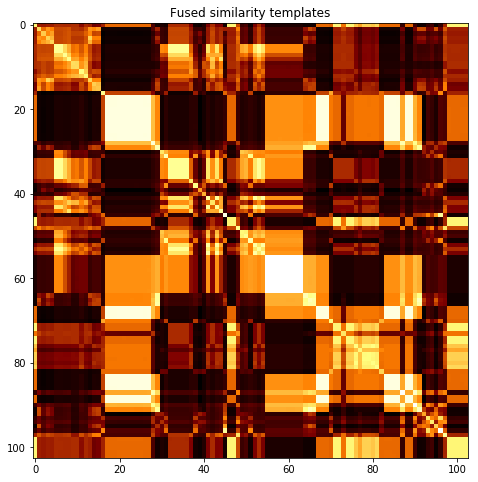

subject 20; gesture 4_0_2


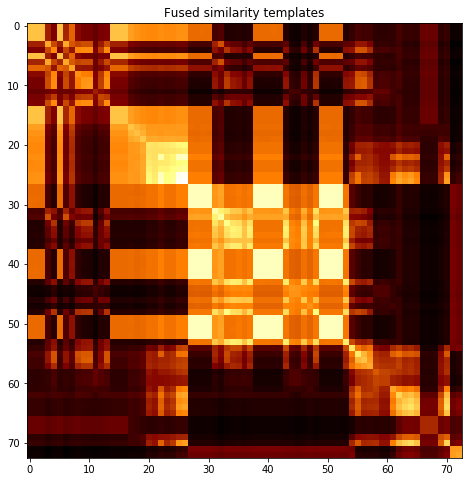

subject 31; gesture 3_0_1


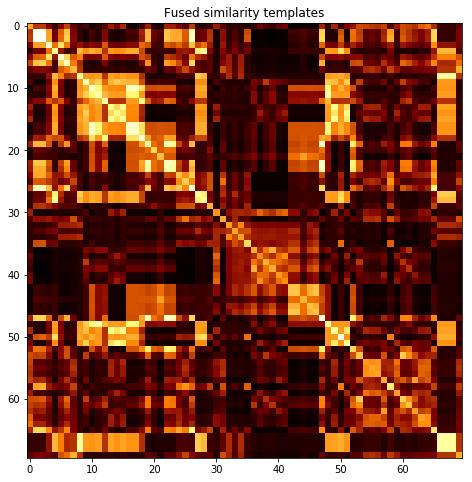

subject 31; gesture 4_1_1


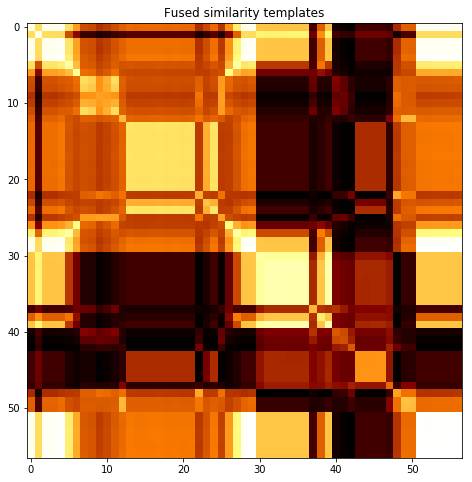

subject 31; gesture 2_0_1


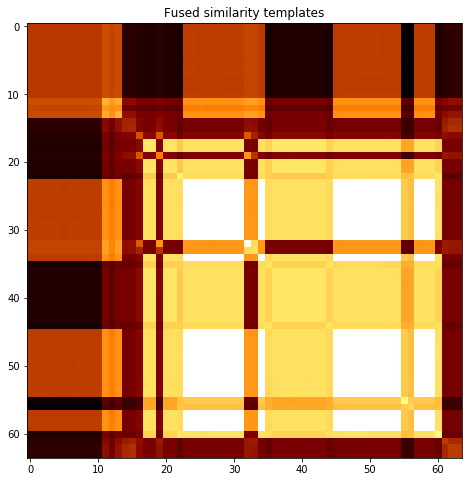

subject 31; gesture 4_1_2


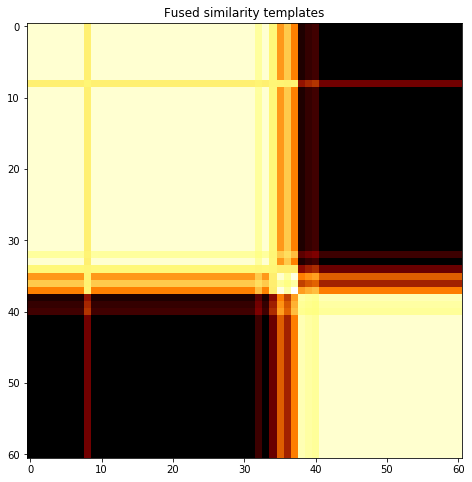

subject 31; gesture 2_0_2


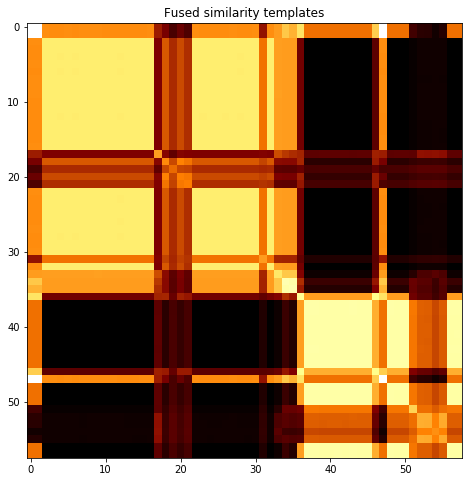

subject 31; gesture 1_1_2


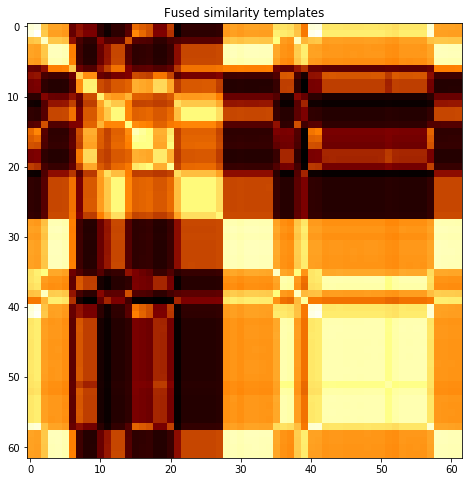

subject 31; gesture 2_1_2


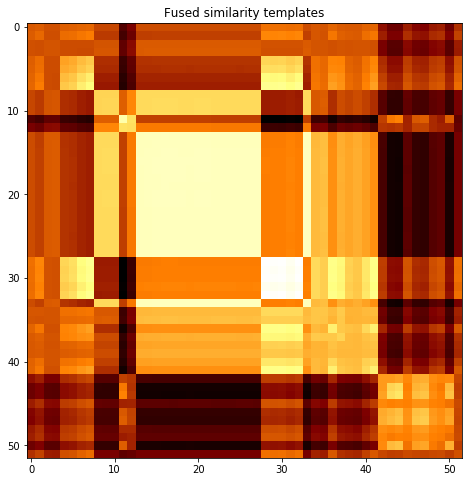

subject 31; gesture 4_0_1


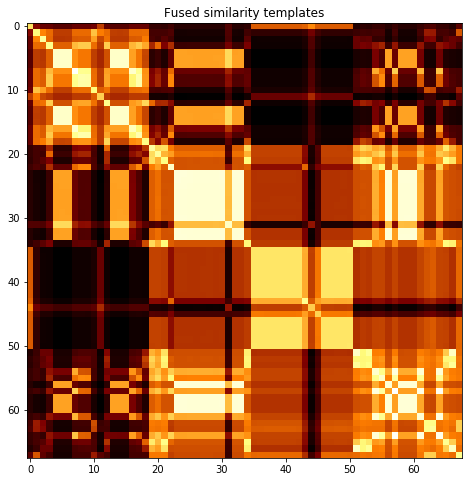

subject 31; gesture 3_0_2


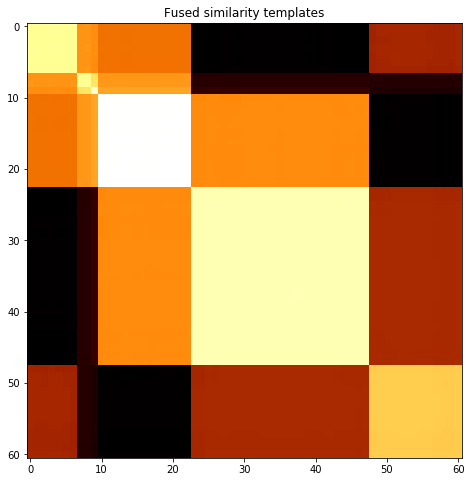

subject 31; gesture 1_1_1


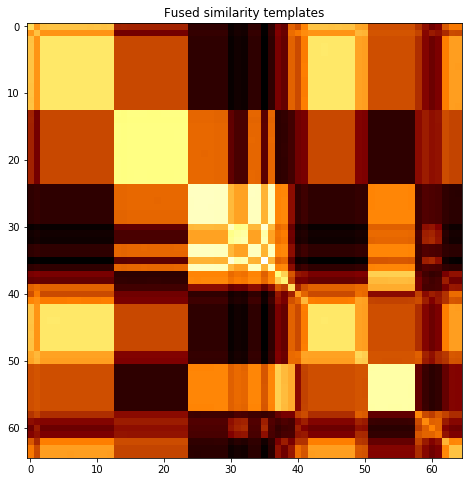

subject 31; gesture 3_1_2


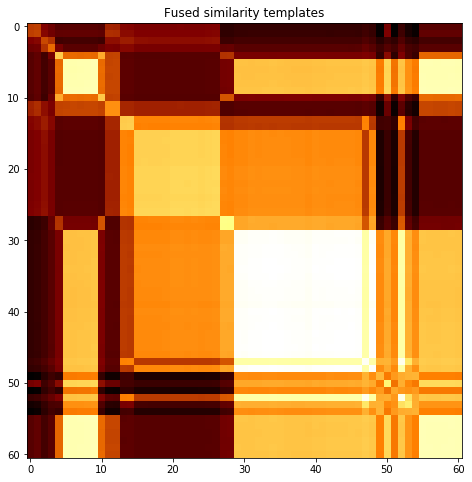

subject 31; gesture 2_1_1


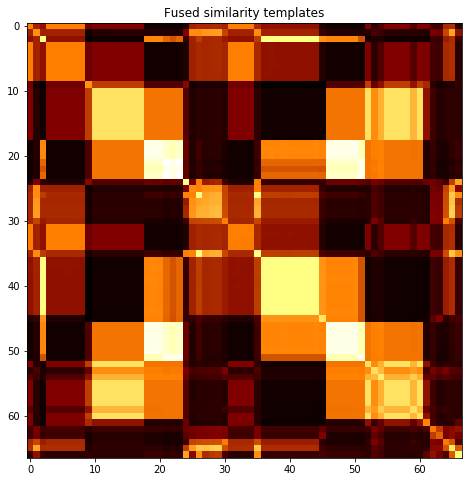

subject 31; gesture 1_0_1


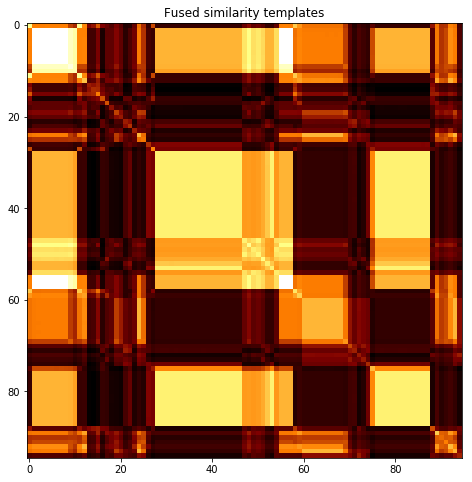

subject 31; gesture 3_1_1


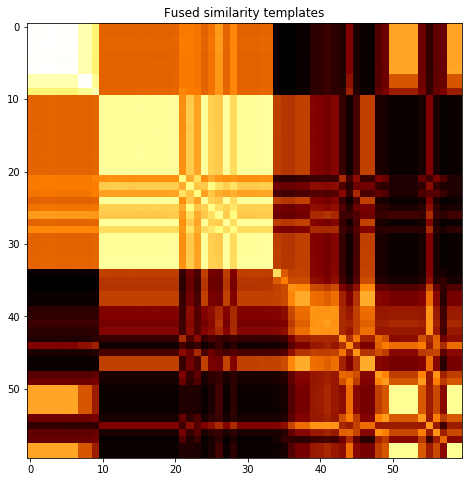

subject 31; gesture 1_0_2


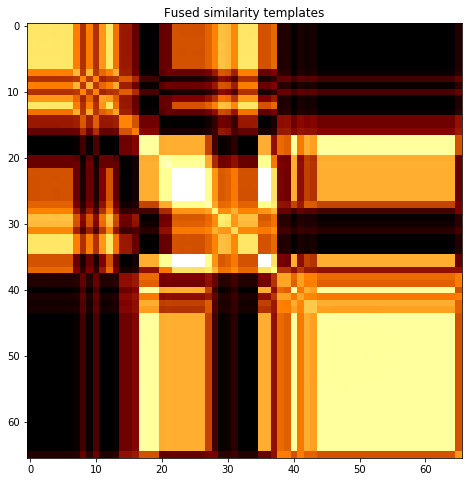

subject 31; gesture 4_0_2


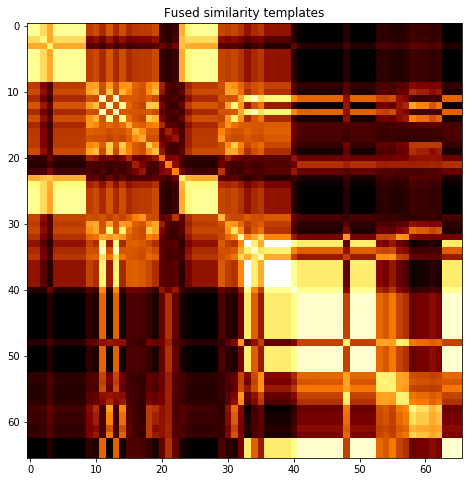

subject 13; gesture 3_0_1


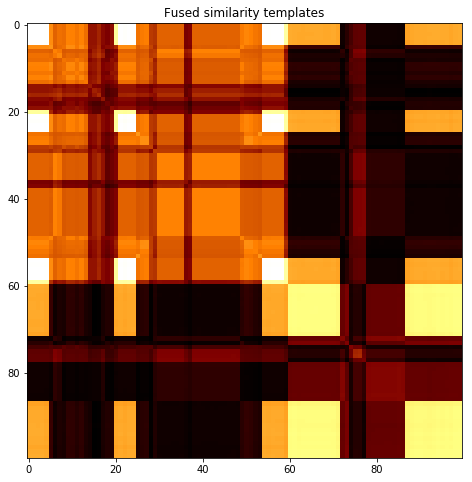

subject 13; gesture 4_1_1


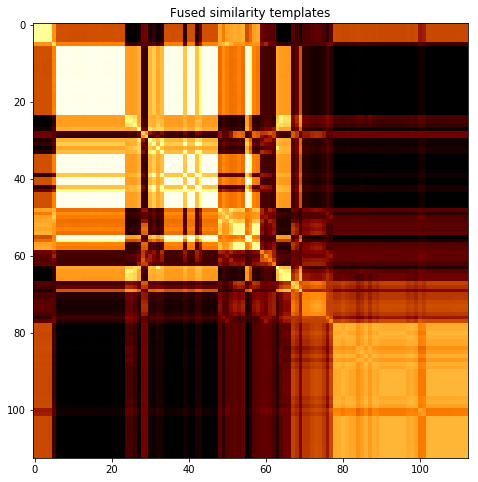

subject 13; gesture 2_0_1


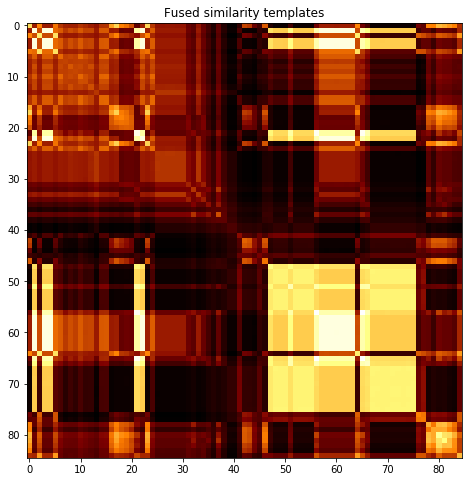

subject 13; gesture 4_1_2


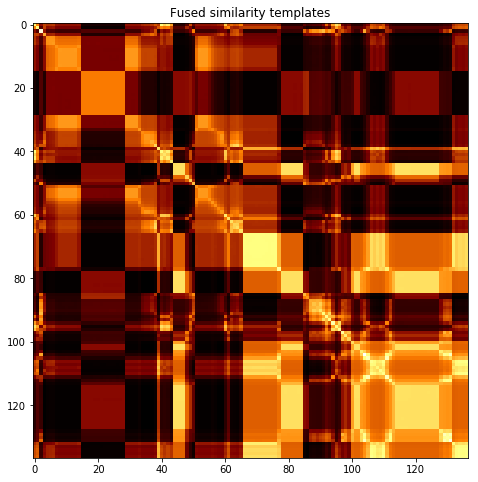

subject 13; gesture 2_0_2


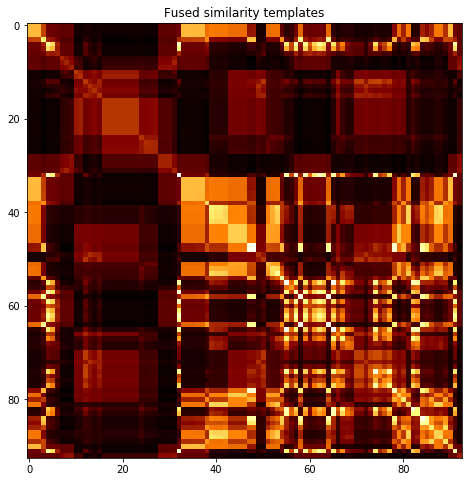

subject 13; gesture 1_1_2


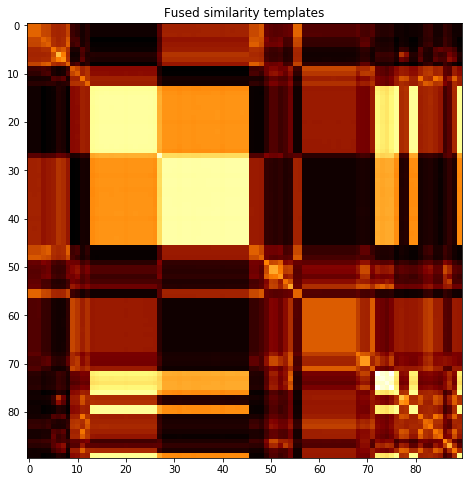

subject 13; gesture 2_1_2


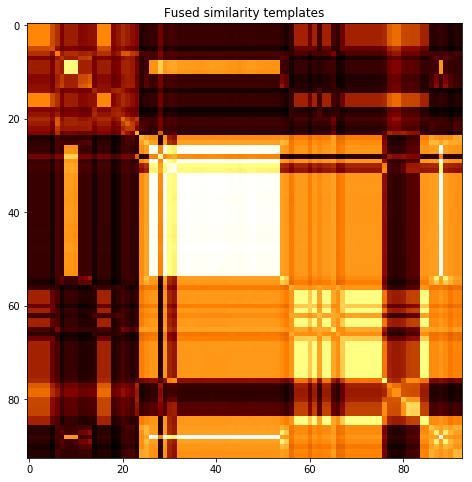

subject 13; gesture 4_0_1


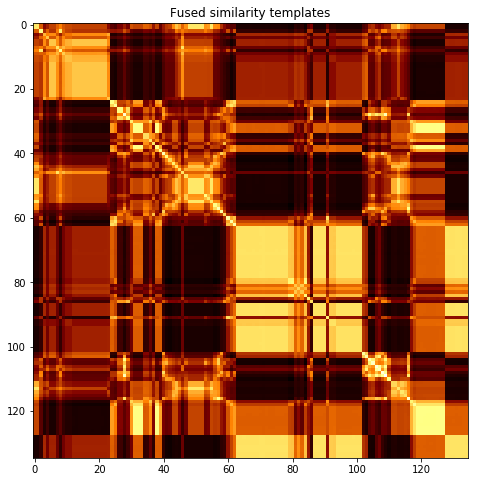

subject 13; gesture 3_0_2


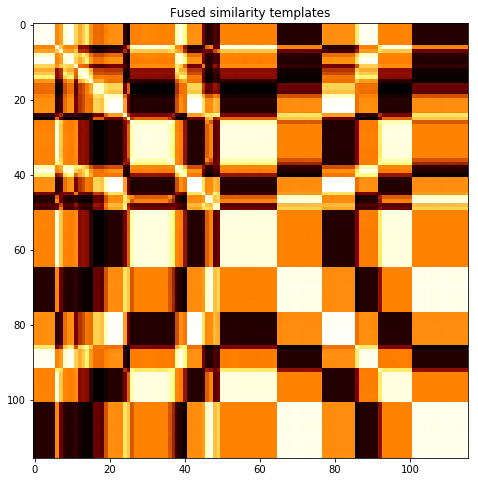

subject 13; gesture 1_1_1


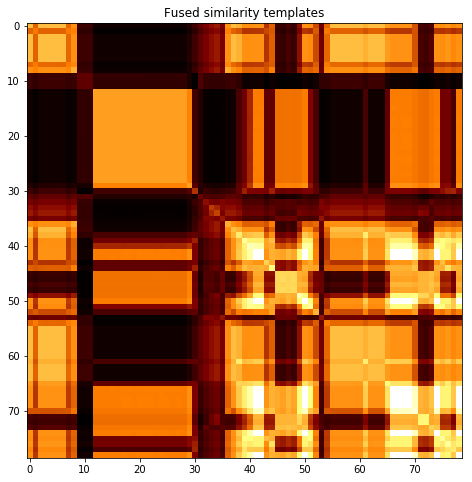

subject 13; gesture 3_1_2


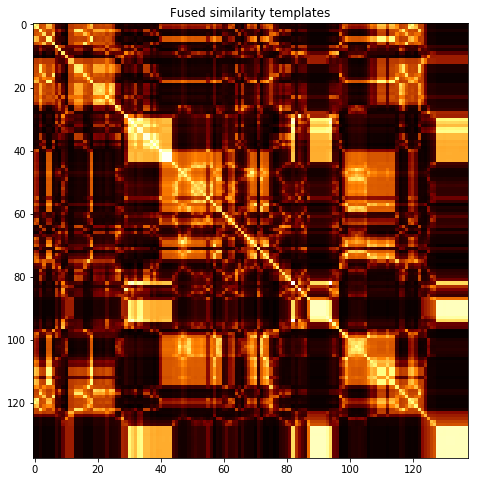

subject 13; gesture 2_1_1


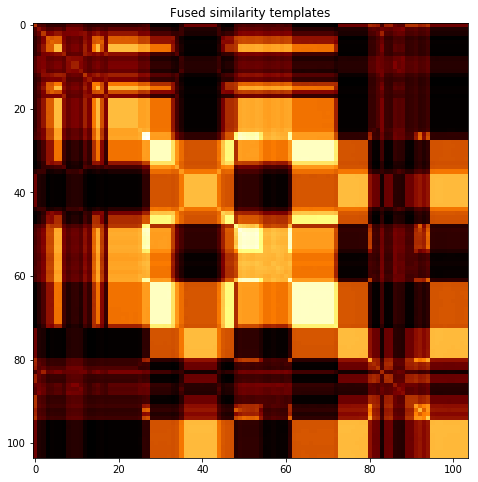

subject 13; gesture 1_0_1


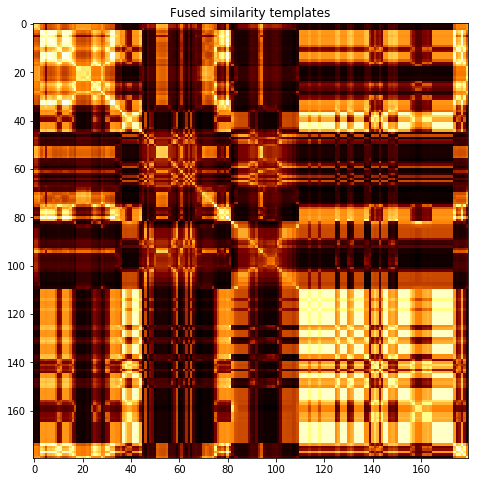

subject 13; gesture 3_1_1


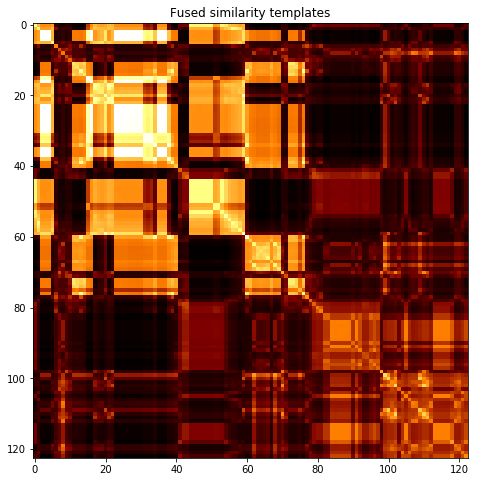

subject 13; gesture 1_0_2


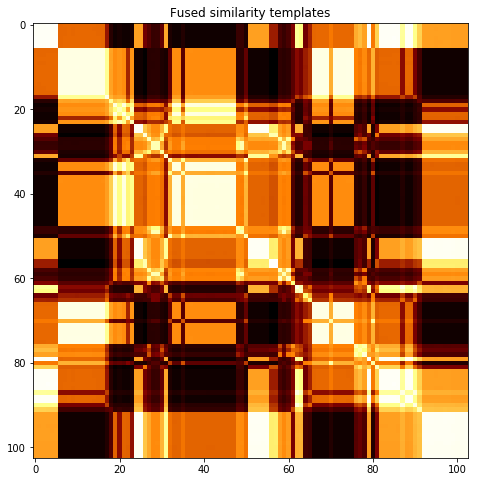

subject 13; gesture 4_0_2


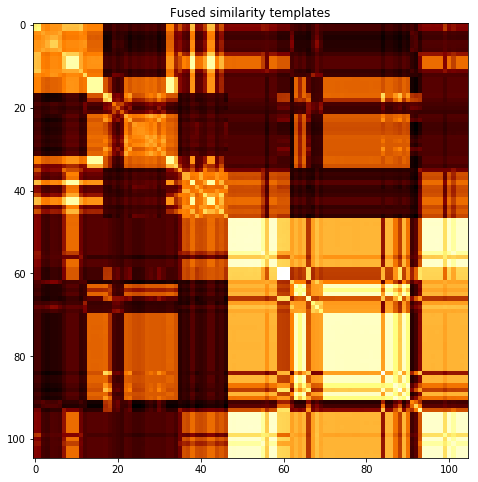

subject 36; gesture 3_0_1


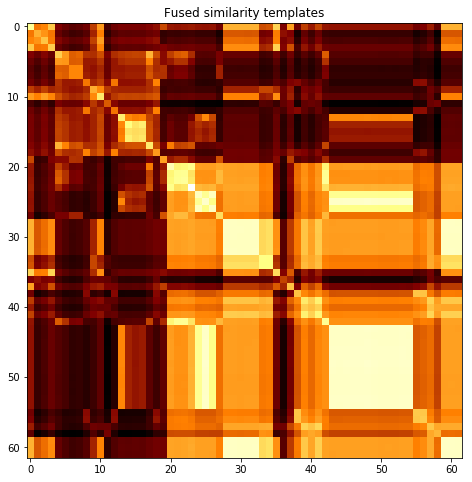

subject 36; gesture 4_1_1


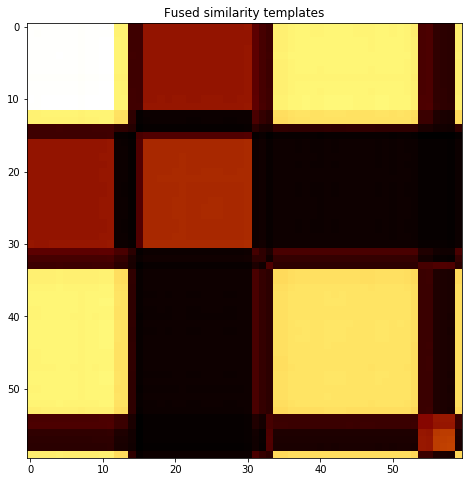

subject 36; gesture 2_0_1


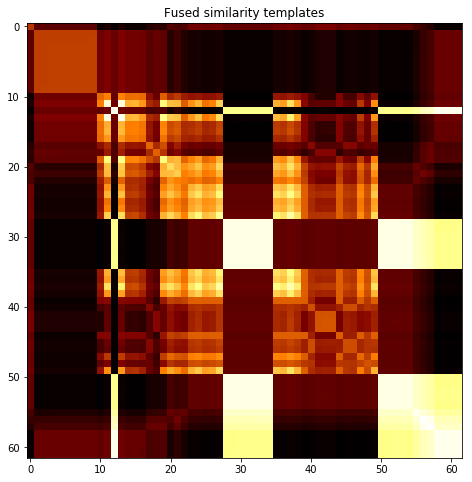

subject 36; gesture 4_1_2


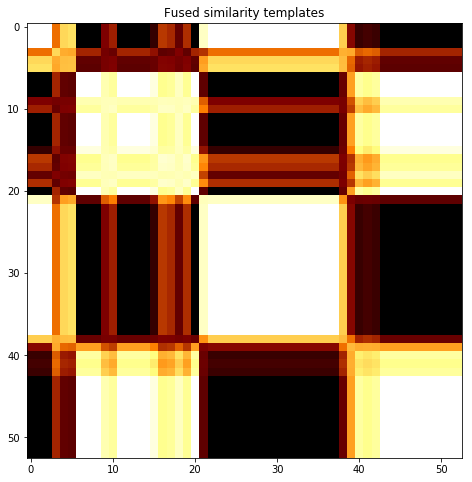

subject 36; gesture 2_0_2


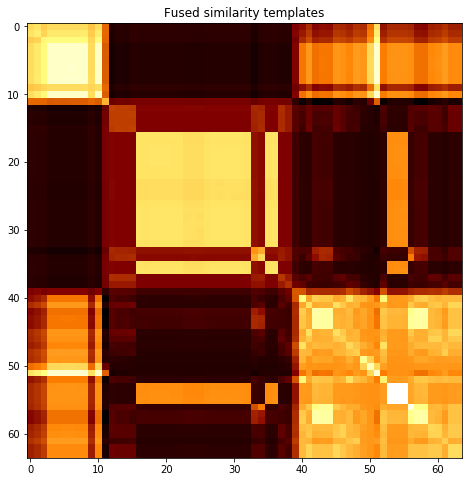

subject 36; gesture 1_1_2


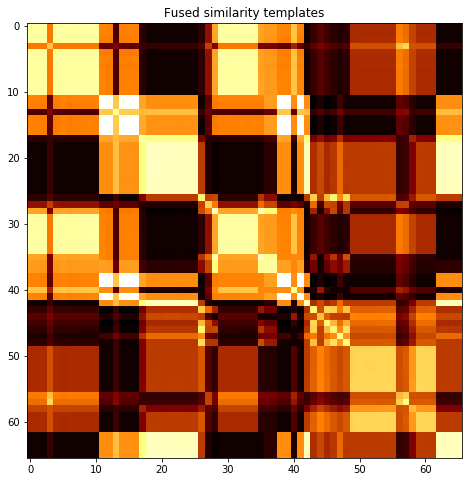

subject 36; gesture 2_1_2


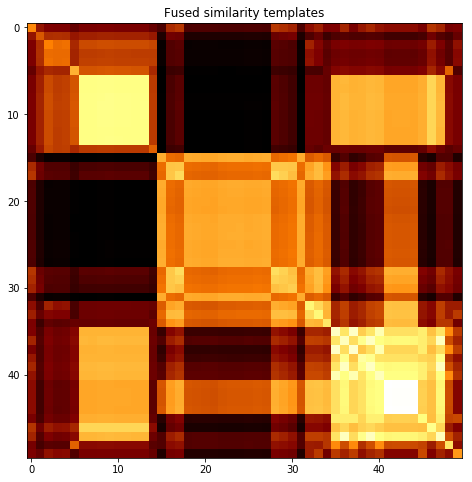

subject 36; gesture 4_0_1


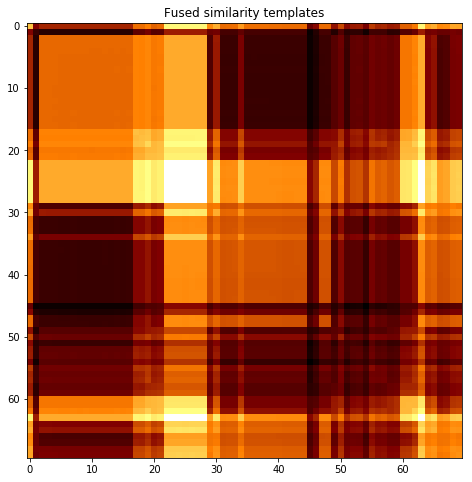

subject 36; gesture 3_0_2


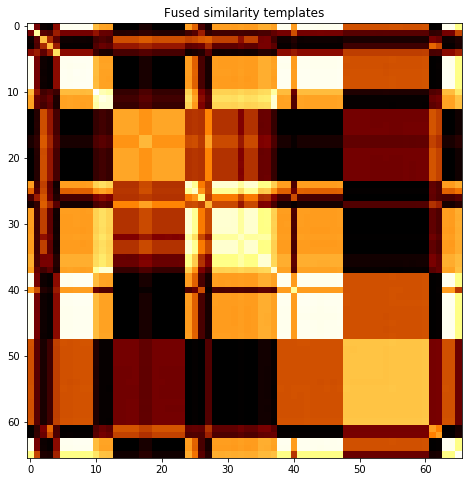

subject 36; gesture 1_1_1


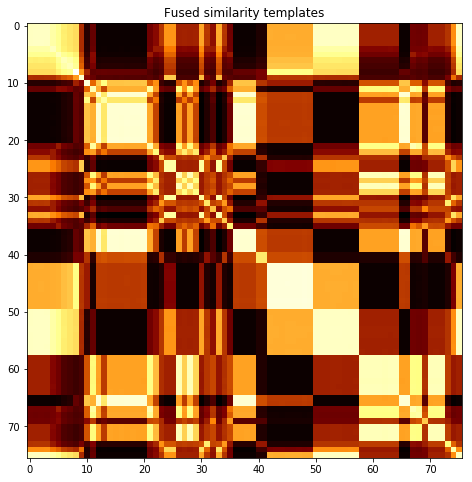

subject 36; gesture 3_1_2


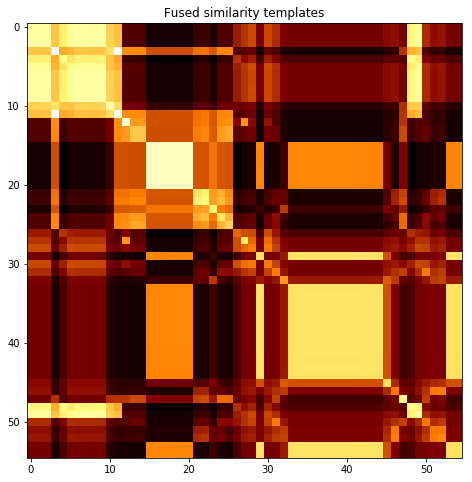

subject 36; gesture 2_1_1


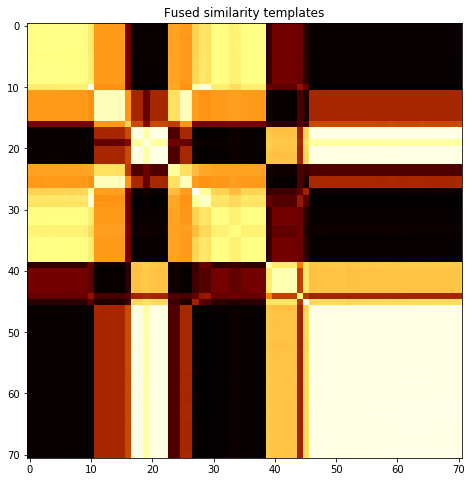

subject 36; gesture 1_0_1


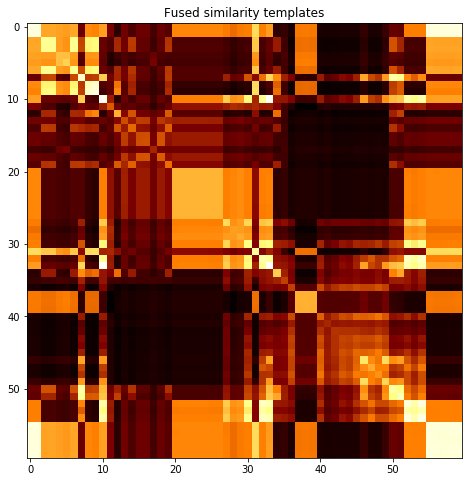

subject 36; gesture 3_1_1


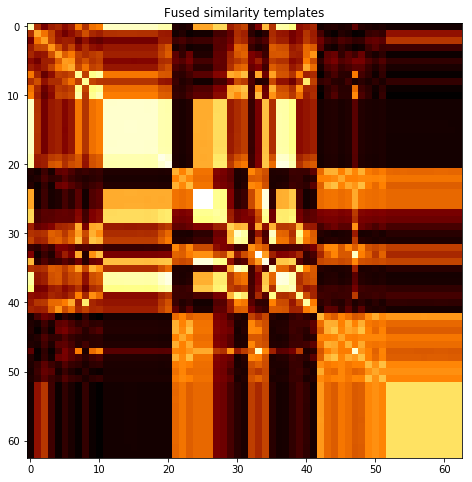

subject 36; gesture 1_0_2


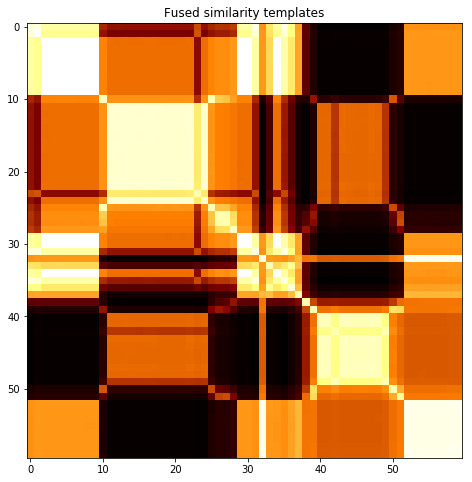

subject 36; gesture 4_0_2


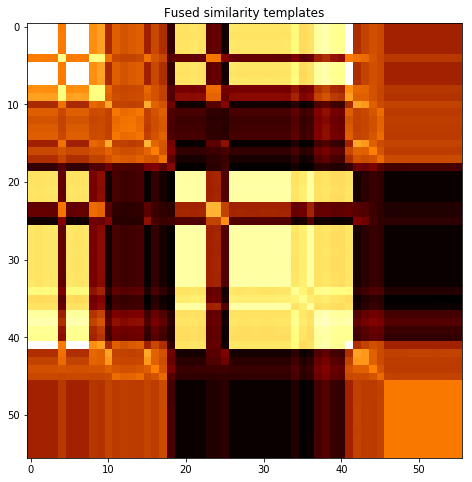

subject 24; gesture 3_0_1


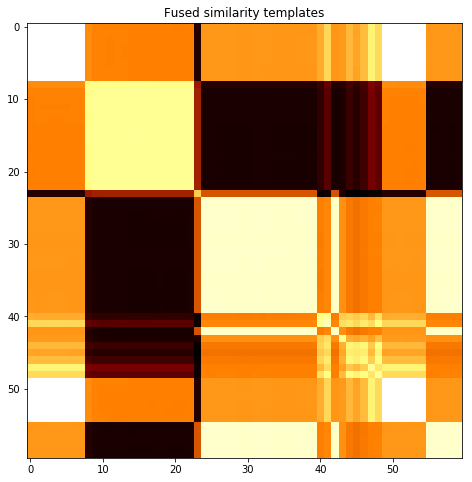

subject 24; gesture 4_1_1


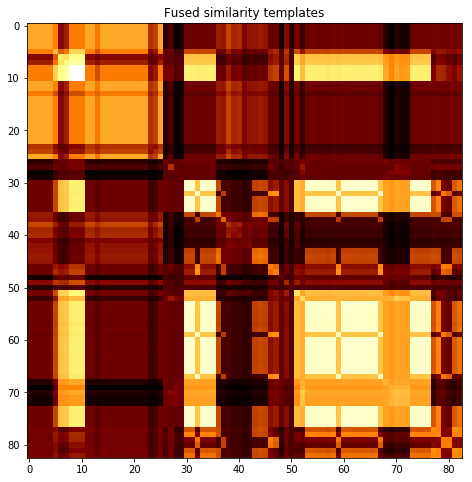

subject 24; gesture 2_0_1


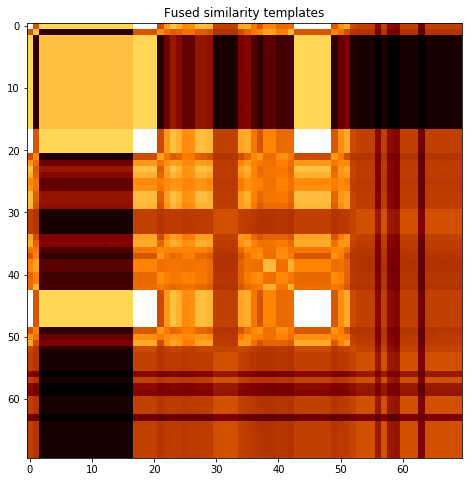

subject 24; gesture 4_1_2


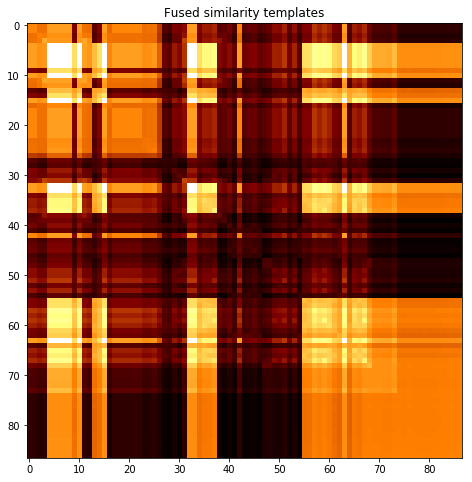

subject 24; gesture 2_0_2


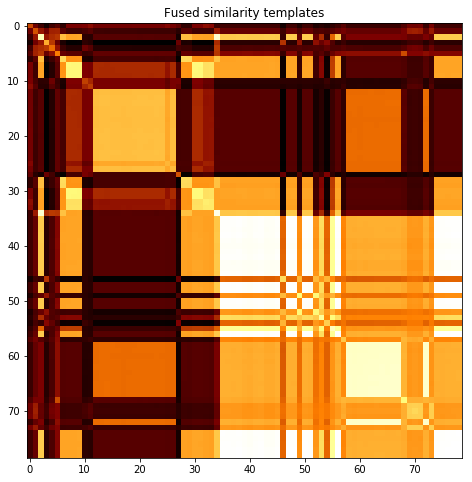

subject 24; gesture 1_1_2


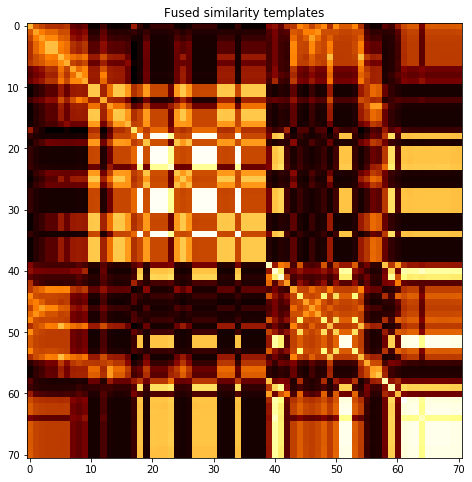

subject 24; gesture 2_1_2


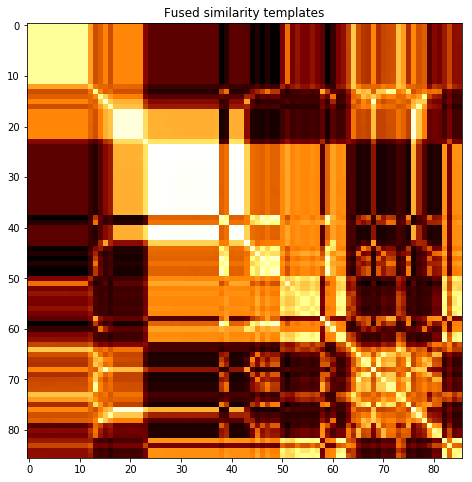

subject 24; gesture 4_0_1


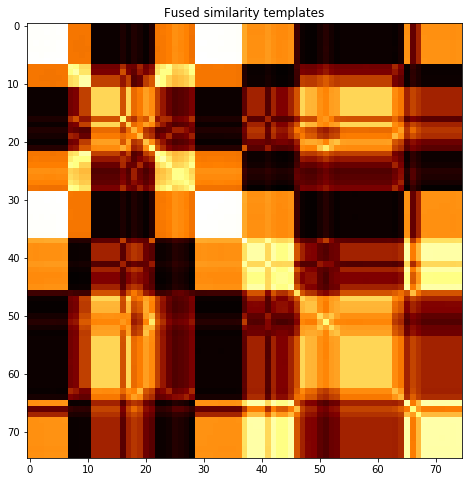

subject 24; gesture 3_0_2


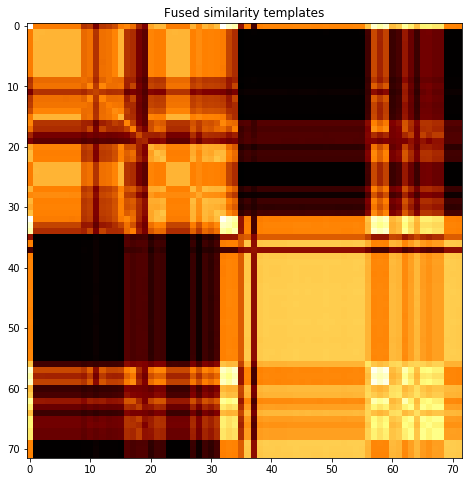

subject 24; gesture 1_1_1


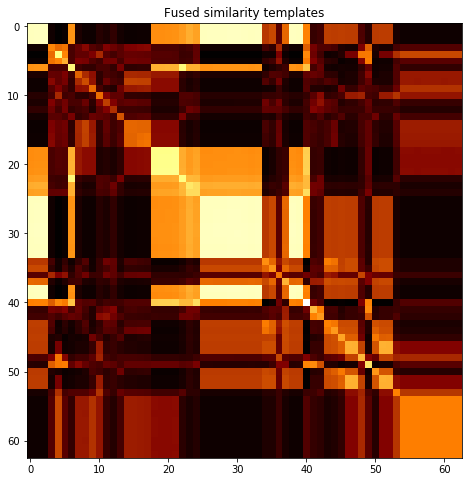

subject 24; gesture 3_1_2


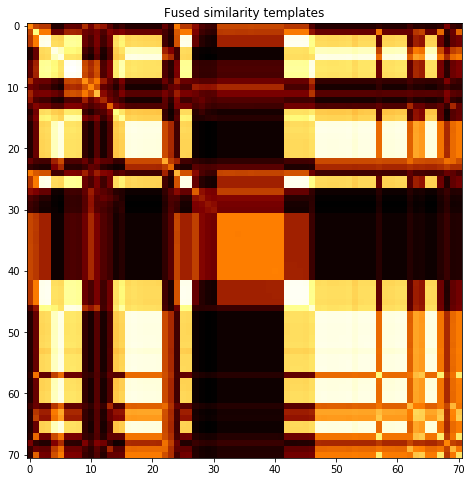

subject 24; gesture 2_1_1


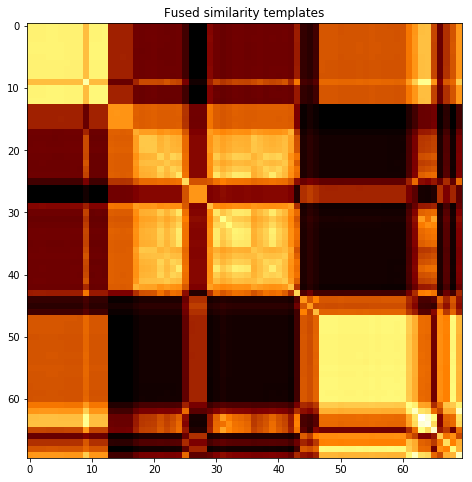

subject 24; gesture 1_0_1


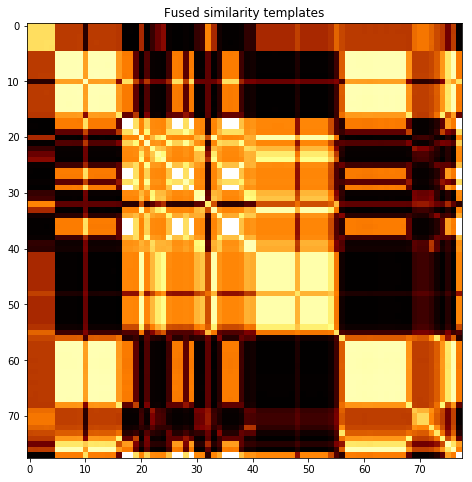

subject 24; gesture 3_1_1


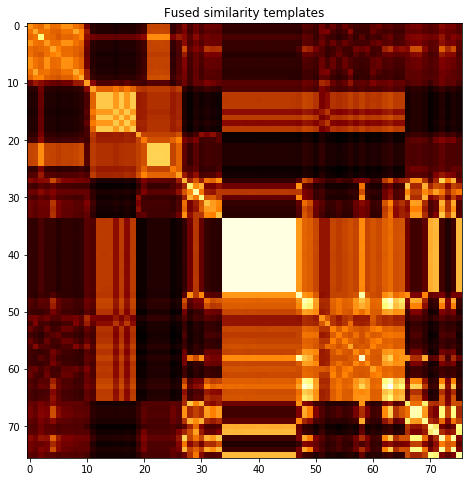

subject 24; gesture 1_0_2


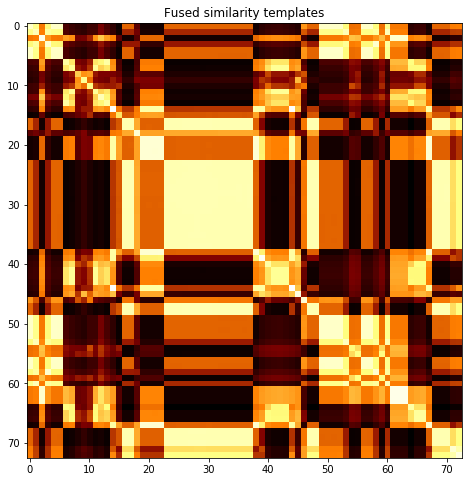

subject 24; gesture 4_0_2


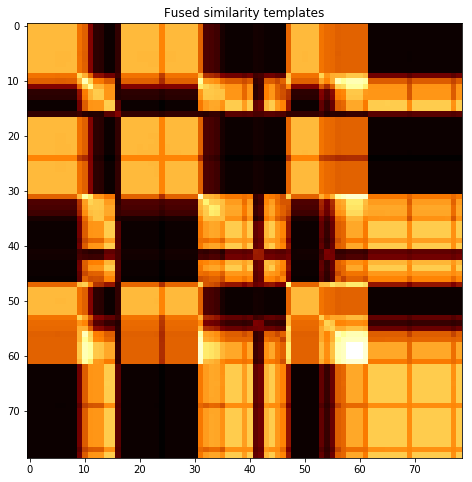

subject 33; gesture 3_0_1


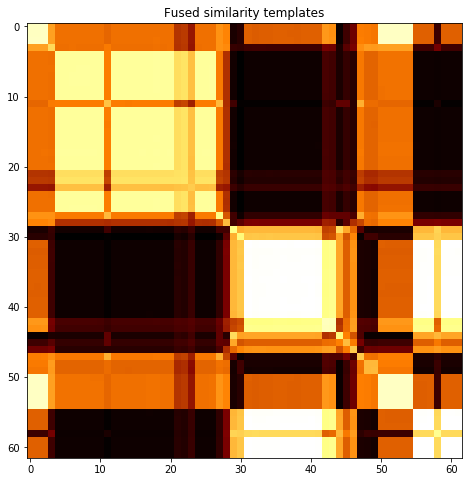

subject 33; gesture 4_1_1


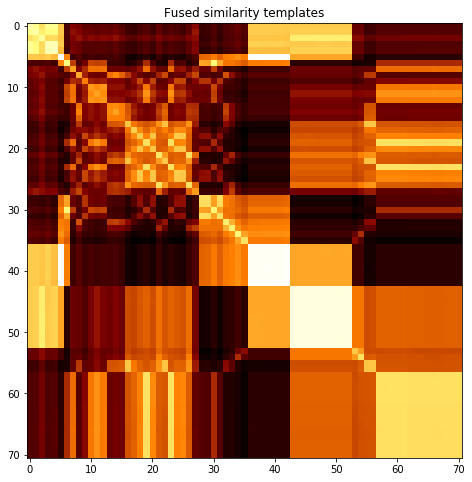

subject 33; gesture 2_0_1


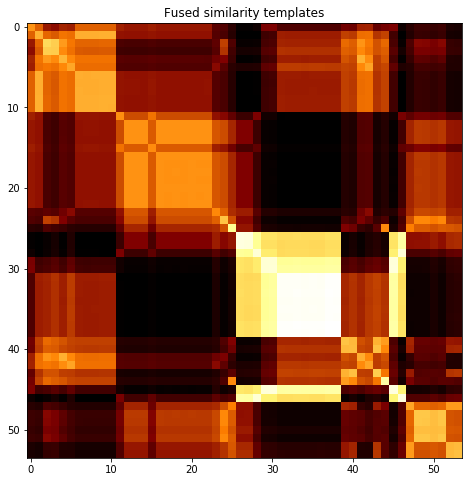

subject 33; gesture 4_1_2


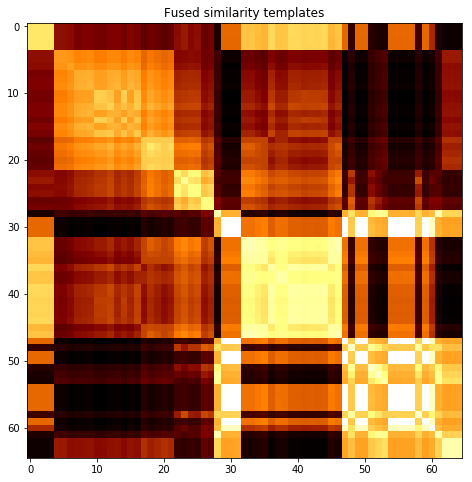

subject 33; gesture 2_0_2


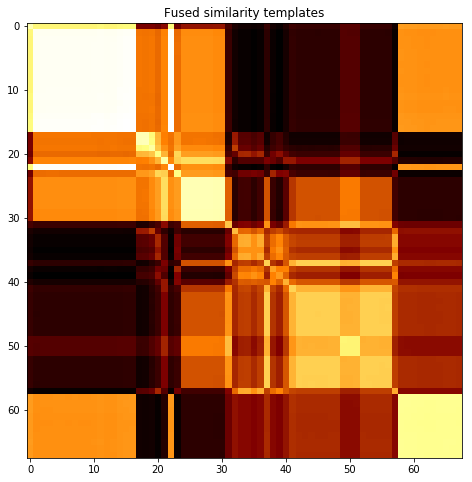

subject 33; gesture 1_1_2


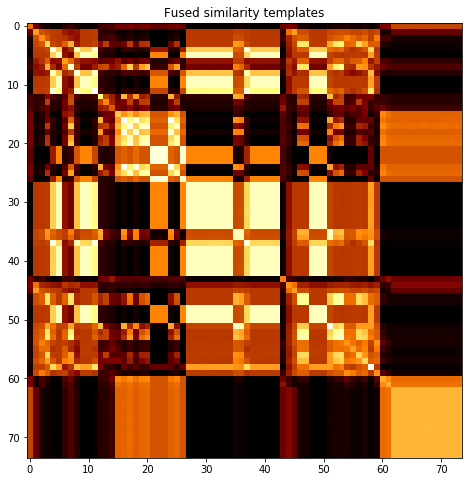

subject 33; gesture 2_1_2


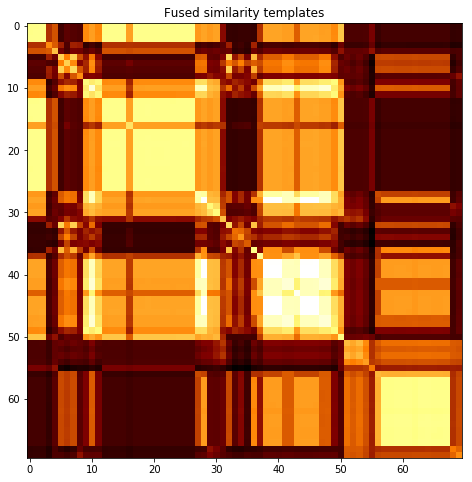

subject 33; gesture 4_0_1


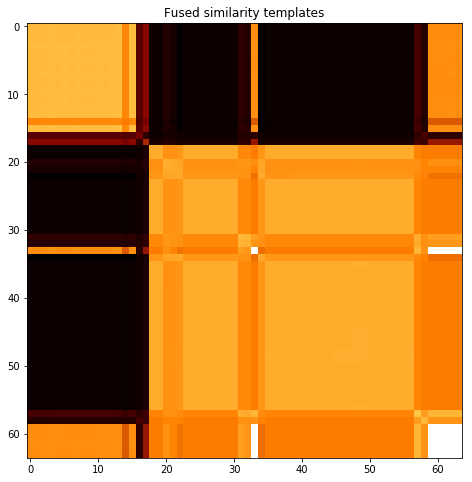

subject 33; gesture 3_0_2


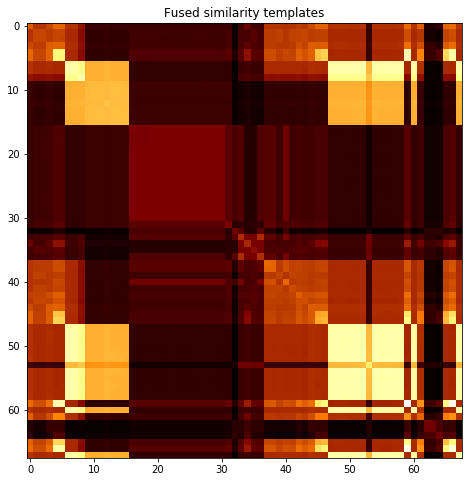

subject 33; gesture 1_1_1


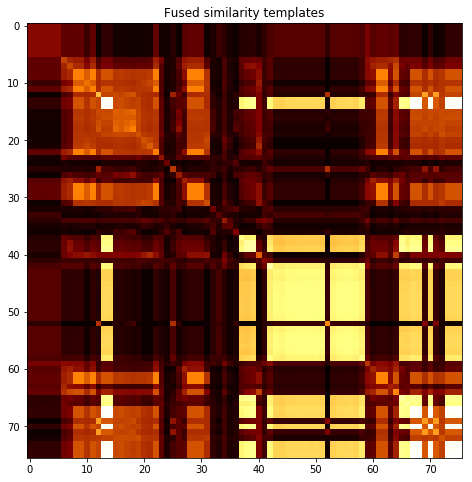

subject 33; gesture 3_1_2


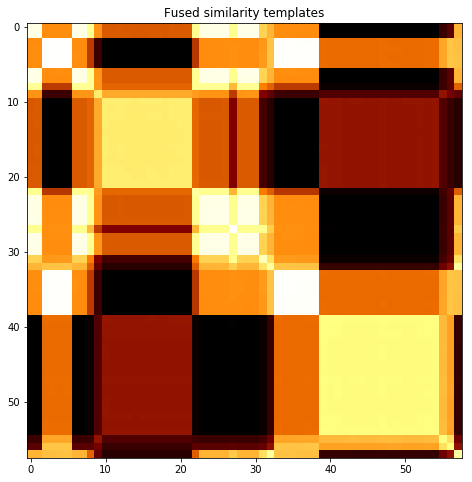

subject 33; gesture 2_1_1


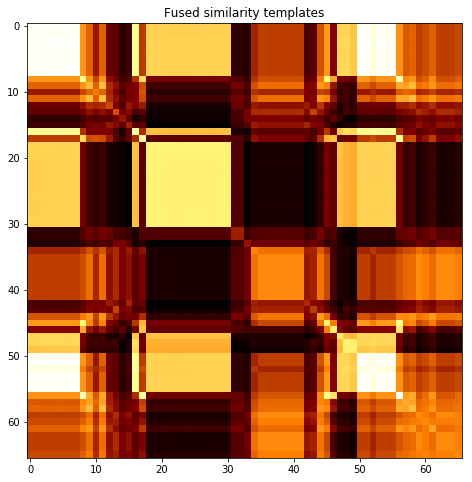

subject 33; gesture 1_0_1


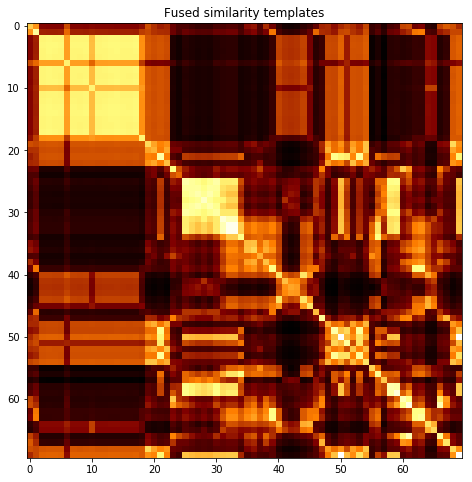

subject 33; gesture 3_1_1


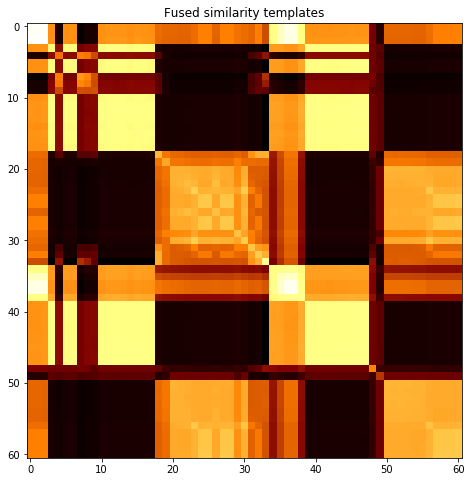

subject 33; gesture 1_0_2


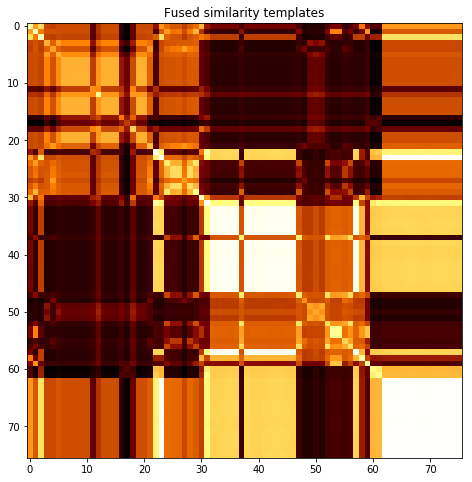

subject 33; gesture 4_0_2


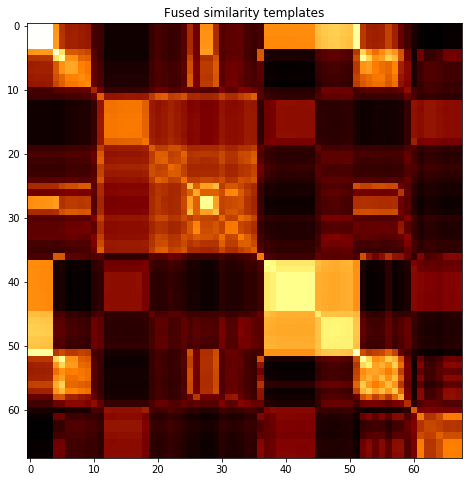

subject 11; gesture 3_0_1


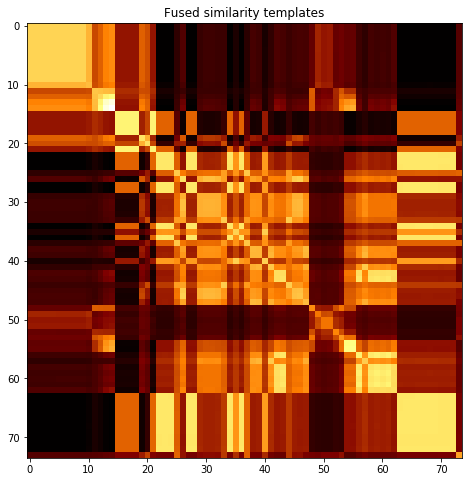

subject 11; gesture 4_1_1


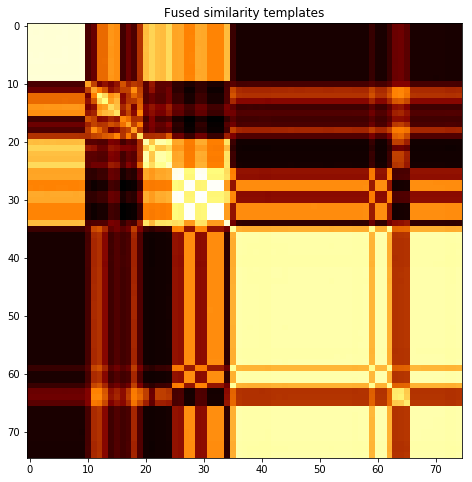

subject 11; gesture 2_0_1


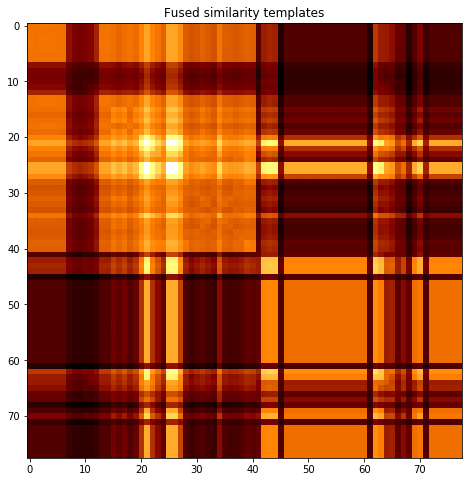

subject 11; gesture 4_1_2


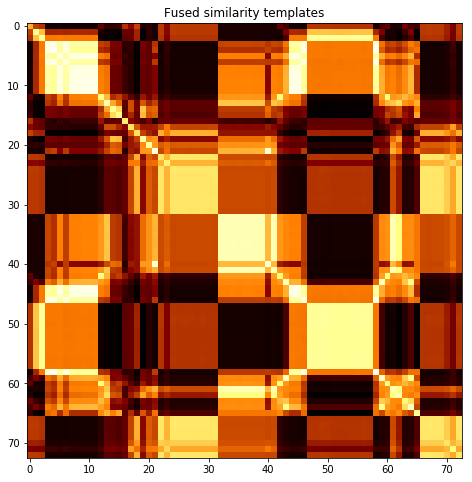

subject 11; gesture 2_0_2


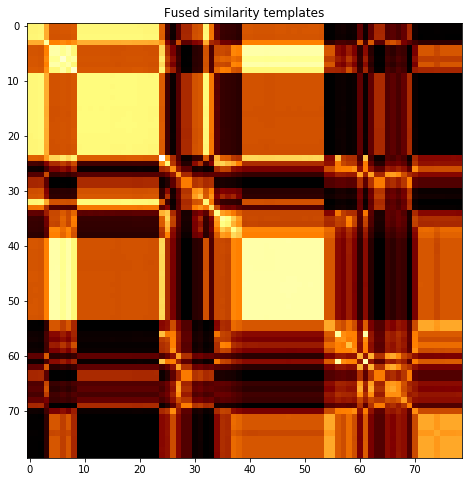

subject 11; gesture 1_1_2


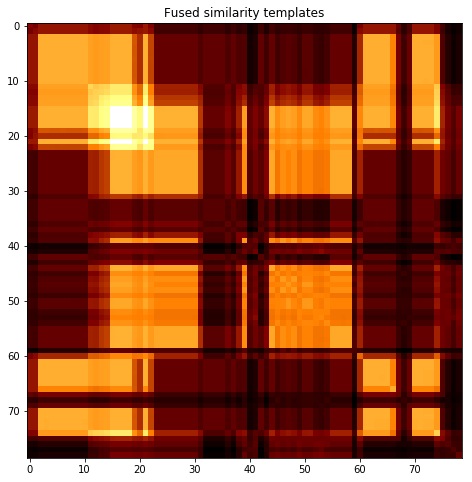

subject 11; gesture 2_1_2


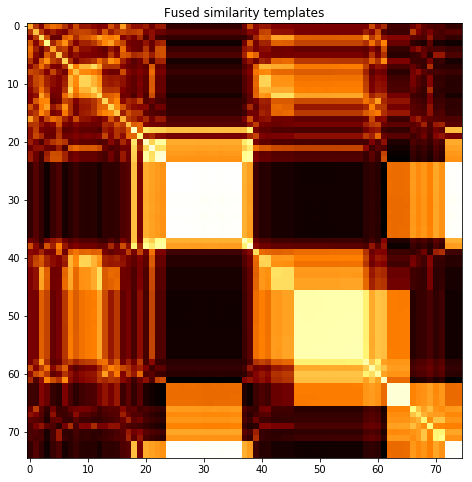

subject 11; gesture 4_0_1


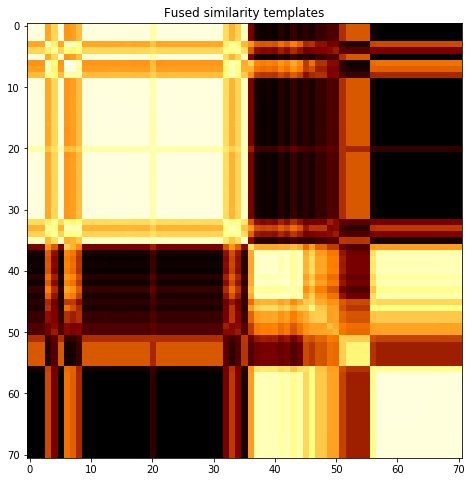

subject 11; gesture 3_0_2


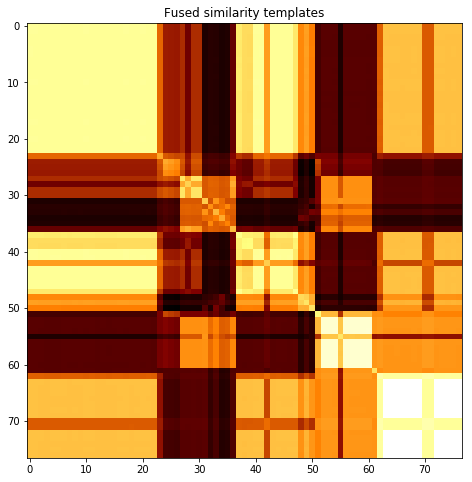

subject 11; gesture 1_1_1


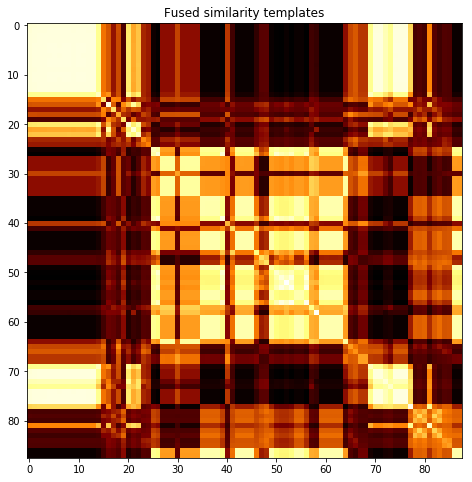

subject 11; gesture 3_1_2


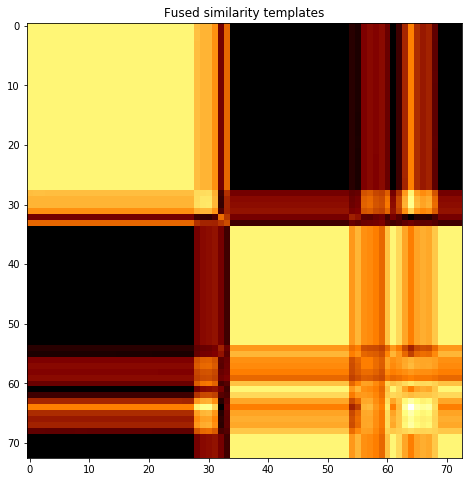

subject 11; gesture 2_1_1


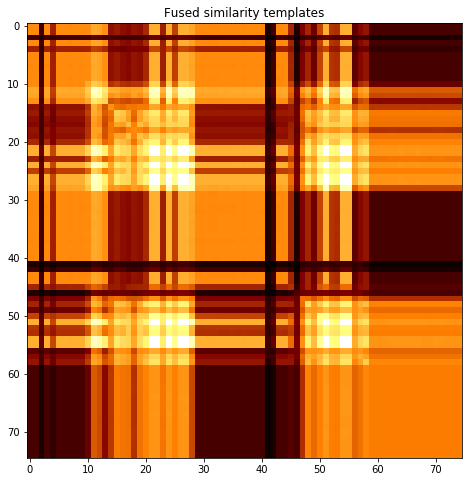

subject 11; gesture 1_0_1


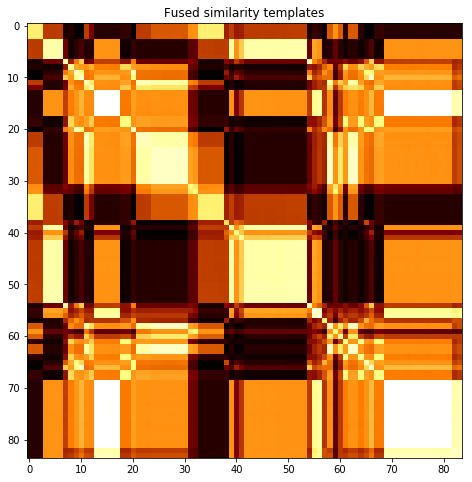

subject 11; gesture 3_1_1


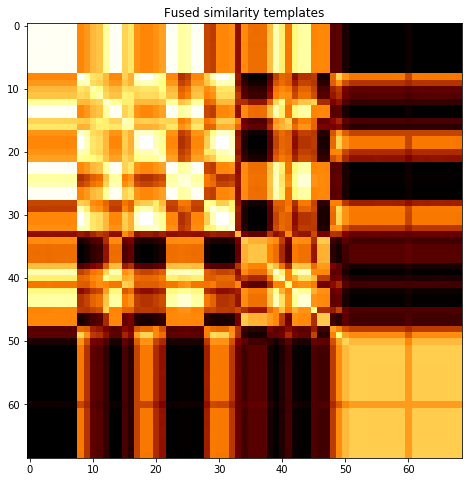

subject 11; gesture 1_0_2


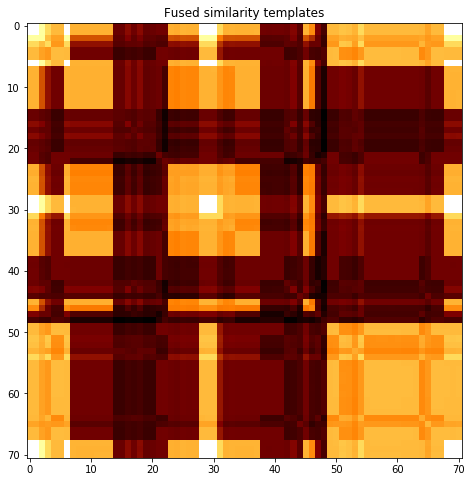

subject 11; gesture 4_0_2


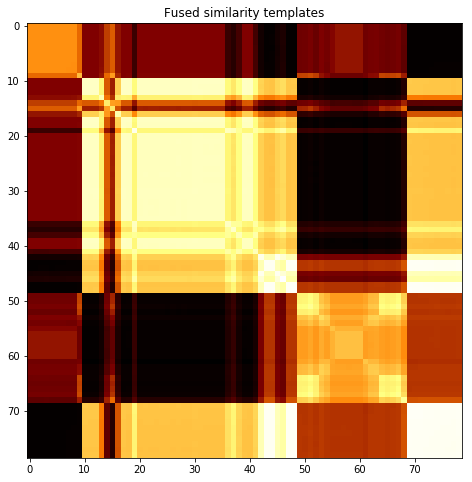

subject 35; gesture 3_0_1


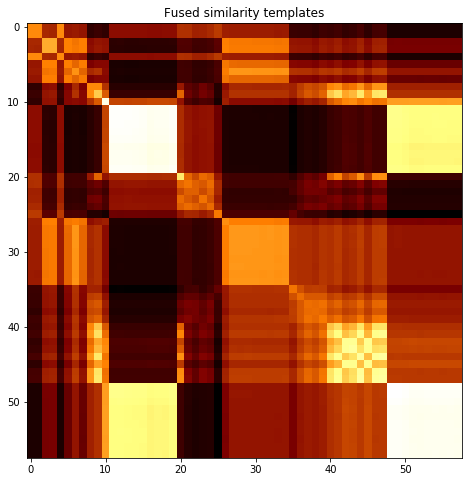

subject 35; gesture 4_1_1


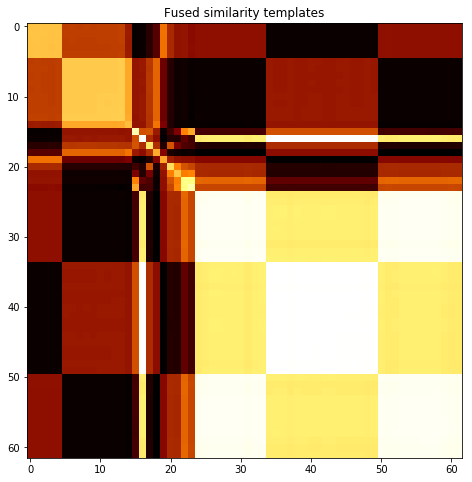

subject 35; gesture 2_0_1


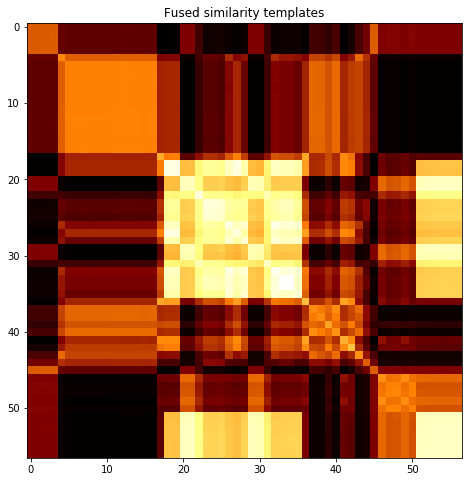

subject 35; gesture 4_1_2


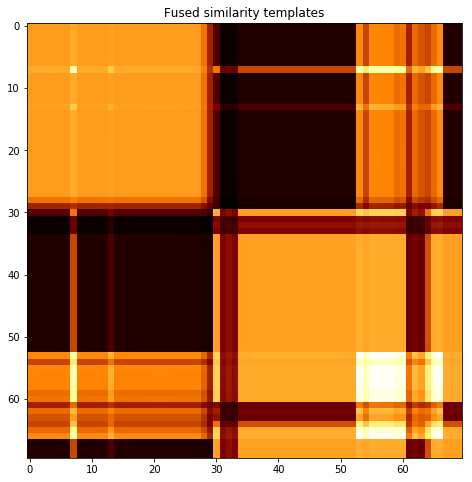

subject 35; gesture 2_0_2


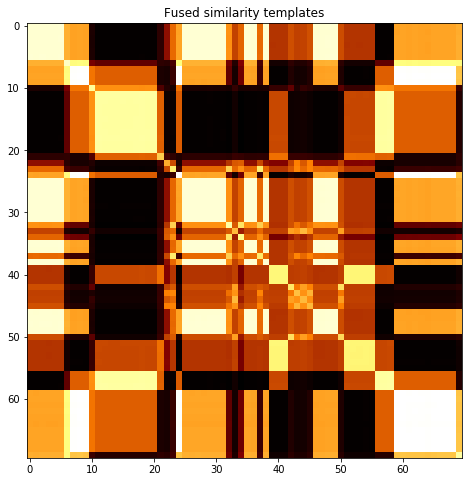

subject 35; gesture 1_1_2


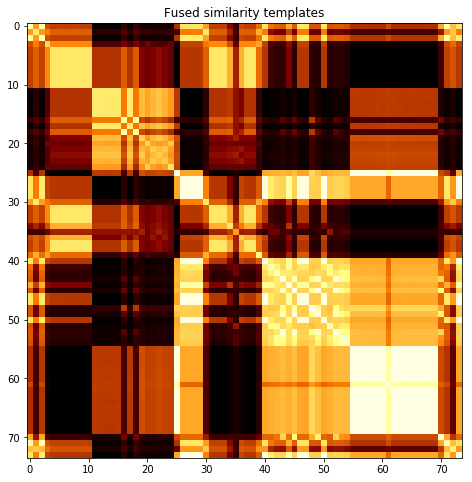

subject 35; gesture 2_1_2


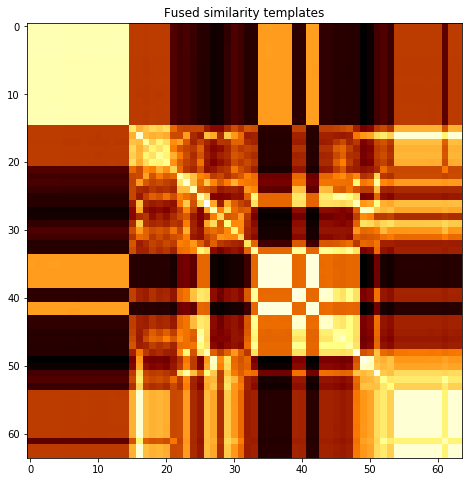

subject 35; gesture 4_0_1


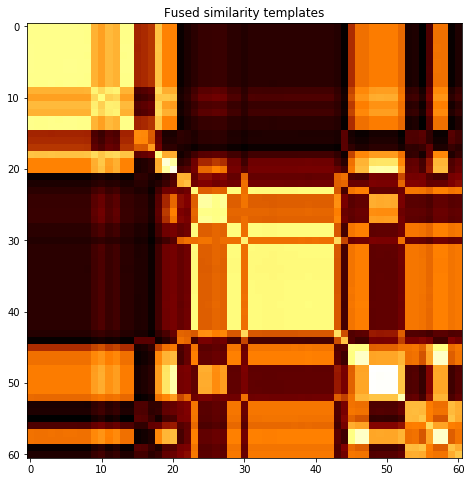

subject 35; gesture 3_0_2


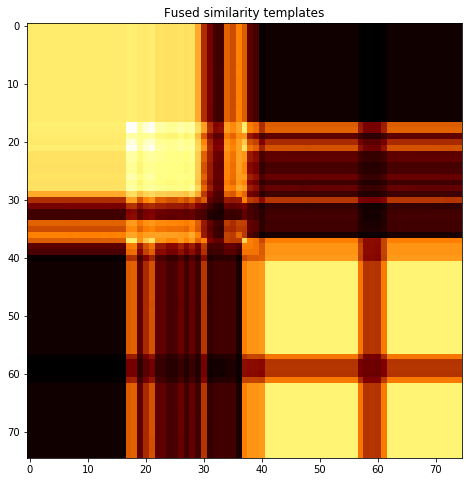

subject 35; gesture 1_1_1


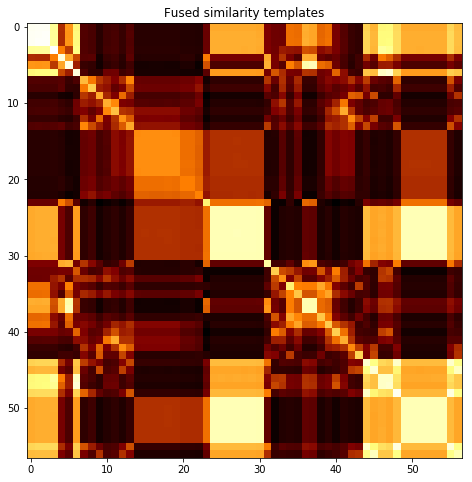

subject 35; gesture 3_1_2


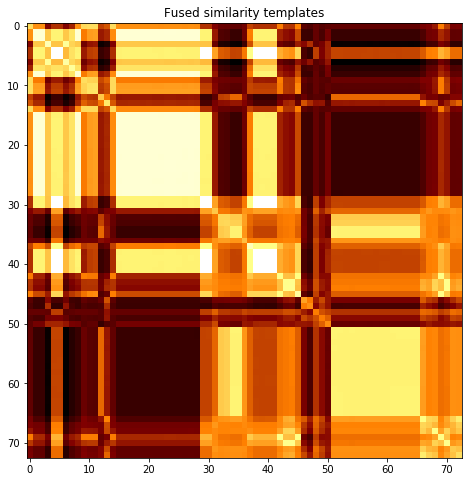

subject 35; gesture 2_1_1


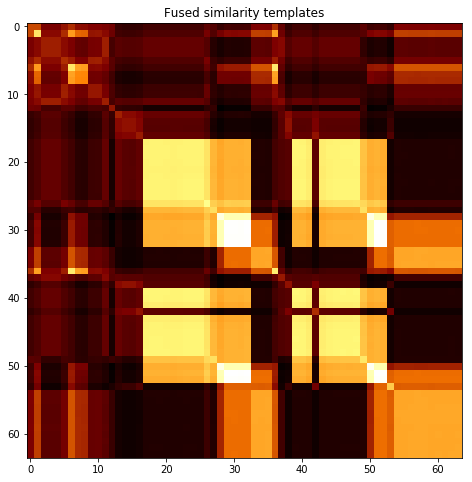

subject 35; gesture 1_0_1


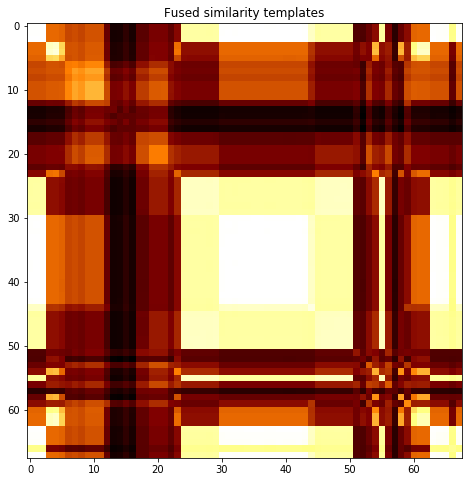

subject 35; gesture 3_1_1


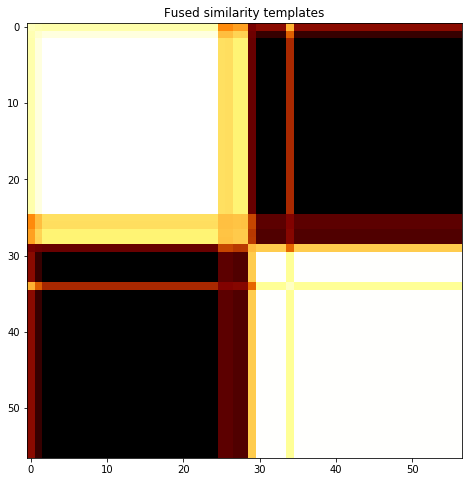

subject 35; gesture 1_0_2


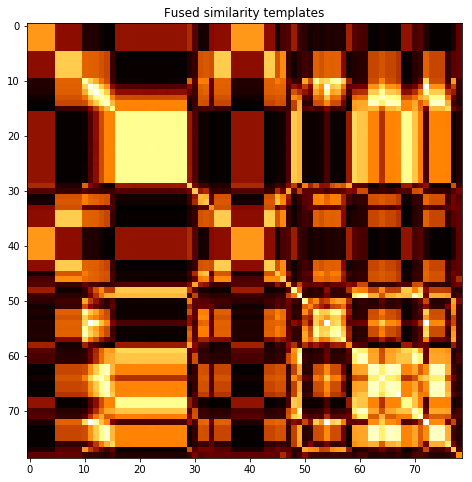

subject 35; gesture 4_0_2


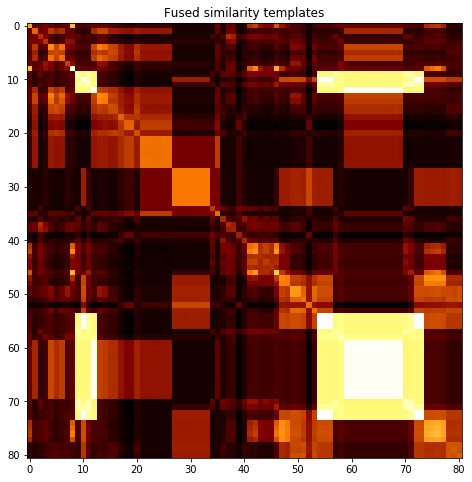

subject 22; gesture 3_0_1


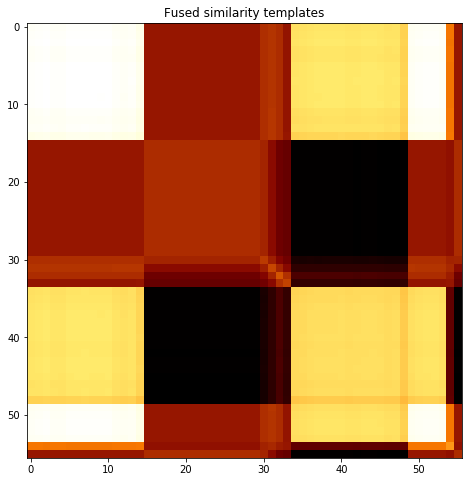

subject 22; gesture 4_1_1


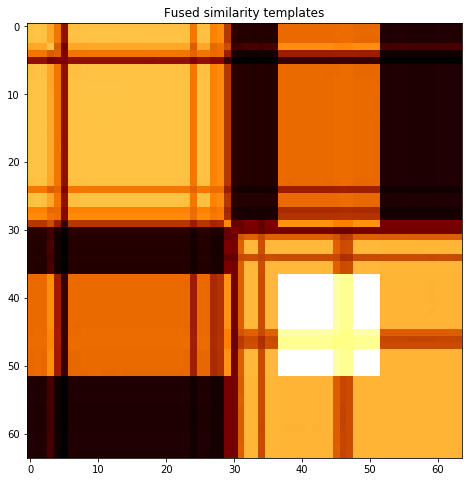

subject 22; gesture 2_0_1


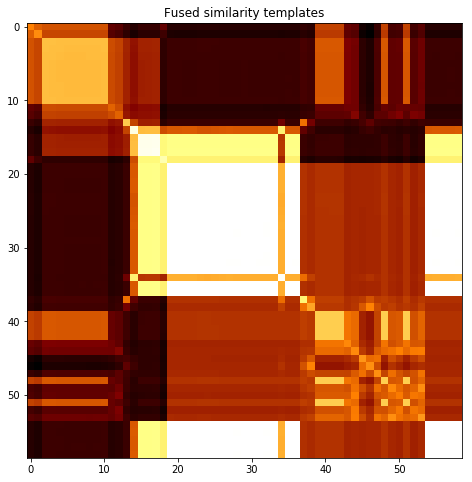

subject 22; gesture 4_1_2


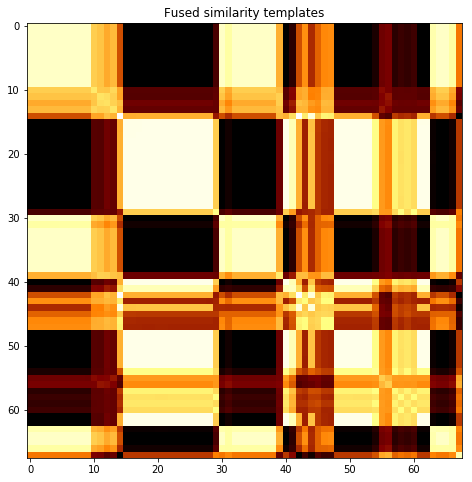

subject 22; gesture 2_0_2


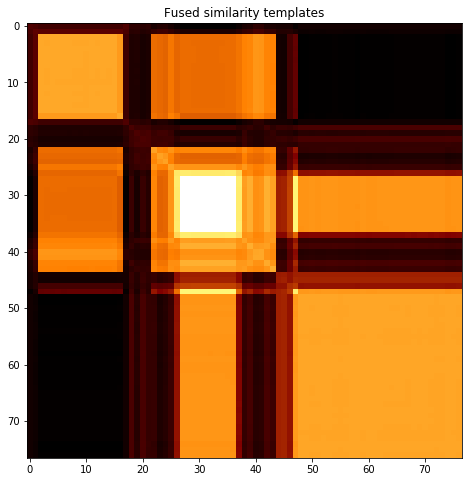

subject 22; gesture 1_1_2


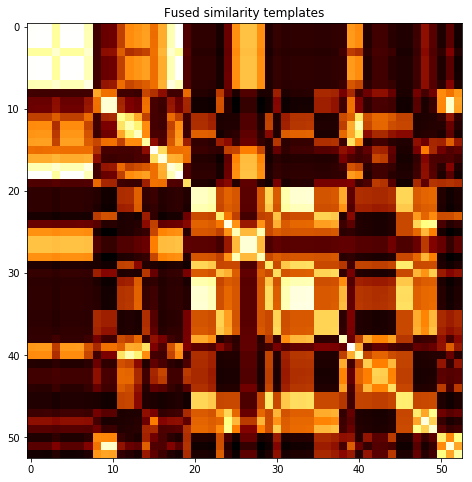

subject 22; gesture 2_1_2


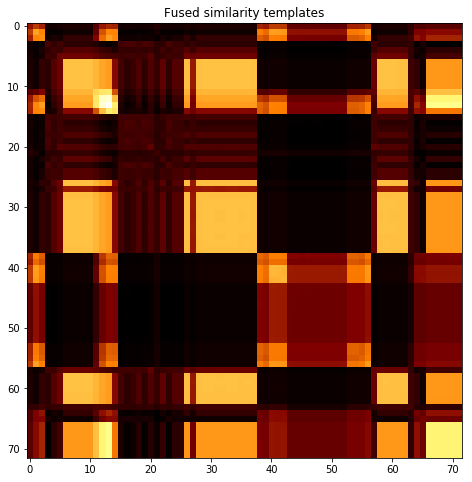

subject 22; gesture 4_0_1


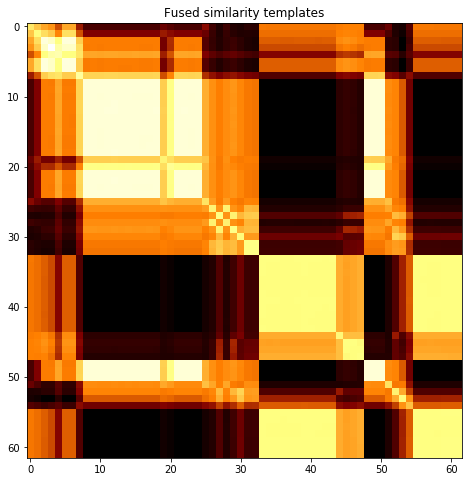

subject 22; gesture 3_0_2


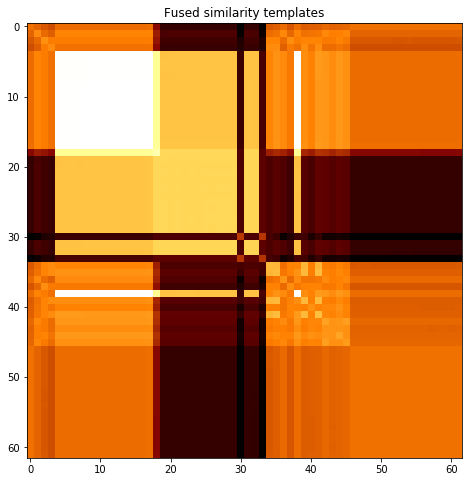

subject 22; gesture 1_1_1


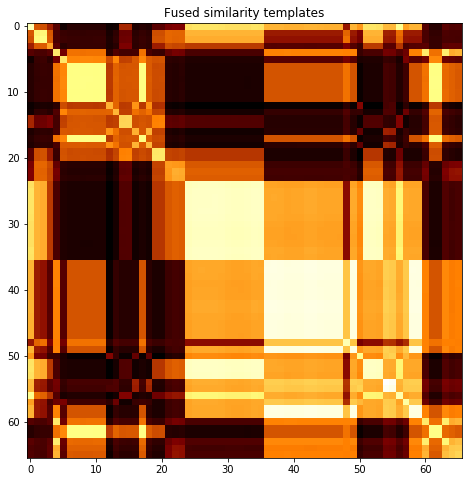

subject 22; gesture 3_1_2


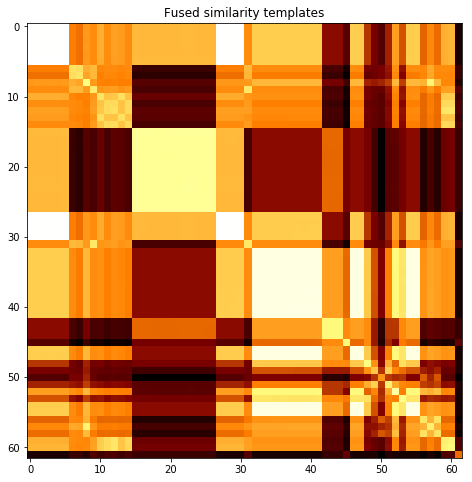

subject 22; gesture 2_1_1


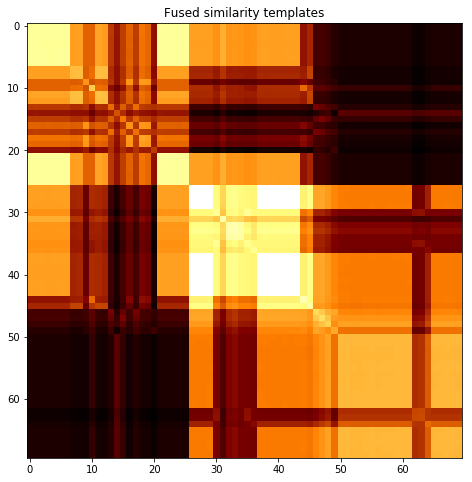

subject 22; gesture 1_0_1


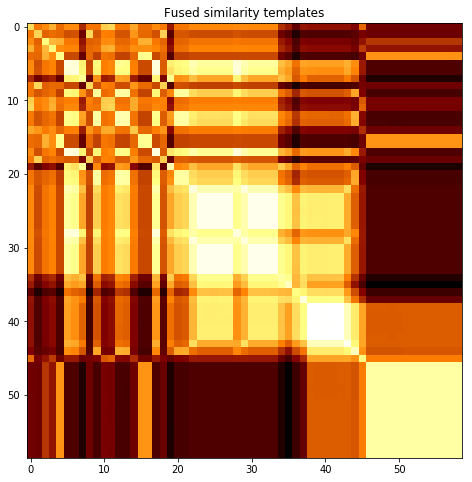

subject 22; gesture 3_1_1


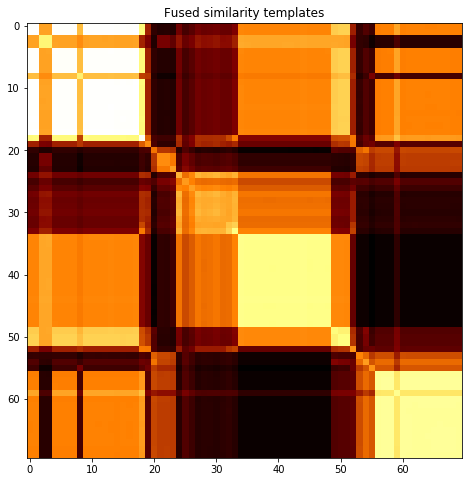

subject 22; gesture 1_0_2


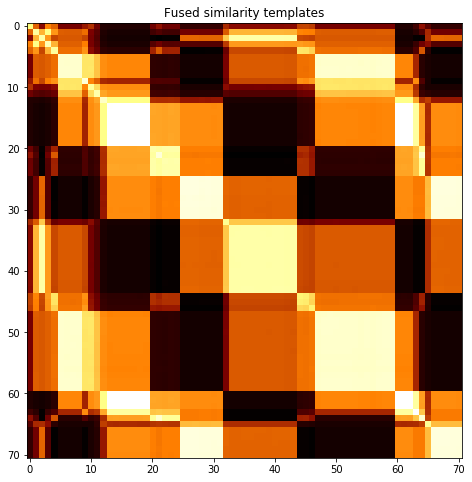

subject 22; gesture 4_0_2


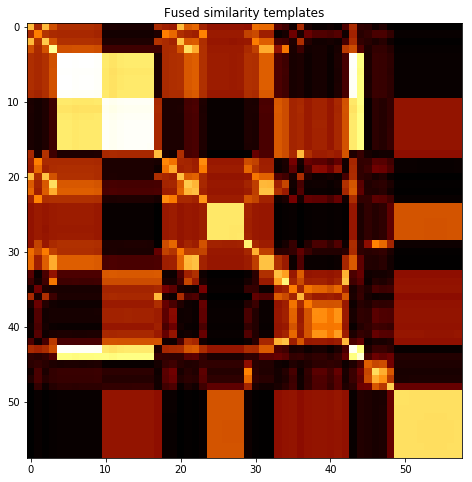

subject 34; gesture 3_0_1


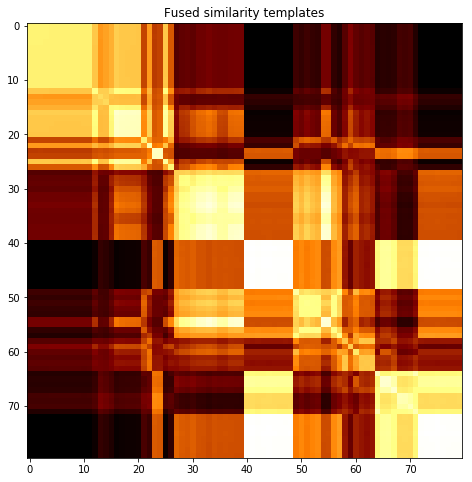

subject 34; gesture 4_1_1


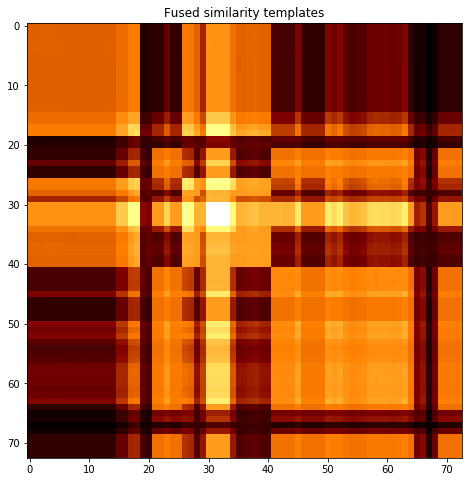

subject 34; gesture 2_0_1


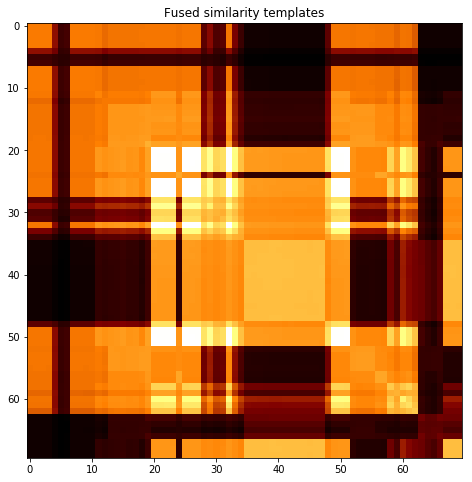

subject 34; gesture 4_1_2


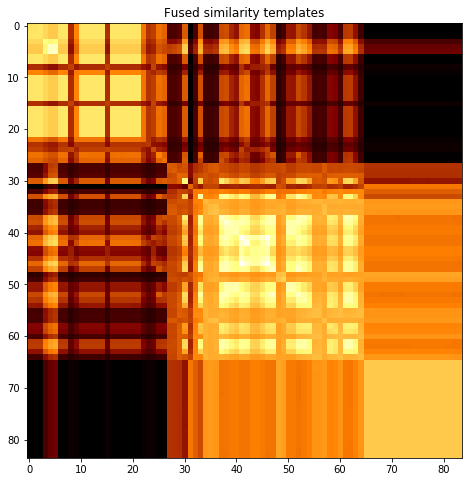

subject 34; gesture 2_0_2


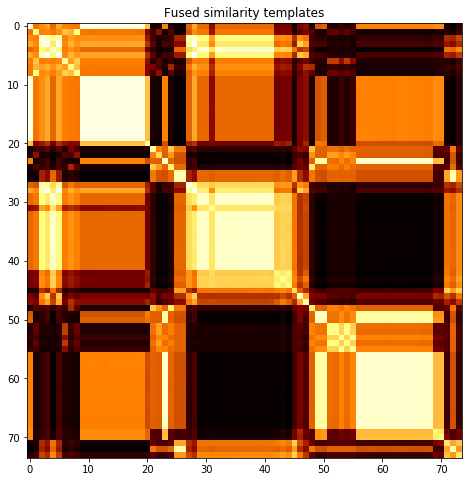

subject 34; gesture 1_1_2


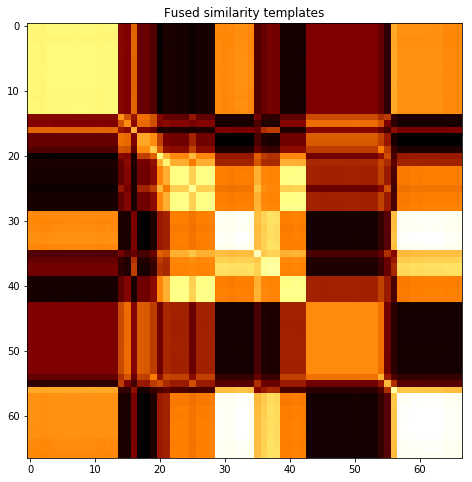

subject 34; gesture 2_1_2


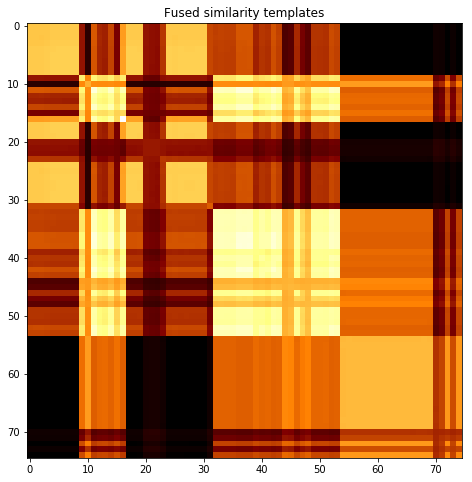

subject 34; gesture 4_0_1


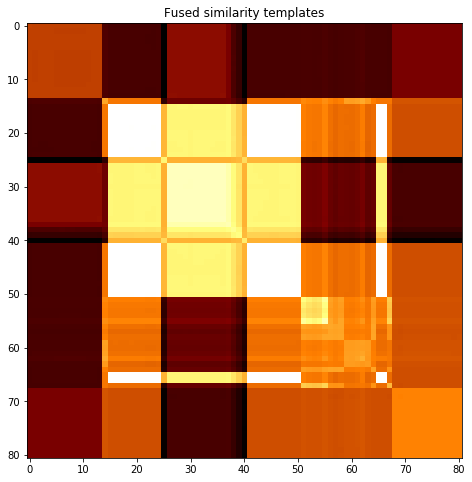

subject 34; gesture 3_0_2


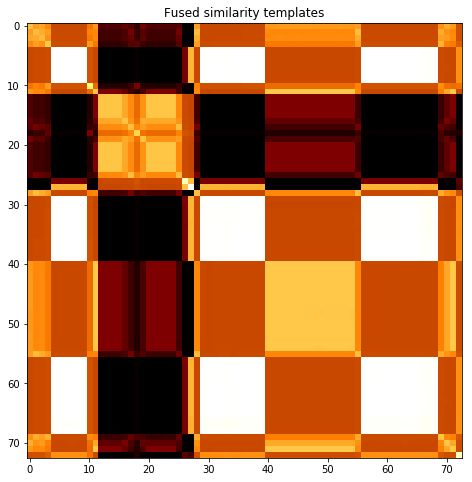

subject 34; gesture 1_1_1


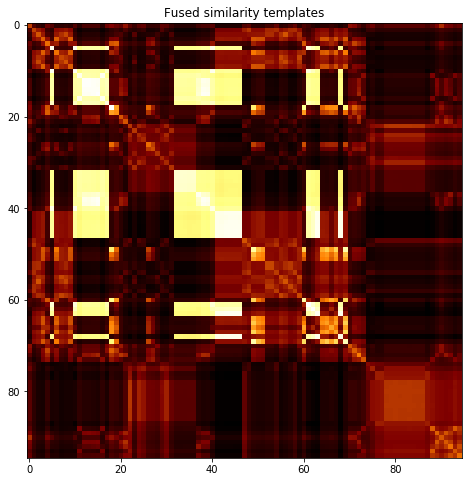

subject 34; gesture 3_1_2


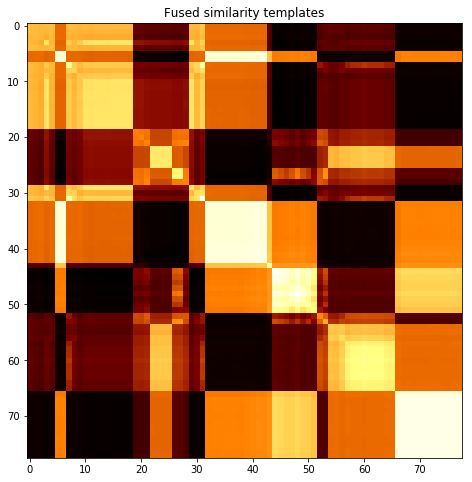

subject 34; gesture 2_1_1


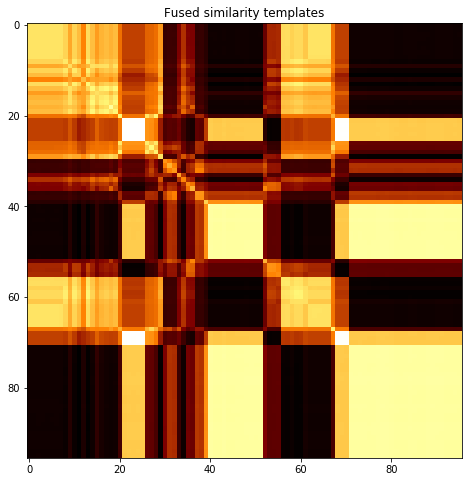

subject 34; gesture 1_0_1


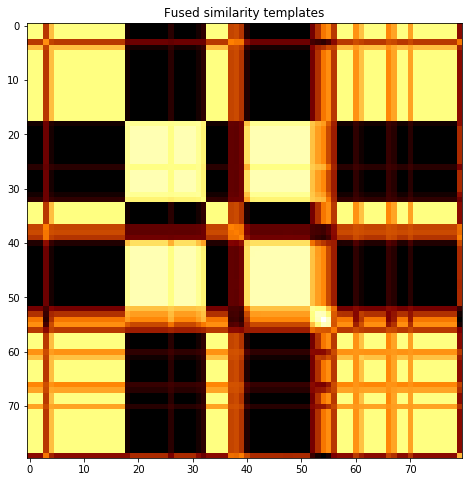

subject 34; gesture 3_1_1


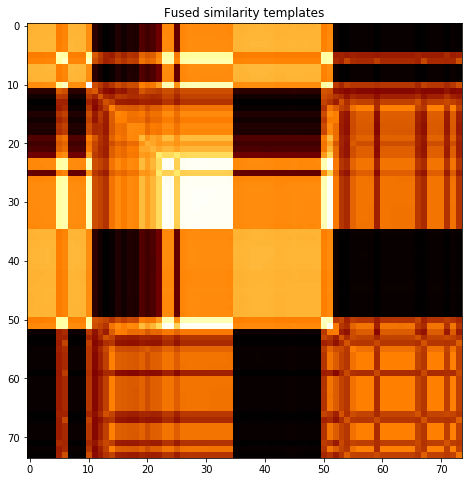

subject 34; gesture 1_0_2


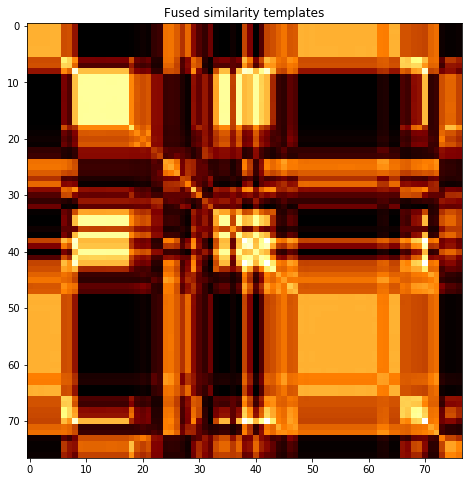

subject 34; gesture 4_0_2


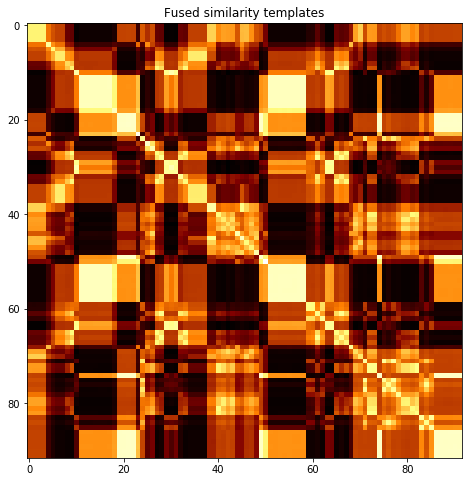

subject 10; gesture 3_0_1


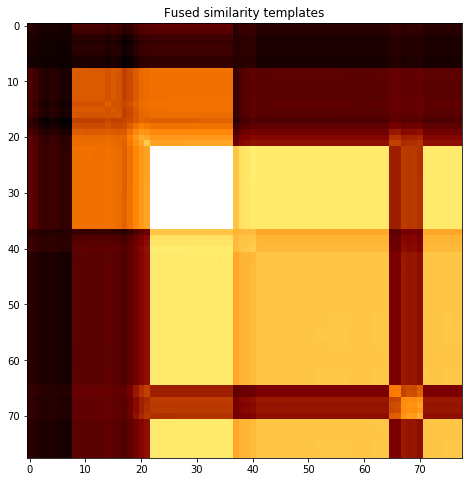

subject 10; gesture 4_1_1


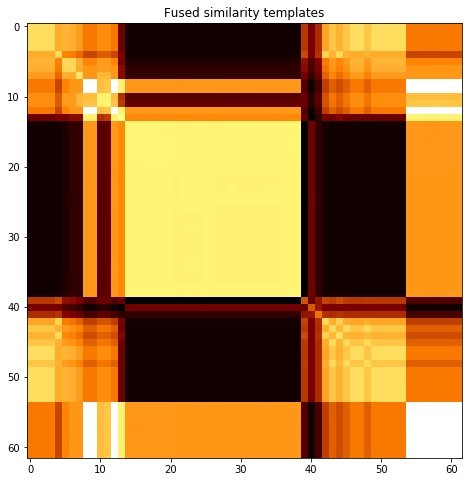

subject 10; gesture 2_0_1


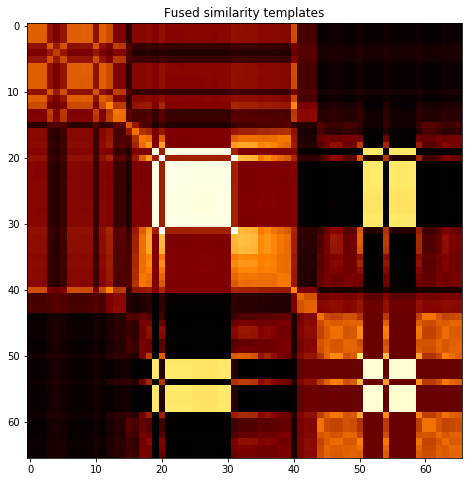

subject 10; gesture 4_1_2


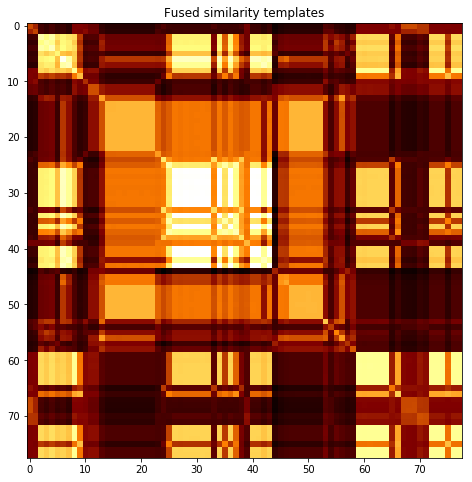

subject 10; gesture 2_0_2


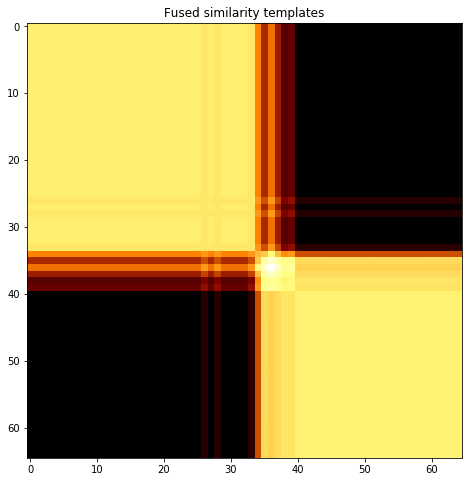

subject 10; gesture 1_1_2


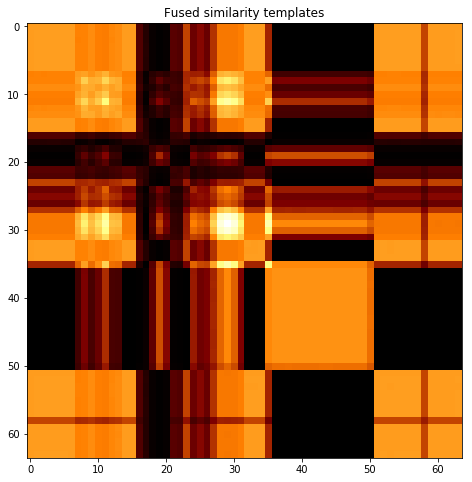

subject 10; gesture 2_1_2


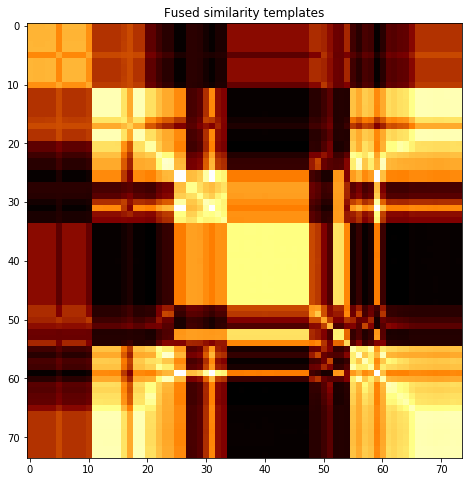

subject 10; gesture 4_0_1


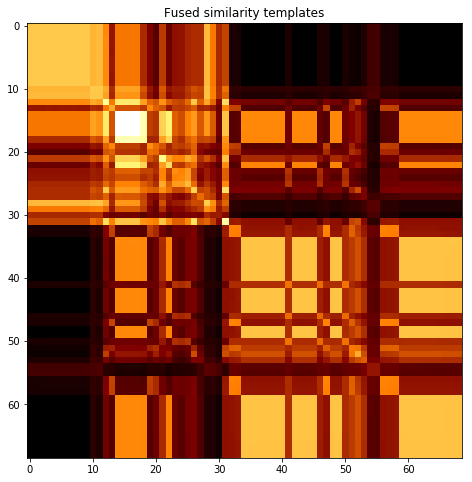

subject 10; gesture 3_0_2


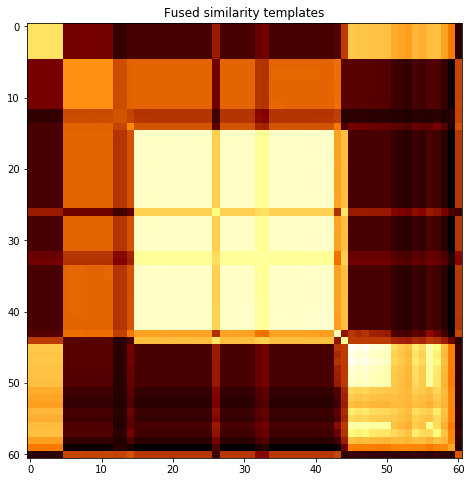

subject 10; gesture 1_1_1


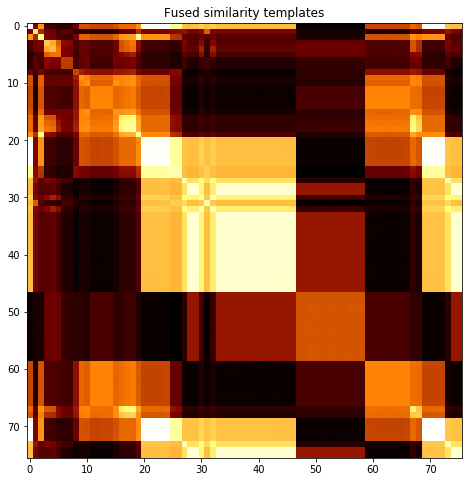

subject 10; gesture 3_1_2


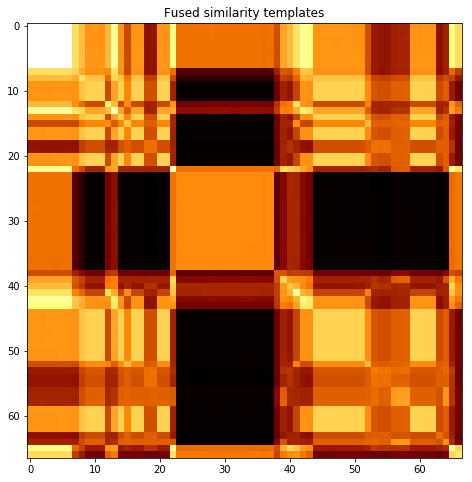

subject 10; gesture 2_1_1


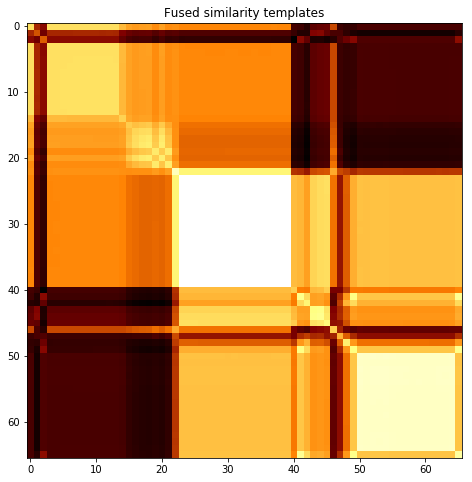

subject 10; gesture 1_0_1


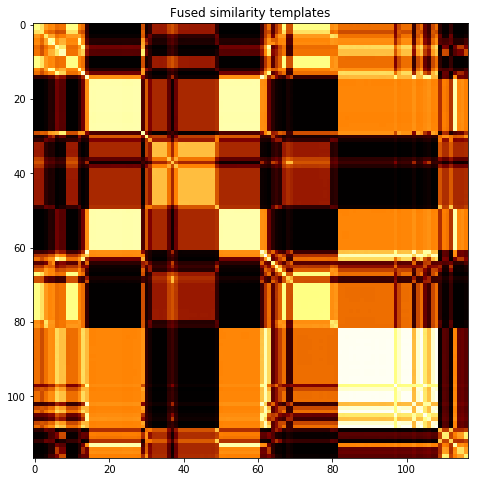

subject 10; gesture 3_1_1


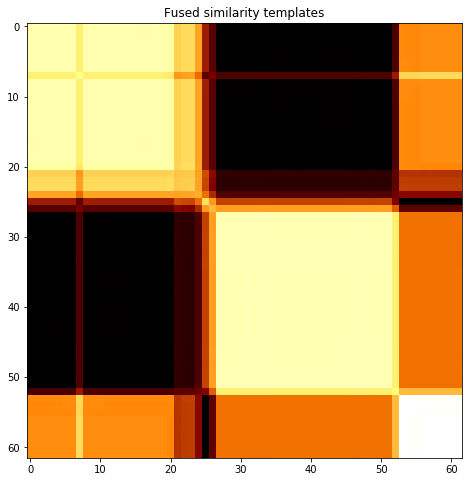

subject 10; gesture 1_0_2


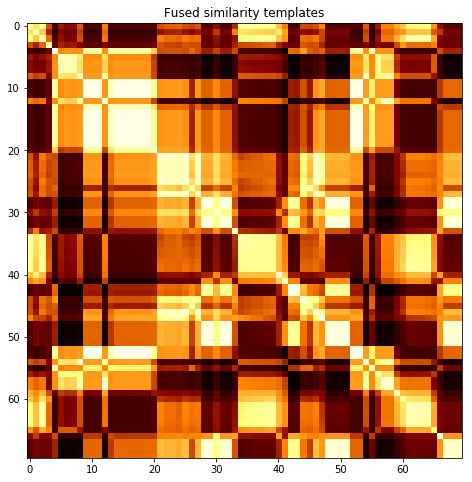

subject 10; gesture 4_0_2


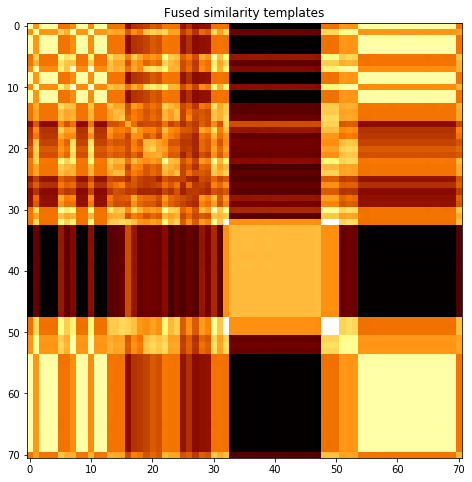

subject 02; gesture 3_0_1


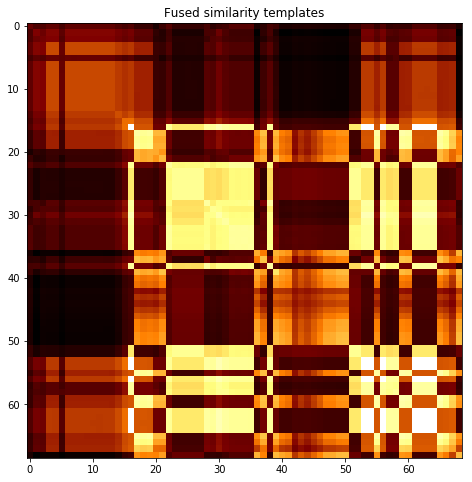

subject 02; gesture 4_1_1


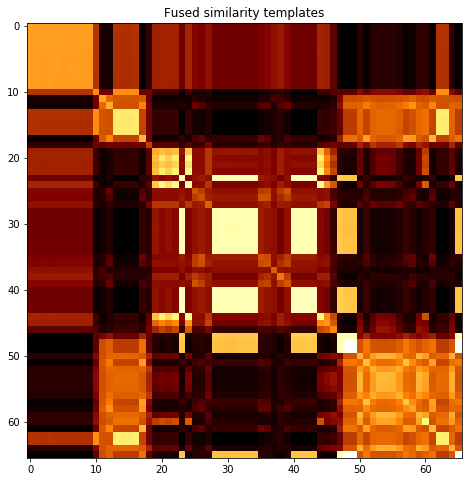

subject 02; gesture 2_0_1


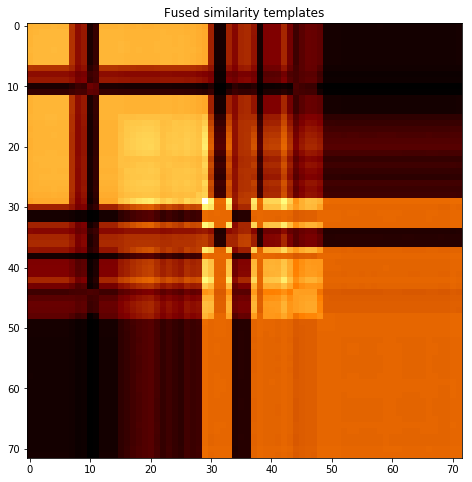

subject 02; gesture 4_1_2


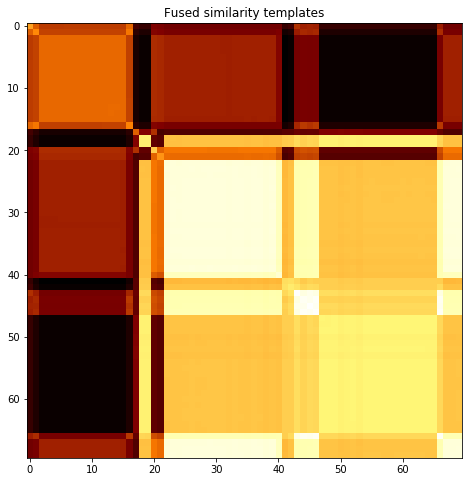

subject 02; gesture 2_0_2


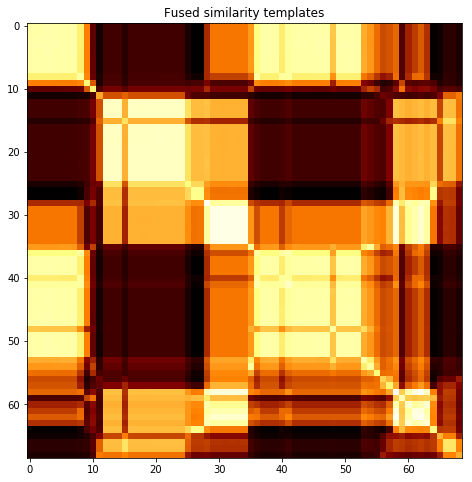

subject 02; gesture 1_1_2


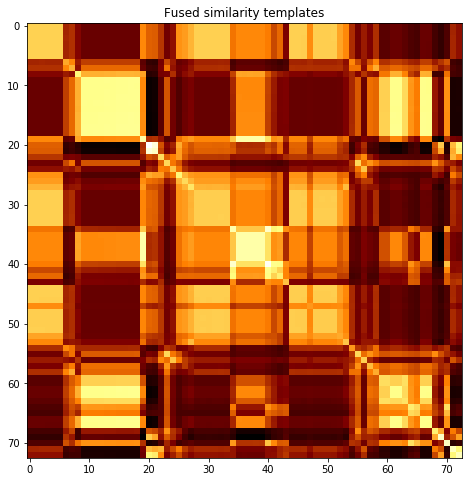

subject 02; gesture 2_1_2


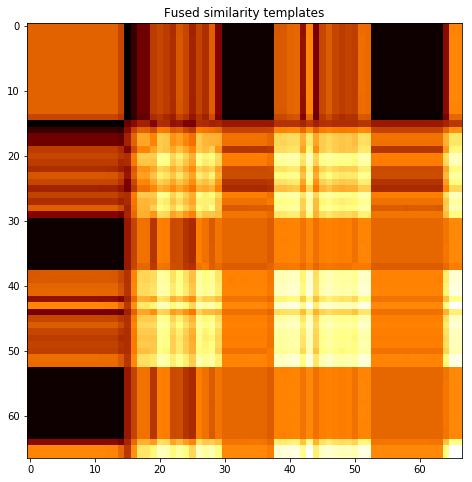

subject 02; gesture 4_0_1


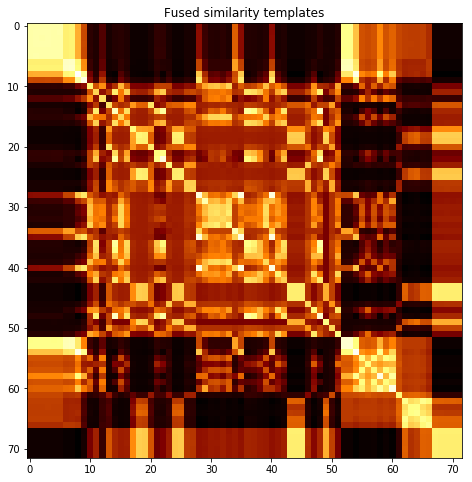

subject 02; gesture 3_0_2


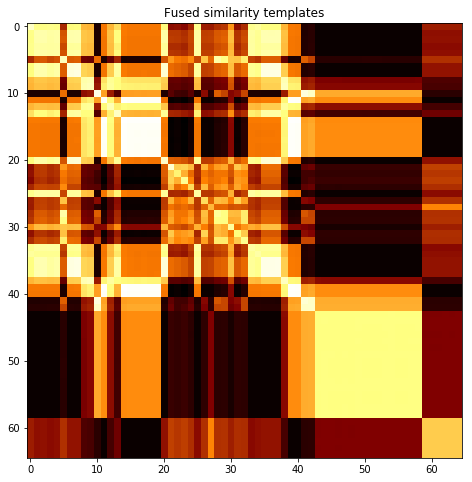

subject 02; gesture 1_1_1


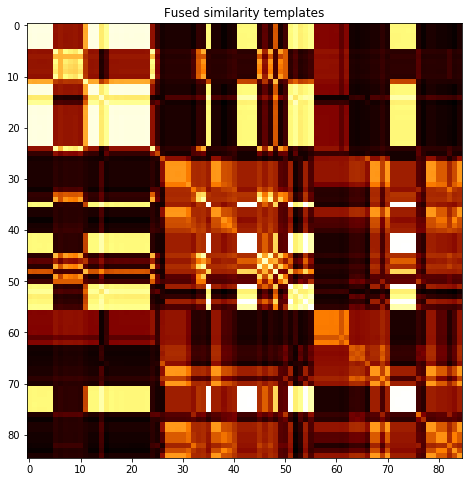

subject 02; gesture 3_1_2


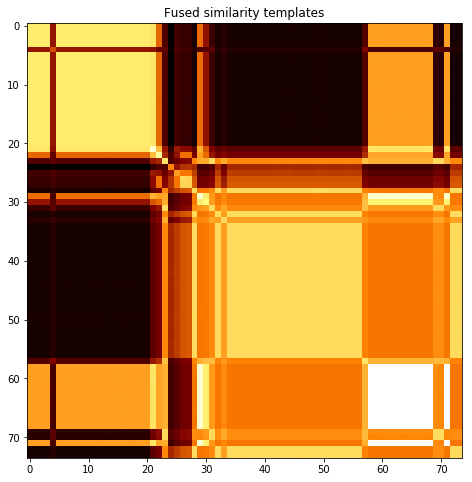

subject 02; gesture 2_1_1


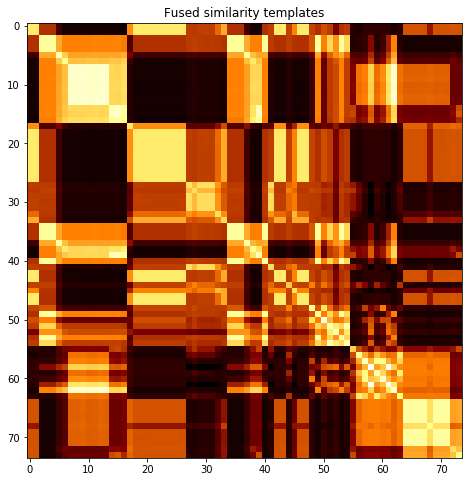

subject 02; gesture 1_0_1


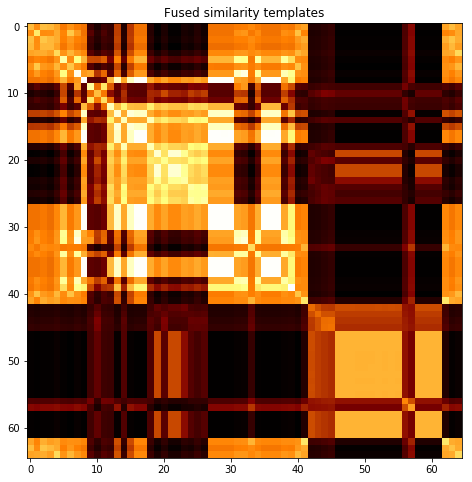

subject 02; gesture 3_1_1


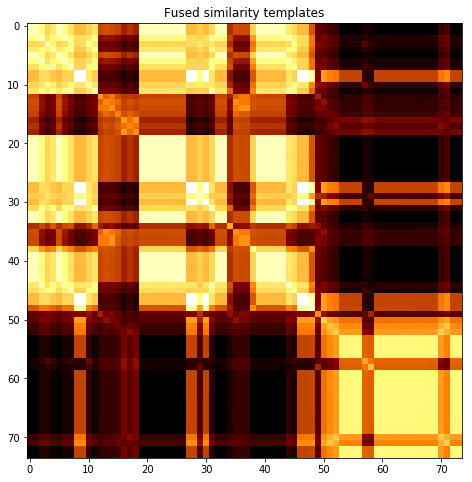

subject 02; gesture 1_0_2


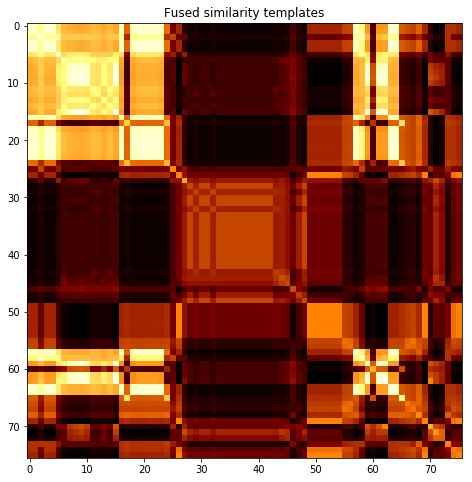

subject 02; gesture 4_0_2


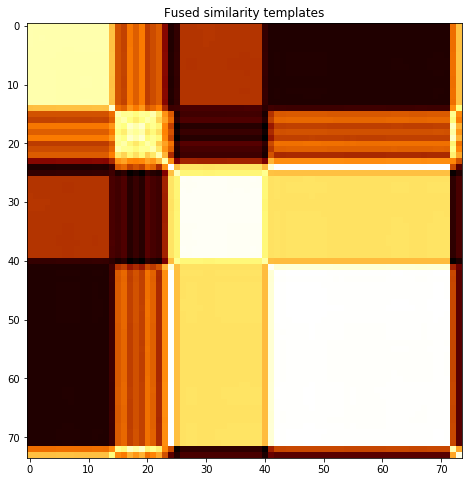

In [5]:
dict_synerg = {}
for s, gdict in dc.data_set_smooth.items():
    dict_synerg[s] = {}
    for g, a in gdict.items():
        snf = SNF(pass_synergist_channels(g[0], a), k=0.2)
        # calculate graph weights to find knn
        snf.calc_weights()
        snf.normalize_weights()
        # generate and normalize knn graphs
        snf.calc_knn_weights()
        snf.normalize_knn_weights()
        # fuse graphs
        snf.network_fusion(eta=0.2, iters=50)
        print(f"subject {s}; gesture {g}")
        snf.plot_template()
        # save template to dict
        dict_synerg[s][g] = snf.fused_similarity_template

---

subject 30; gesture 3_0_1; avg 0.9767384530206688; sd 0.008885241228213957
subject 30; gesture 3_0_1; PoV: 0.982840180214439


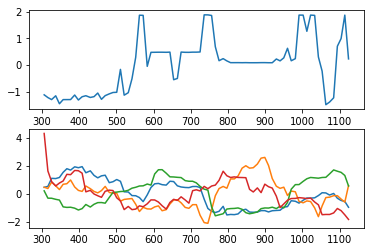

subject 30; gesture 4_1_1; avg 1.344079509165732; sd 0.012157781269667859
subject 30; gesture 4_1_1; PoV: 0.9879681951553816


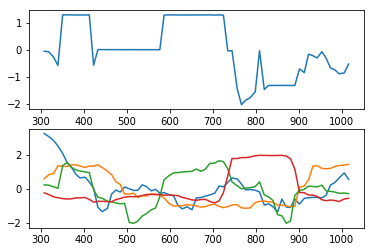

subject 30; gesture 2_0_1; avg 4.069002018187431; sd 0.04122555071906487
subject 30; gesture 2_0_1; PoV: 0.9920322894270451


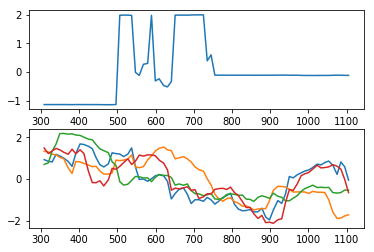

subject 30; gesture 4_1_2; avg 2.368534009835186; sd 0.034717830287538436
subject 30; gesture 4_1_2; PoV: 0.982421259532845


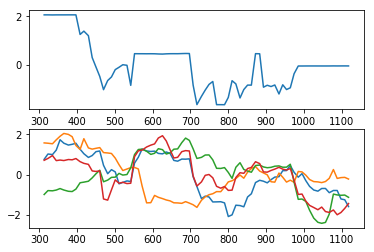

subject 30; gesture 2_0_2; avg 1.3636101188503817; sd 0.011397781354546119
subject 30; gesture 2_0_2; PoV: 0.9858415427247617


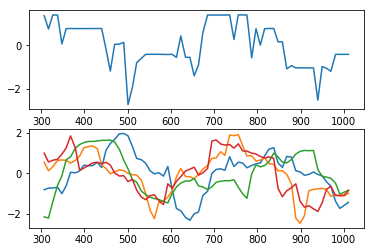

subject 30; gesture 1_1_2; avg 1.7617567196761668; sd 0.016856627447998134
subject 30; gesture 1_1_2; PoV: 0.9828242702817631


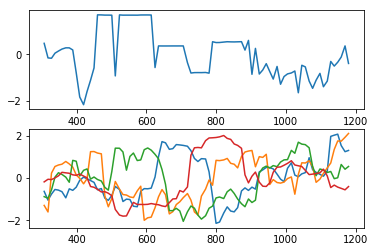

subject 30; gesture 2_1_2; avg 1.6833170775917061; sd 0.019131658421209955
subject 30; gesture 2_1_2; PoV: 0.9885490427048987


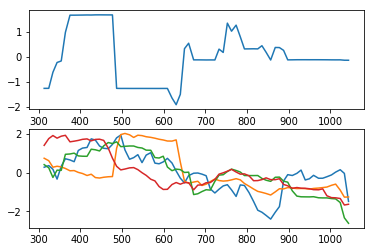

subject 30; gesture 4_0_1; avg 1.371803043772622; sd 0.011834718772620326
subject 30; gesture 4_0_1; PoV: 0.989043054006556


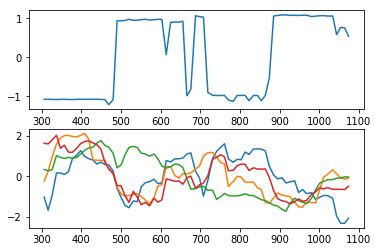

subject 30; gesture 3_0_2; avg 1.1884814391485063; sd 0.011195670522179854
subject 30; gesture 3_0_2; PoV: 0.9864119509373049


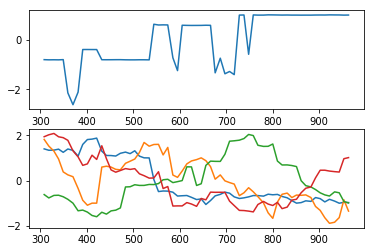

subject 30; gesture 1_1_1; avg 1.4344771193625634; sd 0.018541087077865344
subject 30; gesture 1_1_1; PoV: 0.9805196979641171


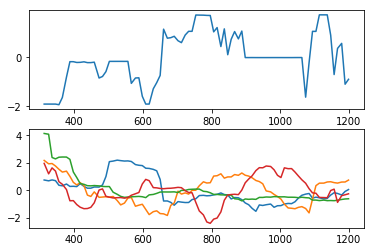

subject 30; gesture 3_1_2; avg 1.1679029263423706; sd 0.024026288559575257
subject 30; gesture 3_1_2; PoV: 0.9664939175966488


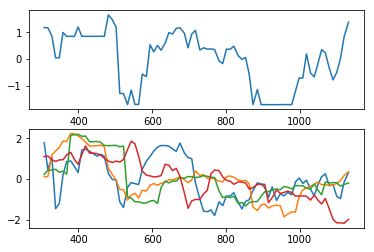

subject 30; gesture 2_1_1; avg 1.1002329161386604; sd 0.008300963317786826
subject 30; gesture 2_1_1; PoV: 0.9884527214238437


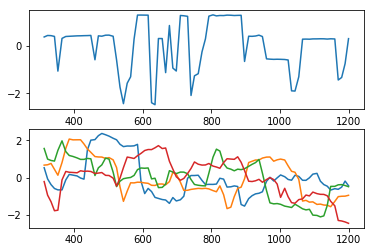

subject 30; gesture 1_0_1; avg 0.8970769294041571; sd 0.00827147169933215
subject 30; gesture 1_0_1; PoV: 0.9853827842054084


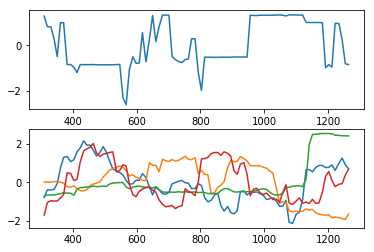

subject 30; gesture 3_1_1; avg 1.3931688065895627; sd 0.01584933627855459
subject 30; gesture 3_1_1; PoV: 0.9833957785848569


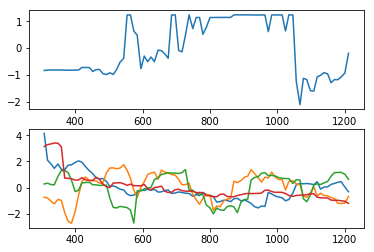

subject 30; gesture 1_0_2; avg 2.595607940851761; sd 0.022132470221009365
subject 30; gesture 1_0_2; PoV: 0.9911923802624536


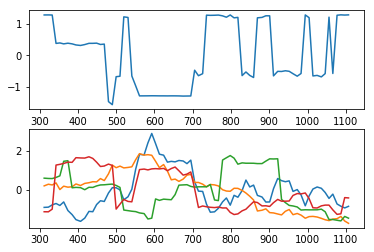

subject 30; gesture 4_0_2; avg 1.1880536325769482; sd 0.019361608000522768
subject 30; gesture 4_0_2; PoV: 0.971730209257032


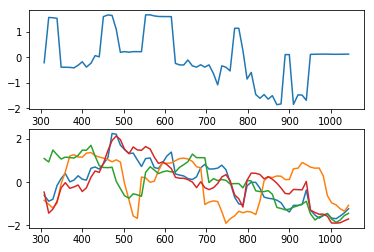

subject 06; gesture 3_0_1; avg 2.950194970978024; sd 0.06935408442102316
subject 06; gesture 3_0_1; PoV: 0.9758634078251027


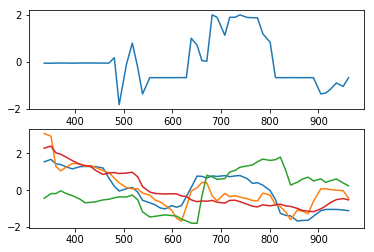

subject 06; gesture 4_1_1; avg 2.5875466843830903; sd 0.18169546730231473
subject 06; gesture 4_1_1; PoV: 0.9472136736495681


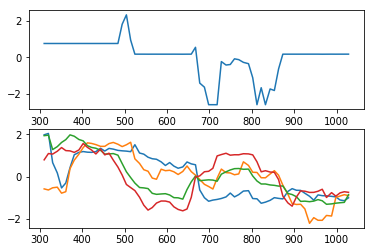

subject 06; gesture 2_0_1; avg 4.596056349032715; sd 0.07513796080600231
subject 06; gesture 2_0_1; PoV: 0.9879746253983673


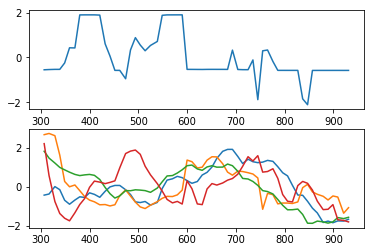

subject 06; gesture 4_1_2; avg 1.8588101466694371; sd 0.11511387331766657
subject 06; gesture 4_1_2; PoV: 0.9429407076976791


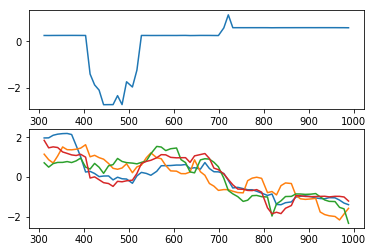

subject 06; gesture 2_0_2; avg 1.6621929251853498; sd 0.011957242724592022
subject 06; gesture 2_0_2; PoV: 0.990914046303472


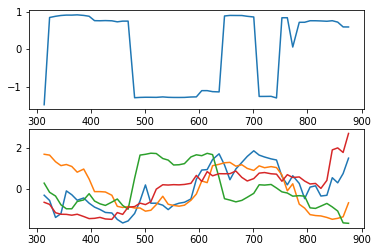

subject 06; gesture 1_1_2; avg 4.653025228951877; sd 0.035224469729136926
subject 06; gesture 1_1_2; PoV: 0.9888630578054526


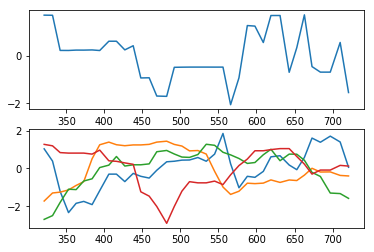

subject 06; gesture 2_1_2; avg 2.7974496486428557; sd 0.023731150308814196
subject 06; gesture 2_1_2; PoV: 0.9889293225265138


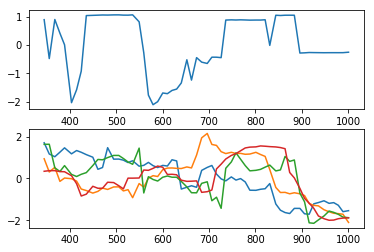

subject 06; gesture 4_0_1; avg 2.611981748703888; sd 0.01745087912753506
subject 06; gesture 4_0_1; PoV: 0.9884437393783931


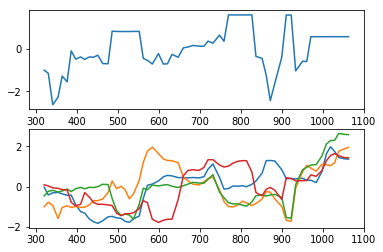

subject 06; gesture 3_0_2; avg 1.111984398599649; sd 0.01354263924570408
subject 06; gesture 3_0_2; PoV: 0.9735609946685091


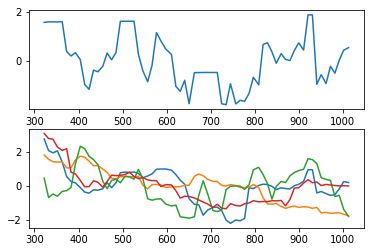

subject 06; gesture 1_1_1; avg 1.3339330494207151; sd 0.017854596074626108
subject 06; gesture 1_1_1; PoV: 0.9781265018041532


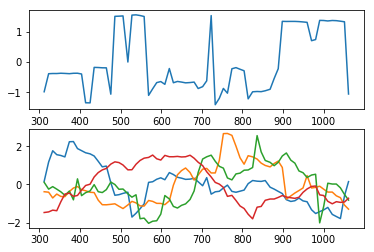

subject 06; gesture 3_1_2; avg 1.1592565087617777; sd 0.009369753389796358
subject 06; gesture 3_1_2; PoV: 0.9870257646315442


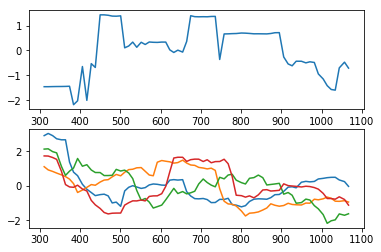

subject 06; gesture 2_1_1; avg 1.3039867926172515; sd 0.010007339983269489
subject 06; gesture 2_1_1; PoV: 0.9878302158198103


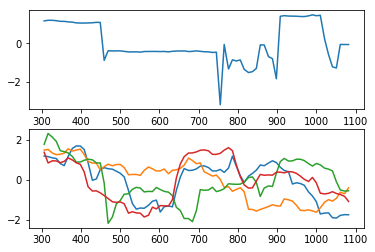

subject 06; gesture 1_0_1; avg 1.4960738460733418; sd 0.02085060588816557
subject 06; gesture 1_0_1; PoV: 0.9815294195878611


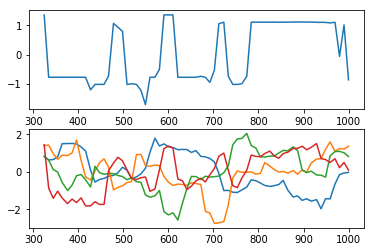

subject 06; gesture 3_1_1; avg 8.942781569243534; sd 0.1726727263741122
subject 06; gesture 3_1_1; PoV: 0.9825574078647854


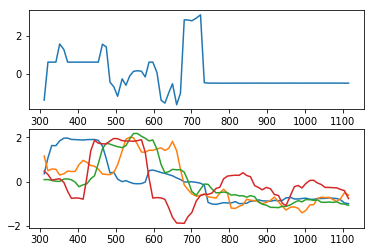

subject 06; gesture 1_0_2; avg 3.4445954748139718; sd 0.030405646500300032
subject 06; gesture 1_0_2; PoV: 0.9903162061153866


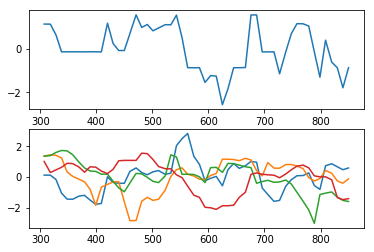

subject 06; gesture 4_0_2; avg 1.171847394032363; sd 0.009870011928338335
subject 06; gesture 4_0_2; PoV: 0.9869760414725042


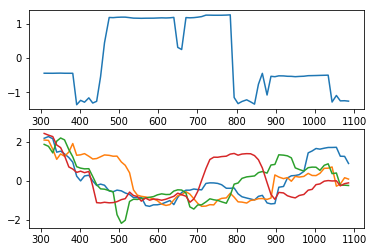

subject 09; gesture 3_0_1; avg 2.0986087978388017; sd 0.041529464900235236
subject 09; gesture 3_0_1; PoV: 0.9787232230033441


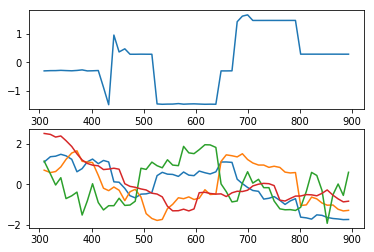

subject 09; gesture 4_1_1; avg 2.6911050900507147; sd 0.02052068111240179
subject 09; gesture 4_1_1; PoV: 0.9913919053737101


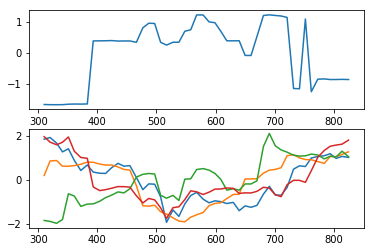

subject 09; gesture 2_0_1; avg 1.8757892367633504; sd 0.013791131026101031
subject 09; gesture 2_0_1; PoV: 0.9883773121227096


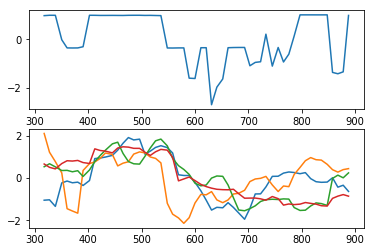

subject 09; gesture 4_1_2; avg 3.268577288880573; sd 0.02903561512177435
subject 09; gesture 4_1_2; PoV: 0.9911754679904161


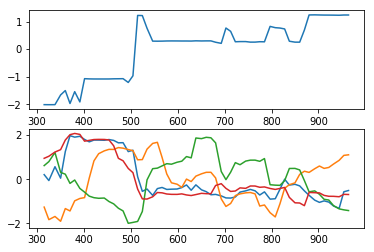

subject 09; gesture 2_0_2; avg 6.413531154480049; sd 0.08275851560600489
subject 09; gesture 2_0_2; PoV: 0.9897706980700766


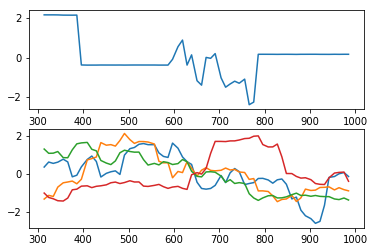

subject 09; gesture 1_1_2; avg 1.4437300210322872; sd 0.021448854138885285
subject 09; gesture 1_1_2; PoV: 0.9784954977787697


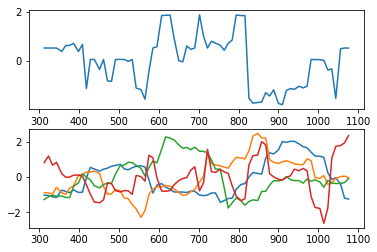

subject 09; gesture 2_1_2; avg 1.3811397562596794; sd 0.024022504103476568
subject 09; gesture 2_1_2; PoV: 0.9777238657197955


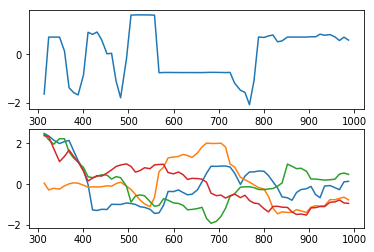

subject 09; gesture 4_0_1; avg 1.1607359726005557; sd 0.01709862677641466
subject 09; gesture 4_0_1; PoV: 0.9704749359227924


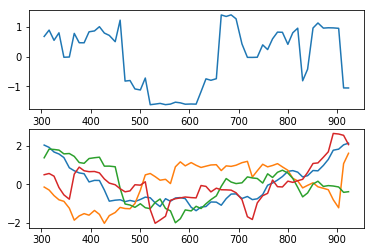

subject 09; gesture 3_0_2; avg 1.2962094748917712; sd 0.01400145401017162
subject 09; gesture 3_0_2; PoV: 0.9820031814448688


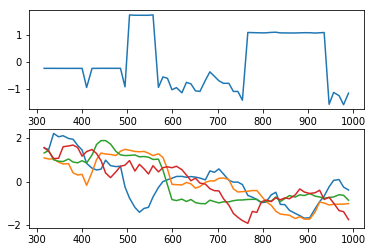

subject 09; gesture 1_1_1; avg 2.432636304523542; sd 0.027483488403518164
subject 09; gesture 1_1_1; PoV: 0.9888312873963596


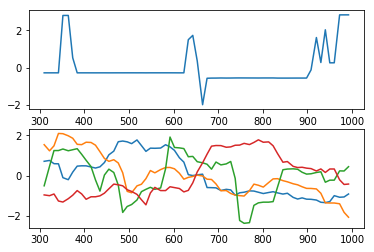

subject 09; gesture 3_1_2; avg 1.141632014290196; sd 0.017249195175388962
subject 09; gesture 3_1_2; PoV: 0.9736575276233852


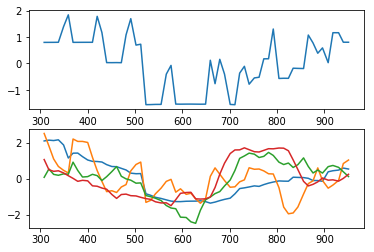

subject 09; gesture 2_1_1; avg 1.7692917789787161; sd 0.027041731120090486
subject 09; gesture 2_1_1; PoV: 0.9764386026272306


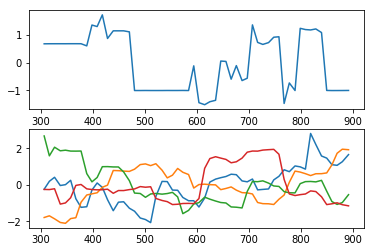

subject 09; gesture 1_0_1; avg 7.291379241770488; sd 0.04899778143581269
subject 09; gesture 1_0_1; PoV: 0.9955596964363459


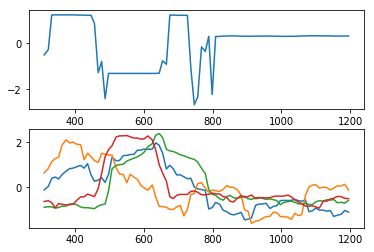

subject 09; gesture 3_1_1; avg 1.951671008824466; sd 0.019056576403106266
subject 09; gesture 3_1_1; PoV: 0.9850839605160507


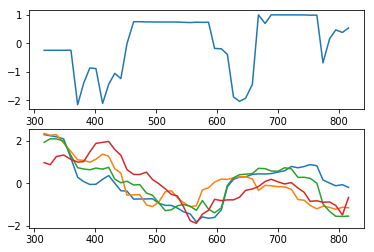

subject 09; gesture 1_0_2; avg 1.4289183414442068; sd 0.02208582070158573
subject 09; gesture 1_0_2; PoV: 0.981871186758068


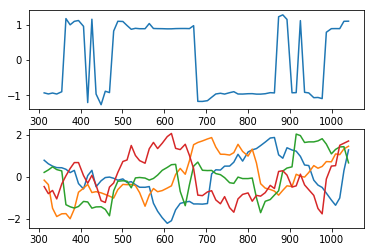

subject 09; gesture 4_0_2; avg 3.8406340285135188; sd 0.039101798799647744
subject 09; gesture 4_0_2; PoV: 0.9848537094432449


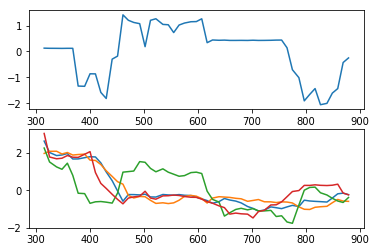

subject 03; gesture 3_0_1; avg 1.2844446503570621; sd 0.025244772090601733
subject 03; gesture 3_0_1; PoV: 0.9653928930827821


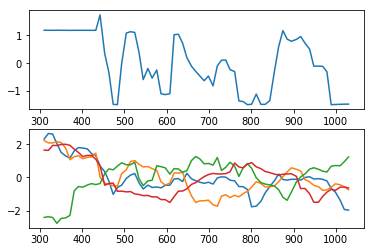

subject 03; gesture 4_1_1; avg 1.2476642570563796; sd 0.015107976248552125
subject 03; gesture 4_1_1; PoV: 0.9768138056602095


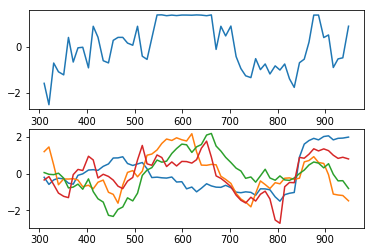

subject 03; gesture 2_0_1; avg 2.8851903610129876; sd 0.02614828173665463
subject 03; gesture 2_0_1; PoV: 0.9899454845258526


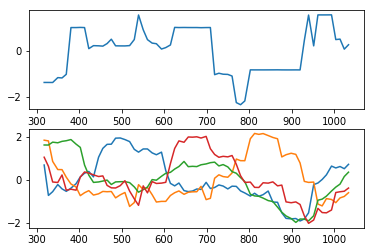

subject 03; gesture 4_1_2; avg 3.5973715705151226; sd 0.04350642451589324
subject 03; gesture 4_1_2; PoV: 0.9889422972437723


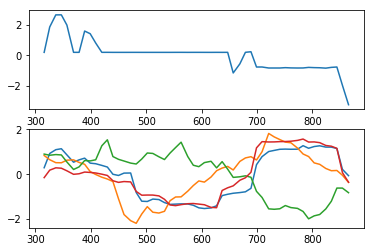

subject 03; gesture 2_0_2; avg 1.1339400941596895; sd 0.01569519910314947
subject 03; gesture 2_0_2; PoV: 0.9778554646648807


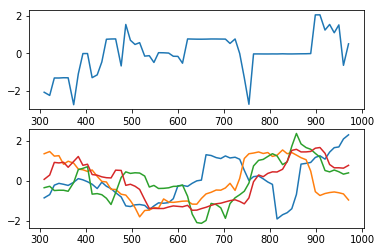

subject 03; gesture 1_1_2; avg 1.0713410731862598; sd 0.012022557008487492
subject 03; gesture 1_1_2; PoV: 0.9780950945065232


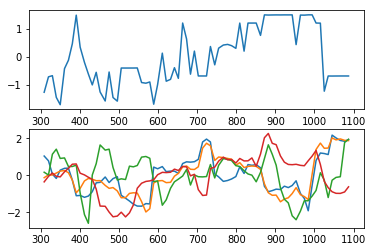

subject 03; gesture 2_1_2; avg 1.91640364921232; sd 0.01674832232668284
subject 03; gesture 2_1_2; PoV: 0.9898481807847247


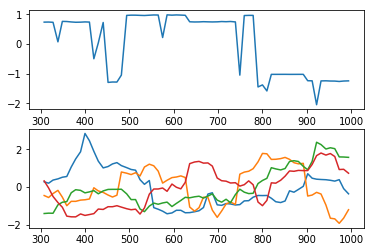

subject 03; gesture 4_0_1; avg 1.6746737881268279; sd 0.02518504914779585
subject 03; gesture 4_0_1; PoV: 0.9788894907198828


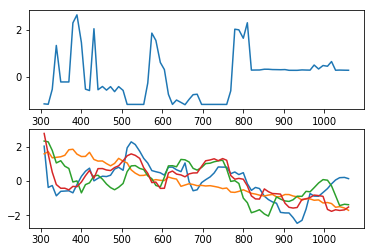

subject 03; gesture 3_0_2; avg 1.828207467734331; sd 0.01574557134012289
subject 03; gesture 3_0_2; PoV: 0.9861761249616933


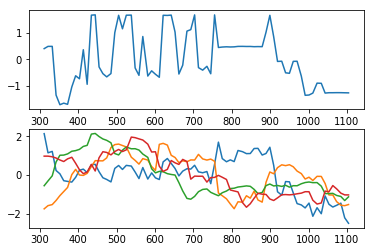

subject 03; gesture 1_1_1; avg 1.92221438827479; sd 0.019709163987746876
subject 03; gesture 1_1_1; PoV: 0.982877685772363


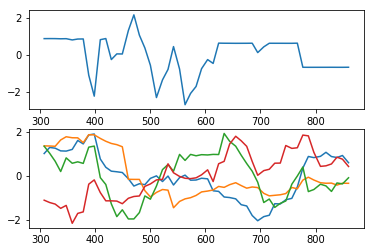

subject 03; gesture 3_1_2; avg 2.1000661459104286; sd 0.017859313839037744
subject 03; gesture 3_1_2; PoV: 0.9879777260240076


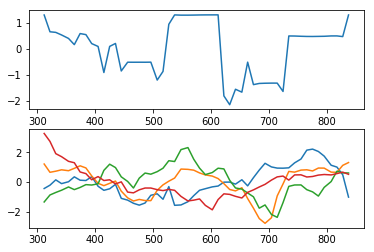

subject 03; gesture 2_1_1; avg 1.2278903445846892; sd 0.016954032392163348
subject 03; gesture 2_1_1; PoV: 0.9790862783104947


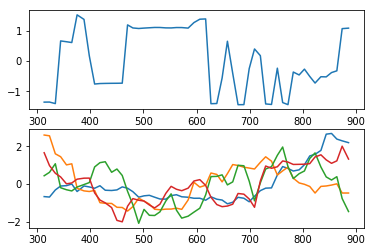

subject 03; gesture 1_0_1; avg 1.0711793650107755; sd 0.019155044389269366
subject 03; gesture 1_0_1; PoV: 0.9732621191889884


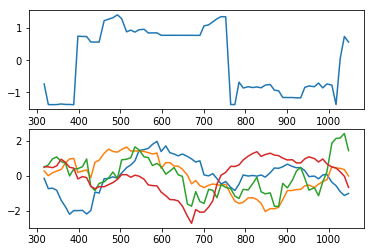

subject 03; gesture 3_1_1; avg 1.05527646866933; sd 0.012448890962747313
subject 03; gesture 3_1_1; PoV: 0.9779833593624649


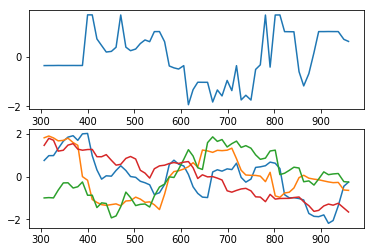

subject 03; gesture 1_0_2; avg 1.2819528094435262; sd 0.011383182399870987
subject 03; gesture 1_0_2; PoV: 0.9840014533307615


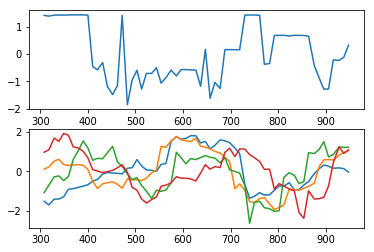

subject 03; gesture 4_0_2; avg 1.3543733979145458; sd 0.03682129969651762
subject 03; gesture 4_0_2; PoV: 0.9639765350310232


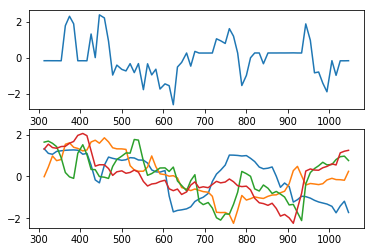

subject 05; gesture 3_0_1; avg 2.540737860517448; sd 0.014676659645880163
subject 05; gesture 3_0_1; PoV: 0.9927290162158428


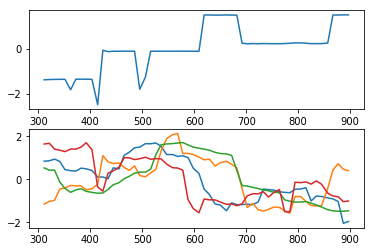

subject 05; gesture 4_1_1; avg 1.822993469060633; sd 0.024990639711792554
subject 05; gesture 4_1_1; PoV: 0.9809815842962152


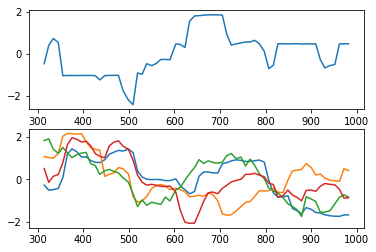

subject 05; gesture 2_0_1; avg 4.9216484115252905; sd 0.04116421779251185
subject 05; gesture 2_0_1; PoV: 0.993793219838768


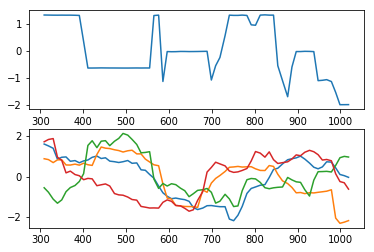

subject 05; gesture 4_1_2; avg 0.9789556328611559; sd 0.010331354371925765
subject 05; gesture 4_1_2; PoV: 0.9831234488609499


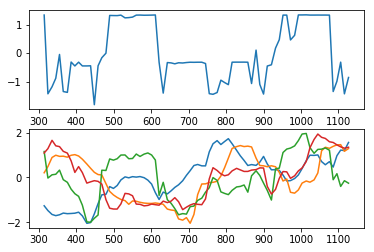

subject 05; gesture 2_0_2; avg 1.2656432809192533; sd 0.014750093895530315
subject 05; gesture 2_0_2; PoV: 0.9815102360229039


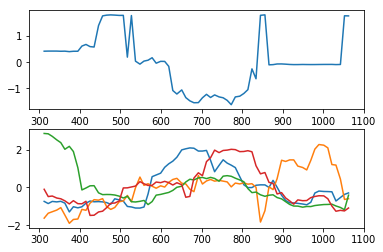

subject 05; gesture 1_1_2; avg 1.4751958290214209; sd 0.013811422233028548
subject 05; gesture 1_1_2; PoV: 0.9847484889079693


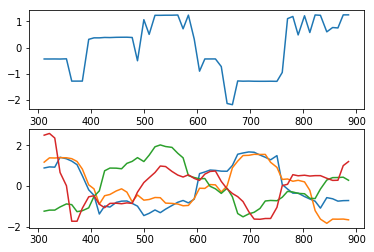

subject 05; gesture 2_1_2; avg 1.3548994519603654; sd 0.014149743168686252
subject 05; gesture 2_1_2; PoV: 0.984149799169454


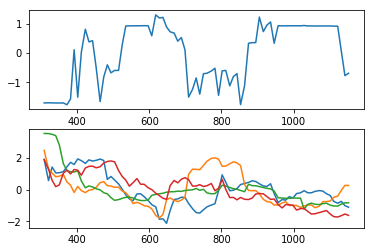

subject 05; gesture 4_0_1; avg 1.517590770388229; sd 0.01786297797707992
subject 05; gesture 4_0_1; PoV: 0.984253255043999


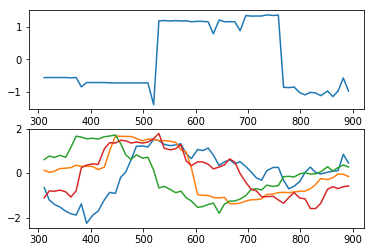

subject 05; gesture 3_0_2; avg 1.0704358492695958; sd 0.014523424611721463
subject 05; gesture 3_0_2; PoV: 0.9787515568752513


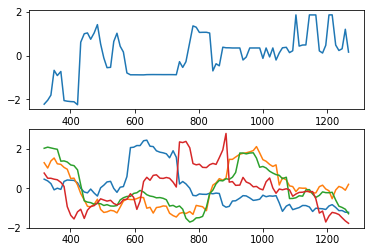

subject 05; gesture 1_1_1; avg 2.3113845587415254; sd 0.03922822006018607
subject 05; gesture 1_1_1; PoV: 0.9791181060705755


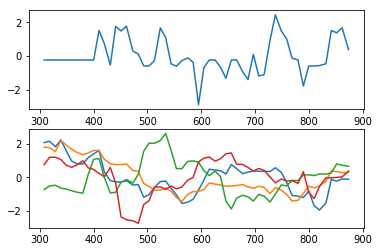

subject 05; gesture 3_1_2; avg 1.0358600179498876; sd 0.008124181339232877
subject 05; gesture 3_1_2; PoV: 0.9855328067431758


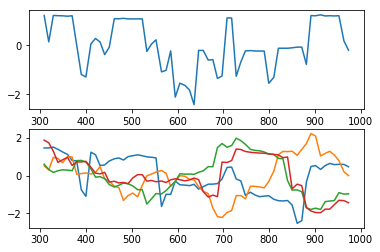

subject 05; gesture 2_1_1; avg 1.315721434873523; sd 0.020139580610495724
subject 05; gesture 2_1_1; PoV: 0.9783536043232118


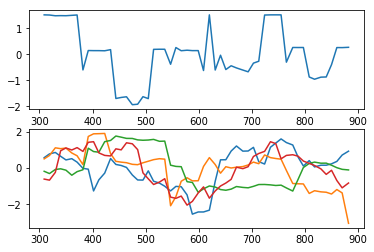

subject 05; gesture 1_0_1; avg 0.8517762682800609; sd 0.006473006257619441
subject 05; gesture 1_0_1; PoV: 0.986502021063688


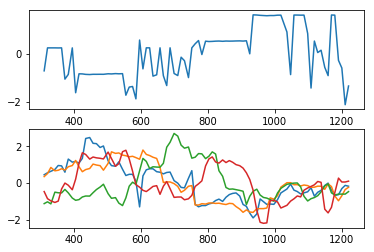

subject 05; gesture 3_1_1; avg 1.5859855744245042; sd 0.015837846420479536
subject 05; gesture 3_1_1; PoV: 0.9869943409100581


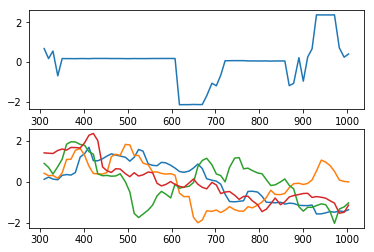

subject 05; gesture 1_0_2; avg 1.197408877469279; sd 0.018201977943734717
subject 05; gesture 1_0_2; PoV: 0.9784619128138479


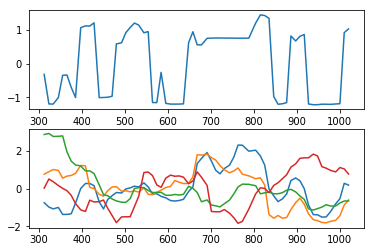

subject 05; gesture 4_0_2; avg 2.9026800322864843; sd 0.028100513834319704
subject 05; gesture 4_0_2; PoV: 0.9884587485294802


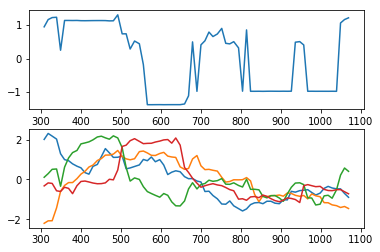

subject 21; gesture 3_0_1; avg 1.2844435679204165; sd 0.021321310180798886
subject 21; gesture 3_0_1; PoV: 0.9785185268871546


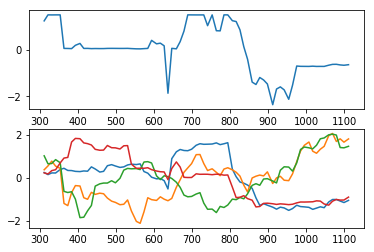

subject 21; gesture 4_1_1; avg 1.4171271414016187; sd 0.015296613458625352
subject 21; gesture 4_1_1; PoV: 0.9816792435319379


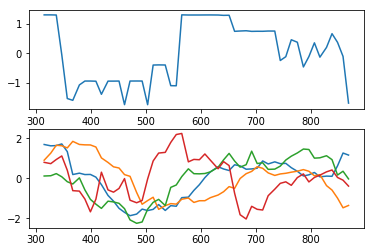

subject 21; gesture 2_0_1; avg 1.1330441945868996; sd 0.014782549810679654
subject 21; gesture 2_0_1; PoV: 0.9790640063877543


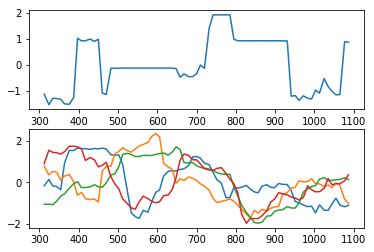

subject 21; gesture 4_1_2; avg 3.026608870271508; sd 0.1678218217031663
subject 21; gesture 4_1_2; PoV: 0.9546414160924466


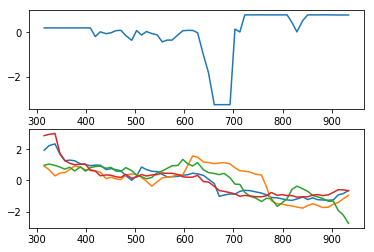

subject 21; gesture 2_0_2; avg 1.3189948551737296; sd 0.011773789580760505
subject 21; gesture 2_0_2; PoV: 0.98054505134235


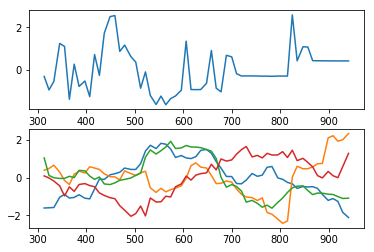

subject 21; gesture 1_1_2; avg 1.9769989406538264; sd 0.010817342670218083
subject 21; gesture 1_1_2; PoV: 0.9937727952989153


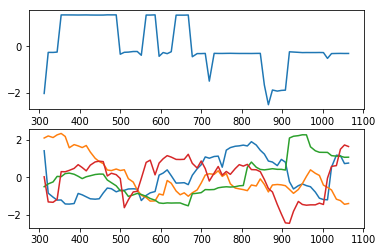

subject 21; gesture 2_1_2; avg 2.0640443357204274; sd 0.01477320023362729
subject 21; gesture 2_1_2; PoV: 0.9900623884196466


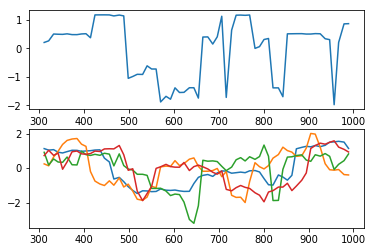

subject 21; gesture 4_0_1; avg 1.2996609421202456; sd 0.014988459142438746
subject 21; gesture 4_0_1; PoV: 0.9707277201113007


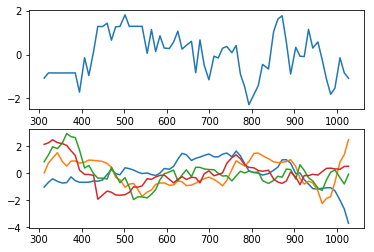

subject 21; gesture 3_0_2; avg 2.7392913216937074; sd 0.018635087689545686
subject 21; gesture 3_0_2; PoV: 0.991199570218736


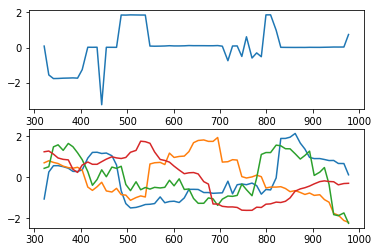

subject 21; gesture 1_1_1; avg 1.707136537878107; sd 0.05003813564268046
subject 21; gesture 1_1_1; PoV: 0.9726114989185038


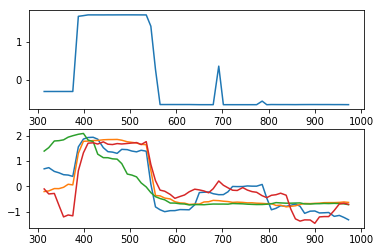

subject 21; gesture 3_1_2; avg 3.9334413623154467; sd 0.03287234617188443
subject 21; gesture 3_1_2; PoV: 0.994109918533468


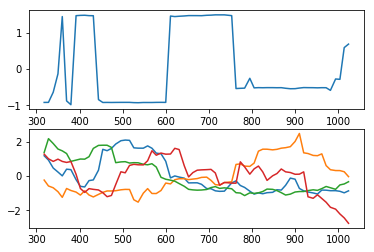

subject 21; gesture 2_1_1; avg 1.022415785198262; sd 0.009837005688329044
subject 21; gesture 2_1_1; PoV: 0.9846401544298448


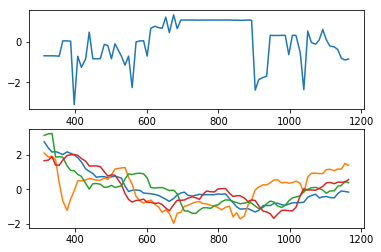

subject 21; gesture 1_0_1; avg 1.4199396410174565; sd 0.011563014339863058
subject 21; gesture 1_0_1; PoV: 0.9893564307749859


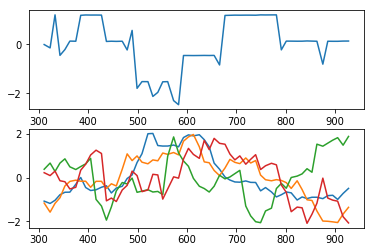

subject 21; gesture 3_1_1; avg 1.5145306802266119; sd 0.046999697259905
subject 21; gesture 3_1_1; PoV: 0.9677551582115087


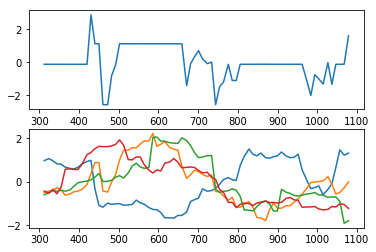

subject 21; gesture 1_0_2; avg 1.2603760655898515; sd 0.013227197665285588
subject 21; gesture 1_0_2; PoV: 0.9831814736920701


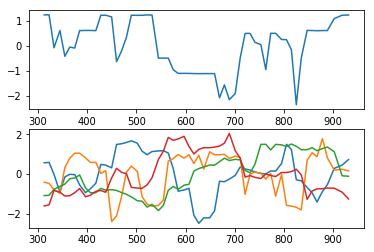

subject 21; gesture 4_0_2; avg 2.916941304396274; sd 0.021178859332203568
subject 21; gesture 4_0_2; PoV: 0.9906161920127602


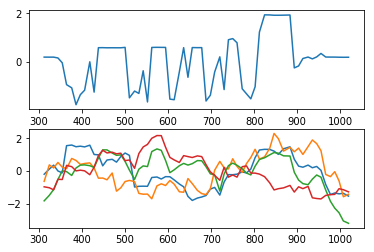

subject 17; gesture 3_0_1; avg 1.1590981133250133; sd 0.012193766450457472
subject 17; gesture 3_0_1; PoV: 0.9819444438482384


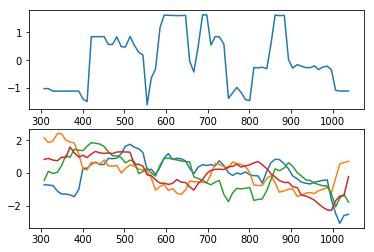

subject 17; gesture 4_1_1; avg 1.3102246108448037; sd 0.026549021731074984
subject 17; gesture 4_1_1; PoV: 0.9737841639745262


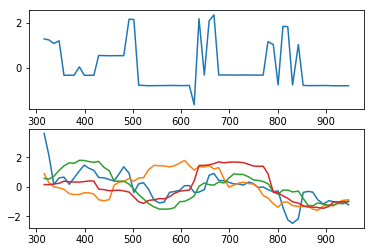

subject 17; gesture 2_0_1; avg 1.915492777505946; sd 0.22006917544058405
subject 17; gesture 2_0_1; PoV: 0.8879940718685501


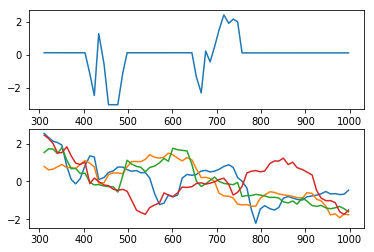

subject 17; gesture 4_1_2; avg 2.730908377915321; sd 0.028376344404327243
subject 17; gesture 4_1_2; PoV: 0.9891946680442458


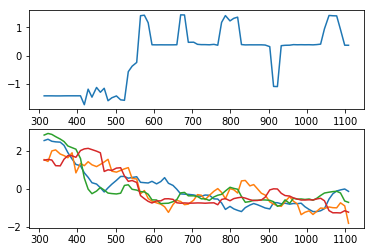

subject 17; gesture 2_0_2; avg 1.317601486381992; sd 0.014772650374372821
subject 17; gesture 2_0_2; PoV: 0.9845660839699438


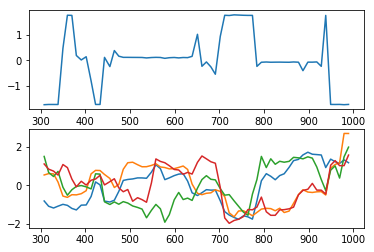

subject 17; gesture 1_1_2; avg 0.9265441178574187; sd 0.008232435429452786
subject 17; gesture 1_1_2; PoV: 0.986079091030531


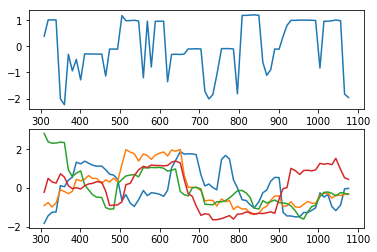

subject 17; gesture 2_1_2; avg 1.7418652988844505; sd 0.016488855777151402
subject 17; gesture 2_1_2; PoV: 0.985771567104706


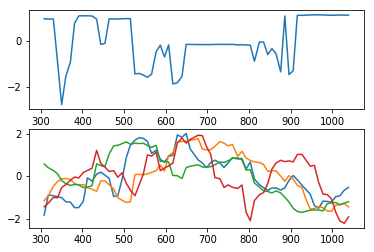

subject 17; gesture 4_0_1; avg 1.4234542511426422; sd 0.016012438123099708
subject 17; gesture 4_0_1; PoV: 0.9858047602088036


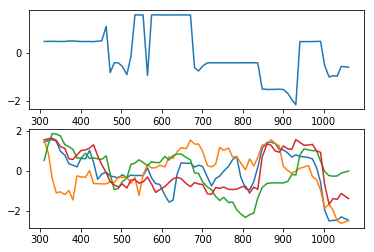

subject 17; gesture 3_0_2; avg 1.3372617045976294; sd 0.02622628872366669
subject 17; gesture 3_0_2; PoV: 0.9713577257937003


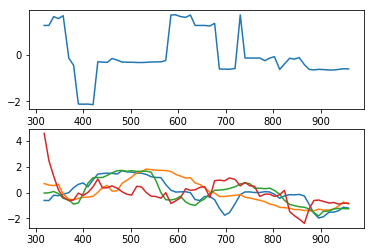

subject 17; gesture 1_1_1; avg 1.351604457670671; sd 0.008084854577225088
subject 17; gesture 1_1_1; PoV: 0.9891186631777779


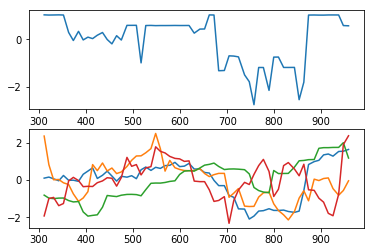

subject 17; gesture 3_1_2; avg 1.5681783981695494; sd 0.017962015132087405
subject 17; gesture 3_1_2; PoV: 0.9851809865267638


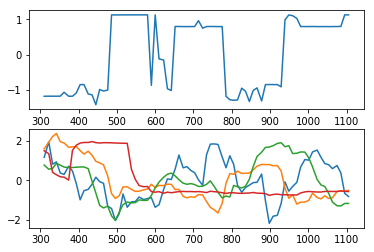

subject 17; gesture 2_1_1; avg 1.238626104335981; sd 0.012241998622200328
subject 17; gesture 2_1_1; PoV: 0.9814012834271019


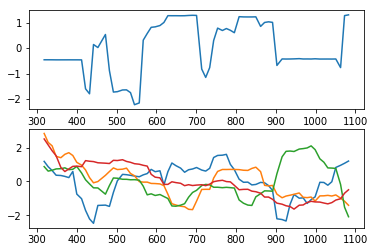

subject 17; gesture 1_0_1; avg 1.0535497999126313; sd 0.016715388866443904
subject 17; gesture 1_0_1; PoV: 0.9750762949389432


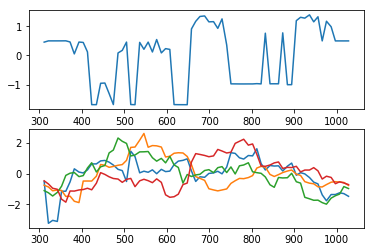

subject 17; gesture 3_1_1; avg 1.5050857672147147; sd 0.03171744340059582
subject 17; gesture 3_1_1; PoV: 0.9742263675619642


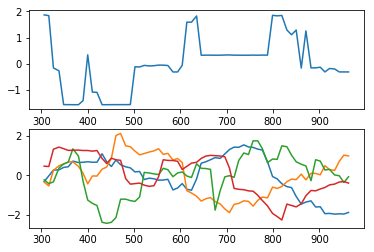

subject 17; gesture 1_0_2; avg 1.2612121087173318; sd 0.011576094463171467
subject 17; gesture 1_0_2; PoV: 0.9833237196723662


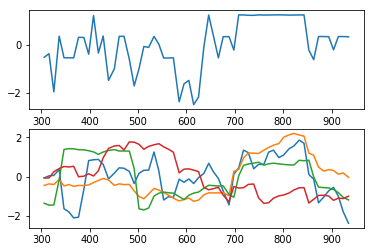

subject 17; gesture 4_0_2; avg 1.4650115167475382; sd 0.012531637581110623
subject 17; gesture 4_0_2; PoV: 0.9878772152537552


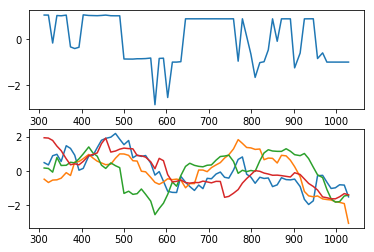

subject 01; gesture 3_0_1; avg 1.1666868557184649; sd 0.010843703060335864
subject 01; gesture 3_0_1; PoV: 0.9857771222114162


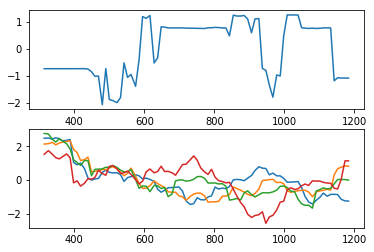

subject 01; gesture 4_1_1; avg 2.9612860379679877; sd 0.015004167955162481
subject 01; gesture 4_1_1; PoV: 0.9935013309104757


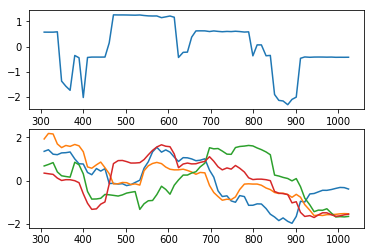

subject 01; gesture 2_0_1; avg 0.9671547430122159; sd 0.0075539555394408325
subject 01; gesture 2_0_1; PoV: 0.9877151340563434


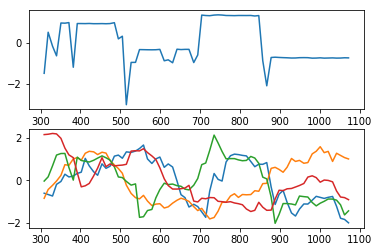

subject 01; gesture 4_1_2; avg 3.318390626650284; sd 0.053398838478022514
subject 01; gesture 4_1_2; PoV: 0.9834899052815258


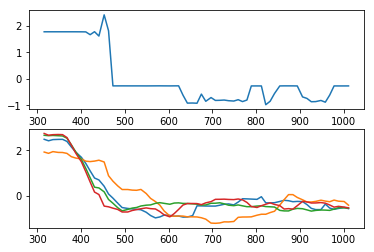

subject 01; gesture 2_0_2; avg 1.4947511630033983; sd 0.02972249727325201
subject 01; gesture 2_0_2; PoV: 0.9736062698964074


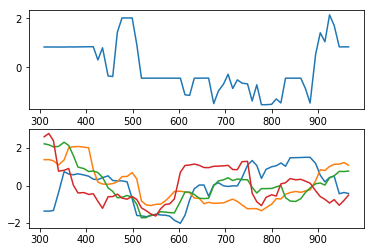

subject 01; gesture 1_1_2; avg 6.8852193534272805; sd 0.040226924537827
subject 01; gesture 1_1_2; PoV: 0.9938754551157445


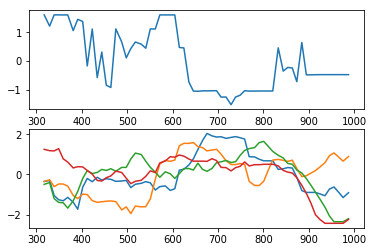

subject 01; gesture 2_1_2; avg 1.227002591186614; sd 0.008912875635521926
subject 01; gesture 2_1_2; PoV: 0.9876897382123495


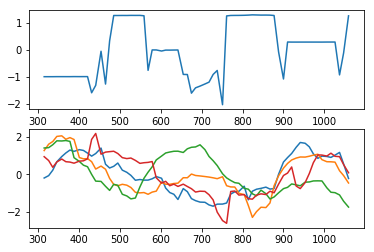

subject 01; gesture 4_0_1; avg 1.2276018049402952; sd 0.014556106549163114
subject 01; gesture 4_0_1; PoV: 0.9824601194734603


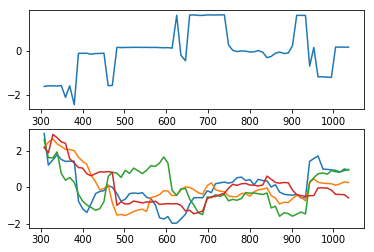

subject 01; gesture 3_0_2; avg 3.985306029462886; sd 0.02902502259911398
subject 01; gesture 3_0_2; PoV: 0.992847749529965


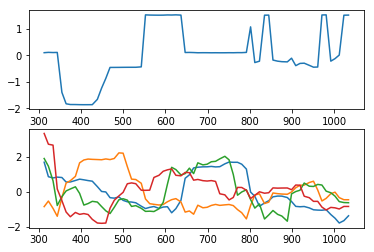

subject 01; gesture 1_1_1; avg 1.2983370990244363; sd 0.014782457585412875
subject 01; gesture 1_1_1; PoV: 0.9802262498865733


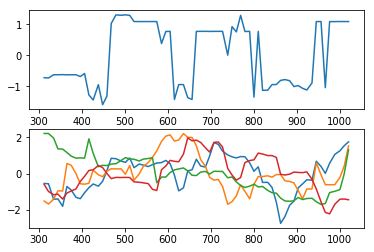

subject 01; gesture 3_1_2; avg 1.4427944217694477; sd 0.04869804229896625
subject 01; gesture 3_1_2; PoV: 0.9708419490785152


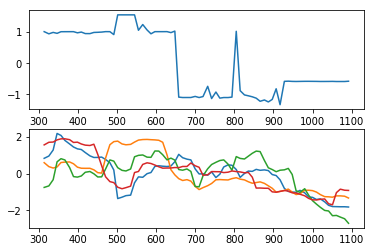

subject 01; gesture 2_1_1; avg 2.2007669741918985; sd 0.00964547644743983
subject 01; gesture 2_1_1; PoV: 0.9935990855765644


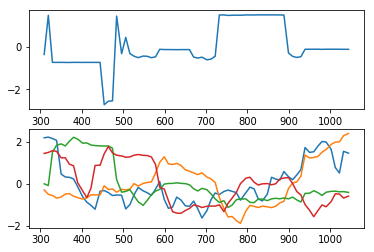

subject 01; gesture 1_0_1; avg 0.9481441544995882; sd 0.009198993208540179
subject 01; gesture 1_0_1; PoV: 0.9818310628869499


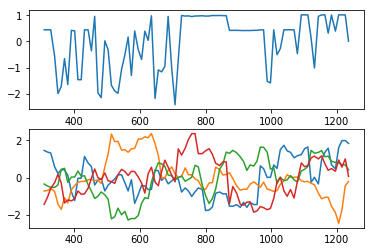

subject 01; gesture 3_1_1; avg 1.7482787328027762; sd 0.01692797024402938
subject 01; gesture 3_1_1; PoV: 0.9855783490748665


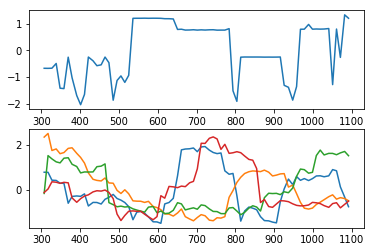

subject 01; gesture 1_0_2; avg 0.9495531120866454; sd 0.011370590257694733
subject 01; gesture 1_0_2; PoV: 0.9746954527753993


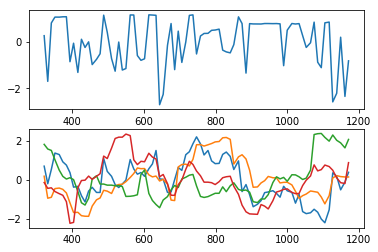

subject 01; gesture 4_0_2; avg 4.986180549255448; sd 0.048578140006000664
subject 01; gesture 4_0_2; PoV: 0.9896380295359815


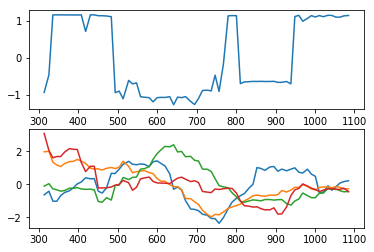

subject 16; gesture 3_0_1; avg 0.9387630812437237; sd 0.01045995483812249
subject 16; gesture 3_0_1; PoV: 0.9841241273770964


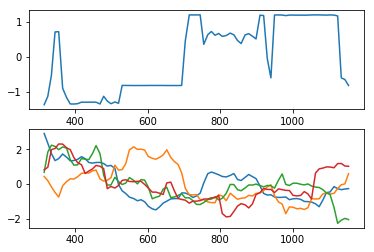

subject 16; gesture 4_1_1; avg 2.8642780745317387; sd 0.06383009722480568
subject 16; gesture 4_1_1; PoV: 0.9780324371407059


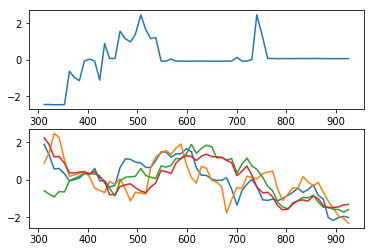

subject 16; gesture 2_0_1; avg 1.7500326446417152; sd 1.420693101311607
subject 16; gesture 2_0_1; PoV: 0.5333955526567274


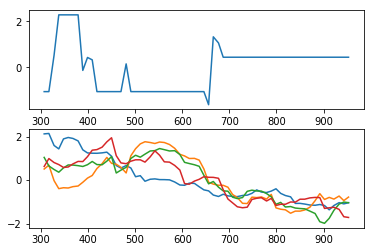

subject 16; gesture 4_1_2; avg 1.1819776003732774; sd 0.9298437489788657
subject 16; gesture 4_1_2; PoV: 0.5555935801213044


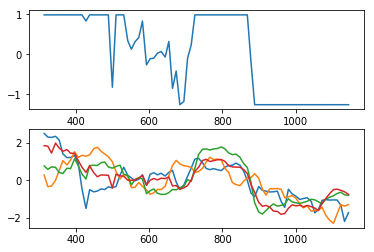

subject 16; gesture 2_0_2; avg 2.9500016613842184; sd 0.04643206413321108
subject 16; gesture 2_0_2; PoV: 0.9817237147249485


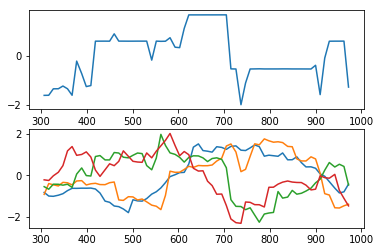

subject 16; gesture 1_1_2; avg 1.9870850633368342; sd 0.020382324283259527
subject 16; gesture 1_1_2; PoV: 0.9804047697134222


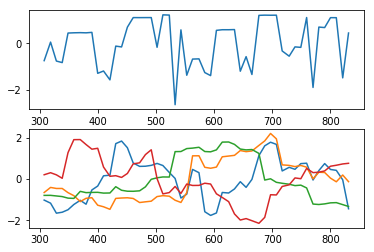

subject 16; gesture 2_1_2; avg 1.1455761223192344; sd 0.009236816290400601
subject 16; gesture 2_1_2; PoV: 0.9881711314443273


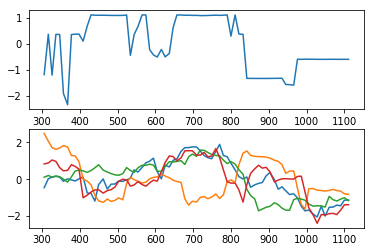

subject 16; gesture 4_0_1; avg 2.9015639636280293; sd 0.023653903674145535
subject 16; gesture 4_0_1; PoV: 0.9920446826359801


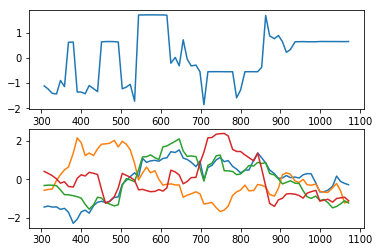

subject 16; gesture 3_0_2; avg 2.423475120905702; sd 0.011504526312343341
subject 16; gesture 3_0_2; PoV: 0.9934782524877327


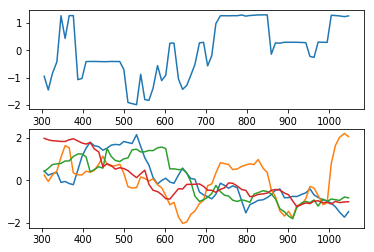

subject 16; gesture 1_1_1; avg 1.2146126072324772; sd 0.012774436543069452
subject 16; gesture 1_1_1; PoV: 0.9824455968485583


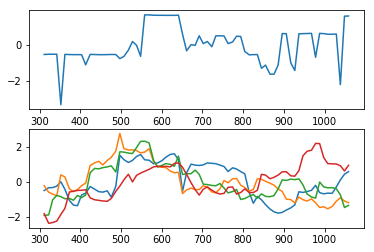

subject 16; gesture 3_1_2; avg 1.874951214791478; sd 0.013728296724969157
subject 16; gesture 3_1_2; PoV: 0.9896642781009897


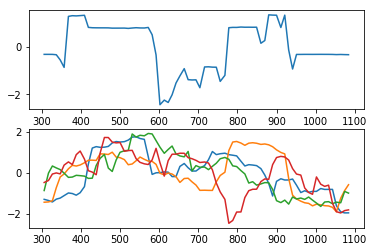

subject 16; gesture 2_1_1; avg 1.3478179944189912; sd 0.009342197682764076
subject 16; gesture 2_1_1; PoV: 0.9898164906080251


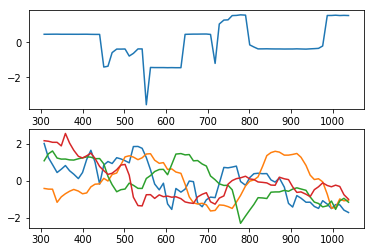

subject 16; gesture 1_0_1; avg 3.30637913423578; sd 0.032148593438982805
subject 16; gesture 1_0_1; PoV: 0.9873545253475635


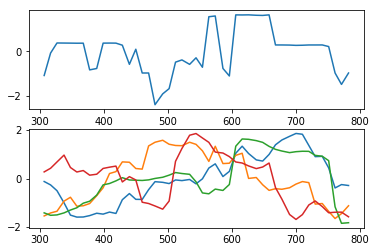

subject 16; gesture 3_1_1; avg 1.104280029712538; sd 0.010099664133676306
subject 16; gesture 3_1_1; PoV: 0.9856282669810958


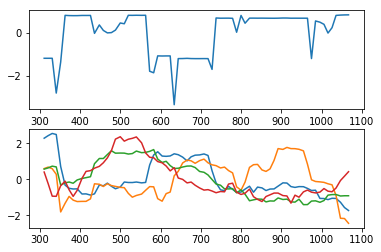

subject 16; gesture 1_0_2; avg 1.8583489621618348; sd 0.020175573819001928
subject 16; gesture 1_0_2; PoV: 0.9806572776068541


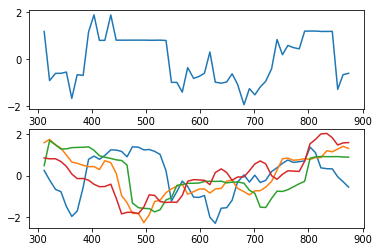

subject 16; gesture 4_0_2; avg 1.9010324933923652; sd 0.019571708315257133
subject 16; gesture 4_0_2; PoV: 0.985814890608417


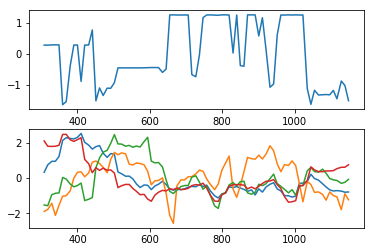

subject 26; gesture 3_0_1; avg 2.2174797042814745; sd 0.022290533415661284
subject 26; gesture 3_0_1; PoV: 0.9838494382607279


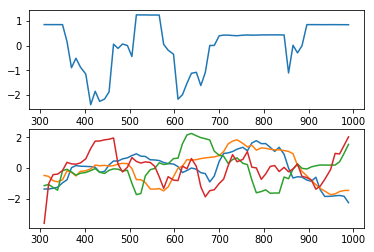

subject 26; gesture 4_1_1; avg 3.0686569514000057; sd 0.03631258188352591
subject 26; gesture 4_1_1; PoV: 0.9859091398071952


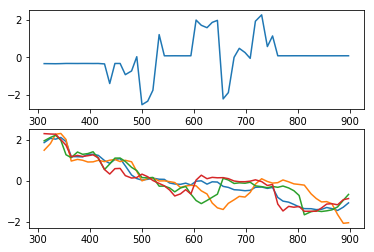

subject 26; gesture 2_0_1; avg 1.3094098121651023; sd 0.012904958294309618
subject 26; gesture 2_0_1; PoV: 0.9840095827398279


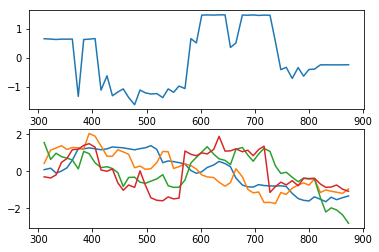

subject 26; gesture 4_1_2; avg 1.7732981250218092; sd 0.02220753118063786
subject 26; gesture 4_1_2; PoV: 0.9871229000222405


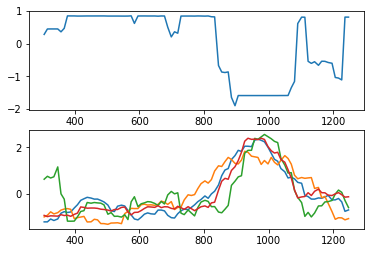

subject 26; gesture 2_0_2; avg 6.095023539784219; sd 0.06057700787506393
subject 26; gesture 2_0_2; PoV: 0.9918710019293037


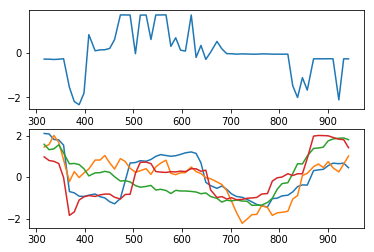

subject 26; gesture 1_1_2; avg 1.7976460610007425; sd 0.015798399125265355
subject 26; gesture 1_1_2; PoV: 0.9832070300916804


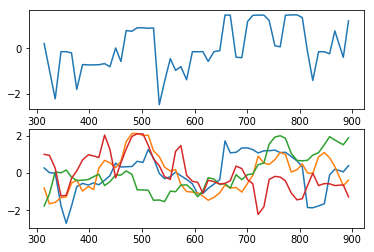

subject 26; gesture 2_1_2; avg 3.7981471893403826; sd 0.02724953818991233
subject 26; gesture 2_1_2; PoV: 0.9938355844456371


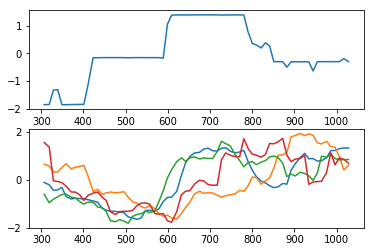

subject 26; gesture 4_0_1; avg 2.0723061793313717; sd 0.06608457584069377
subject 26; gesture 4_0_1; PoV: 0.9617353618843002


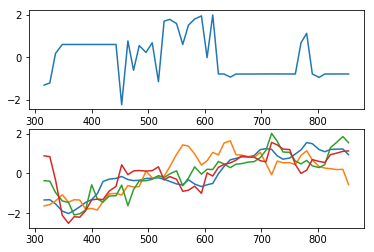

subject 26; gesture 3_0_2; avg 1.4825563260332077; sd 0.016432418145811208
subject 26; gesture 3_0_2; PoV: 0.98471116145024


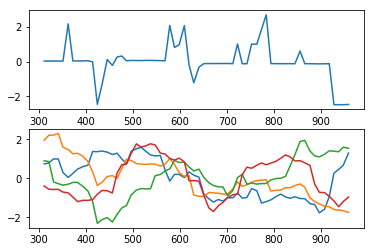

subject 26; gesture 1_1_1; avg 1.9084228112109565; sd 0.021661594490121883
subject 26; gesture 1_1_1; PoV: 0.9862180464103779


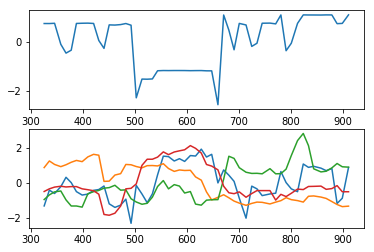

subject 26; gesture 3_1_2; avg 4.269045157484498; sd 0.028754711136182498
subject 26; gesture 3_1_2; PoV: 0.991851830400796


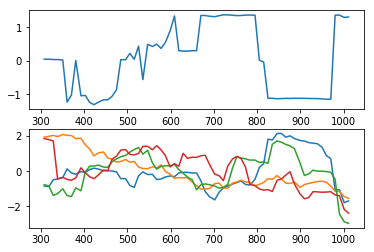

subject 26; gesture 2_1_1; avg 3.0941337091090633; sd 0.027452085560898763
subject 26; gesture 2_1_1; PoV: 0.9911554271228766


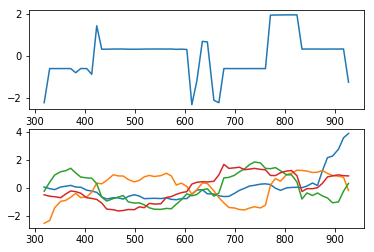

subject 26; gesture 1_0_1; avg 0.34753781393131256; sd 0.0034706176002800623
subject 26; gesture 1_0_1; PoV: 0.9816591606974273


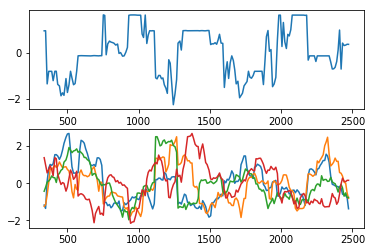

subject 26; gesture 3_1_1; avg 3.6149206644250347; sd 2.8193135934615614
subject 26; gesture 3_1_1; PoV: 0.6465726897386986


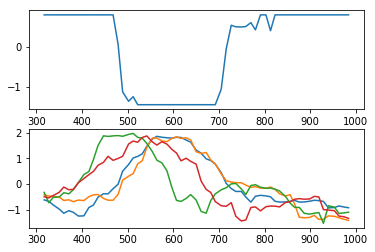

subject 26; gesture 1_0_2; avg 3.2522331157682234; sd 0.03383923130876457
subject 26; gesture 1_0_2; PoV: 0.9894003157471907


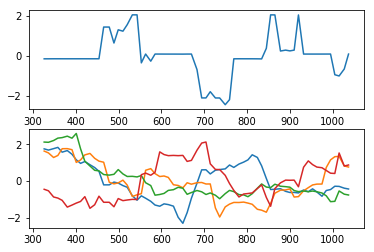

subject 26; gesture 4_0_2; avg 1.4591138126994447; sd 0.022576892684437428
subject 26; gesture 4_0_2; PoV: 0.9752184105387949


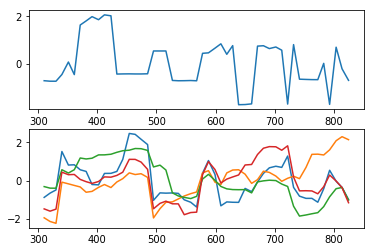

subject 32; gesture 3_0_1; avg 1.0303284578014986; sd 0.011552732541228206
subject 32; gesture 3_0_1; PoV: 0.9799306033200434


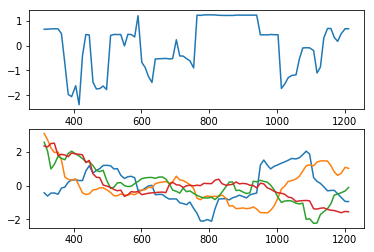

subject 32; gesture 4_1_1; avg 1.0752310373545064; sd 0.014262750347890886
subject 32; gesture 4_1_1; PoV: 0.9838228171905241


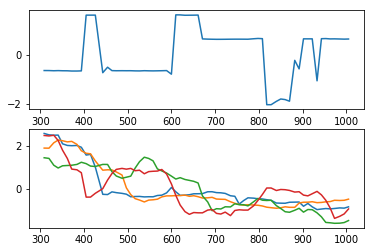

subject 32; gesture 2_0_1; avg 2.84023882415788; sd 0.05141234264887621
subject 32; gesture 2_0_1; PoV: 0.9818555980516513


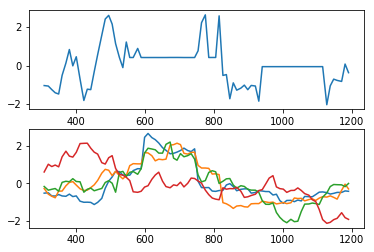

subject 32; gesture 4_1_2; avg 1.4536175343744047; sd 0.016646754916675378
subject 32; gesture 4_1_2; PoV: 0.9836327267118966


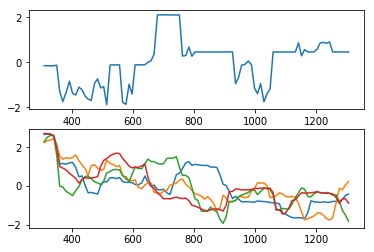

subject 32; gesture 2_0_2; avg 2.0227739286561888; sd 0.039509129077445214
subject 32; gesture 2_0_2; PoV: 0.9756067076879328


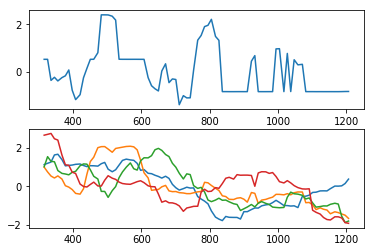

subject 32; gesture 1_1_2; avg 1.2960889811045373; sd 0.016364888995713745
subject 32; gesture 1_1_2; PoV: 0.9797226732169859


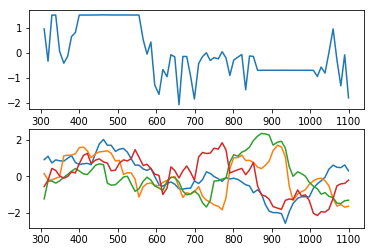

subject 32; gesture 2_1_2; avg 1.0801447879989468; sd 0.01489909686451389
subject 32; gesture 2_1_2; PoV: 0.9787331838177773


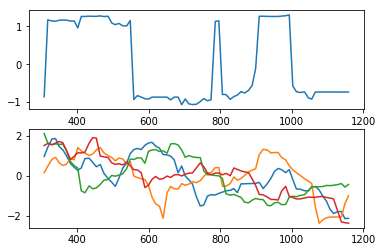

subject 32; gesture 4_0_1; avg 2.389325947440367; sd 0.01623535556487901
subject 32; gesture 4_0_1; PoV: 0.9895391865918967


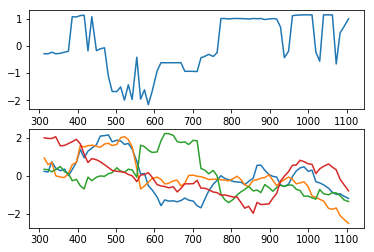

subject 32; gesture 3_0_2; avg 2.823272422567508; sd 0.07680460187838256
subject 32; gesture 3_0_2; PoV: 0.9794731253783009


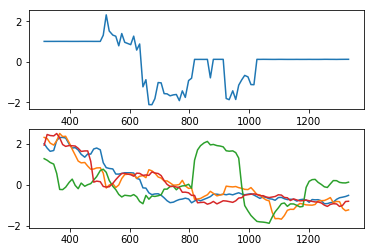

subject 32; gesture 1_1_1; avg 1.4124497332974613; sd 0.019766882941166297
subject 32; gesture 1_1_1; PoV: 0.979473586382373


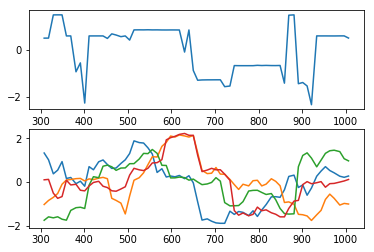

subject 32; gesture 3_1_2; avg 1.8019505609142406; sd 0.05665494094036754
subject 32; gesture 3_1_2; PoV: 0.9676207329231358


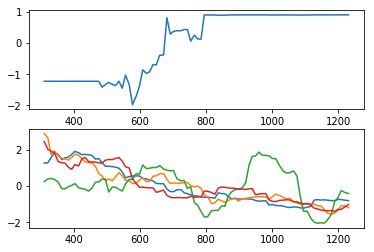

subject 32; gesture 2_1_1; avg 8.915698794981864; sd 0.08022030205875623
subject 32; gesture 2_1_1; PoV: 0.9937318790758433


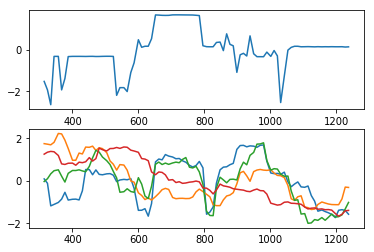

subject 32; gesture 1_0_1; avg 1.270845129033149; sd 0.01748898626377329
subject 32; gesture 1_0_1; PoV: 0.9824684432334087


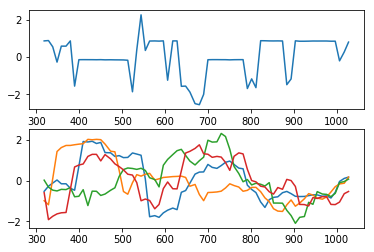

subject 32; gesture 3_1_1; avg 1.3455218368126691; sd 1.1405127068935454
subject 32; gesture 3_1_1; PoV: 0.5836280445297627


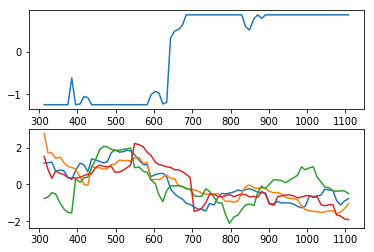

subject 32; gesture 1_0_2; avg 2.6242809584877365; sd 0.026242023391478707
subject 32; gesture 1_0_2; PoV: 0.9845483280878169


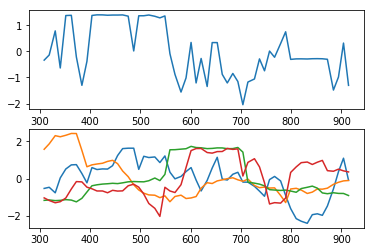

subject 32; gesture 4_0_2; avg 0.9472151896196368; sd 0.01624856712877428
subject 32; gesture 4_0_2; PoV: 0.9774879439969395


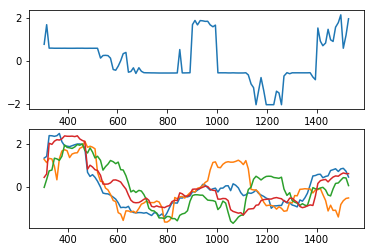

subject 04; gesture 3_0_1; avg 1.2475231213587528; sd 0.01575893556425077
subject 04; gesture 3_0_1; PoV: 0.9754576554483124


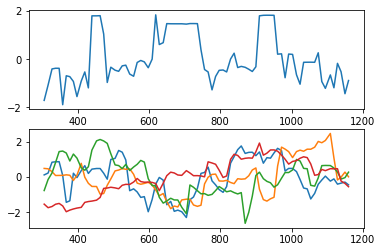

subject 04; gesture 4_1_1; avg 1.1283506326727302; sd 0.010127959498546042
subject 04; gesture 4_1_1; PoV: 0.9830779405749543


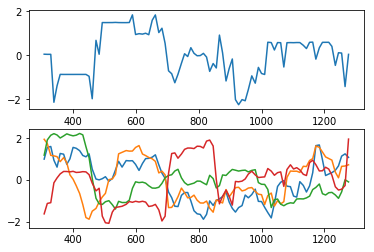

subject 04; gesture 2_0_1; avg 1.451598879397815; sd 0.013390160381020312
subject 04; gesture 2_0_1; PoV: 0.9850779747198285


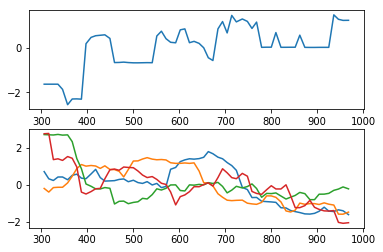

subject 04; gesture 4_1_2; avg 1.5628409305582804; sd 0.01153842072854843
subject 04; gesture 4_1_2; PoV: 0.9894725813480155


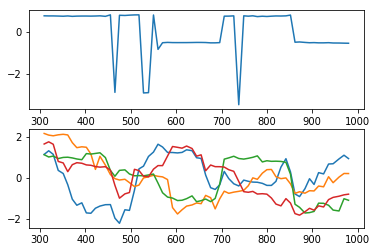

subject 04; gesture 2_0_2; avg 1.8238598223738602; sd 0.014955949127938645
subject 04; gesture 2_0_2; PoV: 0.9843657568548434


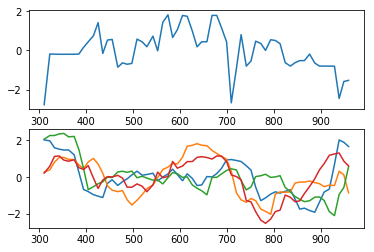

subject 04; gesture 1_1_2; avg 1.8263722255573829; sd 0.011604368051582055
subject 04; gesture 1_1_2; PoV: 0.9922148373213541


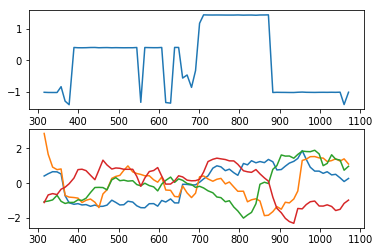

subject 04; gesture 2_1_2; avg 2.1936863207614596; sd 0.04129029110031938
subject 04; gesture 2_1_2; PoV: 0.976839597694478


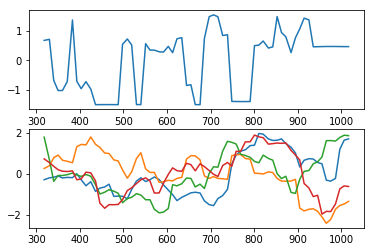

subject 04; gesture 4_0_1; avg 1.3908735093292572; sd 0.01940930339291685
subject 04; gesture 4_0_1; PoV: 0.9787958674989768


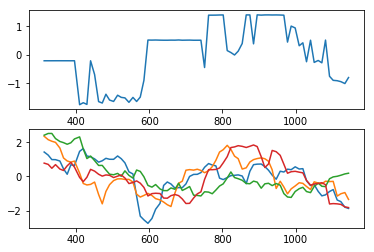

subject 04; gesture 3_0_2; avg 1.5254801607779849; sd 0.02152182661093419
subject 04; gesture 3_0_2; PoV: 0.978405204219268


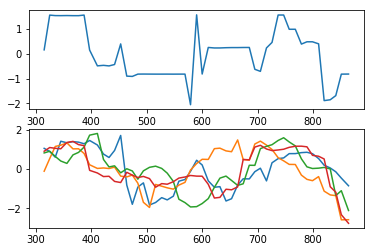

subject 04; gesture 1_1_1; avg 1.669013731546399; sd 0.019091973340617477
subject 04; gesture 1_1_1; PoV: 0.9829954939587272


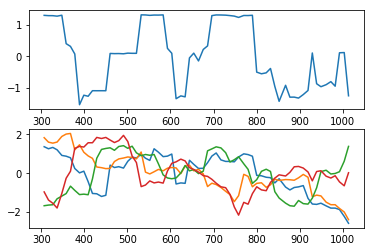

subject 04; gesture 3_1_2; avg 1.28610402953098; sd 0.01710959928201577
subject 04; gesture 3_1_2; PoV: 0.9778283712266188


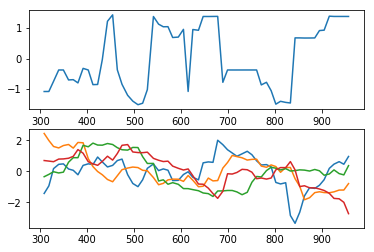

subject 04; gesture 2_1_1; avg 3.546624684144551; sd 0.06784946617079556
subject 04; gesture 2_1_1; PoV: 0.9823424214968284


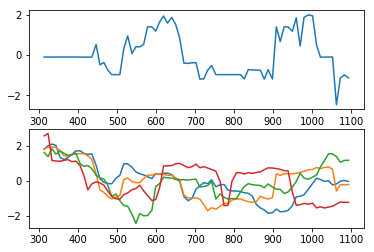

subject 04; gesture 1_0_1; avg 1.2251279219769755; sd 0.010544361511965155
subject 04; gesture 1_0_1; PoV: 0.985613279601156


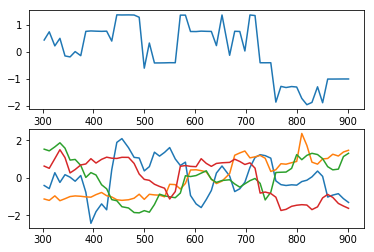

subject 04; gesture 3_1_1; avg 0.968190953375993; sd 0.009875935517128677
subject 04; gesture 3_1_1; PoV: 0.9802304184416668


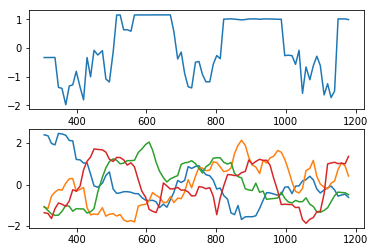

subject 04; gesture 1_0_2; avg 1.6047463905677062; sd 0.017544604706071307
subject 04; gesture 1_0_2; PoV: 0.9840071744784806


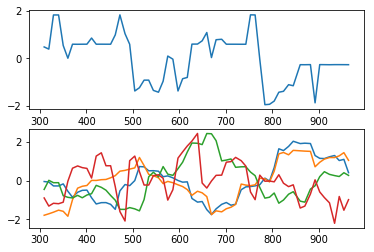

subject 04; gesture 4_0_2; avg 1.3632159475499979; sd 0.015403321409863516
subject 04; gesture 4_0_2; PoV: 0.9762665704895733


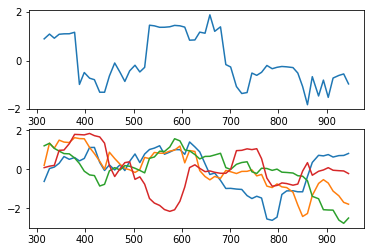

subject 08; gesture 3_0_1; avg 1.3189648726908685; sd 0.016574188575641184
subject 08; gesture 3_0_1; PoV: 0.9765908580005145


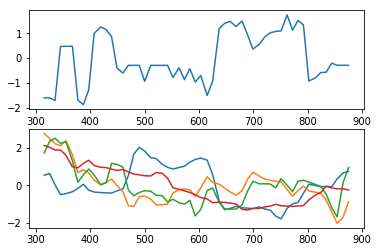

subject 08; gesture 4_1_1; avg 5.3443221248568165; sd 0.03872202900005637
subject 08; gesture 4_1_1; PoV: 0.9935207381968915


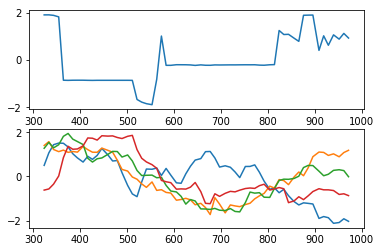

subject 08; gesture 2_0_1; avg 2.3399059477111646; sd 0.024428419014139693
subject 08; gesture 2_0_1; PoV: 0.9854399991111901


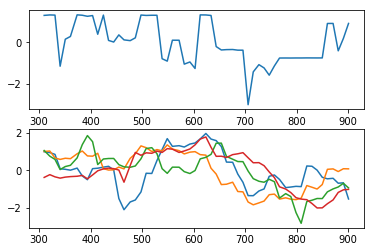

subject 08; gesture 4_1_2; avg 6.7480720894232995; sd 0.08032173517423846
subject 08; gesture 4_1_2; PoV: 0.9931206372540796


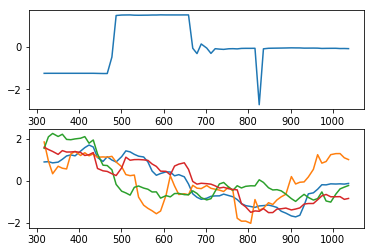

subject 08; gesture 2_0_2; avg 1.2490158949884835; sd 0.014812145135592751
subject 08; gesture 2_0_2; PoV: 0.9730366776281225


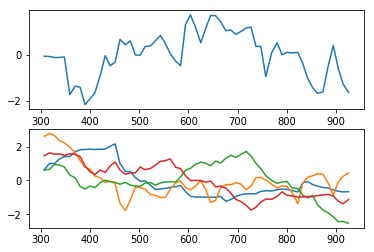

subject 08; gesture 1_1_2; avg 1.0971152229881775; sd 0.04210356377779076
subject 08; gesture 1_1_2; PoV: 0.9538927692359455


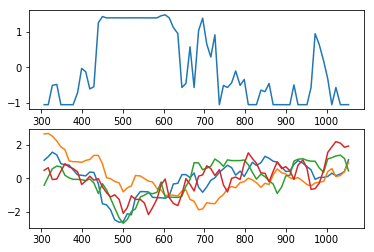

subject 08; gesture 2_1_2; avg 1.1844107027419541; sd 1.0186968471630462
subject 08; gesture 2_1_2; PoV: 0.5494407278210524


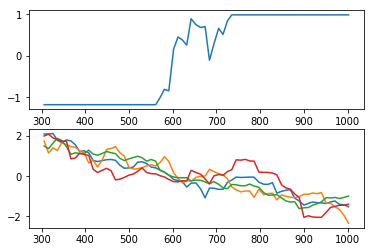

subject 08; gesture 4_0_1; avg 1.5515159839354464; sd 0.027974404728267493
subject 08; gesture 4_0_1; PoV: 0.9727885372652372


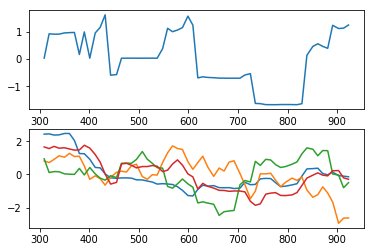

subject 08; gesture 3_0_2; avg 1.896618404604428; sd 0.02922151772622253
subject 08; gesture 3_0_2; PoV: 0.9806564542659773


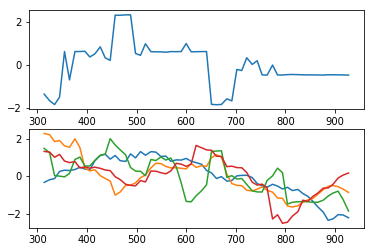

subject 08; gesture 1_1_1; avg 2.8004805801224797; sd 0.037789863242814276
subject 08; gesture 1_1_1; PoV: 0.9841207715288429


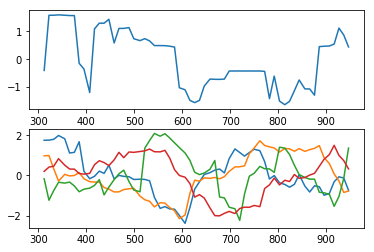

subject 08; gesture 3_1_2; avg 8.180721845490133; sd 0.03973769555191922
subject 08; gesture 3_1_2; PoV: 0.9958955048144327


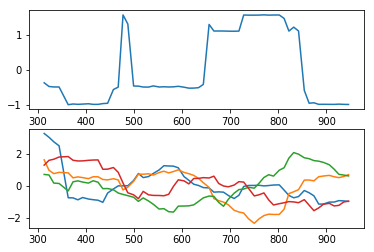

subject 08; gesture 2_1_1; avg 1.9056208576610503; sd 0.025839488750228207
subject 08; gesture 2_1_1; PoV: 0.9858109206919873


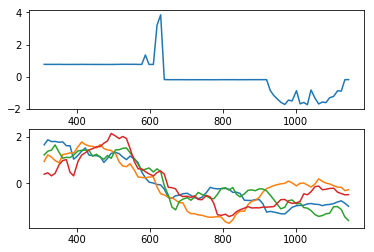

subject 08; gesture 1_0_1; avg 1.344608844610996; sd 0.0113705425741168
subject 08; gesture 1_0_1; PoV: 0.9868631728485006


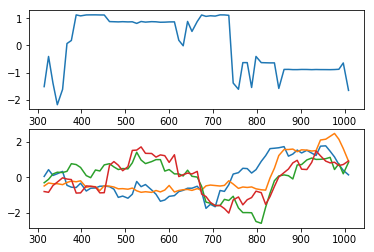

subject 08; gesture 3_1_1; avg 1.2533800087158822; sd 0.02061110190215083
subject 08; gesture 3_1_1; PoV: 0.977291029396935


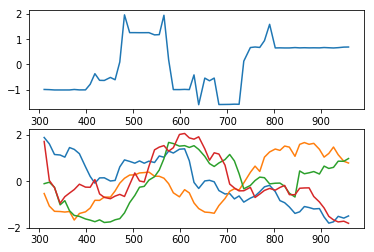

subject 08; gesture 1_0_2; avg 1.340729303643127; sd 0.010430520364640764
subject 08; gesture 1_0_2; PoV: 0.9851381365961215


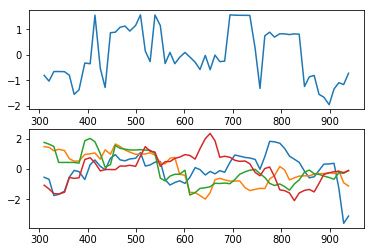

subject 08; gesture 4_0_2; avg 6.898775469779568; sd 0.06775990179649469
subject 08; gesture 4_0_2; PoV: 0.9900156345613462


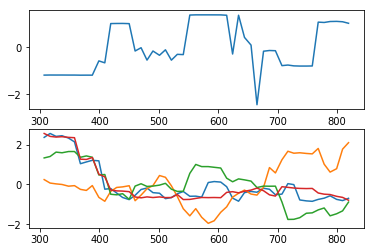

subject 27; gesture 3_0_1; avg 1.1254276935500844; sd 0.03617010971329254
subject 27; gesture 3_0_1; PoV: 0.9672432387714438


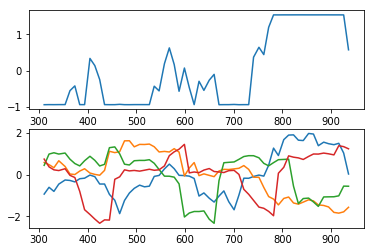

subject 27; gesture 4_1_1; avg 1.180875391915931; sd 0.011748858984260821
subject 27; gesture 4_1_1; PoV: 0.984173702481326


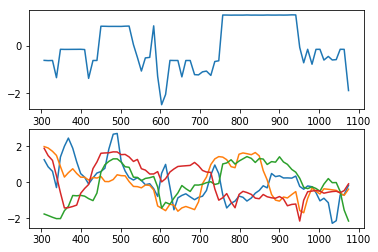

subject 27; gesture 2_0_1; avg 1.303231612281626; sd 0.015518691548534256
subject 27; gesture 2_0_1; PoV: 0.978217777461846


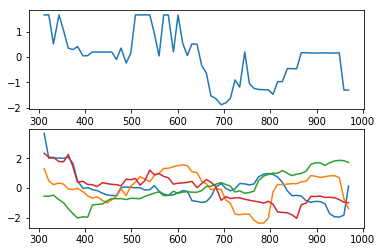

subject 27; gesture 4_1_2; avg 1.1226439476281513; sd 0.015240110751210716
subject 27; gesture 4_1_2; PoV: 0.9800299743881843


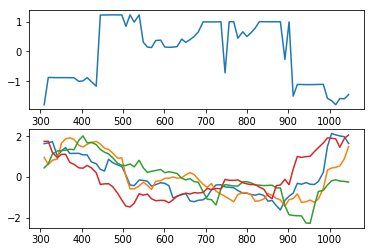

subject 27; gesture 2_0_2; avg 2.4586072864073505; sd 0.07394595694890879
subject 27; gesture 2_0_2; PoV: 0.9713992832197745


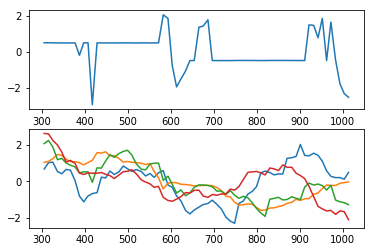

subject 27; gesture 1_1_2; avg 1.126182943588112; sd 0.013459596517640258
subject 27; gesture 1_1_2; PoV: 0.9780564238438576


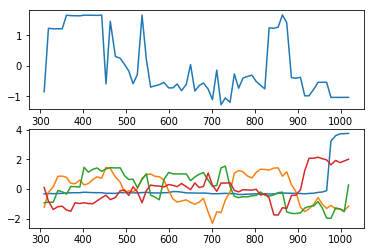

subject 27; gesture 2_1_2; avg 1.3494794616989008; sd 0.020654466528645502
subject 27; gesture 2_1_2; PoV: 0.9781751532125246


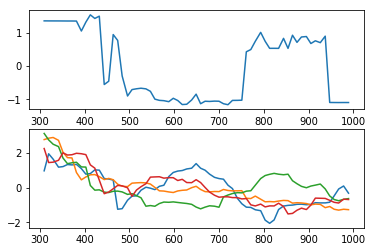

subject 27; gesture 4_0_1; avg 0.8996440451594848; sd 0.010988572721879053
subject 27; gesture 4_0_1; PoV: 0.9744966297381683


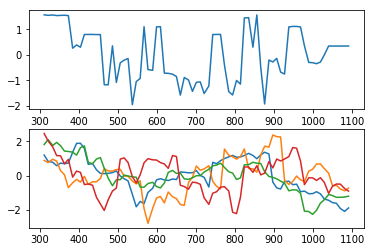

subject 27; gesture 3_0_2; avg 5.445702994776648; sd 0.030656058190883143
subject 27; gesture 3_0_2; PoV: 0.9964495188525465


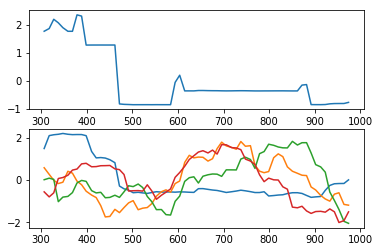

subject 27; gesture 1_1_1; avg 1.2399157651707915; sd 0.01144345465370362
subject 27; gesture 1_1_1; PoV: 0.986653281211109


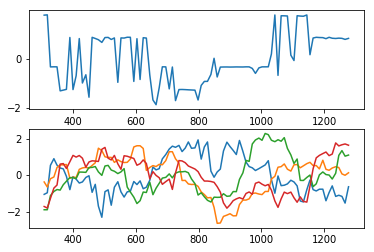

subject 27; gesture 3_1_2; avg 2.215942527372675; sd 0.02703011041381286
subject 27; gesture 3_1_2; PoV: 0.983105128703173


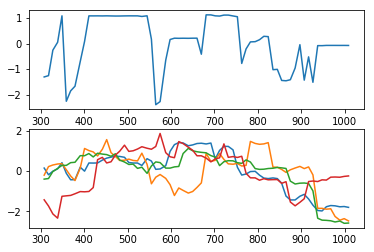

subject 27; gesture 2_1_1; avg 2.656169066614793; sd 0.04042502594721929
subject 27; gesture 2_1_1; PoV: 0.9841594829873358


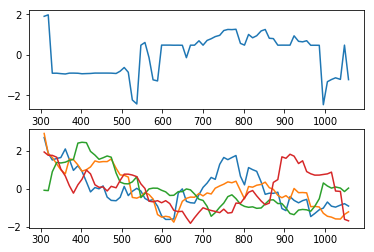

subject 27; gesture 1_0_1; avg 1.3424295068570546; sd 0.01848860313116265
subject 27; gesture 1_0_1; PoV: 0.9798803572229339


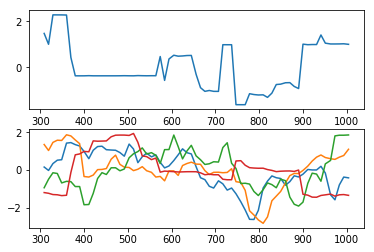

subject 27; gesture 3_1_1; avg 2.3354599321153944; sd 0.013502553461345252
subject 27; gesture 3_1_1; PoV: 0.9928953363570042


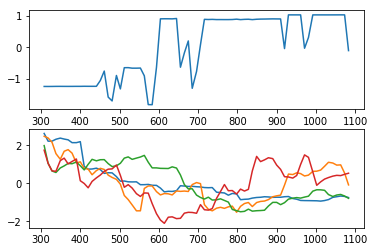

subject 27; gesture 1_0_2; avg 1.5854568727026586; sd 0.012352794367037429
subject 27; gesture 1_0_2; PoV: 0.9877548627674234


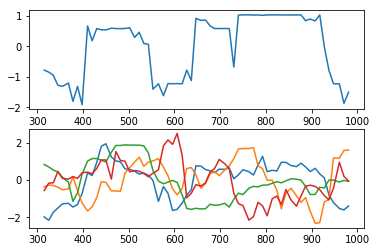

subject 27; gesture 4_0_2; avg 1.5641469950787634; sd 0.011270422179815562
subject 27; gesture 4_0_2; PoV: 0.989100645932502


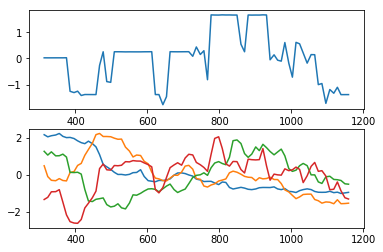

subject 14; gesture 3_0_1; avg 3.015160339976697; sd 0.023796867003747006
subject 14; gesture 3_0_1; PoV: 0.9919073985863837


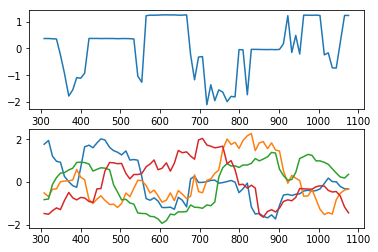

subject 14; gesture 4_1_1; avg 1.4455323011339485; sd 0.009448720040529025
subject 14; gesture 4_1_1; PoV: 0.9916715645928401


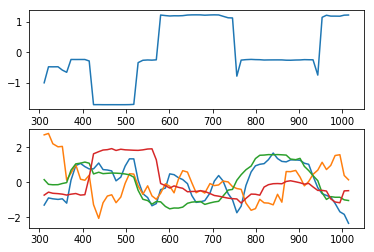

subject 14; gesture 2_0_1; avg 1.394167173162075; sd 0.011204009085484455
subject 14; gesture 2_0_1; PoV: 0.9890069646147129


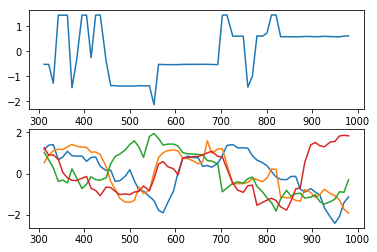

subject 14; gesture 4_1_2; avg 1.9509259974849604; sd 0.017893729466354747
subject 14; gesture 4_1_2; PoV: 0.9873484504535277


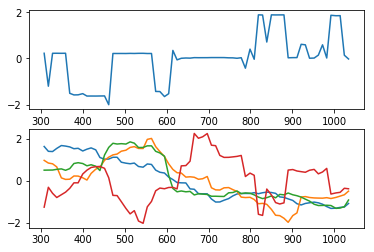

subject 14; gesture 2_0_2; avg 1.874346281000888; sd 0.014940958318158802
subject 14; gesture 2_0_2; PoV: 0.9875002164443875


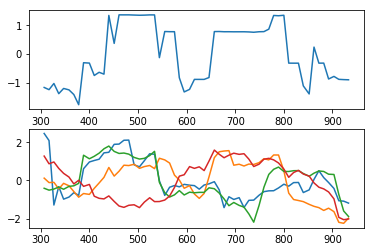

subject 14; gesture 1_1_2; avg 1.835245199225969; sd 0.019953454692435865
subject 14; gesture 1_1_2; PoV: 0.9814719782810846


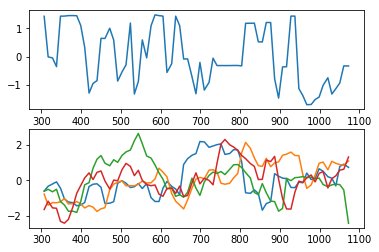

subject 14; gesture 2_1_2; avg 3.0276298429443504; sd 0.024998133430971126
subject 14; gesture 2_1_2; PoV: 0.9916443019378711


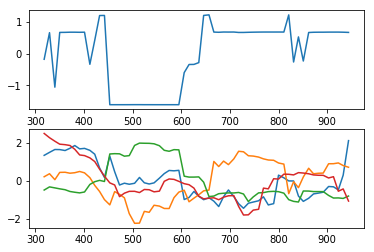

subject 14; gesture 4_0_1; avg 1.282146590038994; sd 0.025088953464401615
subject 14; gesture 4_0_1; PoV: 0.9674164240662895


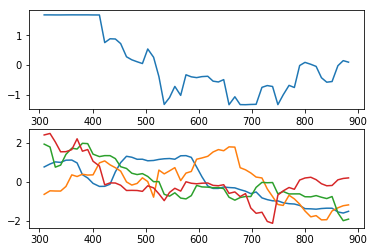

subject 14; gesture 3_0_2; avg 1.543875199046786; sd 0.011242548944819233
subject 14; gesture 3_0_2; PoV: 0.9917039415766895


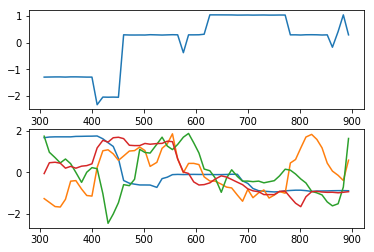

subject 14; gesture 1_1_1; avg 2.2322255299310494; sd 0.03137474717327167
subject 14; gesture 1_1_1; PoV: 0.9801915029373843


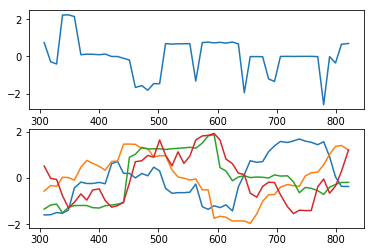

subject 14; gesture 3_1_2; avg 2.700049994671378; sd 0.013936120583328207
subject 14; gesture 3_1_2; PoV: 0.9928680088817776


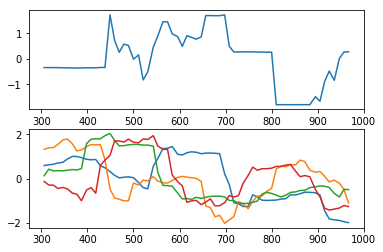

subject 14; gesture 2_1_1; avg 1.6899359888322287; sd 0.010860179862146374
subject 14; gesture 2_1_1; PoV: 0.9909679710510539


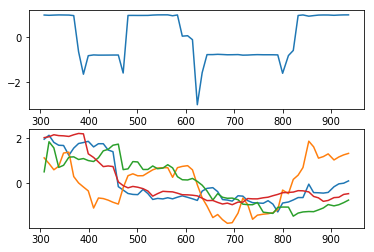

subject 14; gesture 1_0_1; avg 1.037094316565872; sd 0.028646680117296302
subject 14; gesture 1_0_1; PoV: 0.961746385728818


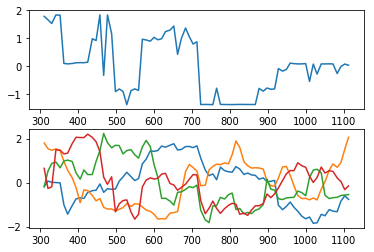

subject 14; gesture 3_1_1; avg 1.9731347510804556; sd 0.02785664495991645
subject 14; gesture 3_1_1; PoV: 0.9787055700915569


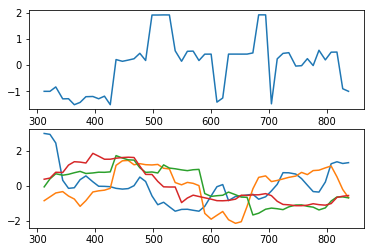

subject 14; gesture 1_0_2; avg 1.136961632562281; sd 0.012139524758010469
subject 14; gesture 1_0_2; PoV: 0.9856688075613499


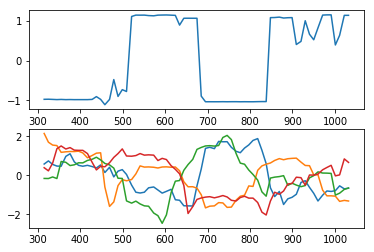

subject 14; gesture 4_0_2; avg 2.3870843048804784; sd 0.012268442382447212
subject 14; gesture 4_0_2; PoV: 0.9921730903486683


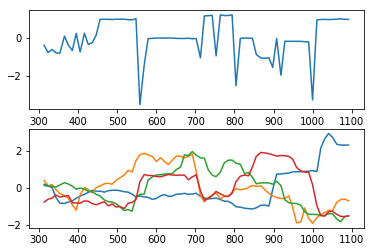

subject 23; gesture 3_0_1; avg 1.1811267080733538; sd 0.01256448376781004
subject 23; gesture 3_0_1; PoV: 0.9792904463470286


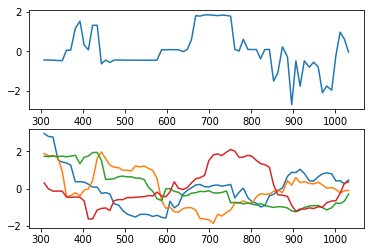

subject 23; gesture 4_1_1; avg 0.8317305218950813; sd 0.012869446415463849
subject 23; gesture 4_1_1; PoV: 0.9736395555521532


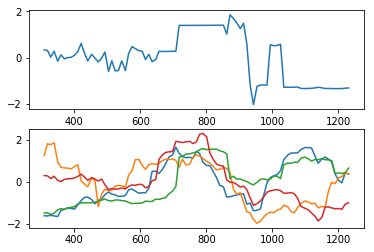

subject 23; gesture 2_0_1; avg 1.2660204998774922; sd 0.013465638589167824
subject 23; gesture 2_0_1; PoV: 0.9856989973163044


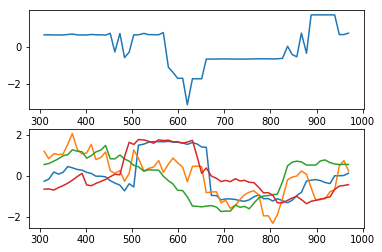

subject 23; gesture 4_1_2; avg 1.1312440252930147; sd 0.010760362730070189
subject 23; gesture 4_1_2; PoV: 0.98503541103943


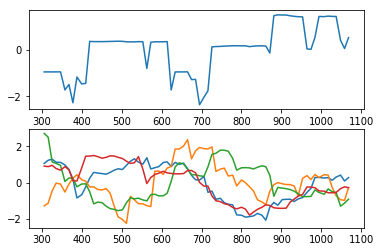

subject 23; gesture 2_0_2; avg 1.2409890447624168; sd 0.014642366892180347
subject 23; gesture 2_0_2; PoV: 0.9810442736664634


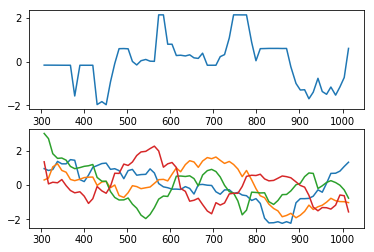

subject 23; gesture 1_1_2; avg 2.156422569343478; sd 0.016906296510543328
subject 23; gesture 1_1_2; PoV: 0.9893622558403941


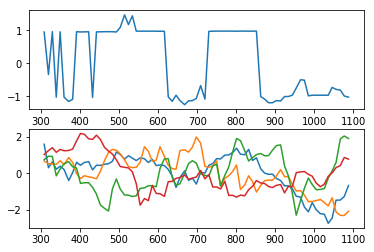

subject 23; gesture 2_1_2; avg 1.6441310645362932; sd 0.015762024110460335
subject 23; gesture 2_1_2; PoV: 0.9890830032449658


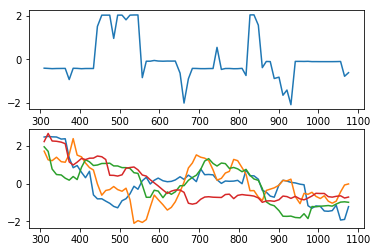

subject 23; gesture 4_0_1; avg 1.041554379609489; sd 0.020007161976187866
subject 23; gesture 4_0_1; PoV: 0.9713767924397506


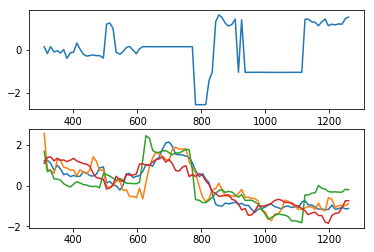

subject 23; gesture 3_0_2; avg 1.337683710353113; sd 0.02649699449569867
subject 23; gesture 3_0_2; PoV: 0.9699442283609725


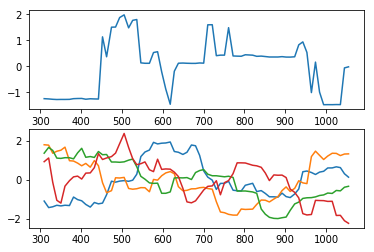

subject 23; gesture 1_1_1; avg 1.2516869928647358; sd 0.011041628684955536
subject 23; gesture 1_1_1; PoV: 0.9819162433986391


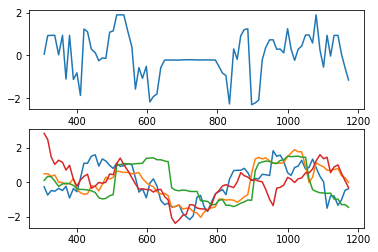

subject 23; gesture 3_1_2; avg 1.944470282593201; sd 0.012461019214164887
subject 23; gesture 3_1_2; PoV: 0.9895165426657166


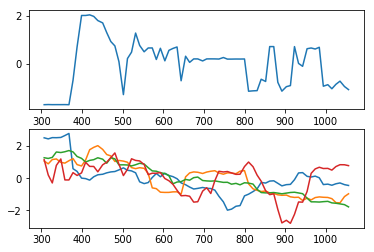

subject 23; gesture 2_1_1; avg 1.2156314302588869; sd 0.01148404084792416
subject 23; gesture 2_1_1; PoV: 0.9852359242136848


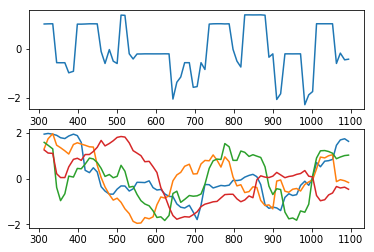

subject 23; gesture 1_0_1; avg 0.9945344885377971; sd 0.010221074938979507
subject 23; gesture 1_0_1; PoV: 0.9833961538395528


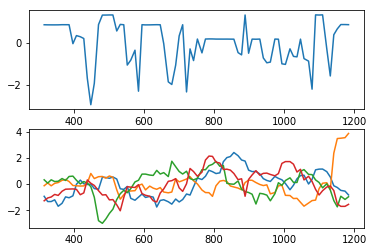

subject 23; gesture 3_1_1; avg 4.811752983716506; sd 0.030053593417846563
subject 23; gesture 3_1_1; PoV: 0.9934608599992822


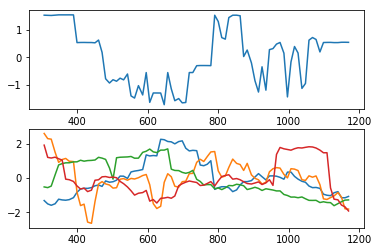

subject 23; gesture 1_0_2; avg 1.7607463654897104; sd 0.017658323691434188
subject 23; gesture 1_0_2; PoV: 0.9873947057017938


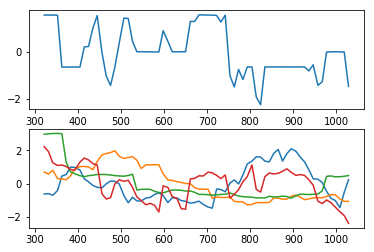

subject 23; gesture 4_0_2; avg 1.0010071340650455; sd 0.008558095012436293
subject 23; gesture 4_0_2; PoV: 0.9860796801048438


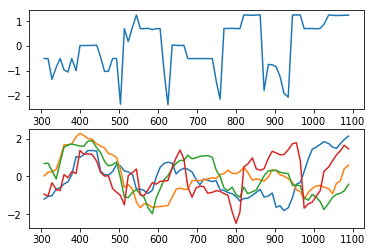

subject 25; gesture 3_0_1; avg 1.0082641447337581; sd 0.010008681893591116
subject 25; gesture 3_0_1; PoV: 0.9821535955112318


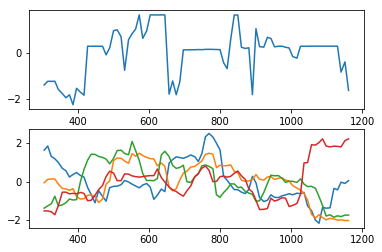

subject 25; gesture 4_1_1; avg 1.3053978178205214; sd 0.020034491175052516
subject 25; gesture 4_1_1; PoV: 0.9816567544541429


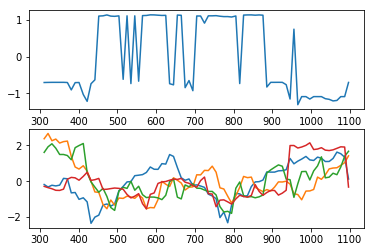

subject 25; gesture 2_0_1; avg 1.0565305671298975; sd 0.015544758866711725
subject 25; gesture 2_0_1; PoV: 0.9740734277374812


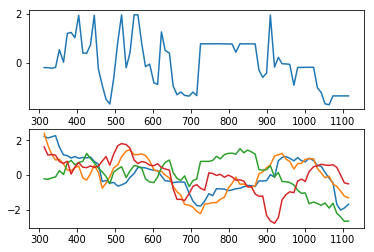

subject 25; gesture 4_1_2; avg 2.130735687455541; sd 0.03371260069961418
subject 25; gesture 4_1_2; PoV: 0.9786480986418389


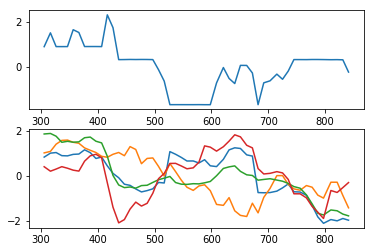

subject 25; gesture 2_0_2; avg 2.0042406939996775; sd 0.031179154598486903
subject 25; gesture 2_0_2; PoV: 0.9784162403644308


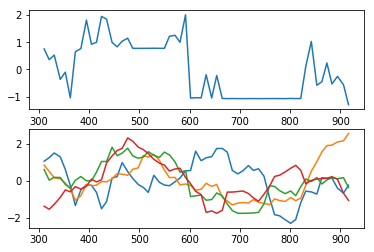

subject 25; gesture 1_1_2; avg 1.3568630448130954; sd 0.01044335390268995
subject 25; gesture 1_1_2; PoV: 0.9891338939502287


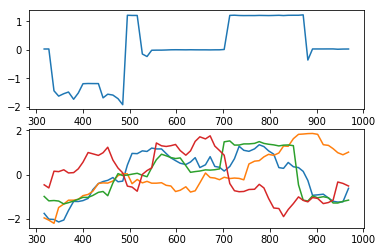

subject 25; gesture 2_1_2; avg 2.17741972072137; sd 0.05582551195900646
subject 25; gesture 2_1_2; PoV: 0.9737453189250728


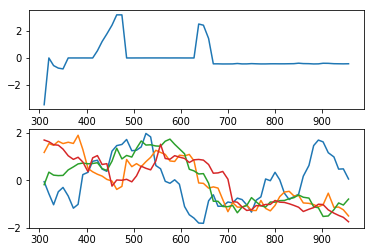

subject 25; gesture 4_0_1; avg 1.2626362910173374; sd 0.037733082006752676
subject 25; gesture 4_0_1; PoV: 0.9653573306616753


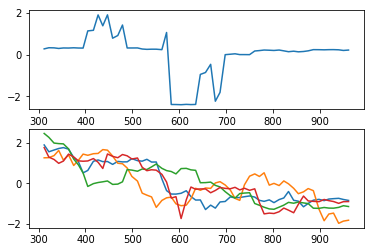

subject 25; gesture 3_0_2; avg 2.3279624054383703; sd 0.027697728401112235
subject 25; gesture 3_0_2; PoV: 0.9844462853062717


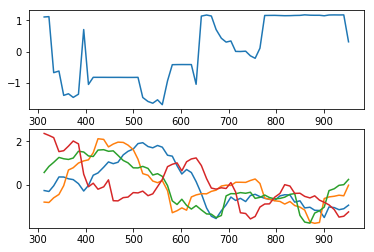

subject 25; gesture 1_1_1; avg 0.7971493314638288; sd 0.005922840841560243
subject 25; gesture 1_1_1; PoV: 0.9842833013189777


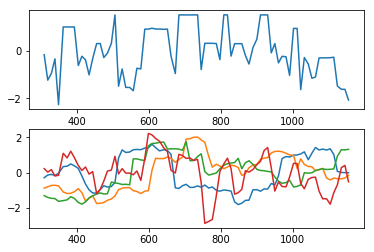

subject 25; gesture 3_1_2; avg 2.4889091086232553; sd 0.017370564404393565
subject 25; gesture 3_1_2; PoV: 0.9905598352165773


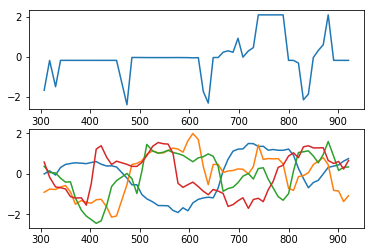

subject 25; gesture 2_1_1; avg 1.311227491752154; sd 0.019279440862454086
subject 25; gesture 2_1_1; PoV: 0.9768231816653802


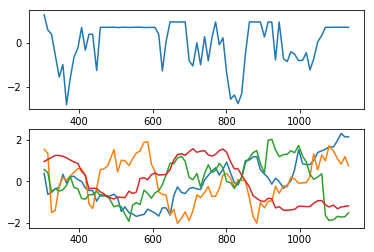

subject 25; gesture 1_0_1; avg 1.3033983843610417; sd 0.01033887455354202
subject 25; gesture 1_0_1; PoV: 0.9862331654398123


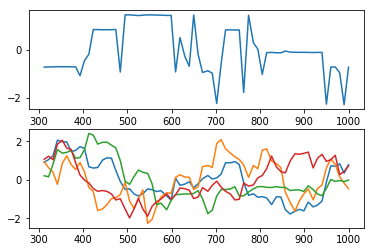

subject 25; gesture 3_1_1; avg 3.077142459821065; sd 0.012509057689840298
subject 25; gesture 3_1_1; PoV: 0.9953192919542166


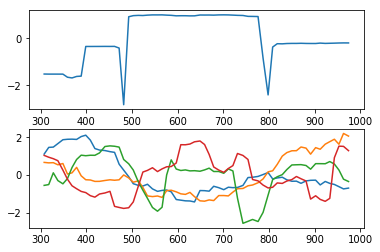

subject 25; gesture 1_0_2; avg 1.3260970966723309; sd 0.01875671954007544
subject 25; gesture 1_0_2; PoV: 0.9791314140011528


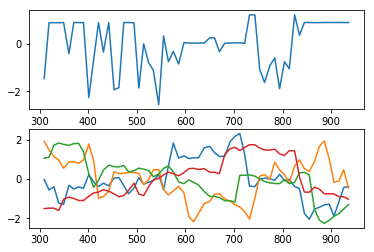

subject 25; gesture 4_0_2; avg 1.3483456833495946; sd 0.016307900310985623
subject 25; gesture 4_0_2; PoV: 0.9811008792152627


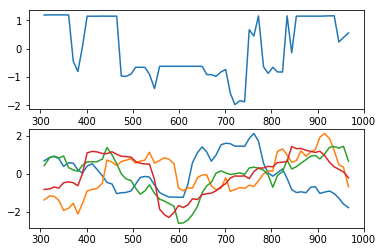

subject 18; gesture 3_0_1; avg 2.8790586514389287; sd 0.021934144397123975
subject 18; gesture 3_0_1; PoV: 0.9900131769458551


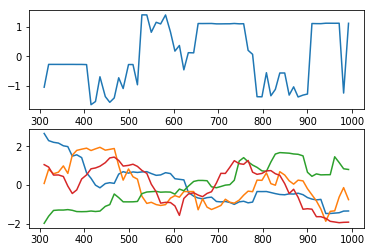

subject 18; gesture 4_1_1; avg 1.1006815856762697; sd 0.011663671808713678
subject 18; gesture 4_1_1; PoV: 0.9844174993696907


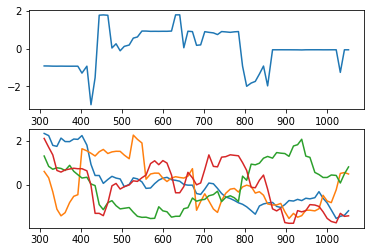

subject 18; gesture 2_0_1; avg 3.8680881127515767; sd 0.04906566652436697
subject 18; gesture 2_0_1; PoV: 0.9886218056079104


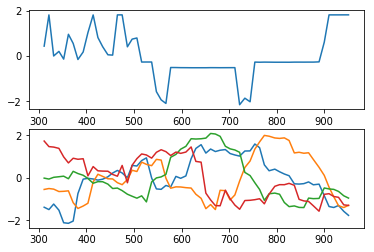

subject 18; gesture 4_1_2; avg 3.460547991691147; sd 0.030780884020530416
subject 18; gesture 4_1_2; PoV: 0.9886804361904886


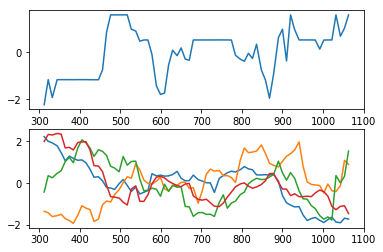

subject 18; gesture 2_0_2; avg 1.8009488196489403; sd 0.00969528578404222
subject 18; gesture 2_0_2; PoV: 0.9907391379569928


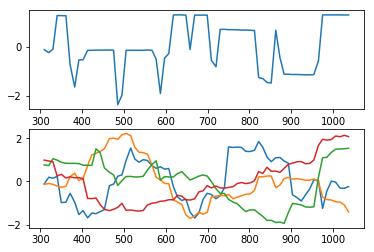

subject 18; gesture 1_1_2; avg 0.9780570165155477; sd 0.013156757007657224
subject 18; gesture 1_1_2; PoV: 0.9708690982968361


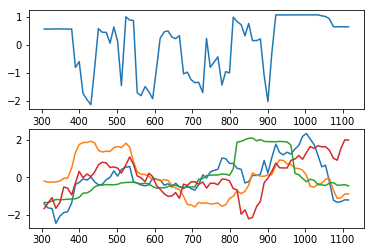

subject 18; gesture 2_1_2; avg 2.288322280196783; sd 0.13068479062894103
subject 18; gesture 2_1_2; PoV: 0.947773507671738


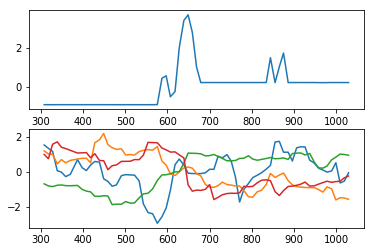

subject 18; gesture 4_0_1; avg 1.0914804858246365; sd 0.01131773245037146
subject 18; gesture 4_0_1; PoV: 0.9788828386004557


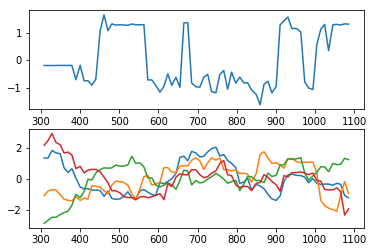

subject 18; gesture 3_0_2; avg 1.8259995662716817; sd 0.19727675717845014
subject 18; gesture 3_0_2; PoV: 0.9197367675897739


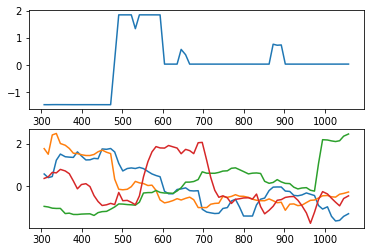

subject 18; gesture 1_1_1; avg 1.4297748226849996; sd 0.013876096620034363
subject 18; gesture 1_1_1; PoV: 0.9811206417821338


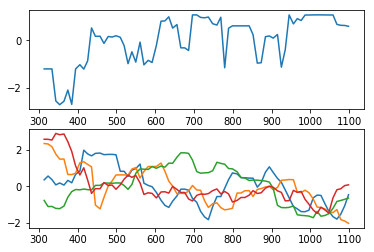

subject 18; gesture 3_1_2; avg 0.8441161473026868; sd 0.008659998040634935
subject 18; gesture 3_1_2; PoV: 0.9830257292456047


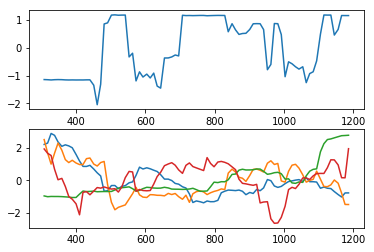

subject 18; gesture 2_1_1; avg 1.1893267955486673; sd 0.013485538705542047
subject 18; gesture 2_1_1; PoV: 0.984690582757124


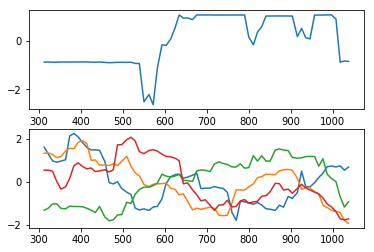

subject 18; gesture 1_0_1; avg 3.2618304831042577; sd 0.1095691119273117
subject 18; gesture 1_0_1; PoV: 0.9698408693427154


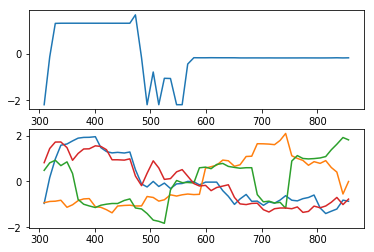

subject 18; gesture 3_1_1; avg 1.2261261169866549; sd 0.015056564274411963
subject 18; gesture 3_1_1; PoV: 0.9848990678998991


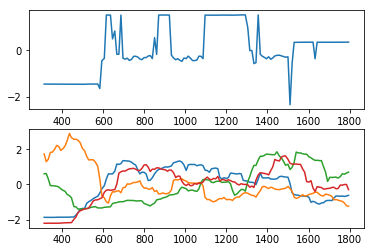

subject 18; gesture 1_0_2; avg 1.2274526898194549; sd 0.01756516583159271
subject 18; gesture 1_0_2; PoV: 0.9806782209140226


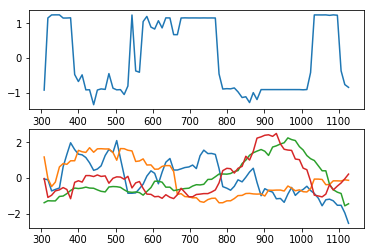

subject 18; gesture 4_0_2; avg 1.8131784810411862; sd 0.012070082882512793
subject 18; gesture 4_0_2; PoV: 0.9896163036051818


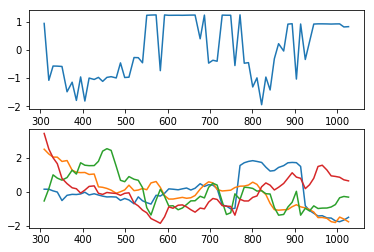

subject 29; gesture 3_0_1; avg 1.0138876060039737; sd 0.007456481755435312
subject 29; gesture 3_0_1; PoV: 0.9871629973586044


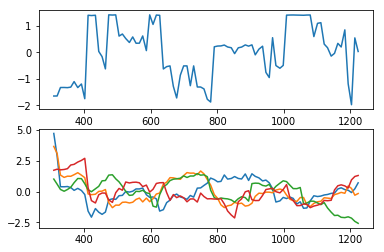

subject 29; gesture 4_1_1; avg 3.194505632676278; sd 0.0346304560691445
subject 29; gesture 4_1_1; PoV: 0.9877582506133425


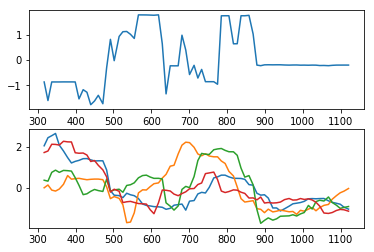

subject 29; gesture 2_0_1; avg 1.8595660655243915; sd 0.05692301024118329
subject 29; gesture 2_0_1; PoV: 0.9659197512815122


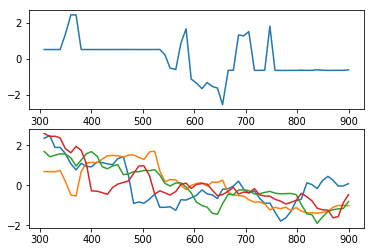

subject 29; gesture 4_1_2; avg 0.9387565570257795; sd 0.012589192888219329
subject 29; gesture 4_1_2; PoV: 0.9801935388126382


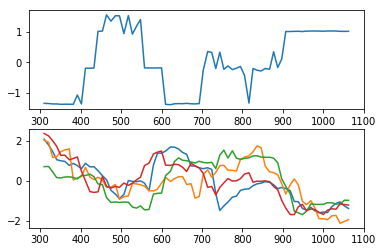

subject 29; gesture 2_0_2; avg 1.6765715979217533; sd 0.010602696400615555
subject 29; gesture 2_0_2; PoV: 0.9886692113064857


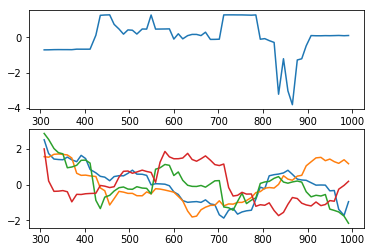

subject 29; gesture 1_1_2; avg 1.154573506559556; sd 0.014474926821804094
subject 29; gesture 1_1_2; PoV: 0.979818063511705


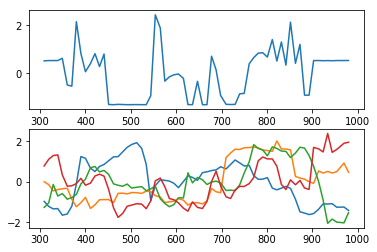

subject 29; gesture 2_1_2; avg 1.393469157678554; sd 0.09475865364769304
subject 29; gesture 2_1_2; PoV: 0.9258854966729999


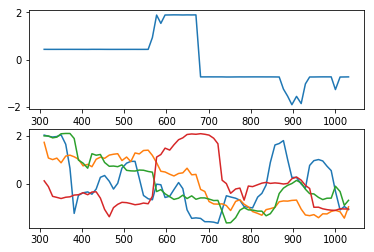

subject 29; gesture 4_0_1; avg 2.85550905317657; sd 0.028501866048657298
subject 29; gesture 4_0_1; PoV: 0.9848326242981589


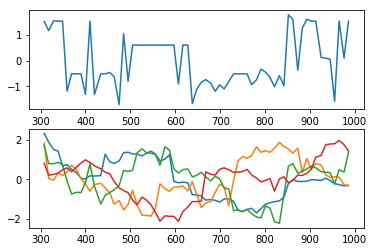

subject 29; gesture 3_0_2; avg 1.1216610733100276; sd 0.011935761909916551
subject 29; gesture 3_0_2; PoV: 0.9823593186847325


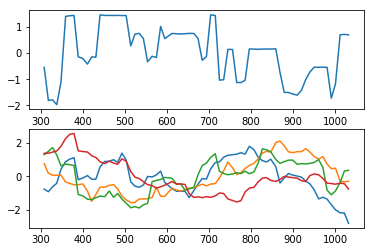

subject 29; gesture 1_1_1; avg 1.3835434355686345; sd 0.049318575116407665
subject 29; gesture 1_1_1; PoV: 0.9592014133991257


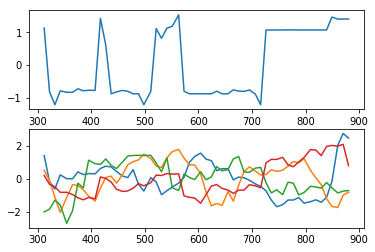

subject 29; gesture 3_1_2; avg 2.3051911331438286; sd 0.034869863824429956
subject 29; gesture 3_1_2; PoV: 0.9833869418780353


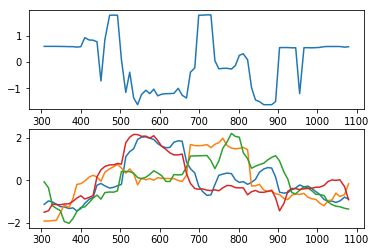

subject 29; gesture 2_1_1; avg 1.2517849053180188; sd 0.012566469076567369
subject 29; gesture 2_1_1; PoV: 0.9844240339497


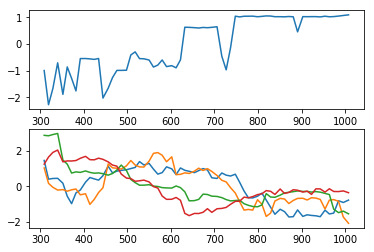

subject 29; gesture 1_0_1; avg 1.6008020658174884; sd 0.01445153064054686
subject 29; gesture 1_0_1; PoV: 0.9827419393279386


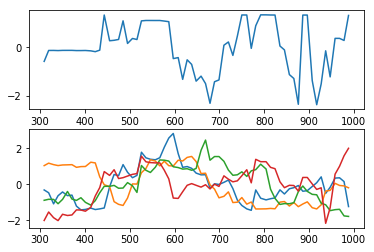

subject 29; gesture 3_1_1; avg 1.4371761238909324; sd 0.012119502510614067
subject 29; gesture 3_1_1; PoV: 0.9889043548410952


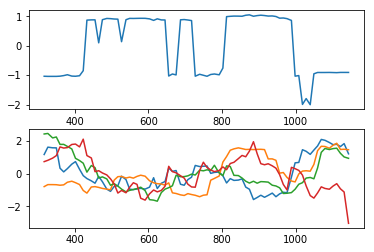

subject 29; gesture 1_0_2; avg 1.5925248689428328; sd 0.011273135194322485
subject 29; gesture 1_0_2; PoV: 0.9867910161399128


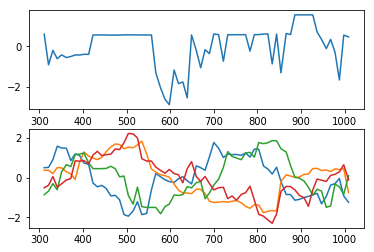

subject 29; gesture 4_0_2; avg 1.5229469791897385; sd 0.02661210735042218
subject 29; gesture 4_0_2; PoV: 0.9776498577532107


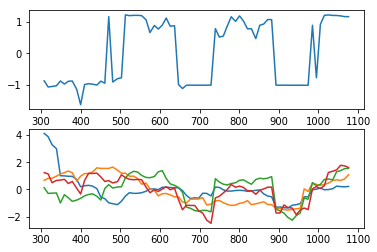

subject 15; gesture 3_0_1; avg 1.5916166876867976; sd 0.011913856325457094
subject 15; gesture 3_0_1; PoV: 0.9881042593958361


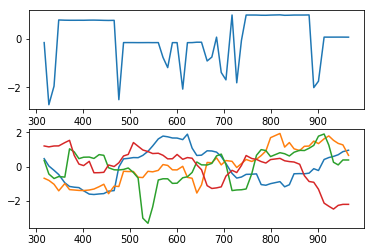

subject 15; gesture 4_1_1; avg 2.161386438255011; sd 0.03998448242013859
subject 15; gesture 4_1_1; PoV: 0.9804747411471241


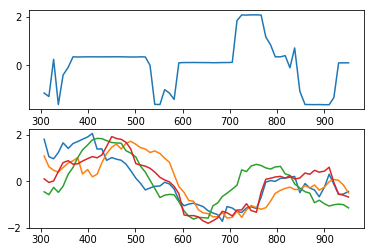

subject 15; gesture 2_0_1; avg 1.4633062939240937; sd 1.2771781580146135
subject 15; gesture 2_0_1; PoV: 0.5508195530989655


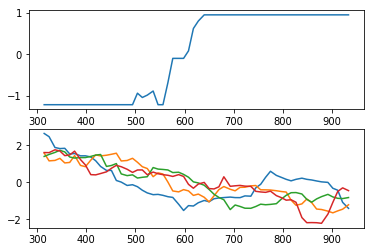

subject 15; gesture 4_1_2; avg 0.9990657510891213; sd 0.015519589572527503
subject 15; gesture 4_1_2; PoV: 0.9731398747362252


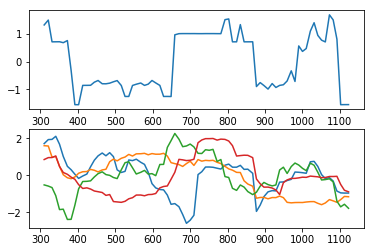

subject 15; gesture 2_0_2; avg 1.2729982925948127; sd 0.01276949744673334
subject 15; gesture 2_0_2; PoV: 0.9839514703889913


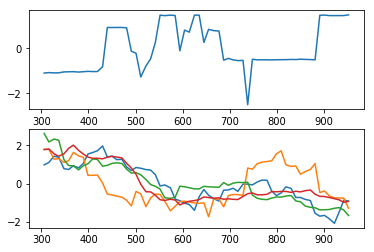

subject 15; gesture 1_1_2; avg 1.1224302008888694; sd 0.01520733426341526
subject 15; gesture 1_1_2; PoV: 0.9733604272129582


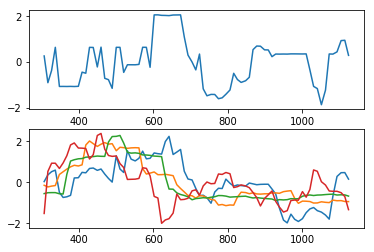

subject 15; gesture 2_1_2; avg 1.5058023574611228; sd 0.023343718290706354
subject 15; gesture 2_1_2; PoV: 0.9719596112251297


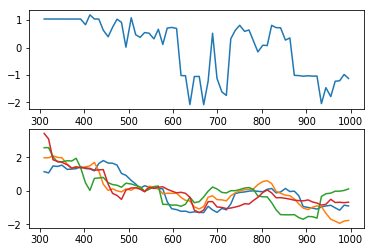

subject 15; gesture 4_0_1; avg 4.8725445790592605; sd 0.04573188772010499
subject 15; gesture 4_0_1; PoV: 0.9901441546450527


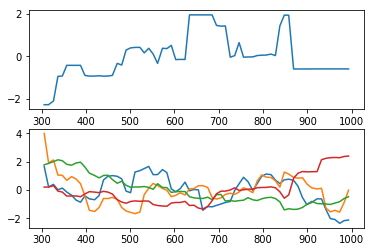

subject 15; gesture 3_0_2; avg 1.1136973090862836; sd 0.015091442986404708
subject 15; gesture 3_0_2; PoV: 0.9734915917766419


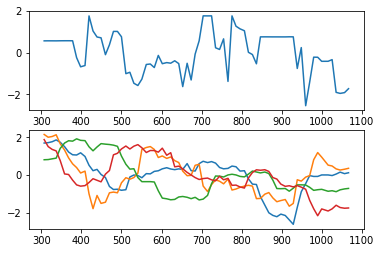

subject 15; gesture 1_1_1; avg 3.7769190657939165; sd 0.033146475075370156
subject 15; gesture 1_1_1; PoV: 0.9930318054916333


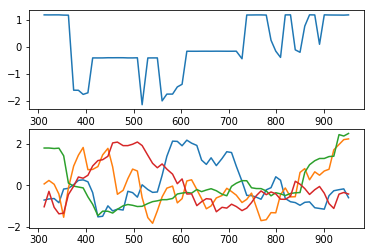

subject 15; gesture 3_1_2; avg 1.0969081455417764; sd 0.011870388027592067
subject 15; gesture 3_1_2; PoV: 0.97888015129367


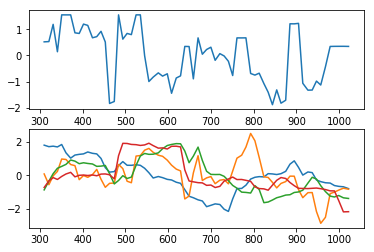

subject 15; gesture 2_1_1; avg 1.4564588920097448; sd 0.011913401211368534
subject 15; gesture 2_1_1; PoV: 0.9878484555748219


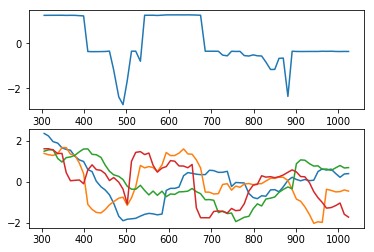

subject 15; gesture 1_0_1; avg 2.0104237749662706; sd 0.01073189512165142
subject 15; gesture 1_0_1; PoV: 0.992780434404233


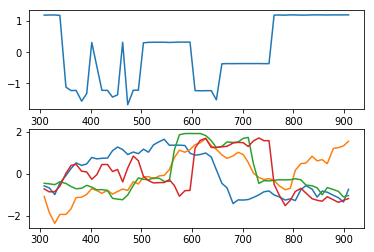

subject 15; gesture 3_1_1; avg 1.476027841215094; sd 0.014559622422580071
subject 15; gesture 3_1_1; PoV: 0.9777601743886192


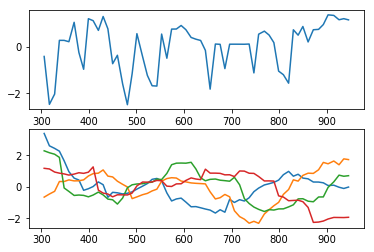

subject 15; gesture 1_0_2; avg 1.5867986021490363; sd 0.016149844482553247
subject 15; gesture 1_0_2; PoV: 0.980590329463445


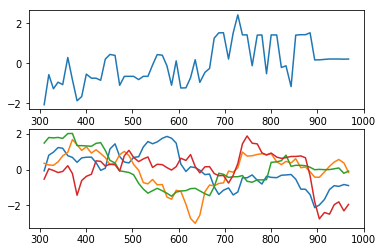

subject 15; gesture 4_0_2; avg 1.24996621939432; sd 0.023403595402485024
subject 15; gesture 4_0_2; PoV: 0.9726031516601034


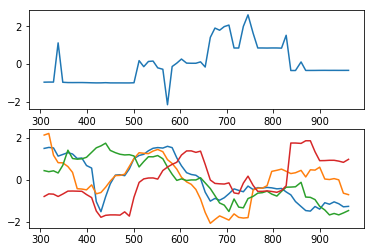

subject 28; gesture 3_0_1; avg 2.2136380597028484; sd 0.010165567950456594
subject 28; gesture 3_0_1; PoV: 0.9943376999179452


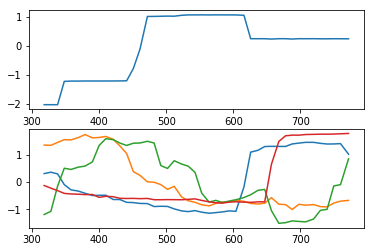

subject 28; gesture 4_1_1; avg 1.417741087536424; sd 0.020359497379374886
subject 28; gesture 4_1_1; PoV: 0.9790721597996136


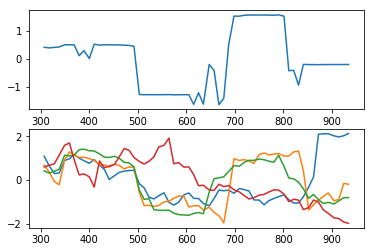

subject 28; gesture 2_0_1; avg 4.159070027263813; sd 0.044479184564918534
subject 28; gesture 2_0_1; PoV: 0.9909520913593312


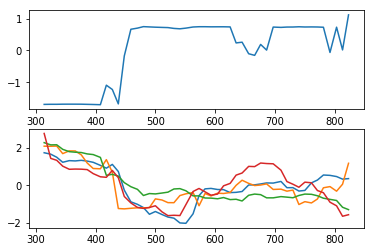

subject 28; gesture 4_1_2; avg 6.143283867926749; sd 0.03158151090351103
subject 28; gesture 4_1_2; PoV: 0.994912936088035


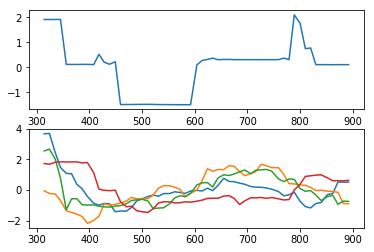

subject 28; gesture 2_0_2; avg 1.4090472958652789; sd 0.01228124085400459
subject 28; gesture 2_0_2; PoV: 0.9822482065713698


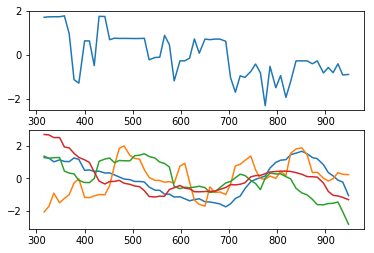

subject 28; gesture 1_1_2; avg 1.527075590867431; sd 0.01262917328442422
subject 28; gesture 1_1_2; PoV: 0.9837838348775896


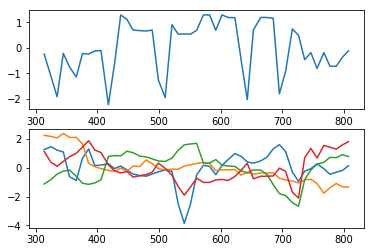

subject 28; gesture 2_1_2; avg 1.265551588949324; sd 0.014385699536189801
subject 28; gesture 2_1_2; PoV: 0.9808728103530489


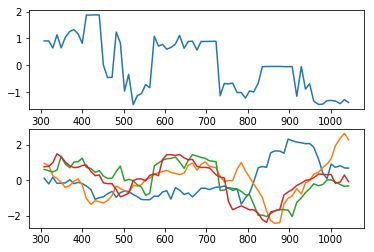

subject 28; gesture 4_0_1; avg 2.17518177778302; sd 0.018053066947666358
subject 28; gesture 4_0_1; PoV: 0.9864731812372216


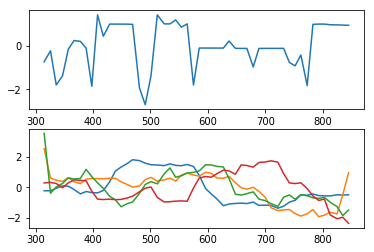

subject 28; gesture 3_0_2; avg 1.1413826887392358; sd 0.010227106980875584
subject 28; gesture 3_0_2; PoV: 0.9823736566060595


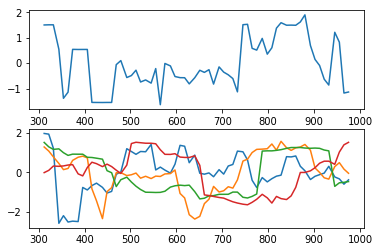

subject 28; gesture 1_1_1; avg 3.0501709606883436; sd 0.02029589494153204
subject 28; gesture 1_1_1; PoV: 0.9916085638432294


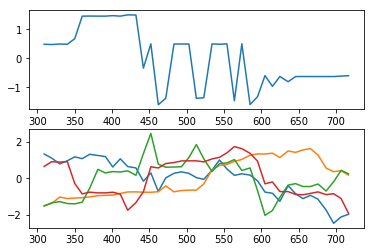

subject 28; gesture 3_1_2; avg 4.149935860187767; sd 0.040365416917657326
subject 28; gesture 3_1_2; PoV: 0.9912979498233285


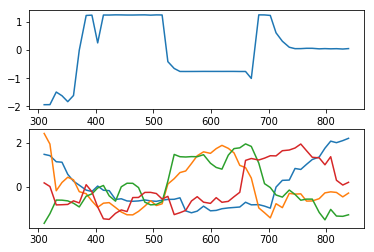

subject 28; gesture 2_1_1; avg 2.210351263864308; sd 0.03667292366478712
subject 28; gesture 2_1_1; PoV: 0.9796579896824702


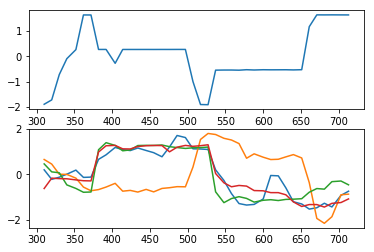

subject 28; gesture 1_0_1; avg 1.6799101530452552; sd 0.013244742417056494
subject 28; gesture 1_0_1; PoV: 0.9879781184065574


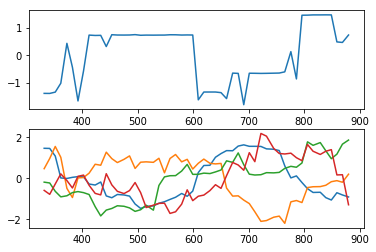

subject 28; gesture 3_1_1; avg 2.225317075439661; sd 0.18727720556975072
subject 28; gesture 3_1_1; PoV: 0.9246682735776843


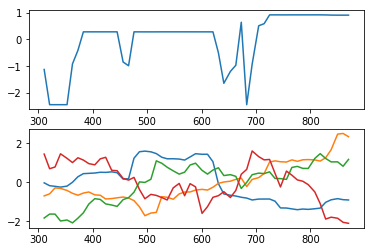

subject 28; gesture 1_0_2; avg 1.1952256969587678; sd 0.01252080694802006
subject 28; gesture 1_0_2; PoV: 0.9813550538331607


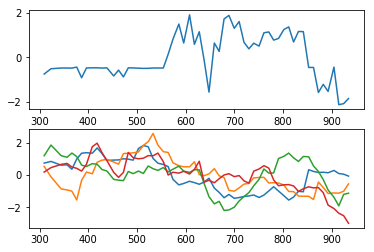

subject 28; gesture 4_0_2; avg 2.8039297066196966; sd 0.01257125864582723
subject 28; gesture 4_0_2; PoV: 0.9943648625107246


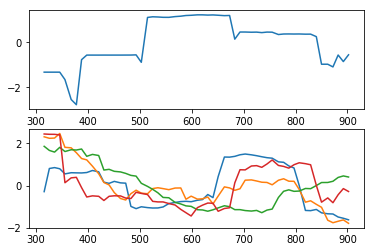

subject 12; gesture 3_0_1; avg 1.1509801194163947; sd 0.017612828920195864
subject 12; gesture 3_0_1; PoV: 0.9778618836819797


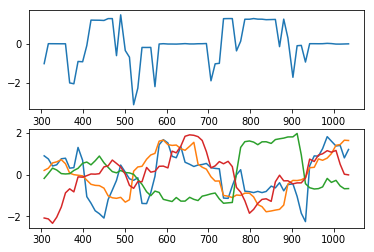

subject 12; gesture 4_1_1; avg 1.1100898506318324; sd 0.028682943248958717
subject 12; gesture 4_1_1; PoV: 0.9650671676302535


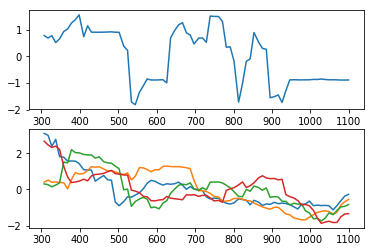

subject 12; gesture 2_0_1; avg 2.290691302947532; sd 0.026860975511299984
subject 12; gesture 2_0_1; PoV: 0.9870141614893267


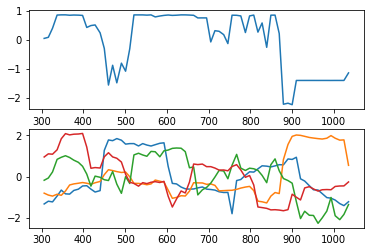

subject 12; gesture 4_1_2; avg 1.0141335756498595; sd 0.014218025268623749
subject 12; gesture 4_1_2; PoV: 0.9804392332491638


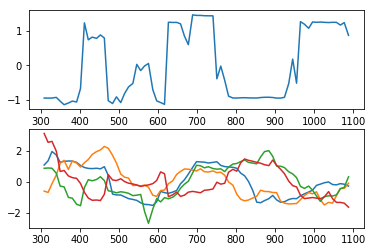

subject 12; gesture 2_0_2; avg 1.3827196961115822; sd 0.01835249483677757
subject 12; gesture 2_0_2; PoV: 0.982569530290365


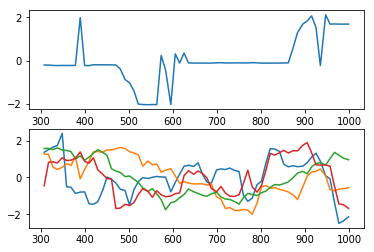

subject 12; gesture 1_1_2; avg 1.037168970452943; sd 0.01479703683411829
subject 12; gesture 1_1_2; PoV: 0.9769541701187814


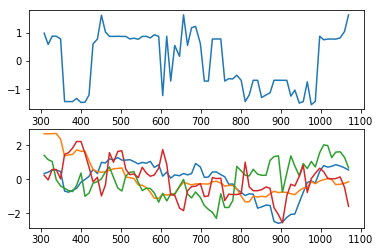

subject 12; gesture 2_1_2; avg 1.0822067014842616; sd 0.013528631572939594
subject 12; gesture 2_1_2; PoV: 0.9783011139237534


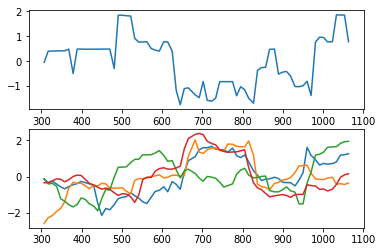

subject 12; gesture 4_0_1; avg 1.0922216954008952; sd 0.014625131725843768
subject 12; gesture 4_0_1; PoV: 0.9827272905791337


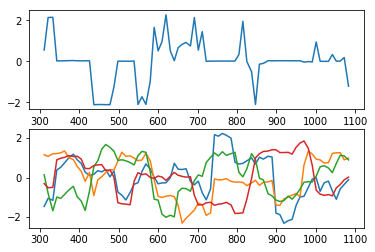

subject 12; gesture 3_0_2; avg 1.8016818818208467; sd 0.02573715596246628
subject 12; gesture 3_0_2; PoV: 0.9779056206938895


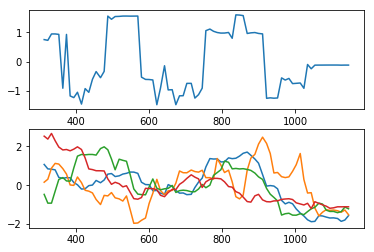

subject 12; gesture 1_1_1; avg 1.4161008269496231; sd 0.011285574127644464
subject 12; gesture 1_1_1; PoV: 0.986849878285759


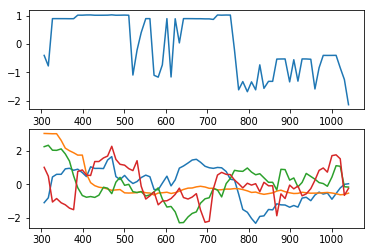

subject 12; gesture 3_1_2; avg 1.7825874828271322; sd 0.021969200218971096
subject 12; gesture 3_1_2; PoV: 0.9855505612265665


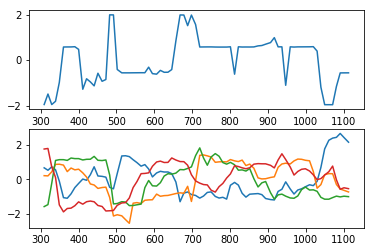

subject 12; gesture 2_1_1; avg 1.0608160372450974; sd 0.019504044296280946
subject 12; gesture 2_1_1; PoV: 0.9679633750717599


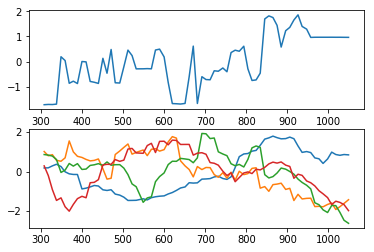

subject 12; gesture 1_0_1; avg 1.0221044204366745; sd 0.015596416346809524
subject 12; gesture 1_0_1; PoV: 0.9773062402574445


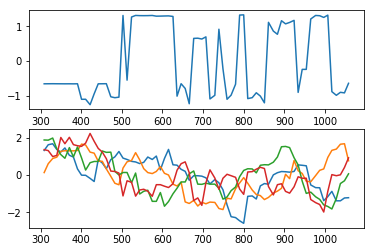

subject 12; gesture 3_1_1; avg 1.4048796377053627; sd 0.01225590135352667
subject 12; gesture 3_1_1; PoV: 0.9885382904922225


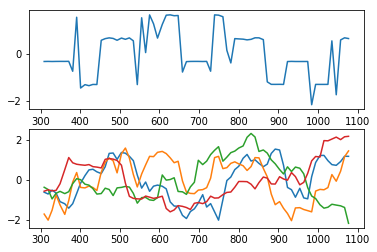

subject 12; gesture 1_0_2; avg 1.2852490527293676; sd 0.0379077241094646
subject 12; gesture 1_0_2; PoV: 0.9645160542224744


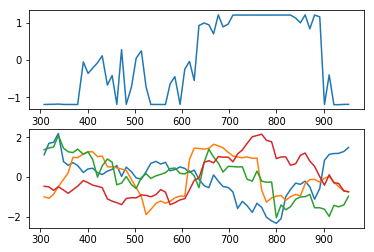

subject 12; gesture 4_0_2; avg 5.2813715683803535; sd 0.02780129994233232
subject 12; gesture 4_0_2; PoV: 0.9948200362063476


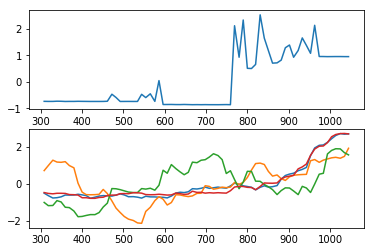

subject 19; gesture 3_0_1; avg 1.598785317090868; sd 0.01471139332585939
subject 19; gesture 3_0_1; PoV: 0.9880679991081533


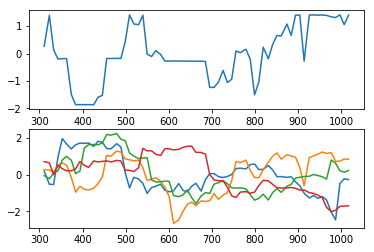

subject 19; gesture 4_1_1; avg 1.6585279040445218; sd 0.020512566014854655
subject 19; gesture 4_1_1; PoV: 0.9836897149189108


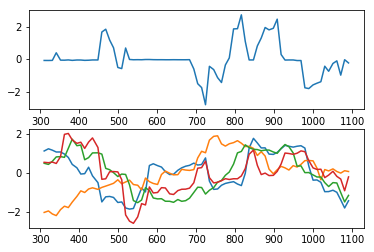

subject 19; gesture 2_0_1; avg 1.5168500191503544; sd 0.017826671896816356
subject 19; gesture 2_0_1; PoV: 0.975529483704089


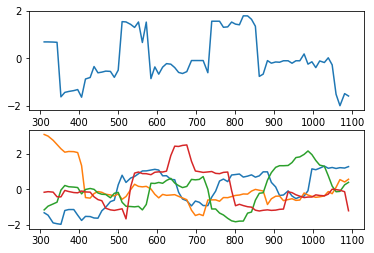

subject 19; gesture 4_1_2; avg 1.07086722856922; sd 0.012135606450715966
subject 19; gesture 4_1_2; PoV: 0.979628382264521


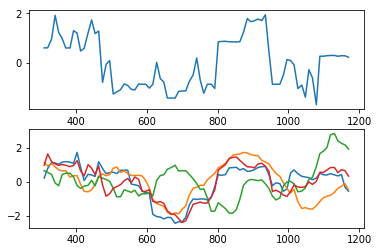

subject 19; gesture 2_0_2; avg 0.8760135121174462; sd 0.008529864847620305
subject 19; gesture 2_0_2; PoV: 0.9814524623050406


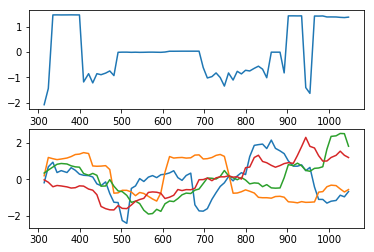

subject 19; gesture 1_1_2; avg 3.505460554707899; sd 0.01941222705366309
subject 19; gesture 1_1_2; PoV: 0.9934474531511999


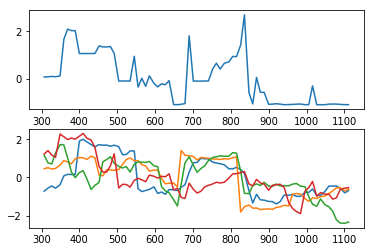

subject 19; gesture 2_1_2; avg 1.0441206757356056; sd 0.01337463621963811
subject 19; gesture 2_1_2; PoV: 0.9785679462747799


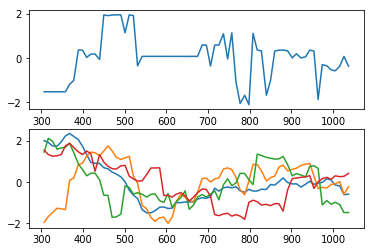

subject 19; gesture 4_0_1; avg 5.116980123450161; sd 0.078120532053815
subject 19; gesture 4_0_1; PoV: 0.9884383656320016


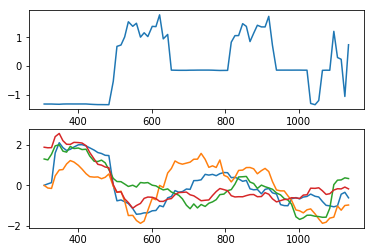

subject 19; gesture 3_0_2; avg 2.7136308403477902; sd 0.02968814126648029
subject 19; gesture 3_0_2; PoV: 0.9871739322842369


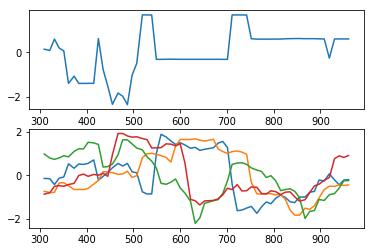

subject 19; gesture 1_1_1; avg 1.3304255864105425; sd 0.012425243723981117
subject 19; gesture 1_1_1; PoV: 0.9856761782386138


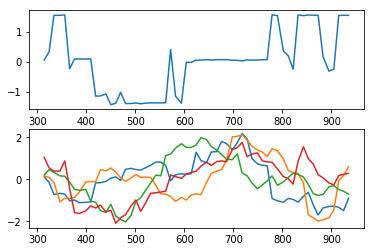

subject 19; gesture 3_1_2; avg 1.777314267482396; sd 0.018968827502767696
subject 19; gesture 3_1_2; PoV: 0.9849331397574517


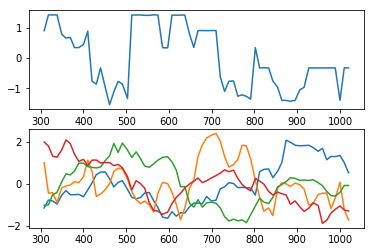

subject 19; gesture 2_1_1; avg 0.8886675976013902; sd 0.009970650516239101
subject 19; gesture 2_1_1; PoV: 0.974827792812287


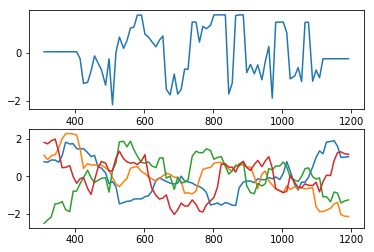

subject 19; gesture 1_0_1; avg 2.61344008583707; sd 0.030030947622458948
subject 19; gesture 1_0_1; PoV: 0.9800006805182995


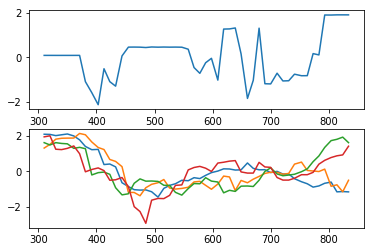

subject 19; gesture 3_1_1; avg 0.9268072795798056; sd 0.0077046653433004405
subject 19; gesture 3_1_1; PoV: 0.9849356032323948


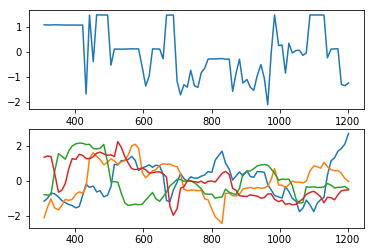

subject 19; gesture 1_0_2; avg 1.7855592329598675; sd 0.023767469830213755
subject 19; gesture 1_0_2; PoV: 0.9799680464234686


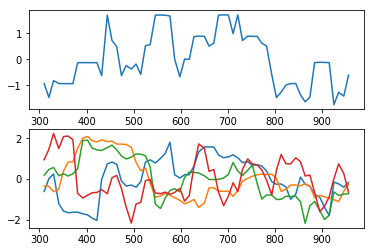

subject 19; gesture 4_0_2; avg 2.559537817854334; sd 0.022613860461191664
subject 19; gesture 4_0_2; PoV: 0.9921463646544911


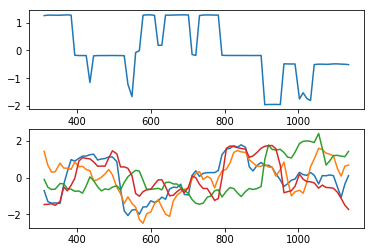

subject 07; gesture 3_0_1; avg 1.7901422503229565; sd 0.013401439460274825
subject 07; gesture 3_0_1; PoV: 0.9911371858117719


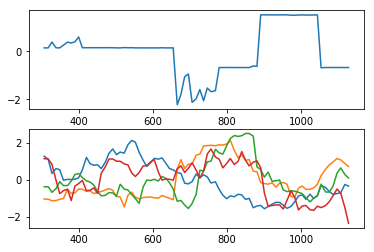

subject 07; gesture 4_1_1; avg 2.240716202613721; sd 0.025491939320270645
subject 07; gesture 4_1_1; PoV: 0.9841353758227878


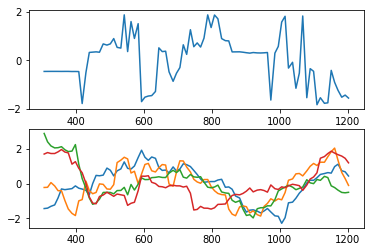

subject 07; gesture 2_0_1; avg 0.8952854844966356; sd 0.011381861235946547
subject 07; gesture 2_0_1; PoV: 0.9705098685235677


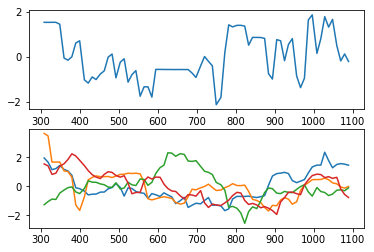

subject 07; gesture 4_1_2; avg 0.5765242426090931; sd 0.005353447658490726
subject 07; gesture 4_1_2; PoV: 0.9826440038600119


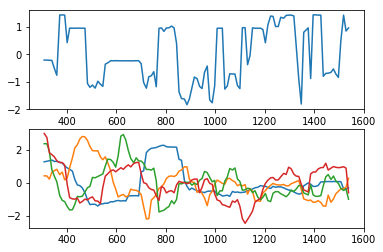

subject 07; gesture 2_0_2; avg 2.461998940920235; sd 0.023729384023521743
subject 07; gesture 2_0_2; PoV: 0.9875894152683411


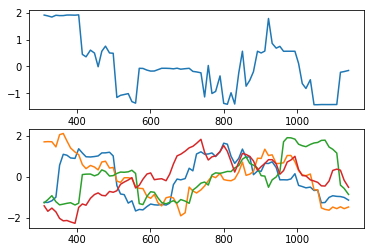

subject 07; gesture 1_1_2; avg 1.6468647798331952; sd 0.024828810117681677
subject 07; gesture 1_1_2; PoV: 0.9820080057840379


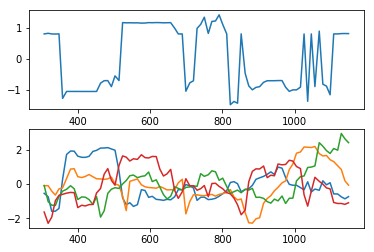

subject 07; gesture 2_1_2; avg 1.061487810075495; sd 0.012108288410426198
subject 07; gesture 2_1_2; PoV: 0.9781885682387033


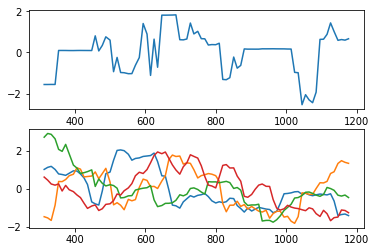

subject 07; gesture 4_0_1; avg 0.9221645774989139; sd 0.006207048550642608
subject 07; gesture 4_0_1; PoV: 0.9910471912834315


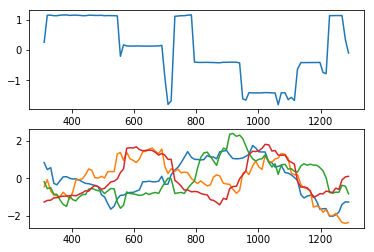

subject 07; gesture 3_0_2; avg 1.135613441475473; sd 0.010142512833661781
subject 07; gesture 3_0_2; PoV: 0.9863613297342276


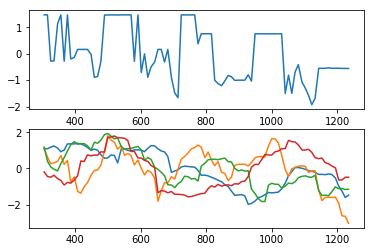

subject 07; gesture 1_1_1; avg 1.3227628160423308; sd 0.0134323366828079
subject 07; gesture 1_1_1; PoV: 0.9843802454881293


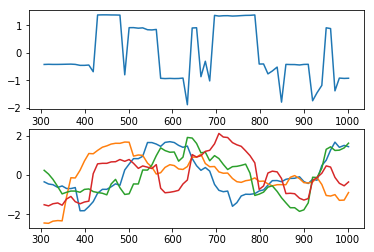

subject 07; gesture 3_1_2; avg 1.3586958384887151; sd 0.010241124573375445
subject 07; gesture 3_1_2; PoV: 0.9906299998456292


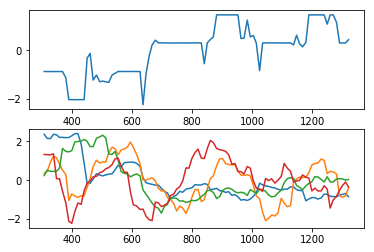

subject 07; gesture 2_1_1; avg 0.8872608303696343; sd 0.011148653492132376
subject 07; gesture 2_1_1; PoV: 0.9729357066526139


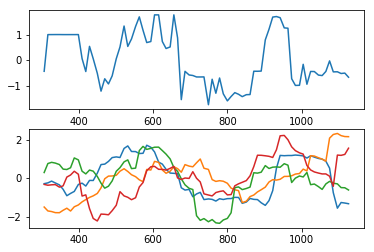

subject 07; gesture 1_0_1; avg 0.8920328739644644; sd 0.007090463034261985
subject 07; gesture 1_0_1; PoV: 0.9855905852078618


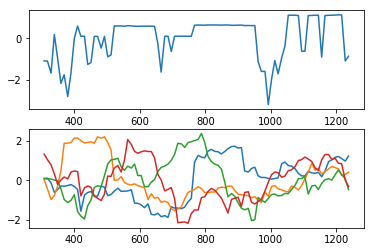

subject 07; gesture 3_1_1; avg 1.0870205237053359; sd 0.01033347542475427
subject 07; gesture 3_1_1; PoV: 0.9867999543633209


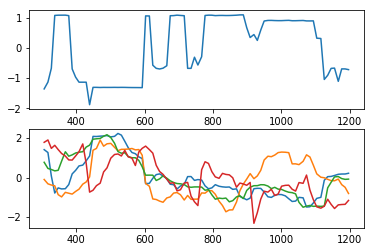

subject 07; gesture 1_0_2; avg 1.7845792444081345; sd 0.0197035244730176
subject 07; gesture 1_0_2; PoV: 0.9885512483012806


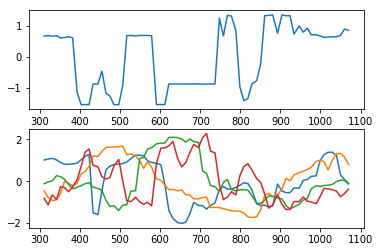

subject 07; gesture 4_0_2; avg 1.124097130812466; sd 0.015986468266107126
subject 07; gesture 4_0_2; PoV: 0.9792758555161722


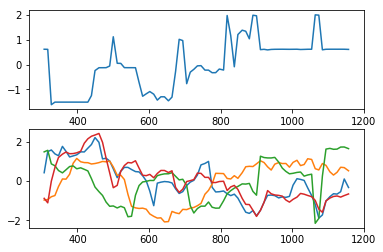

subject 20; gesture 3_0_1; avg 1.2769068743270955; sd 0.02014802128418088
subject 20; gesture 3_0_1; PoV: 0.9818785575236404


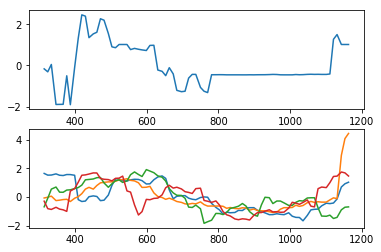

subject 20; gesture 4_1_1; avg 1.248828199672373; sd 0.013729178092355299
subject 20; gesture 4_1_1; PoV: 0.9776639640379856


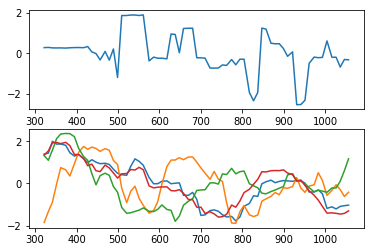

subject 20; gesture 2_0_1; avg 1.1618657697652788; sd 0.010623725632093633
subject 20; gesture 2_0_1; PoV: 0.9845629032436287


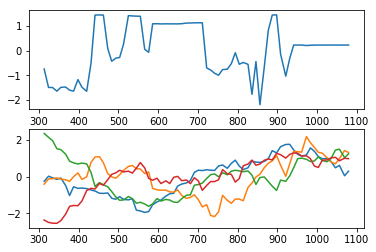

subject 20; gesture 4_1_2; avg 1.9083273979525142; sd 0.018584445167393587
subject 20; gesture 4_1_2; PoV: 0.9836491040252593


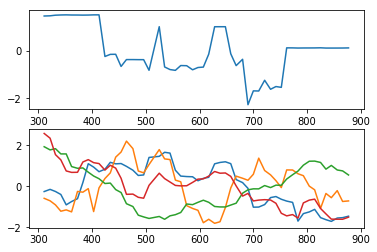

subject 20; gesture 2_0_2; avg 2.882630059534556; sd 0.06298646218929191
subject 20; gesture 2_0_2; PoV: 0.9783323017351947


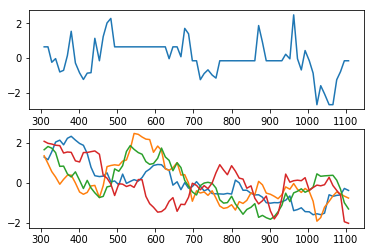

subject 20; gesture 1_1_2; avg 0.9315848671200078; sd 0.0077431705773325895
subject 20; gesture 1_1_2; PoV: 0.9833372104563599


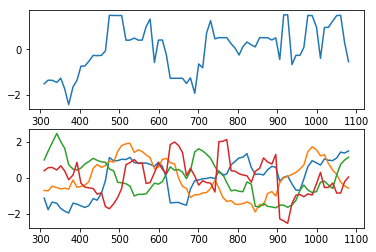

subject 20; gesture 2_1_2; avg 1.202411339634189; sd 0.011666972818388232
subject 20; gesture 2_1_2; PoV: 0.9798714529657927


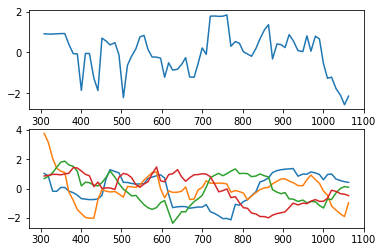

subject 20; gesture 4_0_1; avg 0.9105760872697293; sd 0.008390901796769278
subject 20; gesture 4_0_1; PoV: 0.9838476477138813


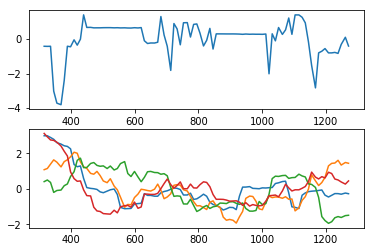

subject 20; gesture 3_0_2; avg 1.6071779048589094; sd 0.009371496342183431
subject 20; gesture 3_0_2; PoV: 0.9918207817598028


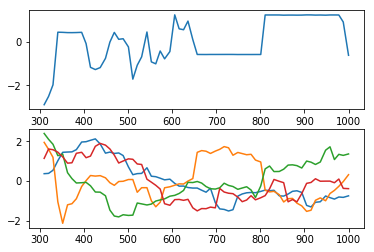

subject 20; gesture 1_1_1; avg 1.2244268128776798; sd 0.01239573308877665
subject 20; gesture 1_1_1; PoV: 0.9837909071221511


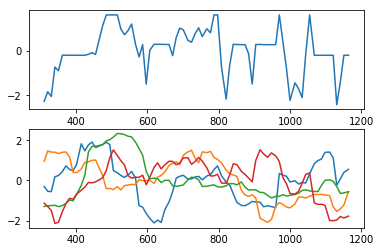

subject 20; gesture 3_1_2; avg 1.3376917475407406; sd 0.008883265755301222
subject 20; gesture 3_1_2; PoV: 0.9902284181442852


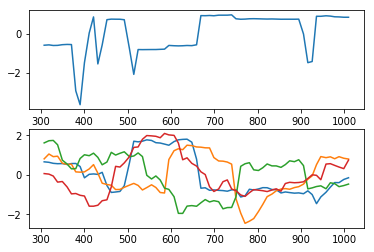

subject 20; gesture 2_1_1; avg 2.2215133000985743; sd 0.014735041559299888
subject 20; gesture 2_1_1; PoV: 0.9905361237001035


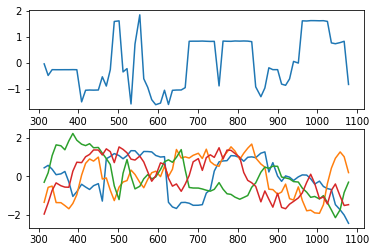

subject 20; gesture 1_0_1; avg 1.2498694991021089; sd 0.012302149591870315
subject 20; gesture 1_0_1; PoV: 0.9816002970038883


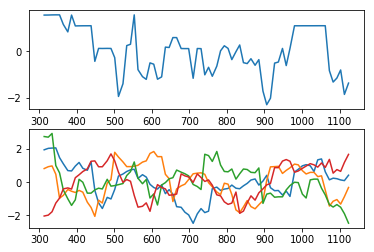

subject 20; gesture 3_1_1; avg 3.42841775213184; sd 0.039863418447180034
subject 20; gesture 3_1_1; PoV: 0.9875298310001341


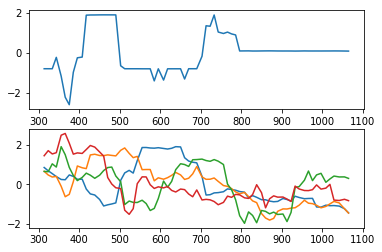

subject 20; gesture 1_0_2; avg 0.8998811207859058; sd 0.008116059928317048
subject 20; gesture 1_0_2; PoV: 0.9820240911511297


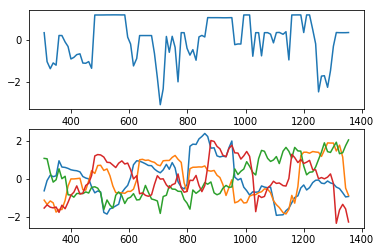

subject 20; gesture 4_0_2; avg 2.005422518594252; sd 0.016597828557229997
subject 20; gesture 4_0_2; PoV: 0.9854990173818694


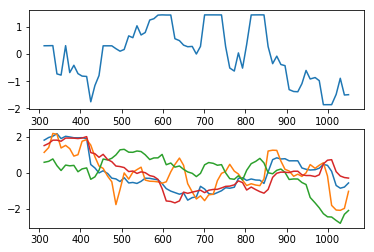

subject 31; gesture 3_0_1; avg 0.9984421416196424; sd 0.01341260431578866
subject 31; gesture 3_0_1; PoV: 0.9670364695866825


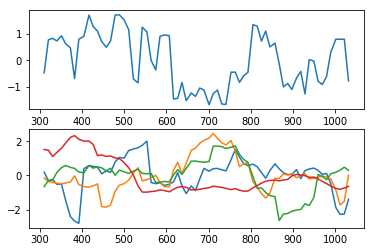

subject 31; gesture 4_1_1; avg 1.7293893387153016; sd 0.015936446027287575
subject 31; gesture 4_1_1; PoV: 0.9867353845309688


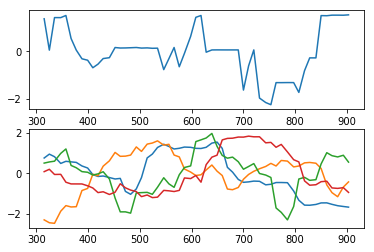

subject 31; gesture 2_0_1; avg 7.643693142478881; sd 0.04361906678830842
subject 31; gesture 2_0_1; PoV: 0.995439107389048


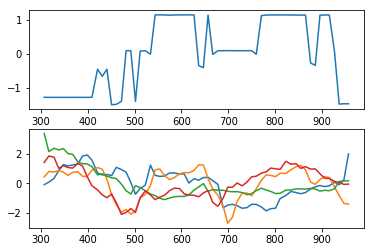

subject 31; gesture 4_1_2; avg 1.3480288935382727; sd 0.8324584685709554
subject 31; gesture 4_1_2; PoV: 0.6395599152162582


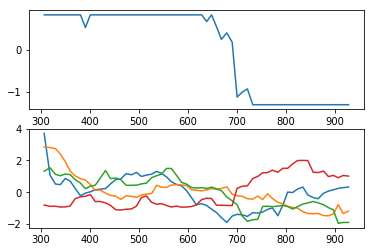

subject 31; gesture 2_0_2; avg 1.5145546191130743; sd 0.020810908410019757
subject 31; gesture 2_0_2; PoV: 0.9825866980079476


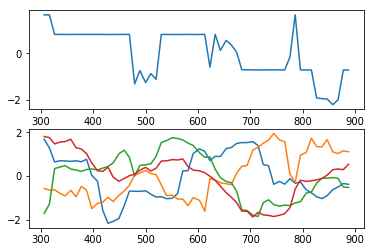

subject 31; gesture 1_1_2; avg 1.6740457491497187; sd 0.01297106476417516
subject 31; gesture 1_1_2; PoV: 0.9887568401267594


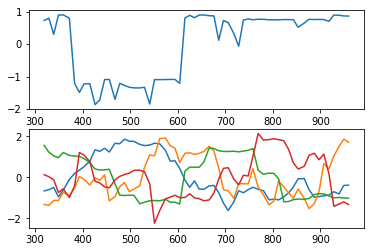

subject 31; gesture 2_1_2; avg 7.641906569104502; sd 0.1396597870669959
subject 31; gesture 2_1_2; PoV: 0.9784000974999141


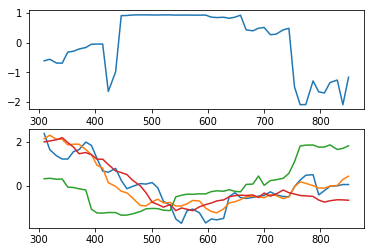

subject 31; gesture 4_0_1; avg 1.367360925704615; sd 0.011640994302828686
subject 31; gesture 4_0_1; PoV: 0.9839900693603586


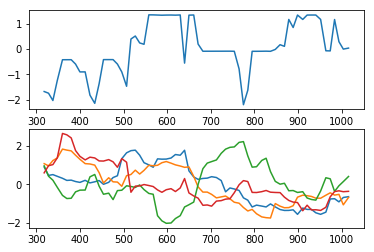

subject 31; gesture 3_0_2; avg 1.4611406541597467; sd 0.010996861414219572
subject 31; gesture 3_0_2; PoV: 0.9905247157788697


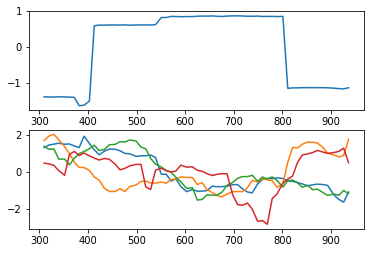

subject 31; gesture 1_1_1; avg 1.8087007174246772; sd 0.018587148538842656
subject 31; gesture 1_1_1; PoV: 0.9834028105301363


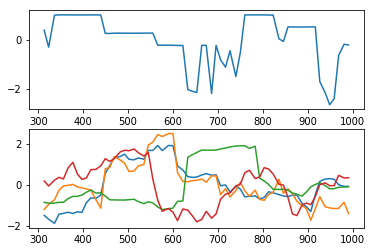

subject 31; gesture 3_1_2; avg 2.7928463333064584; sd 0.015553381445232571
subject 31; gesture 3_1_2; PoV: 0.9936353777793233


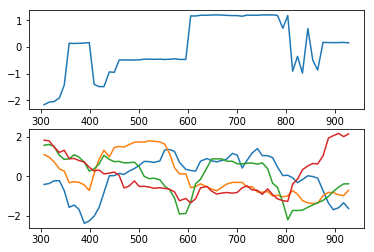

subject 31; gesture 2_1_1; avg 1.5430455743509044; sd 0.011100775110808179
subject 31; gesture 2_1_1; PoV: 0.9879494138909248


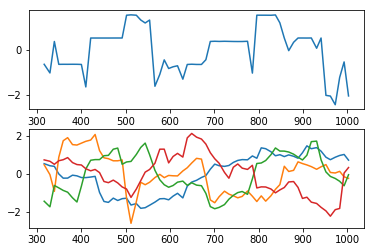

subject 31; gesture 1_0_1; avg 2.0495704993302826; sd 0.016002493794830187
subject 31; gesture 1_0_1; PoV: 0.9905076572857855


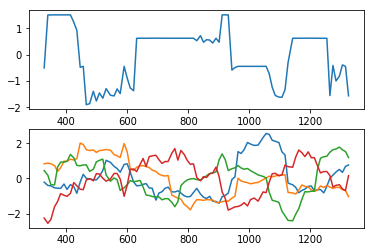

subject 31; gesture 3_1_1; avg 1.7589145143010112; sd 0.016463805649028676
subject 31; gesture 3_1_1; PoV: 0.9860717284891605


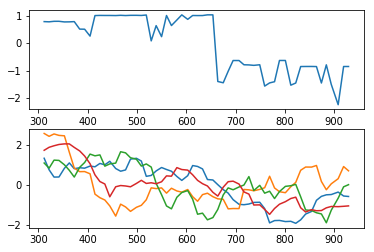

subject 31; gesture 1_0_2; avg 1.4196366560008415; sd 0.017310840334218213
subject 31; gesture 1_0_2; PoV: 0.9845422668890215


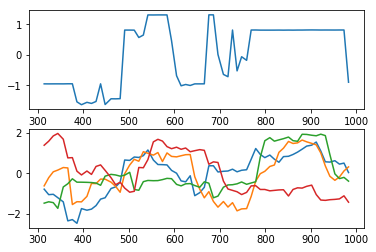

subject 31; gesture 4_0_2; avg 1.281678593677998; sd 0.013979305157413965
subject 31; gesture 4_0_2; PoV: 0.9808960349293443


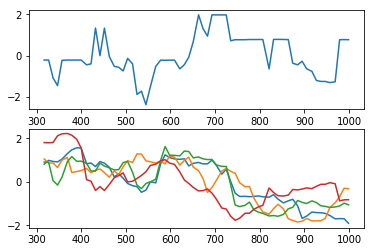

subject 13; gesture 3_0_1; avg 2.2252840622600436; sd 0.02603111858063236
subject 13; gesture 3_0_1; PoV: 0.9863285106015325


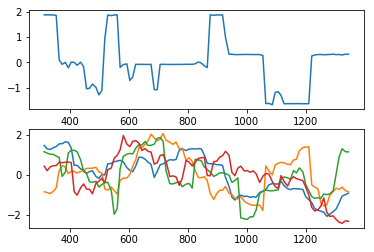

subject 13; gesture 4_1_1; avg 0.7752570335498618; sd 0.010818079491618948
subject 13; gesture 4_1_1; PoV: 0.9793675802252811


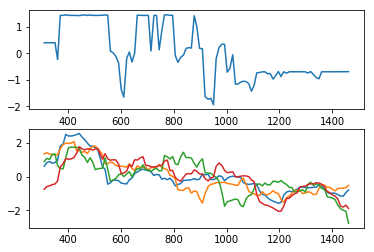

subject 13; gesture 2_0_1; avg 2.1087135632094243; sd 0.02805152813076503
subject 13; gesture 2_0_1; PoV: 0.9818414520775017


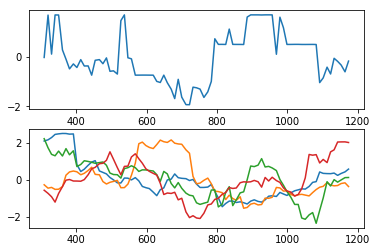

subject 13; gesture 4_1_2; avg 0.5513437115994193; sd 0.005215154364526716
subject 13; gesture 4_1_2; PoV: 0.9819399615258384


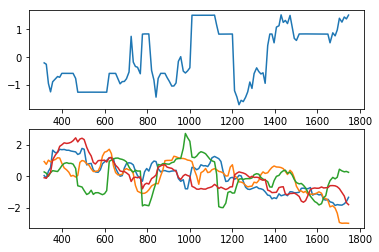

subject 13; gesture 2_0_2; avg 0.9967626812141694; sd 0.014599869206529056
subject 13; gesture 2_0_2; PoV: 0.9702809702983439


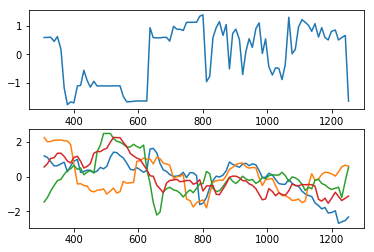

subject 13; gesture 1_1_2; avg 1.3178190950155513; sd 0.011990250841522457
subject 13; gesture 1_1_2; PoV: 0.9866778584926102


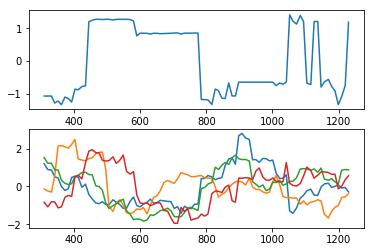

subject 13; gesture 2_1_2; avg 1.862799130704121; sd 0.017135878914747632
subject 13; gesture 2_1_2; PoV: 0.9884658170620881


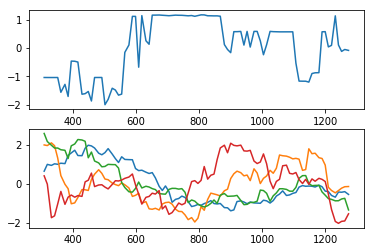

subject 13; gesture 4_0_1; avg 0.6411012607954165; sd 0.005552410263131628
subject 13; gesture 4_0_1; PoV: 0.9825526336426322


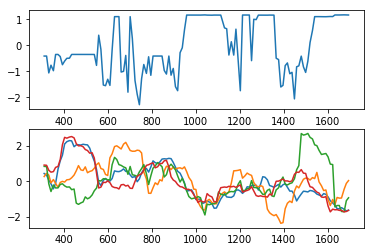

subject 13; gesture 3_0_2; avg 0.7035359022488432; sd 0.004578202172941866
subject 13; gesture 3_0_2; PoV: 0.9899144297510328


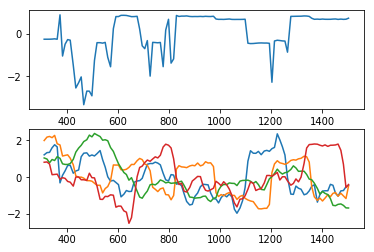

subject 13; gesture 1_1_1; avg 2.0399158811432536; sd 0.019473674096755773
subject 13; gesture 1_1_1; PoV: 0.9881596078518472


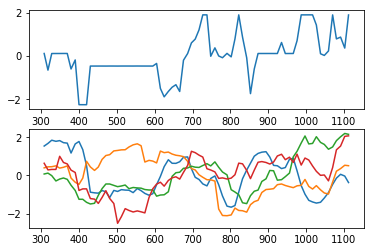

subject 13; gesture 3_1_2; avg 0.4504687491734919; sd 0.0052955763871763385
subject 13; gesture 3_1_2; PoV: 0.9703691209550809


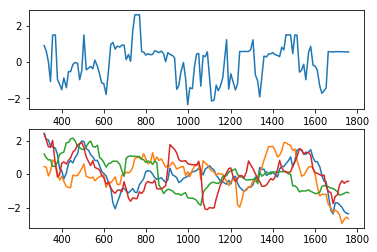

subject 13; gesture 2_1_1; avg 1.3329940495315704; sd 0.012159144543090127
subject 13; gesture 2_1_1; PoV: 0.9868441425174863


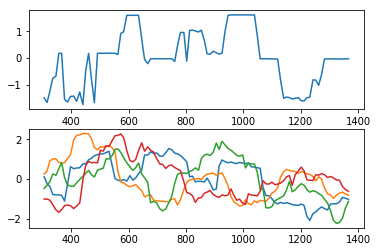

subject 13; gesture 1_0_1; avg 0.4856547494999839; sd 0.0049572303934631405
subject 13; gesture 1_0_1; PoV: 0.9817695299495297


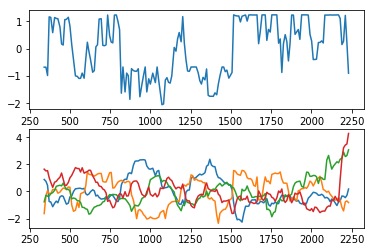

subject 13; gesture 3_1_1; avg 0.5746945731201963; sd 0.009007067836552229
subject 13; gesture 3_1_1; PoV: 0.9702368185506738


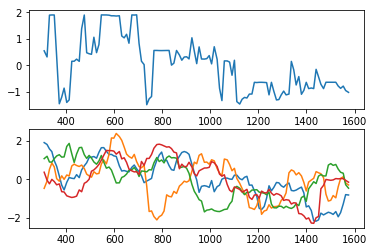

subject 13; gesture 1_0_2; avg 0.8011654623763091; sd 0.007211391214175989
subject 13; gesture 1_0_2; PoV: 0.9841425195896794


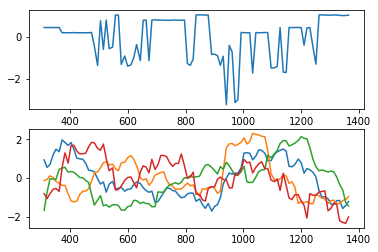

subject 13; gesture 4_0_2; avg 1.2506072446110268; sd 0.010143273422745886
subject 13; gesture 4_0_2; PoV: 0.9863338850786544


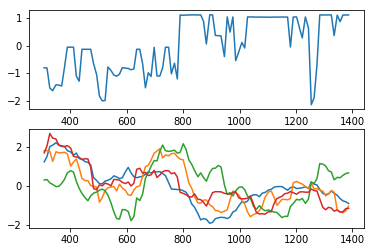

subject 36; gesture 3_0_1; avg 2.335445009390147; sd 0.013344974438144782
subject 36; gesture 3_0_1; PoV: 0.9908611845270177


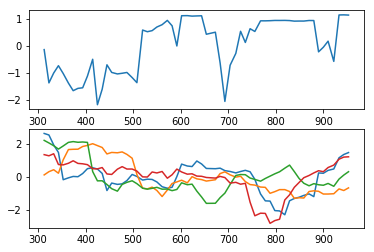

subject 36; gesture 4_1_1; avg 4.6875777094636515; sd 0.05184862301024374
subject 36; gesture 4_1_1; PoV: 0.9912875970362394


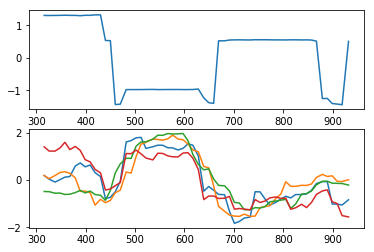

subject 36; gesture 2_0_1; avg 1.3276791681765139; sd 0.017696974171802222
subject 36; gesture 2_0_1; PoV: 0.9804756446893362


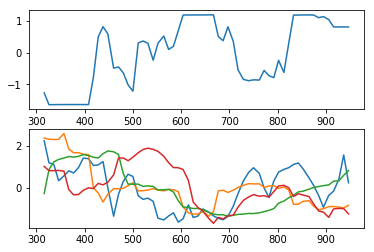

subject 36; gesture 4_1_2; avg 1.8540847281428896; sd 1.497037002102091
subject 36; gesture 4_1_2; PoV: 0.5449907899874177


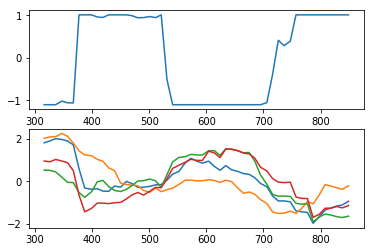

subject 36; gesture 2_0_2; avg 1.414608517860155; sd 0.024547533429888326
subject 36; gesture 2_0_2; PoV: 0.9739524499810785


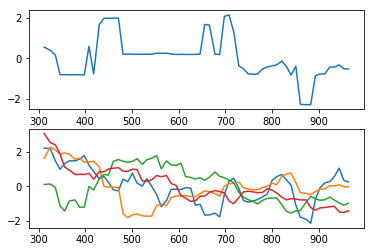

subject 36; gesture 1_1_2; avg 1.1081622933753161; sd 0.011611450727903289
subject 36; gesture 1_1_2; PoV: 0.9827803942128195


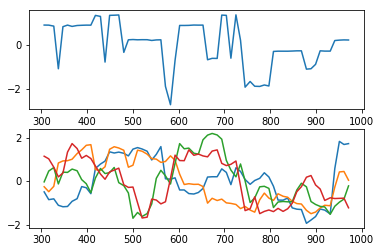

subject 36; gesture 2_1_2; avg 2.7530409750365217; sd 0.02574131576066922
subject 36; gesture 2_1_2; PoV: 0.9861884506689439


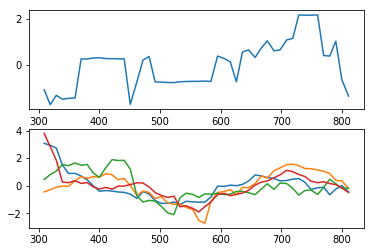

subject 36; gesture 4_0_1; avg 7.59805304762798; sd 0.0970260734068808
subject 36; gesture 4_0_1; PoV: 0.9907915716691229


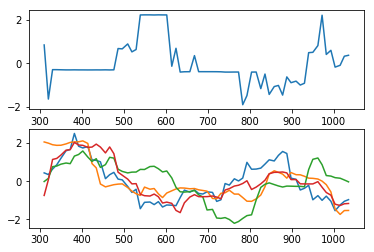

subject 36; gesture 3_0_2; avg 1.2530141177580052; sd 0.009849179142522401
subject 36; gesture 3_0_2; PoV: 0.9882786728777091


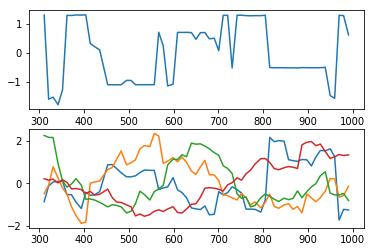

subject 36; gesture 1_1_1; avg 0.9949571425510266; sd 0.008472066549199684
subject 36; gesture 1_1_1; PoV: 0.985309374933592


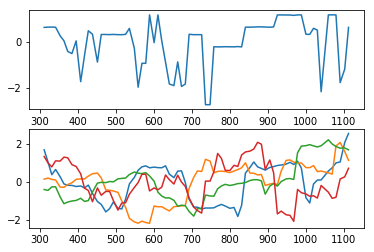

subject 36; gesture 3_1_2; avg 1.7833006929074524; sd 0.012677101022942125
subject 36; gesture 3_1_2; PoV: 0.9872342828490606


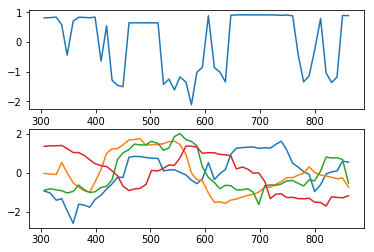

subject 36; gesture 2_1_1; avg 1.4229304249230017; sd 0.01748835573082161
subject 36; gesture 2_1_1; PoV: 0.9851644237250681


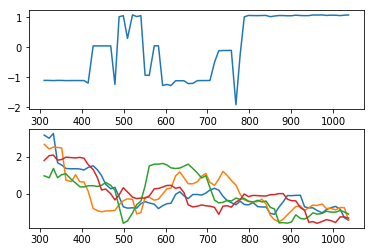

subject 36; gesture 1_0_1; avg 2.9755387695143574; sd 0.029924576570987776
subject 36; gesture 1_0_1; PoV: 0.9821276878832883


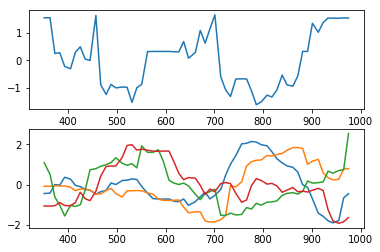

subject 36; gesture 3_1_1; avg 1.6749545019872507; sd 0.02809760933408726
subject 36; gesture 3_1_1; PoV: 0.9708042120188946


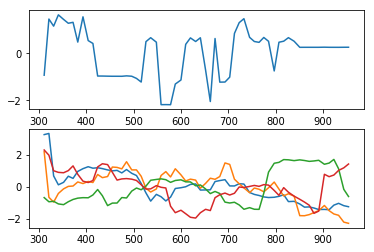

subject 36; gesture 1_0_2; avg 1.33458267095986; sd 0.010751033122041273
subject 36; gesture 1_0_2; PoV: 0.9866077291208515


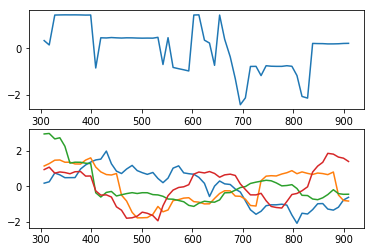

subject 36; gesture 4_0_2; avg 2.6836897199412313; sd 0.029617955229918603
subject 36; gesture 4_0_2; PoV: 0.9865983275893925


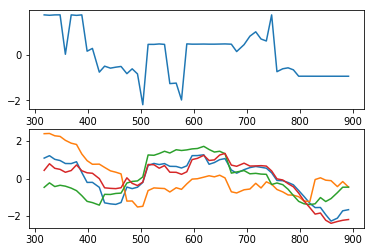

subject 24; gesture 3_0_1; avg 2.1496850452778427; sd 0.01228340185711759
subject 24; gesture 3_0_1; PoV: 0.9930654918442741


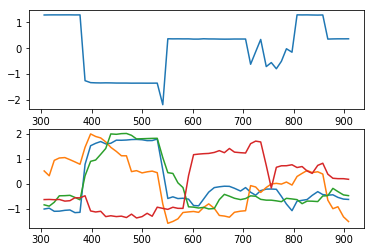

subject 24; gesture 4_1_1; avg 2.59557208376762; sd 0.030568742065343598
subject 24; gesture 4_1_1; PoV: 0.9857482509892654


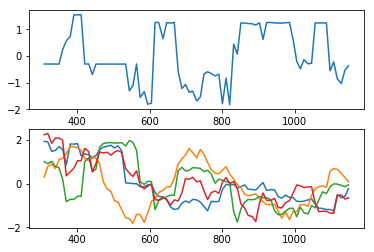

subject 24; gesture 2_0_1; avg 4.947787747492718; sd 0.02872735362332697
subject 24; gesture 2_0_1; PoV: 0.9940429133285558


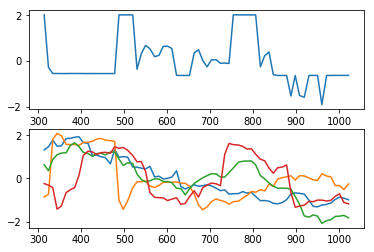

subject 24; gesture 4_1_2; avg 3.1053271419655544; sd 0.04438587950407605
subject 24; gesture 4_1_2; PoV: 0.98759516189798


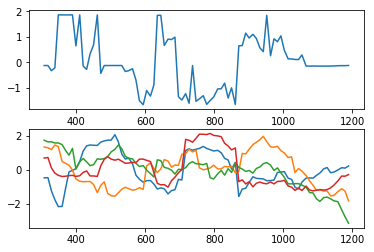

subject 24; gesture 2_0_2; avg 1.6880221730510951; sd 0.013622202204456885
subject 24; gesture 2_0_2; PoV: 0.9890785700577752


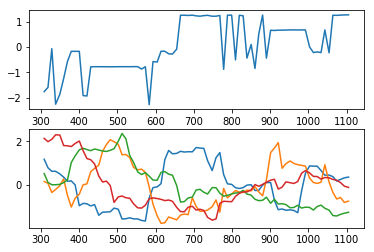

subject 24; gesture 1_1_2; avg 1.1390459290308672; sd 0.012485722396000837
subject 24; gesture 1_1_2; PoV: 0.9805994794371083


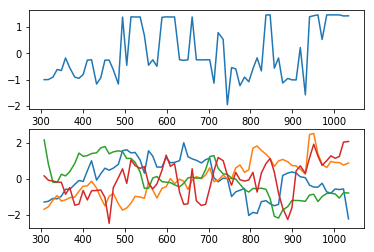

subject 24; gesture 2_1_2; avg 0.9508077456904066; sd 0.010034454301887949
subject 24; gesture 2_1_2; PoV: 0.9796512317483349


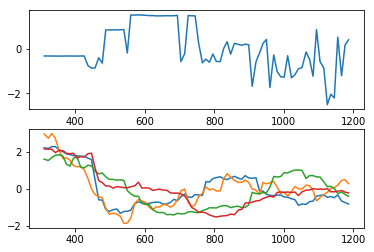

subject 24; gesture 4_0_1; avg 1.0124294315155338; sd 0.009283758387187624
subject 24; gesture 4_0_1; PoV: 0.9853879058271113


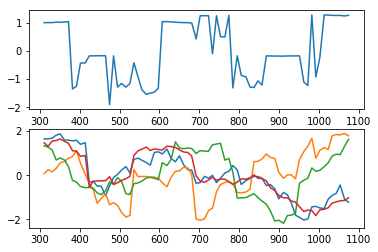

subject 24; gesture 3_0_2; avg 1.559875271930777; sd 0.02211941584247191
subject 24; gesture 3_0_2; PoV: 0.9829293633893292


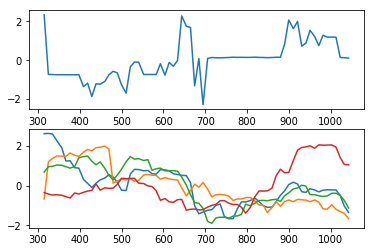

subject 24; gesture 1_1_1; avg 1.500515973008876; sd 0.02252947981143562
subject 24; gesture 1_1_1; PoV: 0.974518976984972


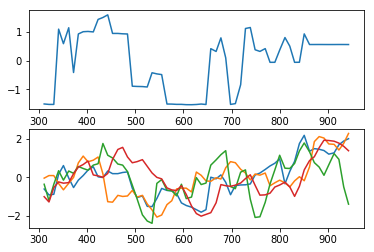

subject 24; gesture 3_1_2; avg 1.67474190041553; sd 0.021472064891496712
subject 24; gesture 3_1_2; PoV: 0.9850512849613811


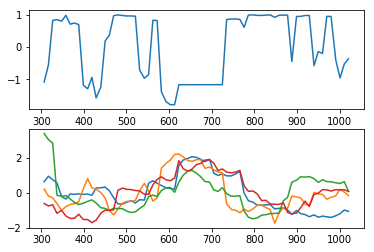

subject 24; gesture 2_1_1; avg 1.6246218503066867; sd 0.01450950290855621
subject 24; gesture 2_1_1; PoV: 0.9857697490940222


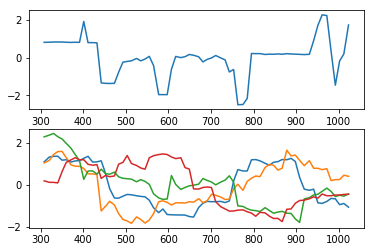

subject 24; gesture 1_0_1; avg 0.9435178972022326; sd 0.010414570946036796
subject 24; gesture 1_0_1; PoV: 0.9827232911375064


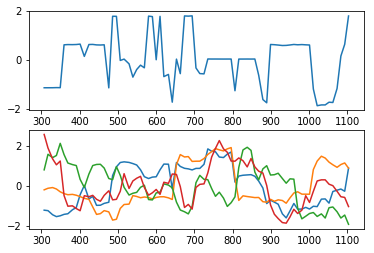

subject 24; gesture 3_1_1; avg 1.3832798648324454; sd 0.014486333795434821
subject 24; gesture 3_1_1; PoV: 0.9784715464190419


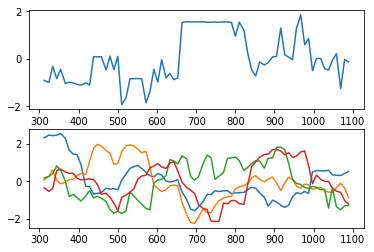

subject 24; gesture 1_0_2; avg 1.132817969157276; sd 0.009949152621422208
subject 24; gesture 1_0_2; PoV: 0.9848852493808659


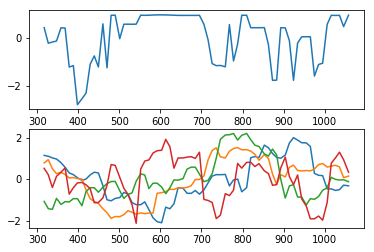

subject 24; gesture 4_0_2; avg 1.9302270891374549; sd 0.017802338088543247
subject 24; gesture 4_0_2; PoV: 0.9890786674890567


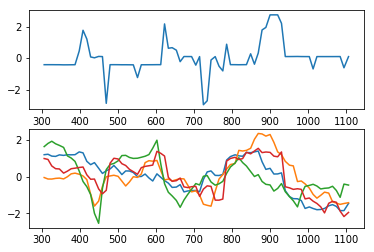

subject 33; gesture 3_0_1; avg 1.7118193449934778; sd 0.019835310845785912
subject 33; gesture 3_0_1; PoV: 0.9843423194433247


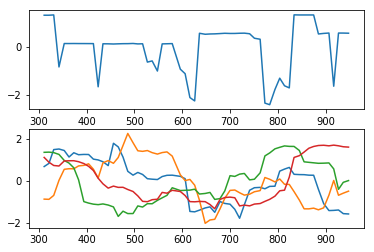

subject 33; gesture 4_1_1; avg 1.443792178492442; sd 0.01104954403216525
subject 33; gesture 4_1_1; PoV: 0.9865829435733053


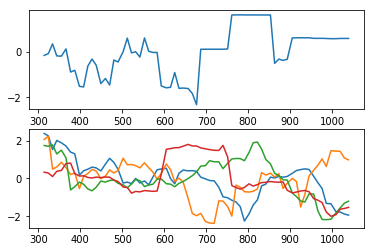

subject 33; gesture 2_0_1; avg 1.2957955577829618; sd 0.015172271252790547
subject 33; gesture 2_0_1; PoV: 0.9789794901046461


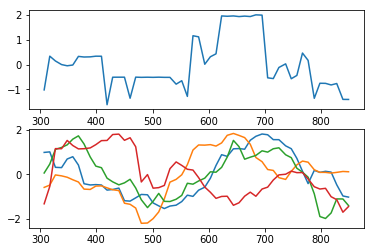

subject 33; gesture 4_1_2; avg 1.5134167031843786; sd 0.010394082882203108
subject 33; gesture 4_1_2; PoV: 0.9884630769904067


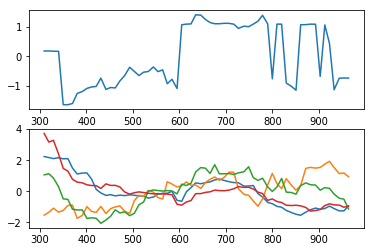

subject 33; gesture 2_0_2; avg 1.2852505693073666; sd 0.009098658653871019
subject 33; gesture 2_0_2; PoV: 0.9890768242634849


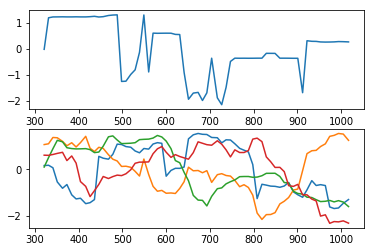

subject 33; gesture 1_1_2; avg 1.4543418106584047; sd 0.015419305525358036
subject 33; gesture 1_1_2; PoV: 0.9819673367879169


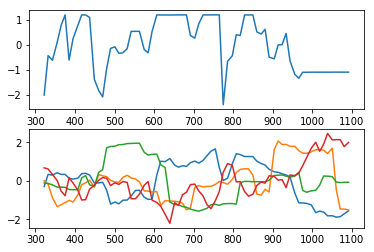

subject 33; gesture 2_1_2; avg 1.9685956442481798; sd 0.01275063721792824
subject 33; gesture 2_1_2; PoV: 0.990168875295076


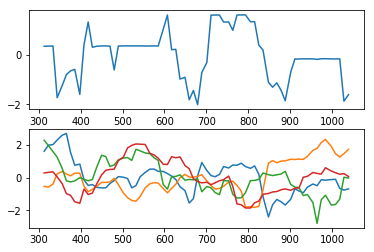

subject 33; gesture 4_0_1; avg 2.3327071427473562; sd 0.02277569343539791
subject 33; gesture 4_0_1; PoV: 0.9903986029936968


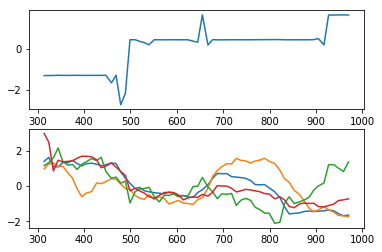

subject 33; gesture 3_0_2; avg 2.5978169744848745; sd 0.038049986003421854
subject 33; gesture 3_0_2; PoV: 0.981929666102339


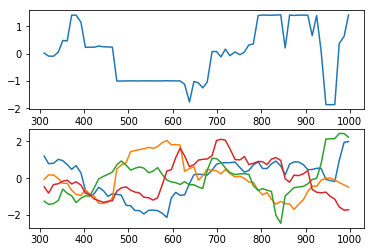

subject 33; gesture 1_1_1; avg 1.689299585505022; sd 0.025265806381980883
subject 33; gesture 1_1_1; PoV: 0.9805375866163951


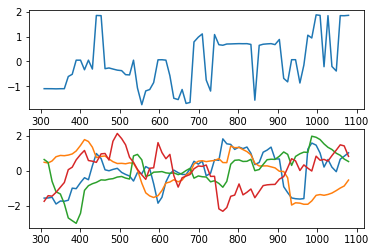

subject 33; gesture 3_1_2; avg 1.3690575008532526; sd 0.014931792266800309
subject 33; gesture 3_1_2; PoV: 0.9841245715865694


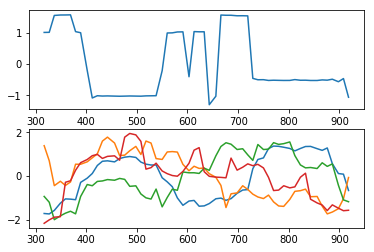

subject 33; gesture 2_1_1; avg 2.1198294976066965; sd 0.025486371996940406
subject 33; gesture 2_1_1; PoV: 0.9854445495982677


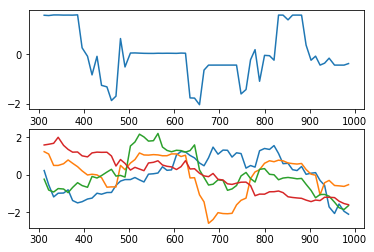

subject 33; gesture 1_0_1; avg 1.3479539802844018; sd 0.01118231120831713
subject 33; gesture 1_0_1; PoV: 0.9815961738237209


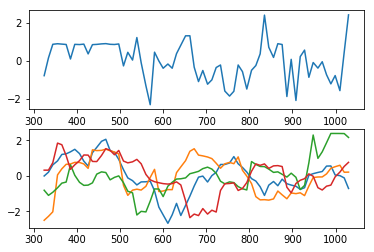

subject 33; gesture 3_1_1; avg 1.6450182423884472; sd 0.02202476198816215
subject 33; gesture 3_1_1; PoV: 0.9827113589156034


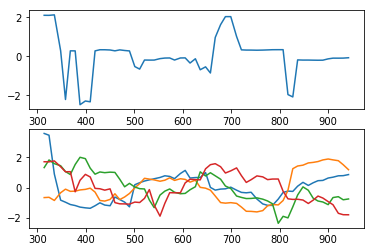

subject 33; gesture 1_0_2; avg 2.011062098829662; sd 0.012487118925662377
subject 33; gesture 1_0_2; PoV: 0.9903362227470114


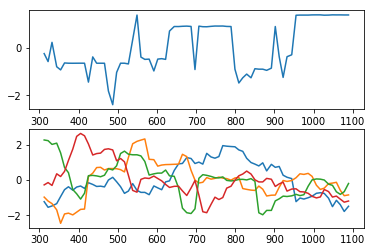

subject 33; gesture 4_0_2; avg 1.2764203378031727; sd 0.01697684829079618
subject 33; gesture 4_0_2; PoV: 0.9734556280652622


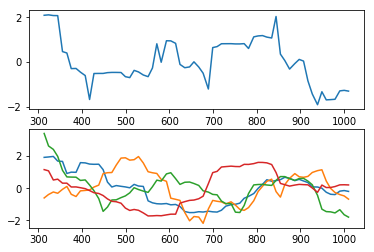

subject 11; gesture 3_0_1; avg 0.9683383467423099; sd 0.012622846005162228
subject 11; gesture 3_0_1; PoV: 0.9763839431279353


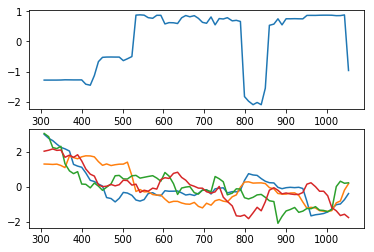

subject 11; gesture 4_1_1; avg 1.2029813015584254; sd 0.012217631193611987
subject 11; gesture 4_1_1; PoV: 0.9860061647805144


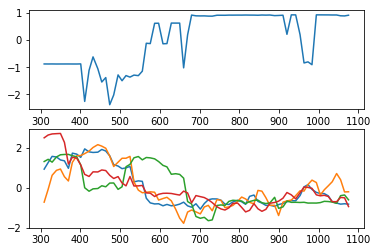

subject 11; gesture 2_0_1; avg 5.39343111433989; sd 0.05368198187020259
subject 11; gesture 2_0_1; PoV: 0.9910383048353091


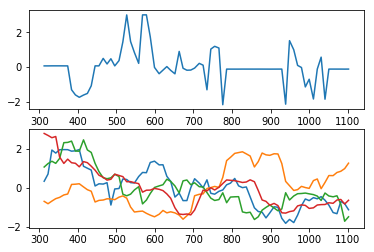

subject 11; gesture 4_1_2; avg 1.0199825476614368; sd 0.008989907118661314
subject 11; gesture 4_1_2; PoV: 0.9839163887260729


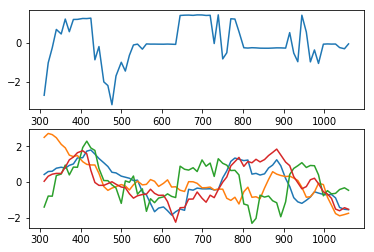

subject 11; gesture 2_0_2; avg 1.5925389637210188; sd 0.015647169935105898
subject 11; gesture 2_0_2; PoV: 0.9846891642675871


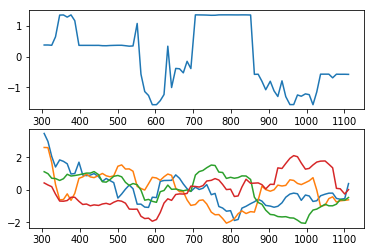

subject 11; gesture 1_1_2; avg 2.8346553787874393; sd 0.033733427241939555
subject 11; gesture 1_1_2; PoV: 0.9875810375348246


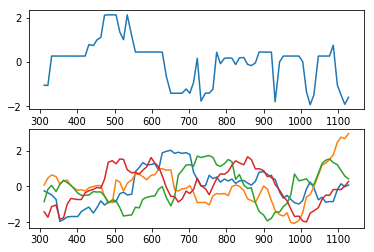

subject 11; gesture 2_1_2; avg 1.021010143587002; sd 0.013663675345109347
subject 11; gesture 2_1_2; PoV: 0.9754886347059618


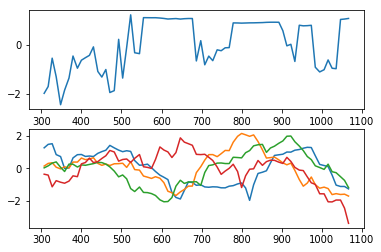

subject 11; gesture 4_0_1; avg 1.131123711470891; sd 0.03568353136735312
subject 11; gesture 4_0_1; PoV: 0.9619373540839714


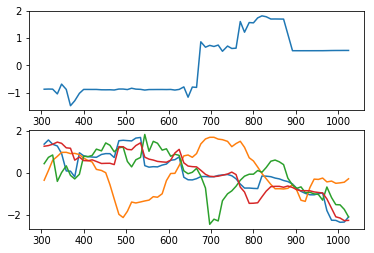

subject 11; gesture 3_0_2; avg 2.8521899554002337; sd 0.016059684886323644
subject 11; gesture 3_0_2; PoV: 0.9928703620249395


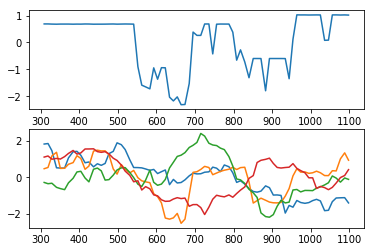

subject 11; gesture 1_1_1; avg 0.9740021375129972; sd 0.014564765308785735
subject 11; gesture 1_1_1; PoV: 0.9758109741554638


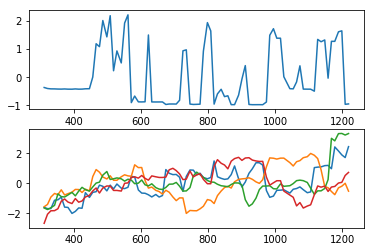

subject 11; gesture 3_1_2; avg 1.3386791095006272; sd 0.6348502439627266
subject 11; gesture 3_1_2; PoV: 0.6670401406598732


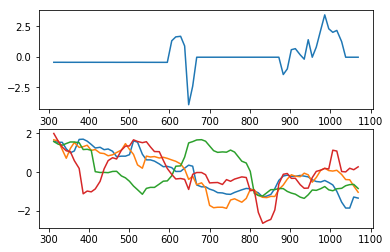

subject 11; gesture 2_1_1; avg 4.367954185901296; sd 0.04342375781780328
subject 11; gesture 2_1_1; PoV: 0.991431180356755


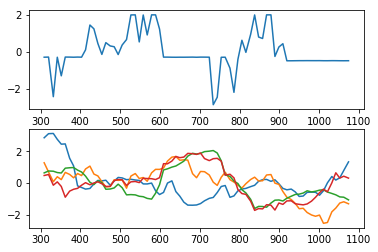

subject 11; gesture 1_0_1; avg 0.9540046304334534; sd 0.009601479626069947
subject 11; gesture 1_0_1; PoV: 0.9841086216830337


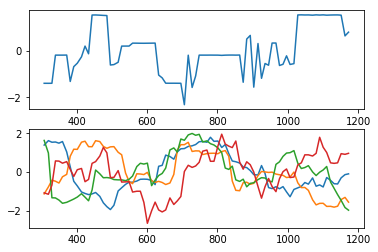

subject 11; gesture 3_1_1; avg 1.3363550011908347; sd 0.017221805457586333
subject 11; gesture 3_1_1; PoV: 0.9816950145855838


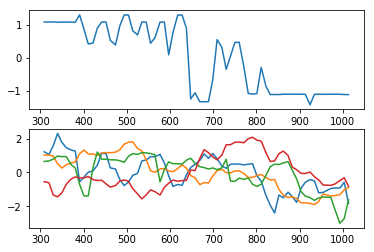

subject 11; gesture 1_0_2; avg 2.784400600948439; sd 0.029321631117908507
subject 11; gesture 1_0_2; PoV: 0.9896073895248808


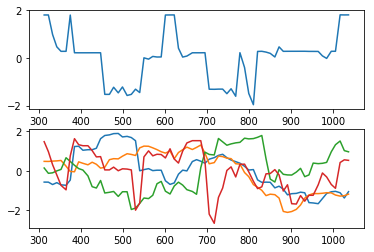

subject 11; gesture 4_0_2; avg 0.916247088721312; sd 0.0098249426711724
subject 11; gesture 4_0_2; PoV: 0.9863675042242269


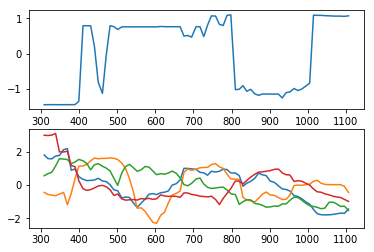

subject 35; gesture 3_0_1; avg 1.6355718636880696; sd 0.0124912124356035
subject 35; gesture 3_0_1; PoV: 0.9879332016415717


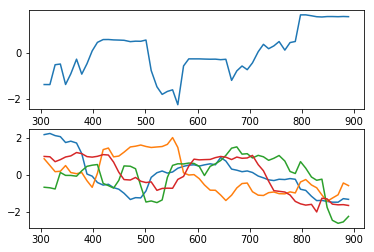

subject 35; gesture 4_1_1; avg 2.2539281330567387; sd 0.011934856229068376
subject 35; gesture 4_1_1; PoV: 0.9940438768817826


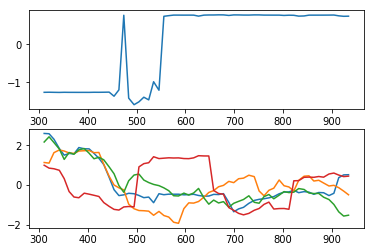

subject 35; gesture 2_0_1; avg 1.3882215749142093; sd 0.01655982317958497
subject 35; gesture 2_0_1; PoV: 0.9835205479081268


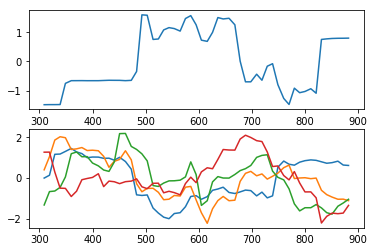

subject 35; gesture 4_1_2; avg 2.91954645903334; sd 0.10935374605339498
subject 35; gesture 4_1_2; PoV: 0.9667503131367041


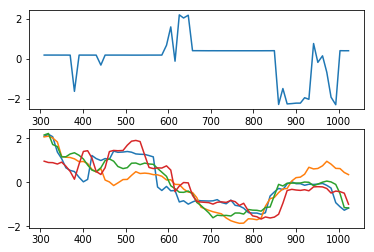

subject 35; gesture 2_0_2; avg 1.3067594681823365; sd 0.011031090925595744
subject 35; gesture 2_0_2; PoV: 0.9876282805884032


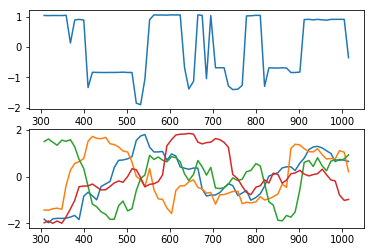

subject 35; gesture 1_1_2; avg 1.138383419281715; sd 0.01379400188182068
subject 35; gesture 1_1_2; PoV: 0.9803651747906013


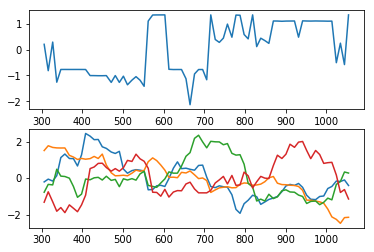

subject 35; gesture 2_1_2; avg 2.175624060858659; sd 0.01991388749331318
subject 35; gesture 2_1_2; PoV: 0.983276588777292


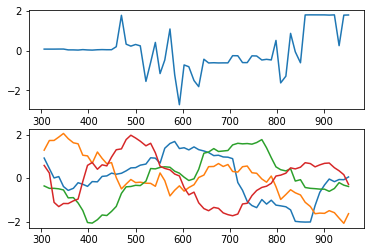

subject 35; gesture 4_0_1; avg 1.5308058153770392; sd 0.01781801555233951
subject 35; gesture 4_0_1; PoV: 0.9801578777474309


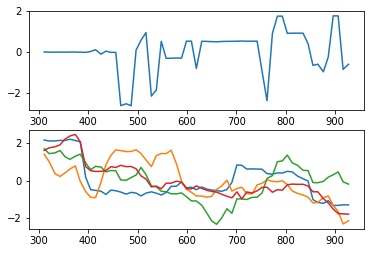

subject 35; gesture 3_0_2; avg 2.23115925022283; sd 0.08130373985765245
subject 35; gesture 3_0_2; PoV: 0.9638929510424903


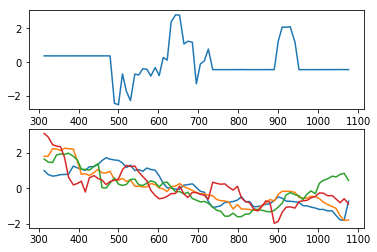

subject 35; gesture 1_1_1; avg 1.4992377494521307; sd 0.017613872856743325
subject 35; gesture 1_1_1; PoV: 0.9787463375740019


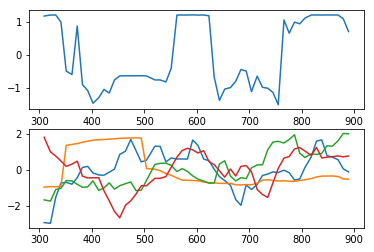

subject 35; gesture 3_1_2; avg 2.1267858665272095; sd 0.019812664049700317
subject 35; gesture 3_1_2; PoV: 0.9861574818154247


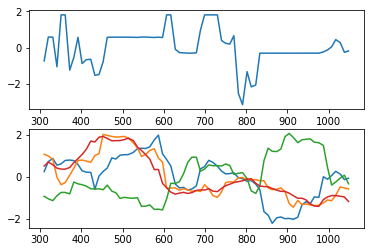

subject 35; gesture 2_1_1; avg 2.3144238640572223; sd 0.021451398375027825
subject 35; gesture 2_1_1; PoV: 0.9877343875469098


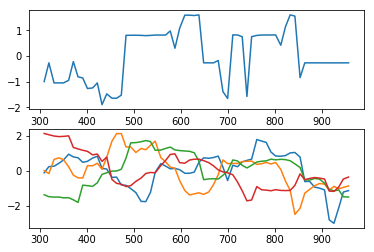

subject 35; gesture 1_0_1; avg 8.233385399553002; sd 0.04771179378745534
subject 35; gesture 1_0_1; PoV: 0.9944701243066466


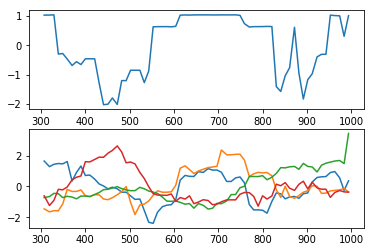

subject 35; gesture 3_1_1; avg 1.7460362268813607; sd 1.6024368075048003
subject 35; gesture 3_1_1; PoV: 0.5150878925151688


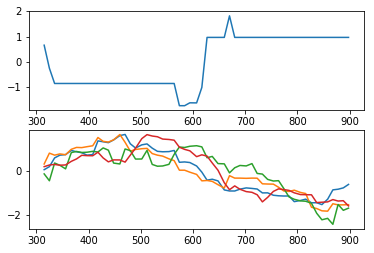

subject 35; gesture 1_0_2; avg 1.2476902895257975; sd 0.010288340304695076
subject 35; gesture 1_0_2; PoV: 0.9851650369916095


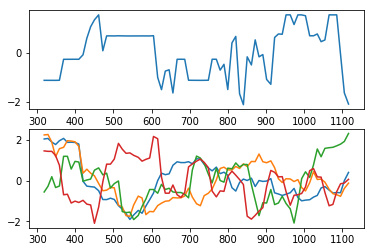

subject 35; gesture 4_0_2; avg 1.2589682745324369; sd 0.021218575946486937
subject 35; gesture 4_0_2; PoV: 0.9719319101106846


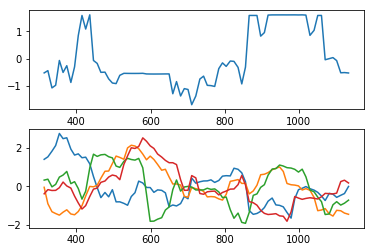

subject 22; gesture 3_0_1; avg 5.8979334502162635; sd 0.03248160946112036
subject 22; gesture 3_0_1; PoV: 0.9959926927489916


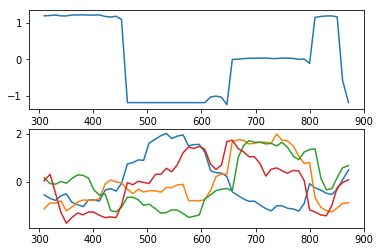

subject 22; gesture 4_1_1; avg 2.4520955401005553; sd 0.02250741242188506
subject 22; gesture 4_1_1; PoV: 0.9905790301704711


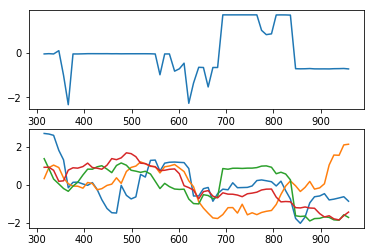

subject 22; gesture 2_0_1; avg 1.8652083618233766; sd 0.020364977389471017
subject 22; gesture 2_0_1; PoV: 0.9865683106963331


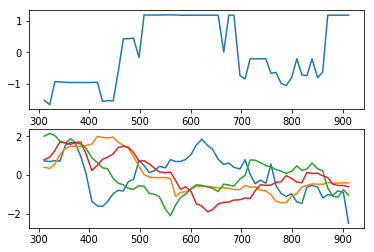

subject 22; gesture 4_1_2; avg 1.0577628668667383; sd 0.035736336561983724
subject 22; gesture 4_1_2; PoV: 0.9601802787841047


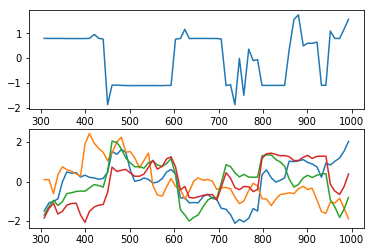

subject 22; gesture 2_0_2; avg 1.9341355782525436; sd 0.030766632057137377
subject 22; gesture 2_0_2; PoV: 0.9832651602564554


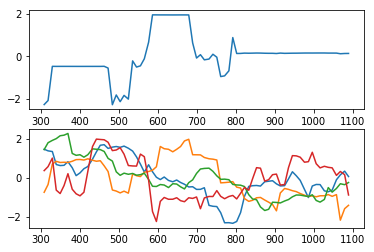

subject 22; gesture 1_1_2; avg 1.6101862394014301; sd 0.01739219841715582
subject 22; gesture 1_1_2; PoV: 0.9768418952954351


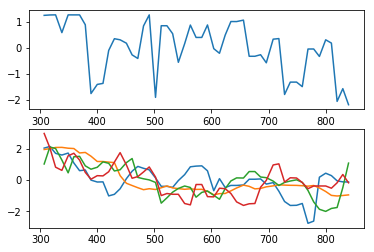

subject 22; gesture 2_1_2; avg 1.7684096804770661; sd 0.05182743548248496
subject 22; gesture 2_1_2; PoV: 0.9688987392021764


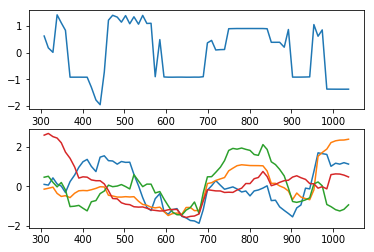

subject 22; gesture 4_0_1; avg 1.214136532145727; sd 0.017265725265328918
subject 22; gesture 4_0_1; PoV: 0.9801345136914921


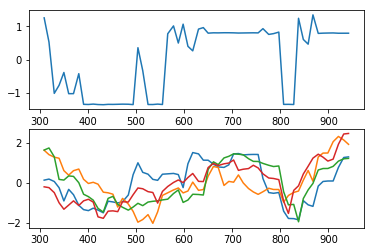

subject 22; gesture 3_0_2; avg 3.698206985591013; sd 0.029021832712130224
subject 22; gesture 3_0_2; PoV: 0.9924830357000975


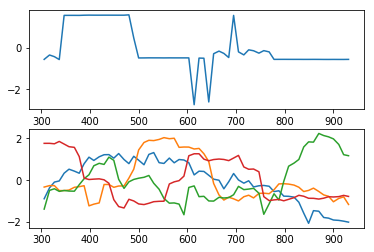

subject 22; gesture 1_1_1; avg 1.1287856746977003; sd 0.013962668224317985
subject 22; gesture 1_1_1; PoV: 0.9817153262437666


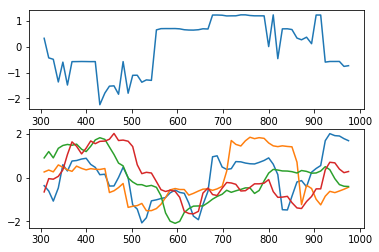

subject 22; gesture 3_1_2; avg 2.38507214021282; sd 0.014833431450600433
subject 22; gesture 3_1_2; PoV: 0.9910745372959111


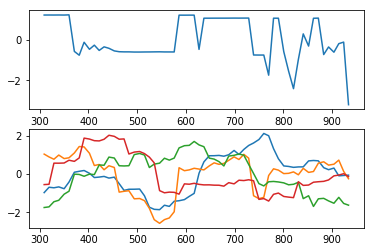

subject 22; gesture 2_1_1; avg 1.7679805506576394; sd 0.014865815288972852
subject 22; gesture 2_1_1; PoV: 0.9886165315508941


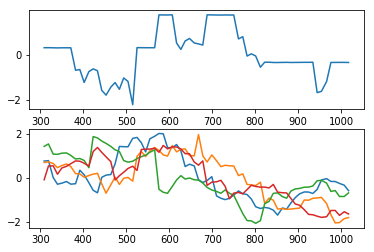

subject 22; gesture 1_0_1; avg 2.017856657620466; sd 0.015975900970659603
subject 22; gesture 1_0_1; PoV: 0.9872832744291703


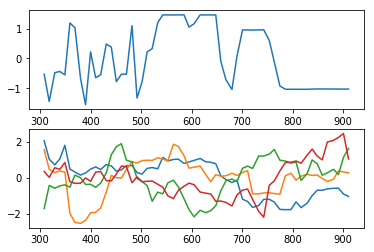

subject 22; gesture 3_1_1; avg 1.647841198445932; sd 0.015023024080460147
subject 22; gesture 3_1_1; PoV: 0.9869730588211835


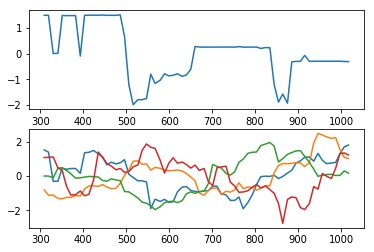

subject 22; gesture 1_0_2; avg 1.0217058154199692; sd 0.009177838435800636
subject 22; gesture 1_0_2; PoV: 0.985028718870627


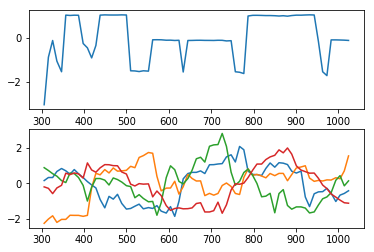

subject 22; gesture 4_0_2; avg 1.736939230321345; sd 0.015161108480646491
subject 22; gesture 4_0_2; PoV: 0.9829972536593627


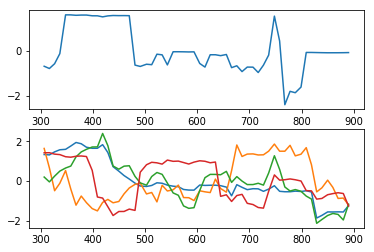

subject 34; gesture 3_0_1; avg 1.020838041669562; sd 0.013612143882242822
subject 34; gesture 3_0_1; PoV: 0.9780295754433964


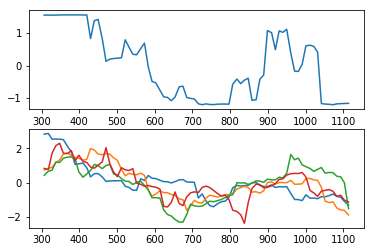

subject 34; gesture 4_1_1; avg 5.6735116629400615; sd 0.10729356309040809
subject 34; gesture 4_1_1; PoV: 0.98392732447851


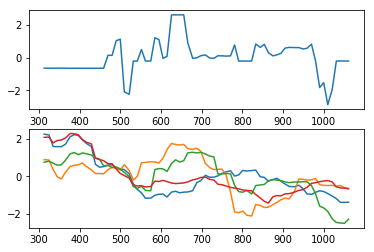

subject 34; gesture 2_0_1; avg 4.587318274855013; sd 0.06101430334365595
subject 34; gesture 2_0_1; PoV: 0.9868571044073237


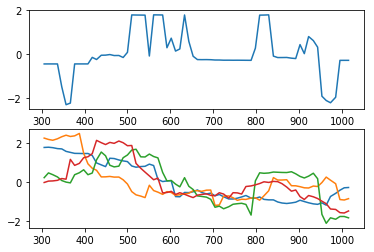

subject 34; gesture 4_1_2; avg 1.550381855483464; sd 0.027241794075504876
subject 34; gesture 4_1_2; PoV: 0.9782861907754761


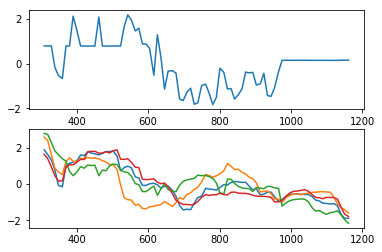

subject 34; gesture 2_0_2; avg 1.1076272121574586; sd 0.009964866461188902
subject 34; gesture 2_0_2; PoV: 0.9845296599508429


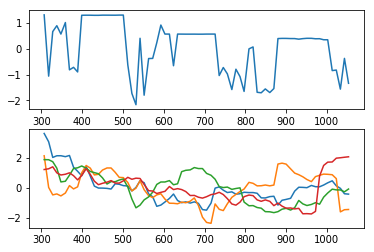

subject 34; gesture 1_1_2; avg 2.140837149118055; sd 0.010156697485489672
subject 34; gesture 1_1_2; PoV: 0.993189540707805


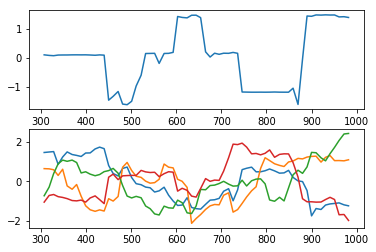

subject 34; gesture 2_1_2; avg 1.3226769616570055; sd 0.031998675147572785
subject 34; gesture 2_1_2; PoV: 0.97363919191172


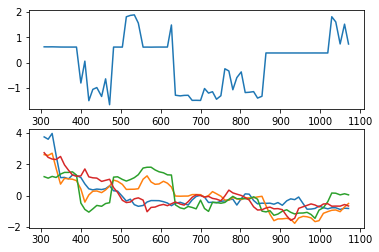

subject 34; gesture 4_0_1; avg 1.7806273054770816; sd 0.018212876478281608
subject 34; gesture 4_0_1; PoV: 0.9886926214295415


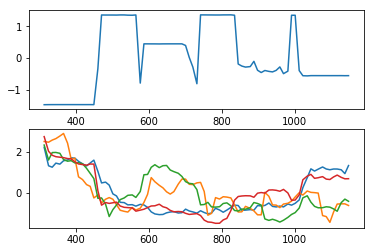

subject 34; gesture 3_0_2; avg 1.759276239098755; sd 0.012403166312748534
subject 34; gesture 3_0_2; PoV: 0.9919097329036796


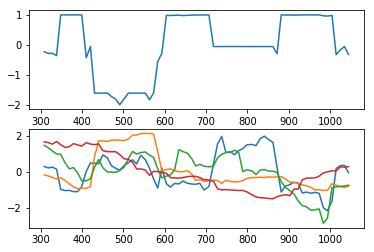

subject 34; gesture 1_1_1; avg 1.0399769498447697; sd 0.017412826436598132
subject 34; gesture 1_1_1; PoV: 0.9714348281659074


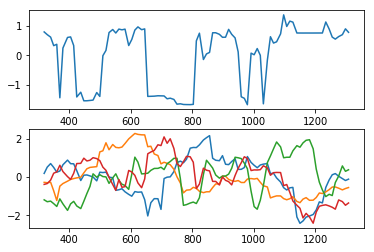

subject 34; gesture 3_1_2; avg 1.7609141005657833; sd 0.02192803340576449
subject 34; gesture 3_1_2; PoV: 0.9796498124801107


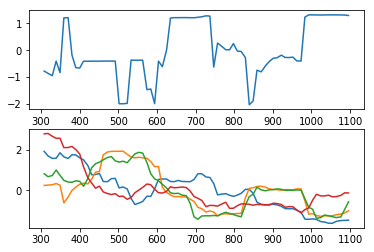

subject 34; gesture 2_1_1; avg 1.0936134083008242; sd 0.00948405307637855
subject 34; gesture 2_1_1; PoV: 0.9886501304088781


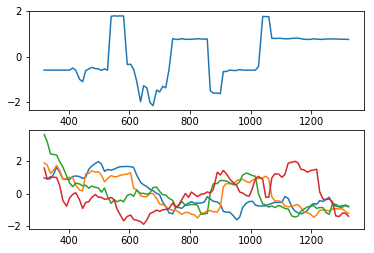

subject 34; gesture 1_0_1; avg 0.9306769807860575; sd 0.03495420961579045
subject 34; gesture 1_0_1; PoV: 0.9595035980100107


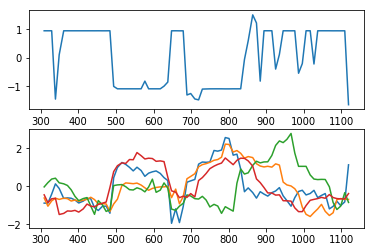

subject 34; gesture 3_1_1; avg 3.196516325904742; sd 0.023744034943172235
subject 34; gesture 3_1_1; PoV: 0.9919129739451887


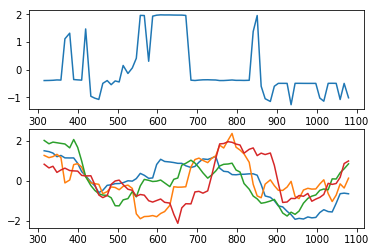

subject 34; gesture 1_0_2; avg 1.1831670826880007; sd 0.016757078226160124
subject 34; gesture 1_0_2; PoV: 0.9790526264662512


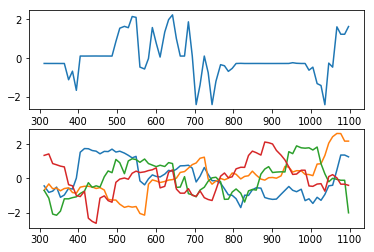

subject 34; gesture 4_0_2; avg 0.7455175113645968; sd 0.006307725126386155
subject 34; gesture 4_0_2; PoV: 0.9827623864063155


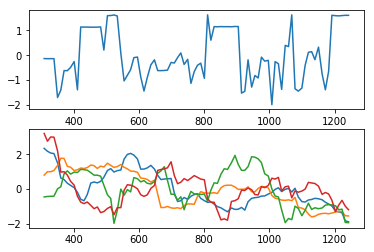

subject 10; gesture 3_0_1; avg 5.195234827462387; sd 0.041249360289851836
subject 10; gesture 3_0_1; PoV: 0.994404711575031


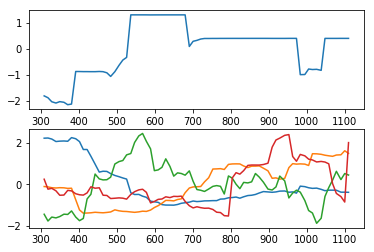

subject 10; gesture 4_1_1; avg 2.210108361966287; sd 0.017315532964317735
subject 10; gesture 4_1_1; PoV: 0.9908257795381649


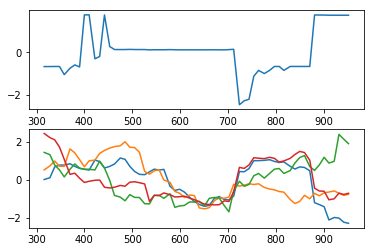

subject 10; gesture 2_0_1; avg 1.8680788532924246; sd 0.01696890354386956
subject 10; gesture 2_0_1; PoV: 0.9845083753724432


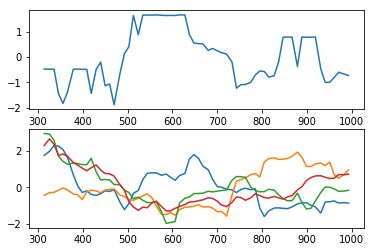

subject 10; gesture 4_1_2; avg 2.250804441656851; sd 0.015590562025838257
subject 10; gesture 4_1_2; PoV: 0.9903399740017893


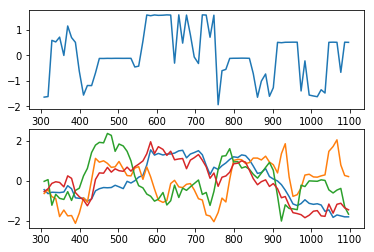

subject 10; gesture 2_0_2; avg 2.1829955848290754; sd 1.1324695171625705
subject 10; gesture 2_0_2; PoV: 0.6627179142091179


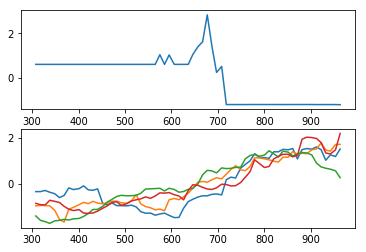

subject 10; gesture 1_1_2; avg 2.592777201705016; sd 0.09820411121993114
subject 10; gesture 1_1_2; PoV: 0.964607941931098


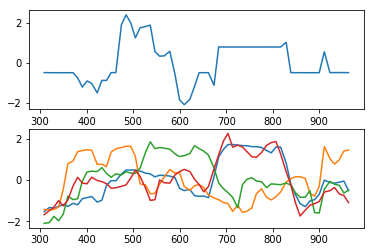

subject 10; gesture 2_1_2; avg 1.1191881241094033; sd 0.015226286778750446
subject 10; gesture 2_1_2; PoV: 0.9787428697703665


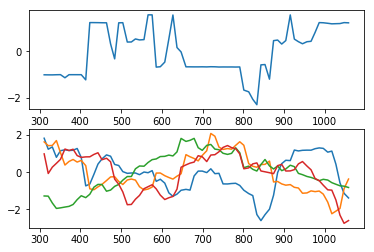

subject 10; gesture 4_0_1; avg 2.079292951668042; sd 0.02749117924867917
subject 10; gesture 4_0_1; PoV: 0.9809950772113202


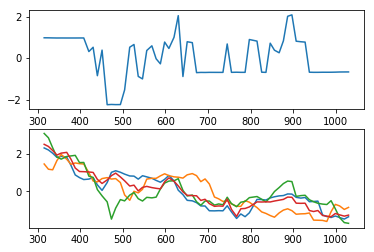

subject 10; gesture 3_0_2; avg 3.4247956796754866; sd 0.034234058652451924
subject 10; gesture 3_0_2; PoV: 0.9884422980933336


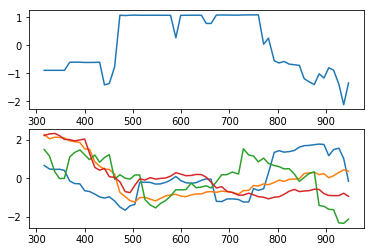

subject 10; gesture 1_1_1; avg 1.4561296628426625; sd 0.013121338716380307
subject 10; gesture 1_1_1; PoV: 0.9875057961396967


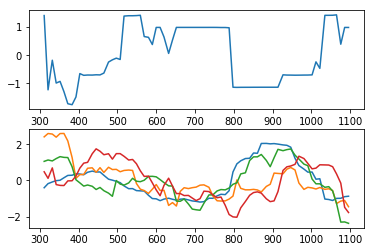

subject 10; gesture 3_1_2; avg 2.7440429789786362; sd 0.031261441747956094
subject 10; gesture 3_1_2; PoV: 0.9864196132810139


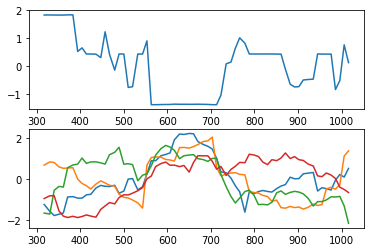

subject 10; gesture 2_1_1; avg 2.4742644509842675; sd 0.01064633387282687
subject 10; gesture 2_1_1; PoV: 0.9946334039505745


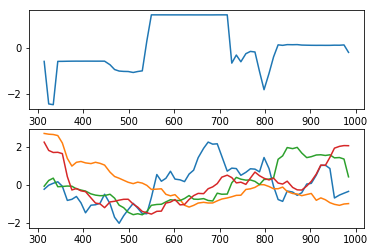

subject 10; gesture 1_0_1; avg 0.6914228789232495; sd 0.006035551638551763
subject 10; gesture 1_0_1; PoV: 0.9858027121949295


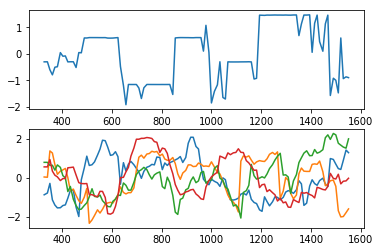

subject 10; gesture 3_1_1; avg 1.1375356853363168; sd 0.04251308054290727
subject 10; gesture 3_1_1; PoV: 0.9577513474769842


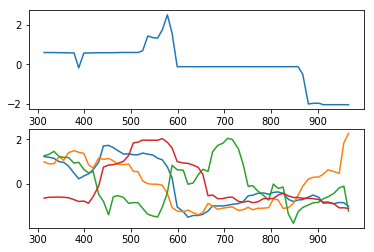

subject 10; gesture 1_0_2; avg 1.3075334842450779; sd 0.007645259207704502
subject 10; gesture 1_0_2; PoV: 0.9889014184671399


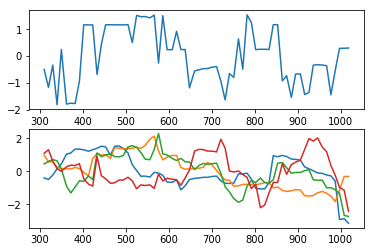

subject 10; gesture 4_0_2; avg 2.6083148492579404; sd 0.03139390999242891
subject 10; gesture 4_0_2; PoV: 0.9856804001902971


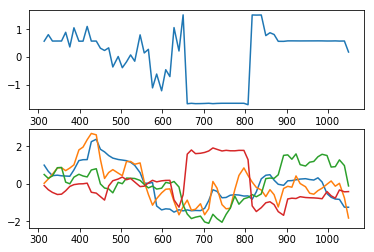

subject 02; gesture 3_0_1; avg 4.256110265916318; sd 0.05518651869931025
subject 02; gesture 3_0_1; PoV: 0.9833640020872393


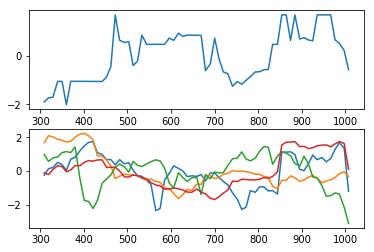

subject 02; gesture 4_1_1; avg 1.3892182904523396; sd 0.01935986624972582
subject 02; gesture 4_1_1; PoV: 0.9744576494430855


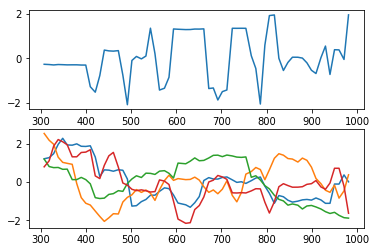

subject 02; gesture 2_0_1; avg 2.35572500914604; sd 0.07693337154620615
subject 02; gesture 2_0_1; PoV: 0.9655928271295925


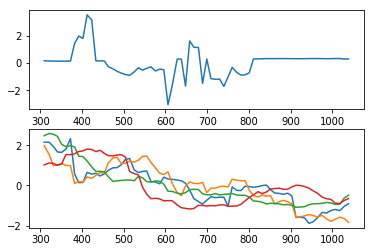

subject 02; gesture 4_1_2; avg 3.5066430033381857; sd 0.024584653505385076
subject 02; gesture 4_1_2; PoV: 0.9938610920439876


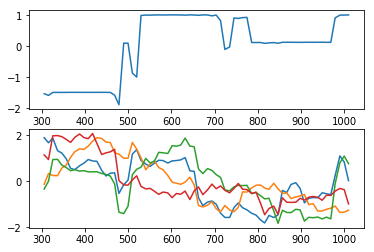

subject 02; gesture 2_0_2; avg 1.5995040274144448; sd 0.012294303798578852
subject 02; gesture 2_0_2; PoV: 0.9886428108725036


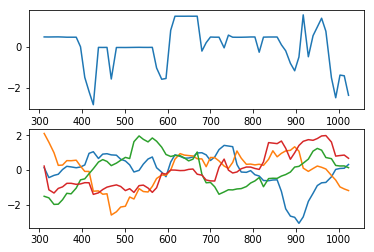

subject 02; gesture 1_1_2; avg 1.7135865926704206; sd 0.01217476450698559
subject 02; gesture 1_1_2; PoV: 0.9873658683589923


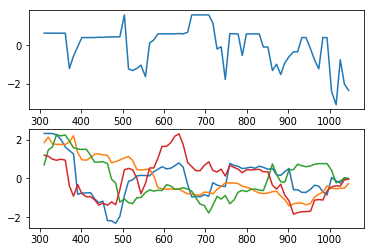

subject 02; gesture 2_1_2; avg 4.0906744513112985; sd 0.2505476782269306
subject 02; gesture 2_1_2; PoV: 0.9615111449576436


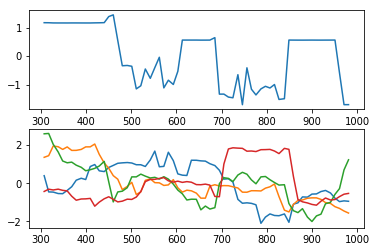

subject 02; gesture 4_0_1; avg 0.9471565772782545; sd 0.009097814265525772
subject 02; gesture 4_0_1; PoV: 0.9789316431116908


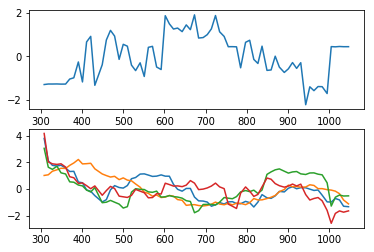

subject 02; gesture 3_0_2; avg 1.345674963377069; sd 0.021589674598032987
subject 02; gesture 3_0_2; PoV: 0.9738941120422816


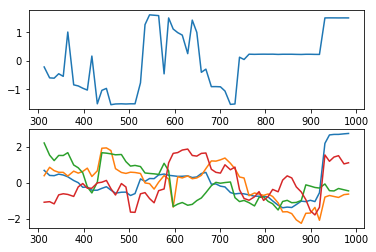

subject 02; gesture 1_1_1; avg 1.5644137398510551; sd 0.013237473837048786
subject 02; gesture 1_1_1; PoV: 0.986601150293754


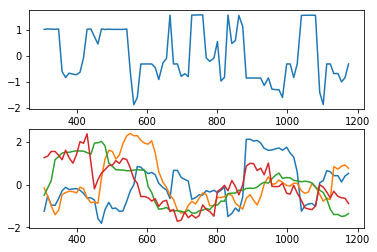

subject 02; gesture 3_1_2; avg 1.9775912676382572; sd 0.014122748122711167
subject 02; gesture 3_1_2; PoV: 0.9912874071391516


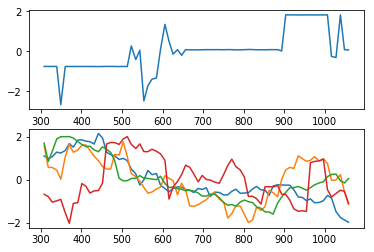

subject 02; gesture 2_1_1; avg 0.9551135412544682; sd 0.009239097478741014
subject 02; gesture 2_1_1; PoV: 0.9810904347958738


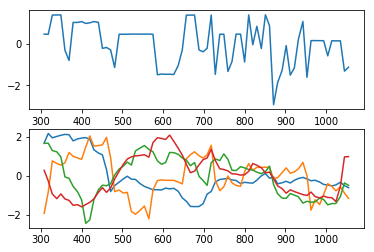

subject 02; gesture 1_0_1; avg 1.186772767130415; sd 0.01715077711240204
subject 02; gesture 1_0_1; PoV: 0.9762941884992488


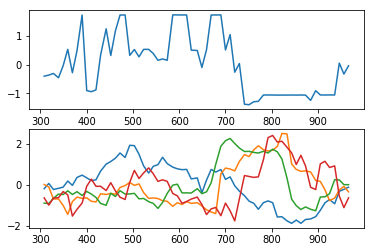

subject 02; gesture 3_1_1; avg 1.0606953330350408; sd 0.017166680244638508
subject 02; gesture 3_1_1; PoV: 0.9775753307265247


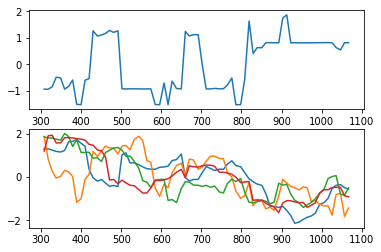

subject 02; gesture 1_0_2; avg 0.9401292622935145; sd 0.015844328230279776
subject 02; gesture 1_0_2; PoV: 0.9748837934193938


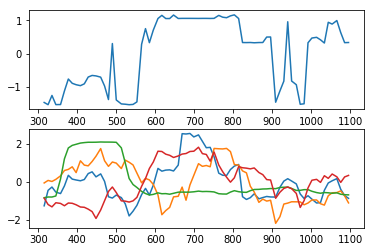

subject 02; gesture 4_0_2; avg 2.029660028387778; sd 0.0144617660907004
subject 02; gesture 4_0_2; PoV: 0.991501794294368


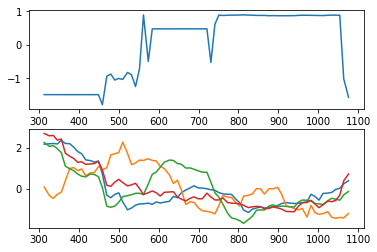

In [6]:
decomp_syn = {}

for s, gdict in dict_synerg.items():
    decomp_syn[s] = {}
    for g, a in gdict.items():
        print(f"subject {s}; gesture {g}; avg {a.mean()}; sd {a.std()}")
        evals, evecs = la.eig(a)
        evals = evals.real
        sort_idx = np.argsort(-evals)
        evals = evals[sort_idx]
        evecs = evecs[:, sort_idx]
        # calc percent of variance explained
        print(f"subject {s}; gesture {g}; PoV: {evals[0].real / evals.real.sum()}")
        # do PCA
        res = a @ evecs[:, 0]
        res = scale(res.real)
        decomp_syn[s][g] = res
        # plot results
        plt.subplot(211)
        plt.plot(dc.data_set_smooth[s][g][:,0], res)
        plt.subplot(212)
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,1])
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,2])
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,3])
        plt.plot(dc.data_set_smooth[s][g][:,0], dc.data_set_smooth[s][g][:,4])
        plt.show()

---

In [7]:
# organize vectors by gesture
gest_dict = {"3":[], "4":[], "5":[], "6":[]}

for s, gdict in decomp_syn.items():
    for g, a in gdict.items():
        if g[0] not in ["3", "4", "5", "6"]: continue
        gest_dict[g[0]].append(a)

In [8]:
comp_dict = {"3":{"3":[], "4":[], "5":[], "6":[]},
             "4":{"3":[], "4":[], "5":[], "6":[]},
             "5":{"3":[], "4":[], "5":[], "6":[]},
             "6":{"3":[], "4":[], "5":[], "6":[]}}

for g1 in ["3", "4", "5", "6"]:
    for g2 in ["3", "4", "5", "6"]:
        for i in range(144):
            for j in range(144):
                if i == j and g1 == g2: continue
                comp_dict[g1][g2].append(dtw(gest_dict[g1][i], gest_dict[g2][j]))

In [9]:
for g1 in ["3", "4", "5", "6"]:
    print(f"gesture {g1} dtw similarities w/ other gestures:")
    for g2 in ["3", "4", "5", "6"]:
        print(f"avg similarity vs gesture {g2}: {np.mean(comp_dict[g1][g2])}")

gesture 1 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.513878697759763
avg similarity vs gesture 2: 6.798975019638443
avg similarity vs gesture 3: 6.805471133981377
avg similarity vs gesture 4: 6.853722949614958
gesture 2 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.798975019638443
avg similarity vs gesture 2: 6.9875620764629085
avg similarity vs gesture 3: 7.002568782710724
avg similarity vs gesture 4: 7.063131732775881
gesture 3 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.805471133981377
avg similarity vs gesture 2: 7.002568782710726
avg similarity vs gesture 3: 7.000657130264255
avg similarity vs gesture 4: 7.06959274842831
gesture 4 dtw similarities w/ other gestures:
avg similarity vs gesture 1: 6.853722949614958
avg similarity vs gesture 2: 7.063131732775881
avg similarity vs gesture 3: 7.06959274842831
avg similarity vs gesture 4: 7.153017090013379
